In [1]:
print('')

aim to plot change in gradient as consider changing minimum magntiude of data

In [2]:
import os
import scipy
import numpy as np
import matplotlib.pyplot as plt
import obspy
import pickle
from obspy import UTCDateTime
from obspy.clients.fdsn import Client
import pandas as pd
import math

import matplotlib
matplotlib.rcParams.update({'font.size': 20})

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
from spearman_plotting_func import *

change magnitude limits, colors in functions file

In [5]:
filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20']


'''filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new',
              'eq_object_03s_bandpass_01_19_snr_20_blank_005_new',
              'eq_object_03s_bandpass_01_19_snr_20_blank_01_new']

filenames = ['eq_object_05s_bandpass_01_19_snr_20_blank_0_new',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new']'''

filenames = ['eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20',
            'eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr5',
             'eq_object_03s_bandpass_01_19_snr_20_blank_005_new_snr5', 
             'eq_object_03s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new_snr5', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr5', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new_snr5',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new_snr5',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new_snr5',
              'eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20',
             'eq_object_03s_bandpass_01_19_snr_20_blank_005_new_snr20', 
             'eq_object_03s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_005_new_snr20', 
             'eq_object_05s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_05s_bandpass_01_19_snr_20_blank_025_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20', 
             'eq_object_1s_bandpass_01_19_snr_20_blank_005_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_01_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_025_new_snr20',
             'eq_object_1s_bandpass_01_19_snr_20_blank_05_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_005_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_01_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_025_new_snr20',
              'eq_object_4s_bandpass_01_19_snr_20_blank_05_new_snr20']


eq_object_03s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.4799405062338639
pgd 0.6089165968103959
tc 0.5563437231853089
iv2 0.44732639520425554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


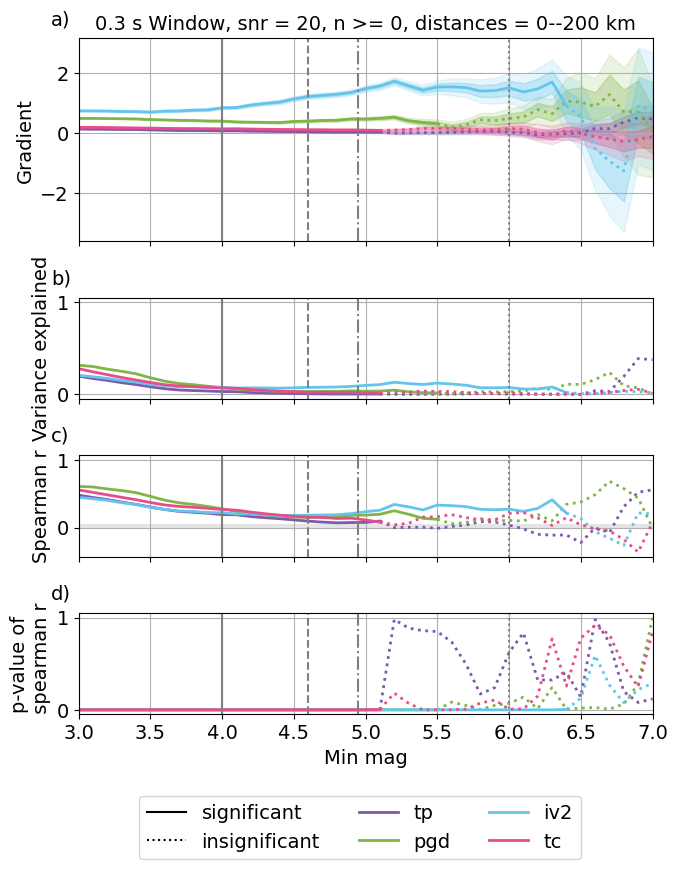

tp 0.4709147637658383
pgd 0.6015954116204764
tc 0.5435208527654147
iv2 0.4446846280107827
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


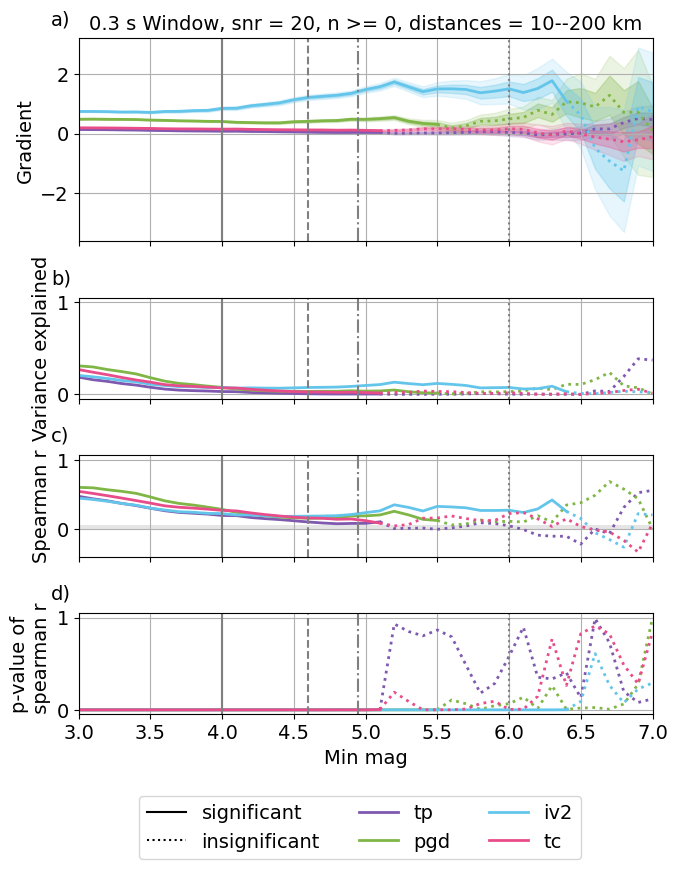

tp 0.45437271895046377
pgd 0.591319471998318
tc 0.5317765614609813
iv2 0.4409473375684877
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


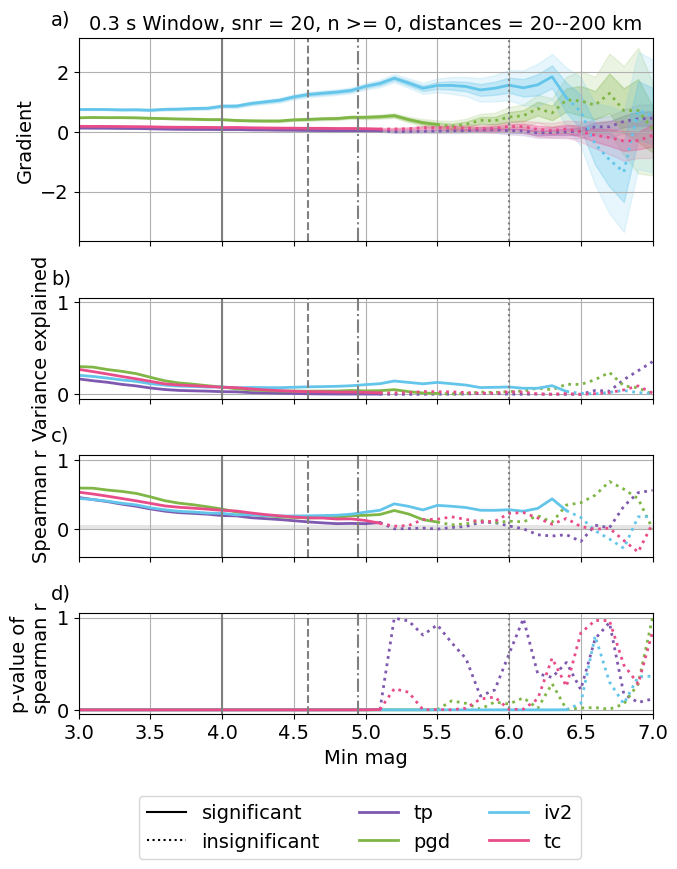

tp 0.44626159784964375
pgd 0.5783480527535996
tc 0.4998842150040347
iv2 0.4282272044621029
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


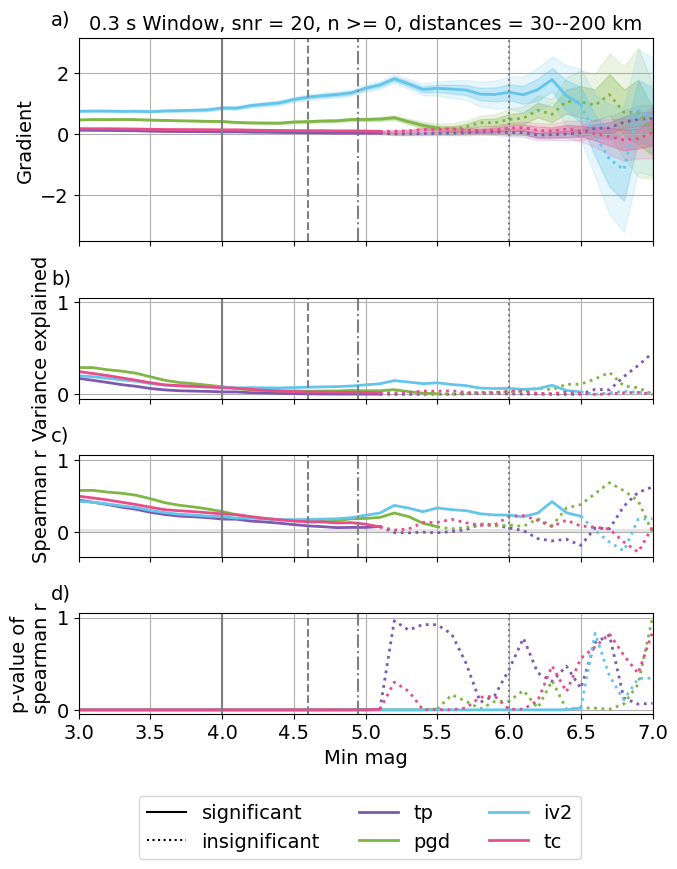

tp 0.433355678022483
pgd 0.568657457388001
tc 0.48004608028870693
iv2 0.419616106570247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


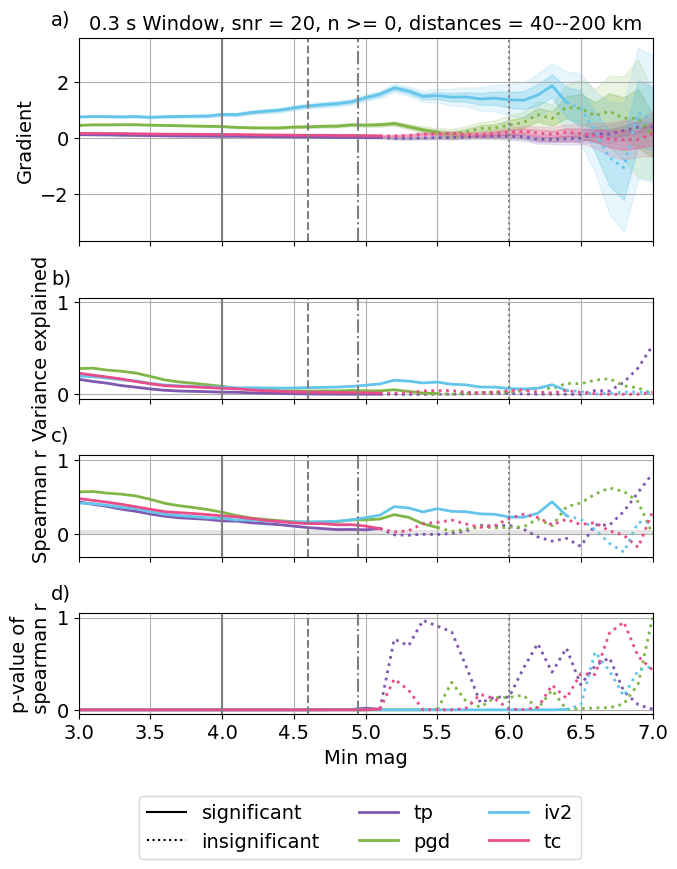

tp 0.4237711484400651
pgd 0.5744901948627723
tc 0.4573729845895323
iv2 0.4310452631611048
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


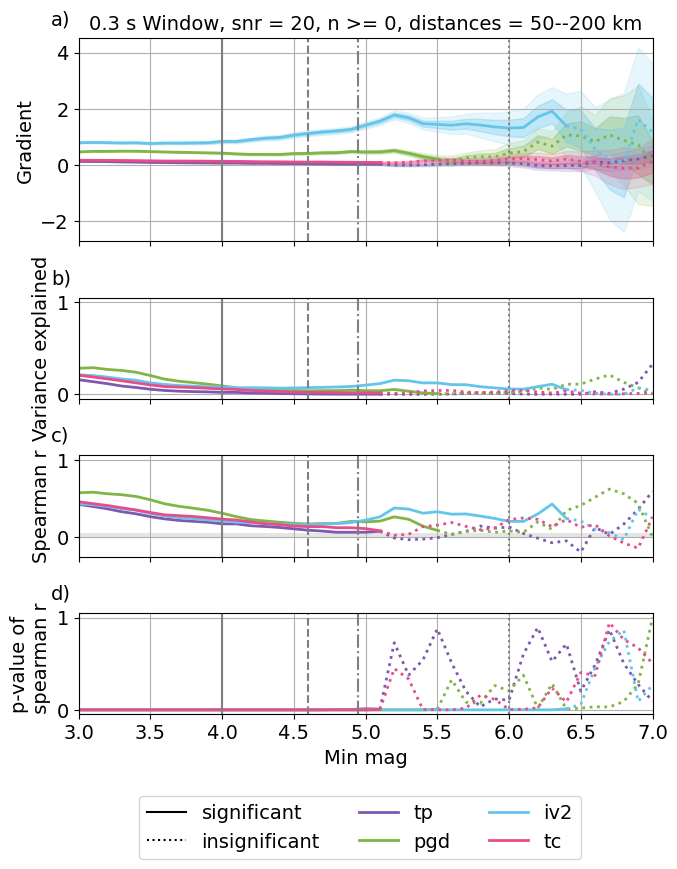

tp 0.40791354898234583
pgd 0.5774666881508789
tc 0.41998047938195265
iv2 0.45229635018573716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


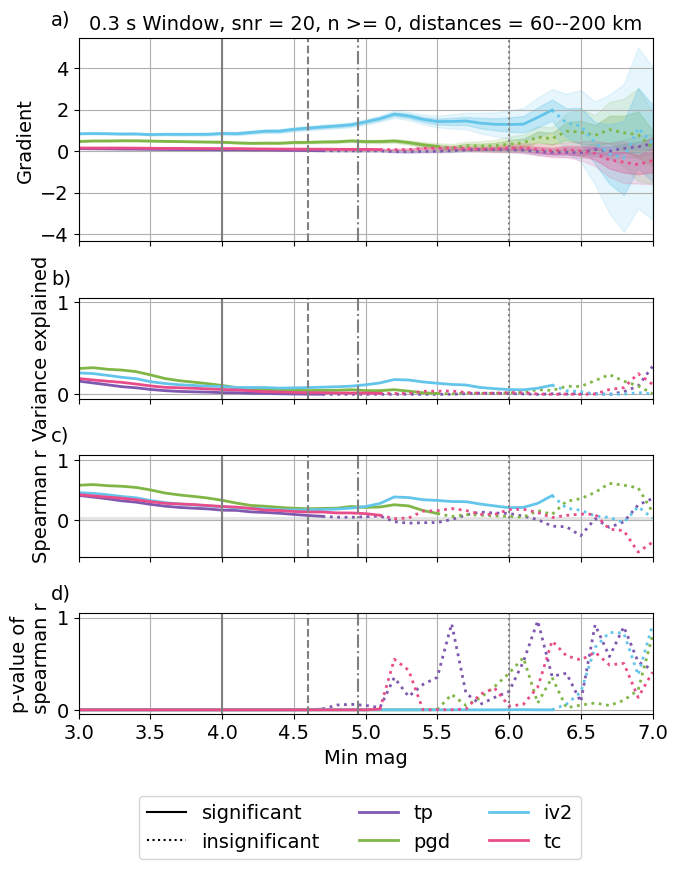

tp 0.406968717435026
pgd 0.5870658818039405
tc 0.3748234492956241
iv2 0.4846135602781693
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


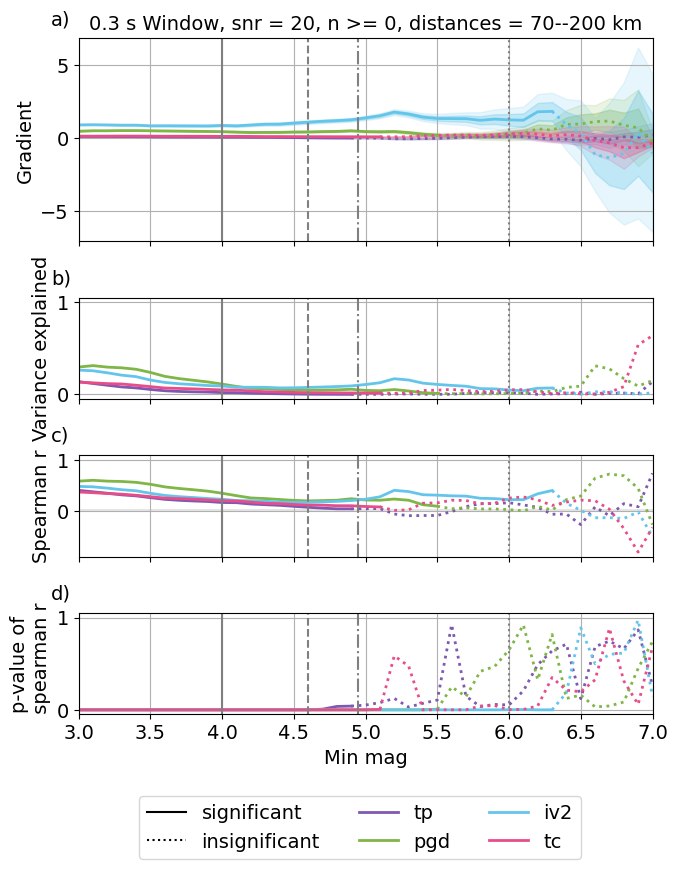

tp 0.3834624880681195
pgd 0.5855264448848957
tc 0.3165081826287607
iv2 0.5069781428944471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


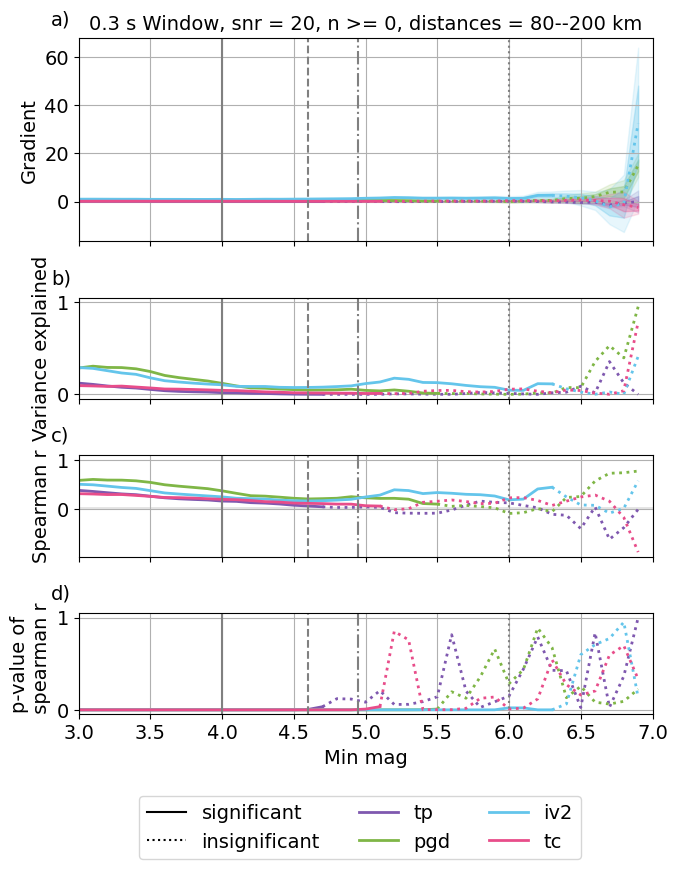

tp 0.3679543632460067
pgd 0.5793294971771363
tc 0.26730357946515143
iv2 0.5050015823607434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


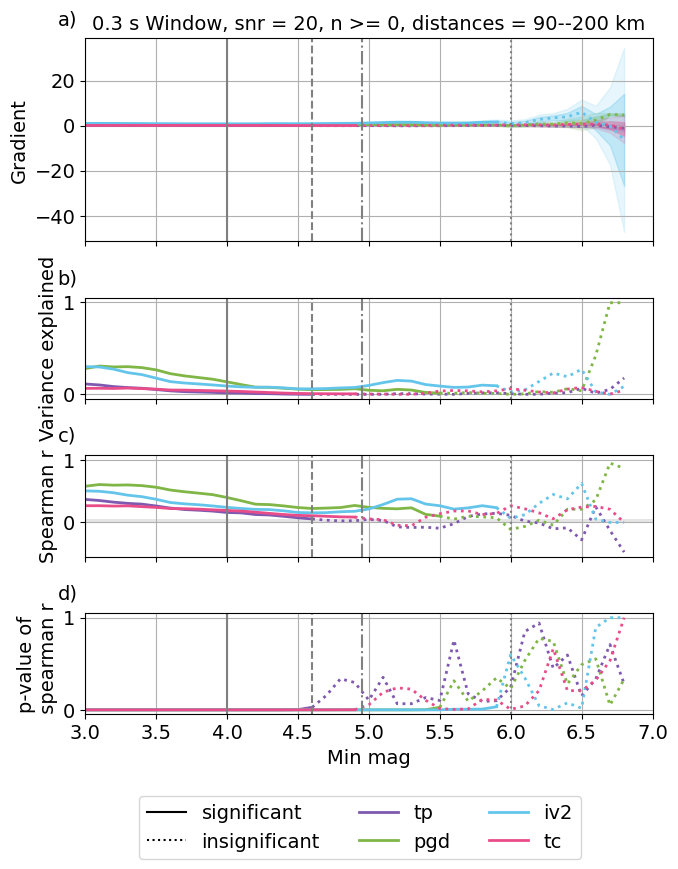

tp 0.4799405062338639
pgd 0.6089165968103959
tc 0.5563437231853089
iv2 0.44732639520425554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


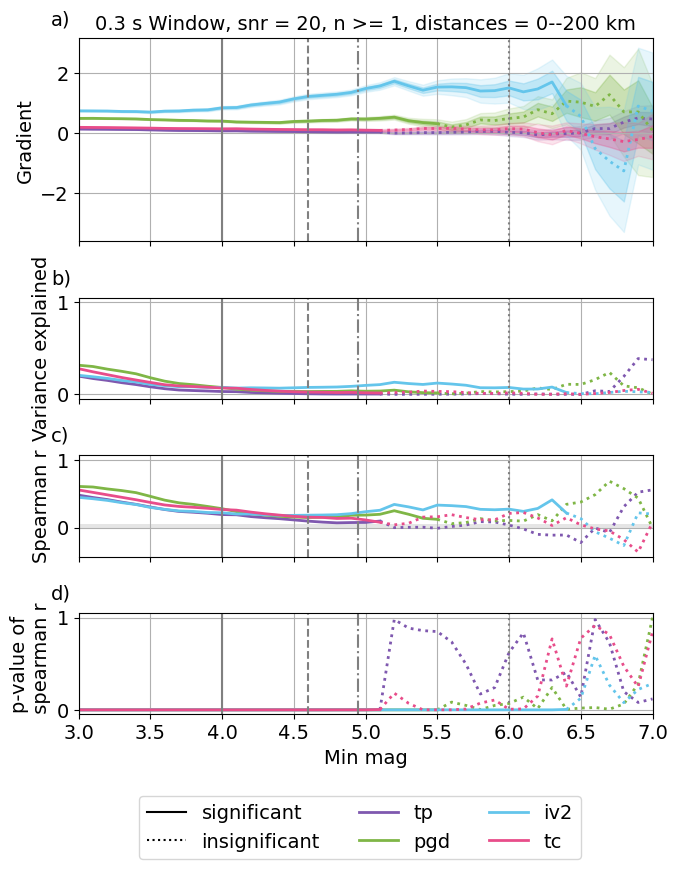

tp 0.4709147637658383
pgd 0.6015954116204764
tc 0.5435208527654147
iv2 0.4446846280107827
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


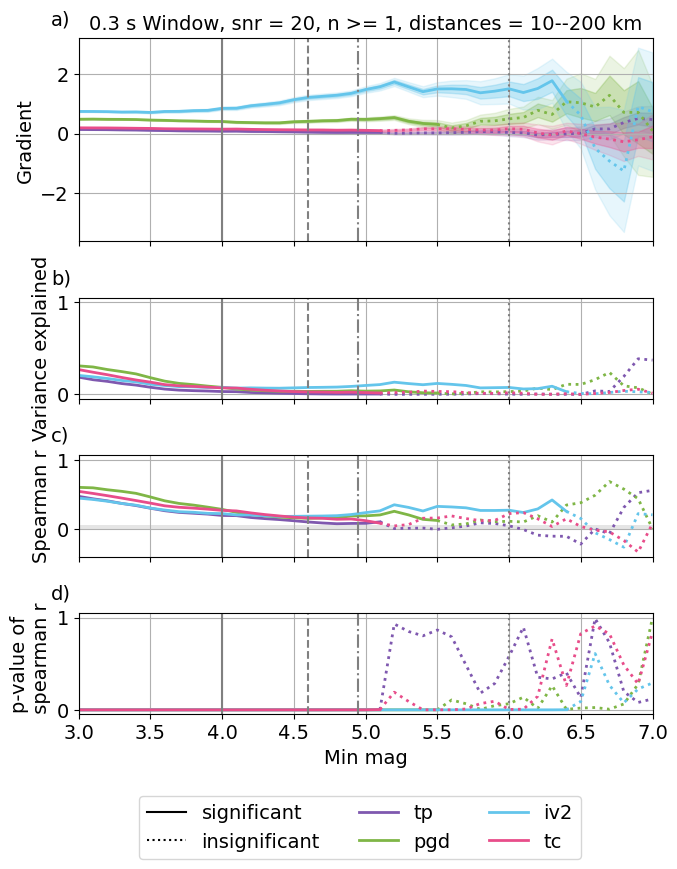

tp 0.45437271895046377
pgd 0.591319471998318
tc 0.5317765614609813
iv2 0.4409473375684877
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


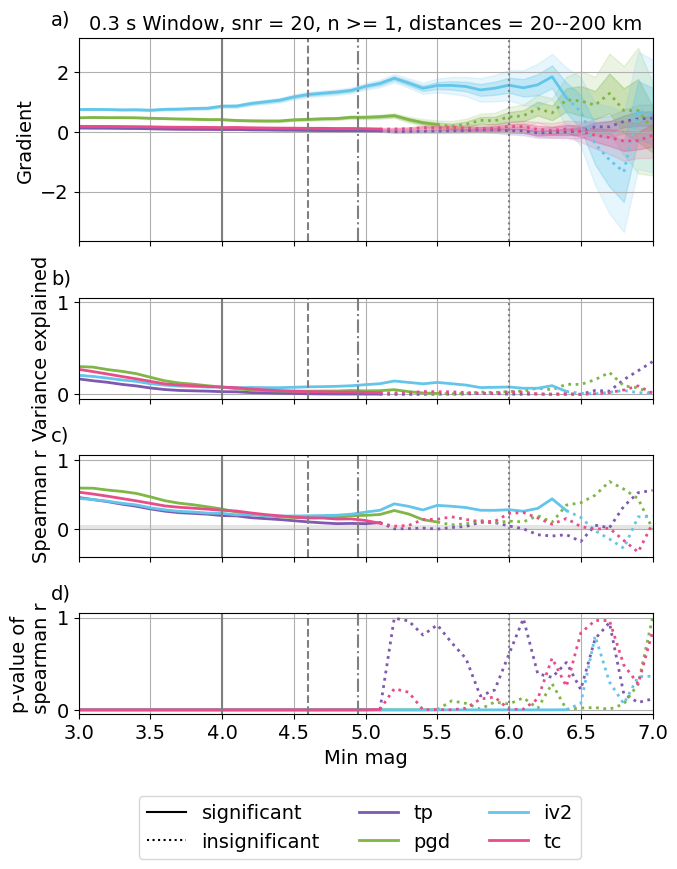

tp 0.44626159784964375
pgd 0.5783480527535996
tc 0.4998842150040347
iv2 0.4282272044621029
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


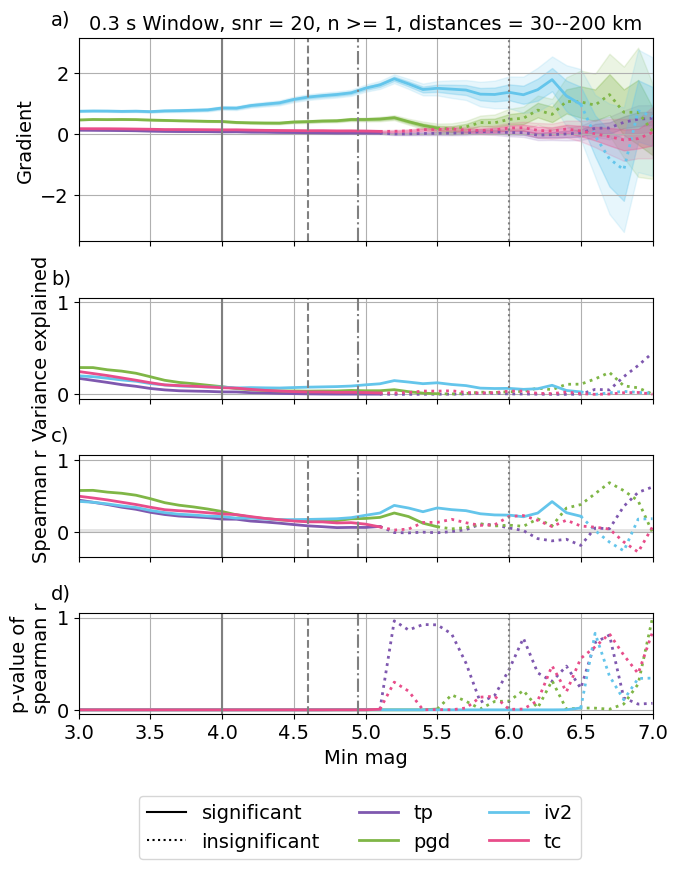

tp 0.433355678022483
pgd 0.568657457388001
tc 0.48004608028870693
iv2 0.419616106570247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


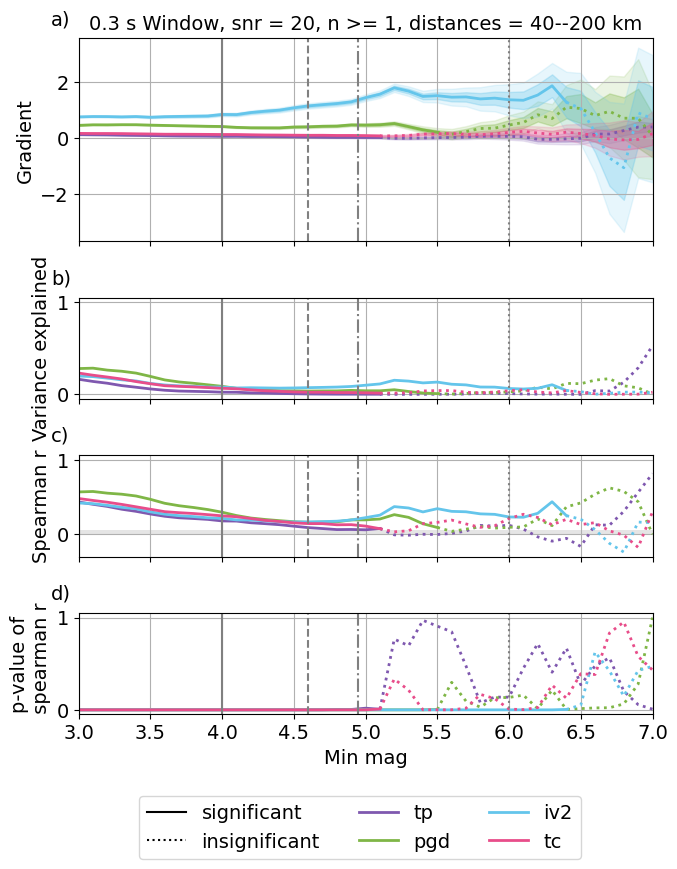

tp 0.4237711484400651
pgd 0.5744901948627723
tc 0.4573729845895323
iv2 0.4310452631611048
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


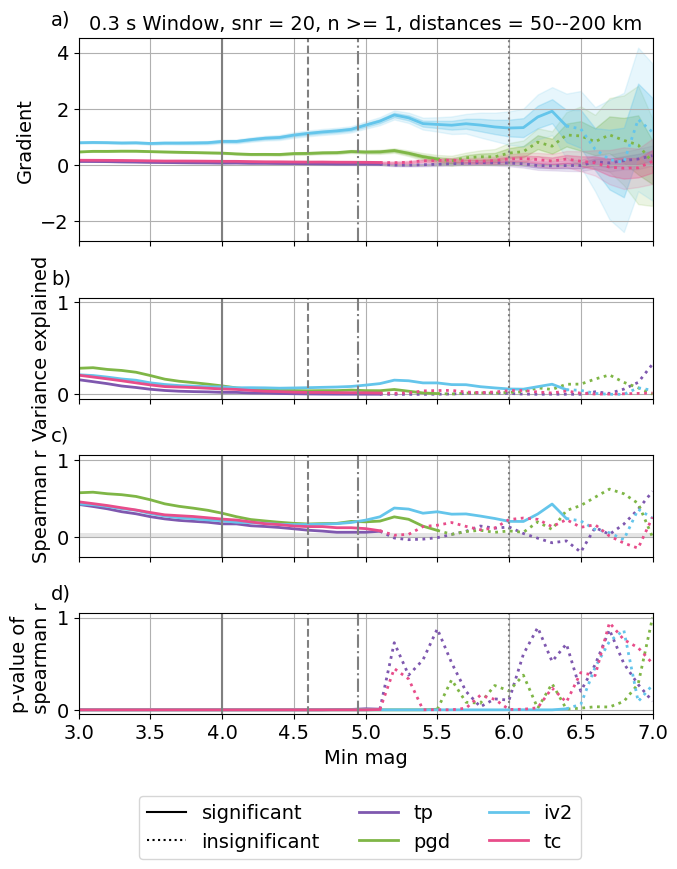

tp 0.40791354898234583
pgd 0.5774666881508789
tc 0.41998047938195265
iv2 0.45229635018573716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


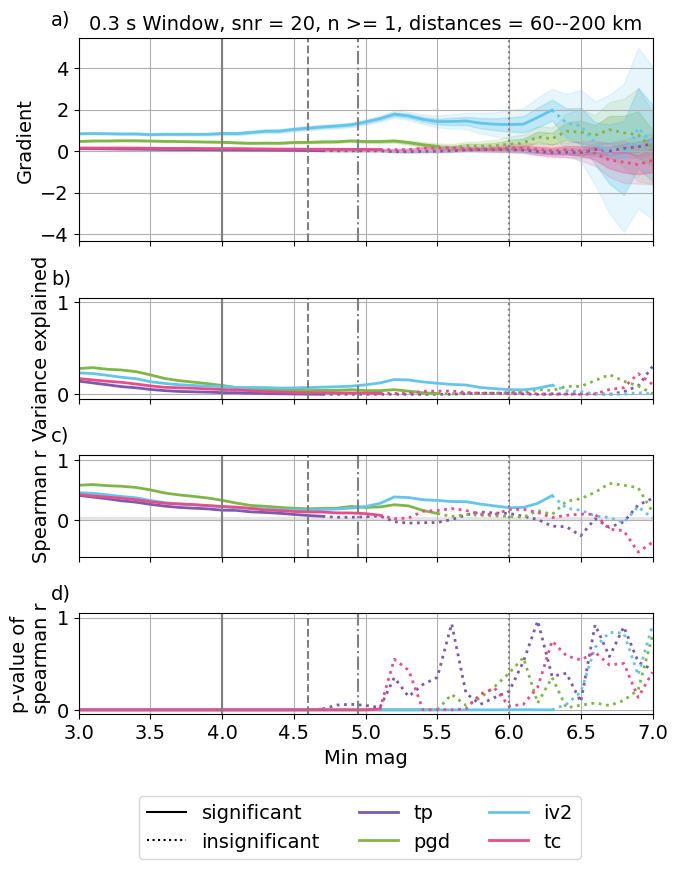

tp 0.406968717435026
pgd 0.5870658818039405
tc 0.3748234492956241
iv2 0.4846135602781693
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


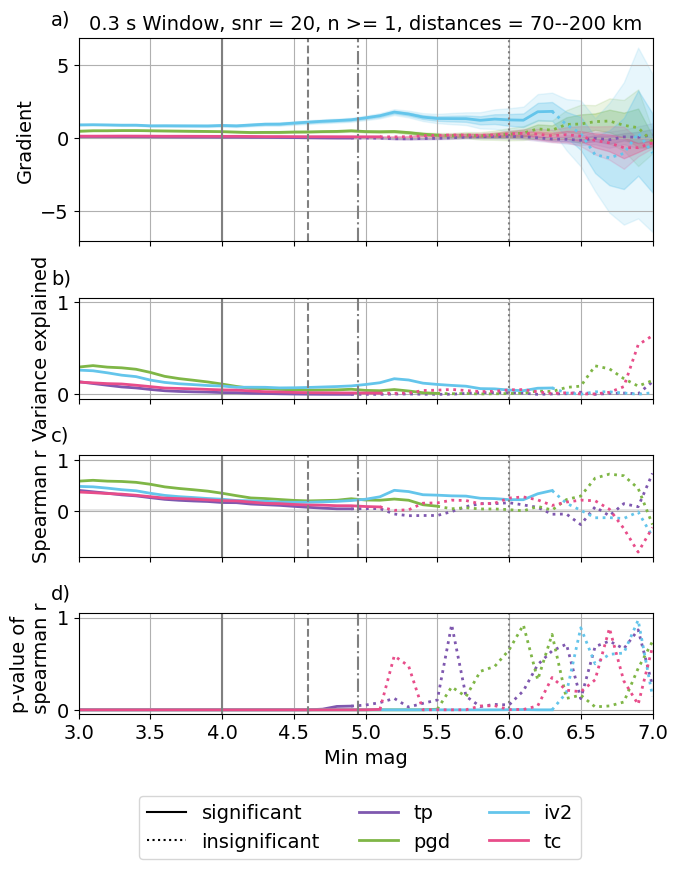

tp 0.3834624880681195
pgd 0.5855264448848957
tc 0.3165081826287607
iv2 0.5069781428944471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


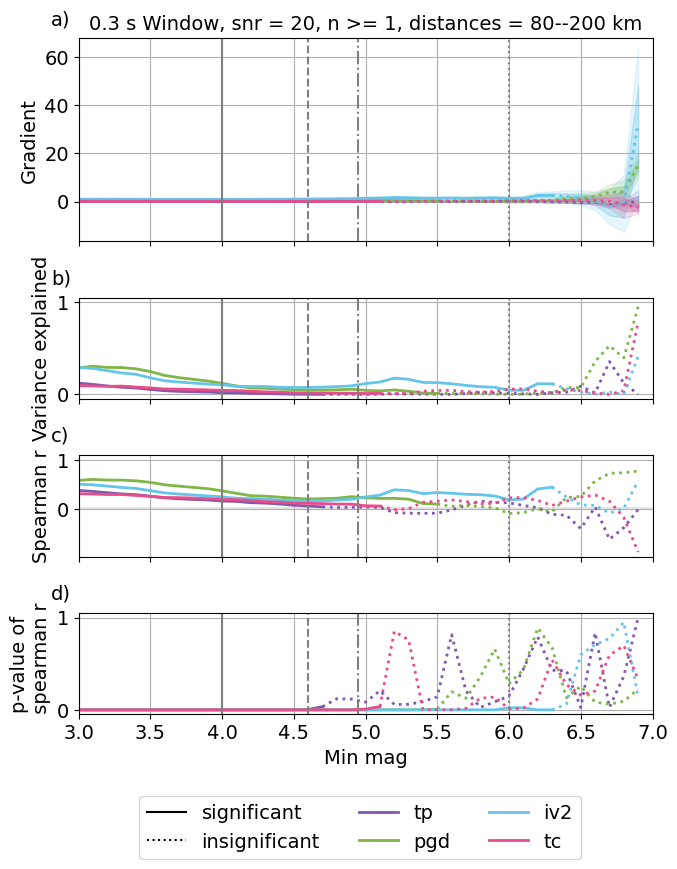

tp 0.3679543632460067
pgd 0.5793294971771363
tc 0.26730357946515143
iv2 0.5050015823607434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


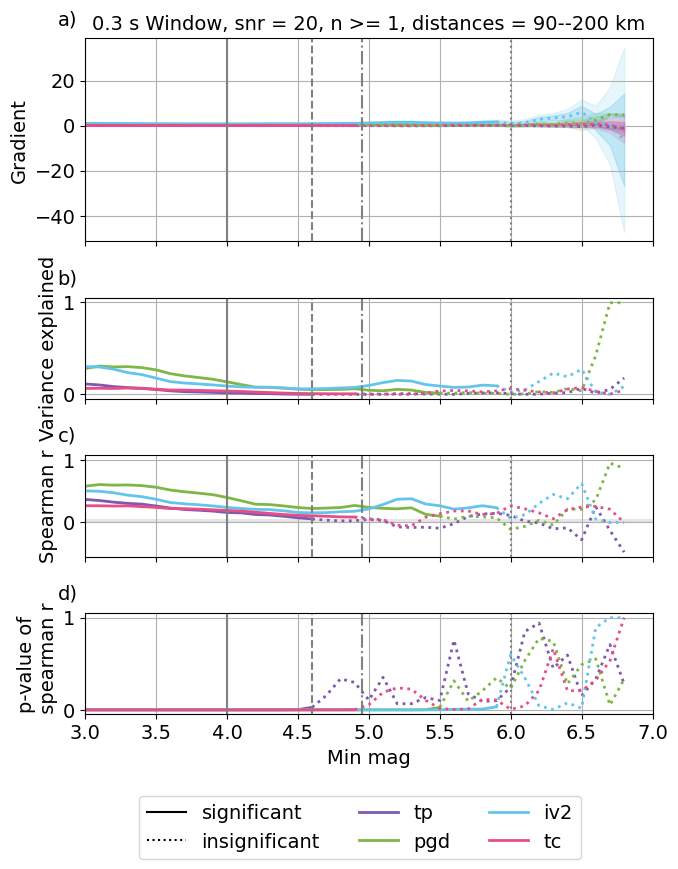

tp 0.5819657244264809
pgd 0.609833662744778
tc 0.6394697934216431
iv2 0.44720098005908876
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


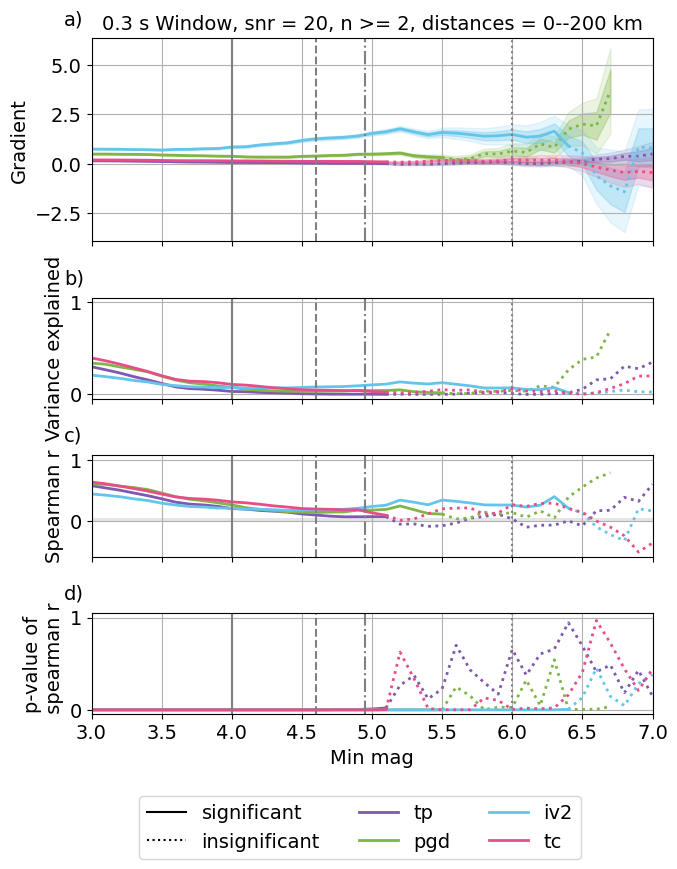

tp 0.5710096470810455
pgd 0.6024285585782024
tc 0.6223908642744984
iv2 0.4445100631484766
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


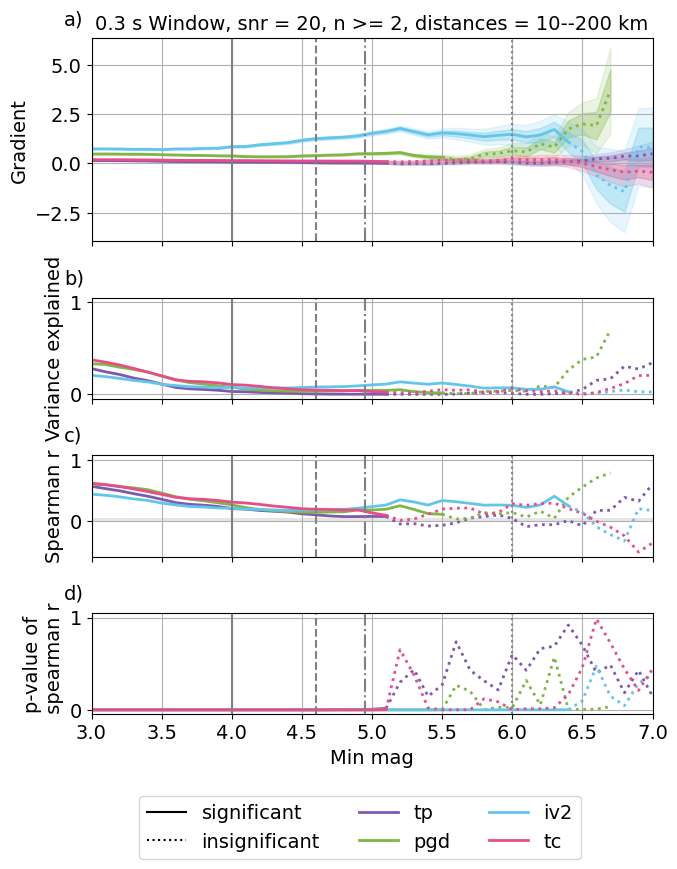

tp 0.5531817451851803
pgd 0.5927475608412048
tc 0.6079507262114284
iv2 0.44159432890113187
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


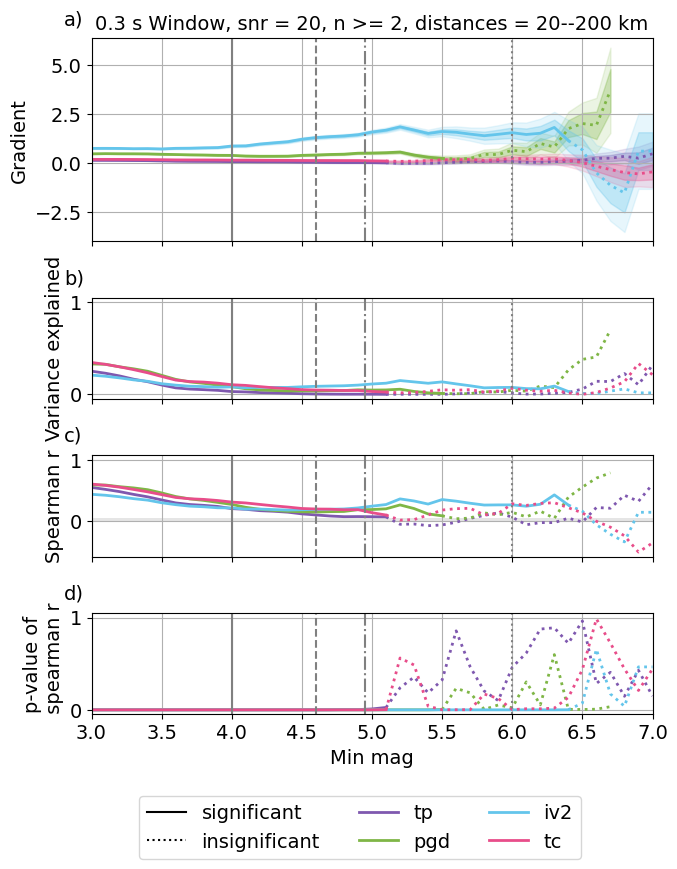

tp 0.5402316656756924
pgd 0.5813957735833387
tc 0.5687842879392804
iv2 0.4284296193309148
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


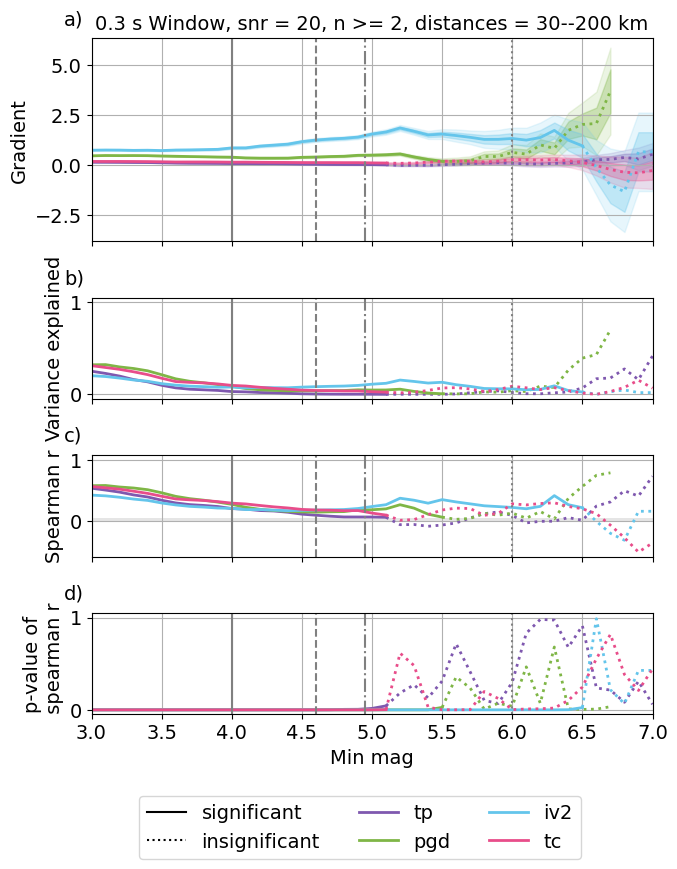

tp 0.5285047913764597
pgd 0.572572612230544
tc 0.5483392435956284
iv2 0.4204555524231751
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


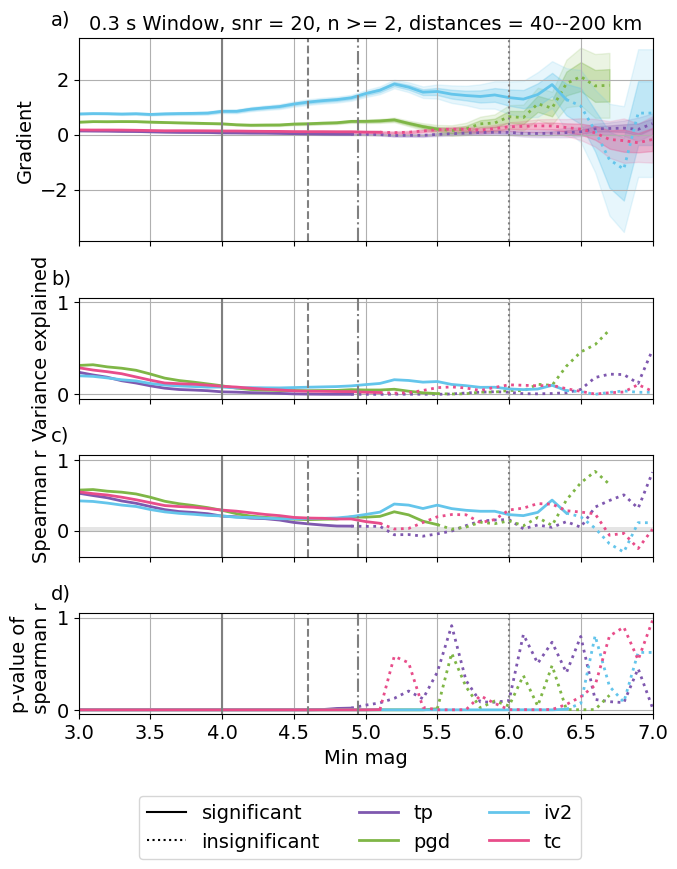

tp 0.5174167273832204
pgd 0.5796630347161178
tc 0.5195458203343115
iv2 0.4334039904990859
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


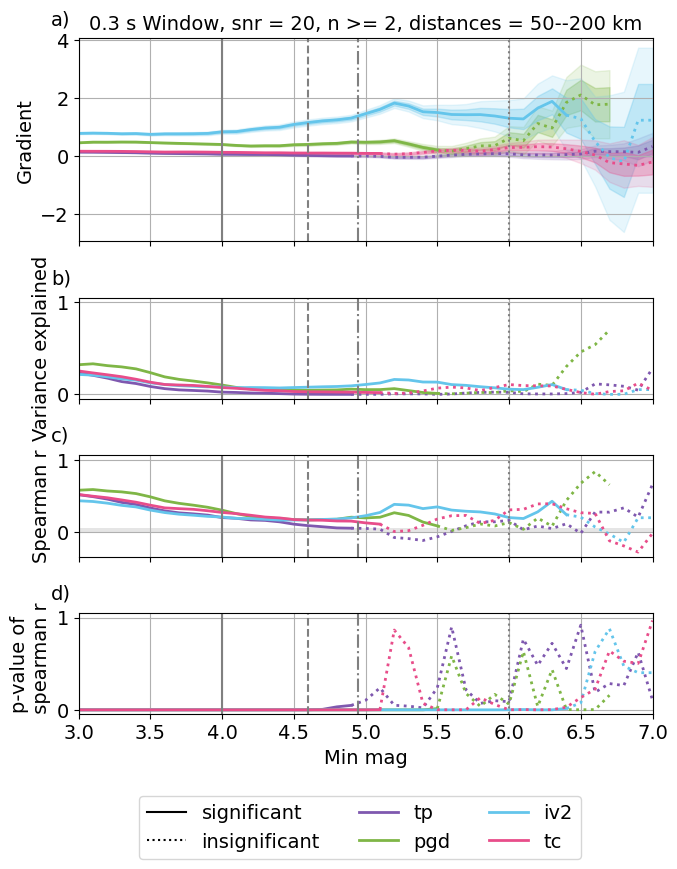

tp 0.4969822783781455
pgd 0.5826986990241153
tc 0.46879154872036966
iv2 0.4557943758233896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


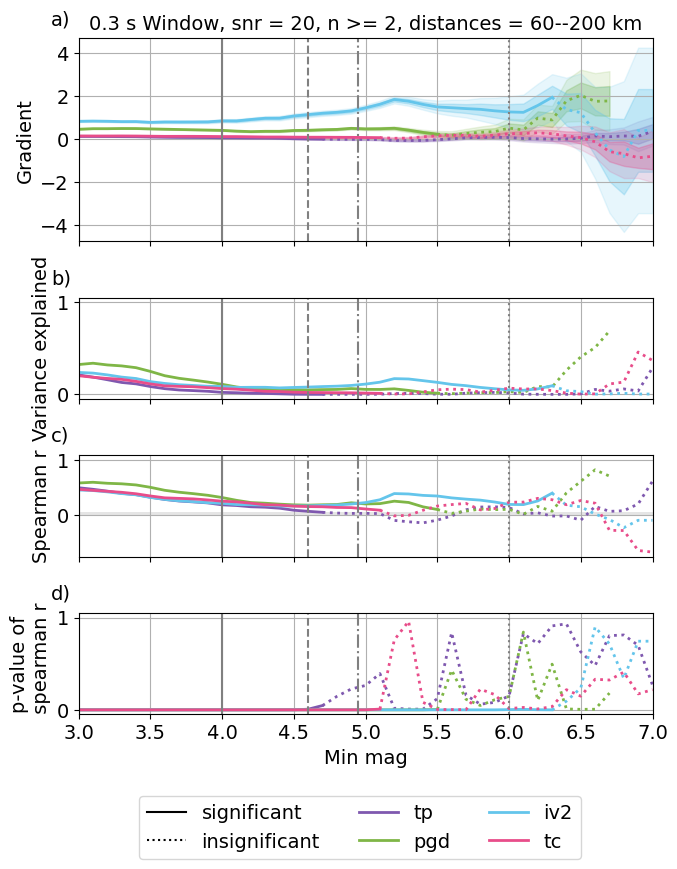

tp 0.4877922941034648
pgd 0.5916813754718274
tc 0.40897748956112917
iv2 0.4905582162090476
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


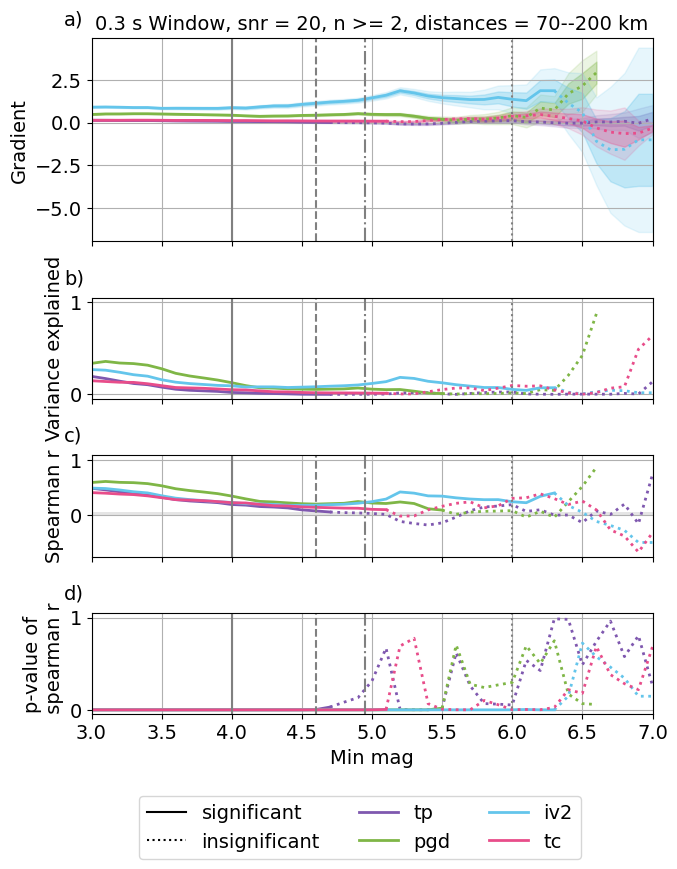

tp 0.45392955488278
pgd 0.5911670519777277
tc 0.33570517750337586
iv2 0.5196951878782788
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


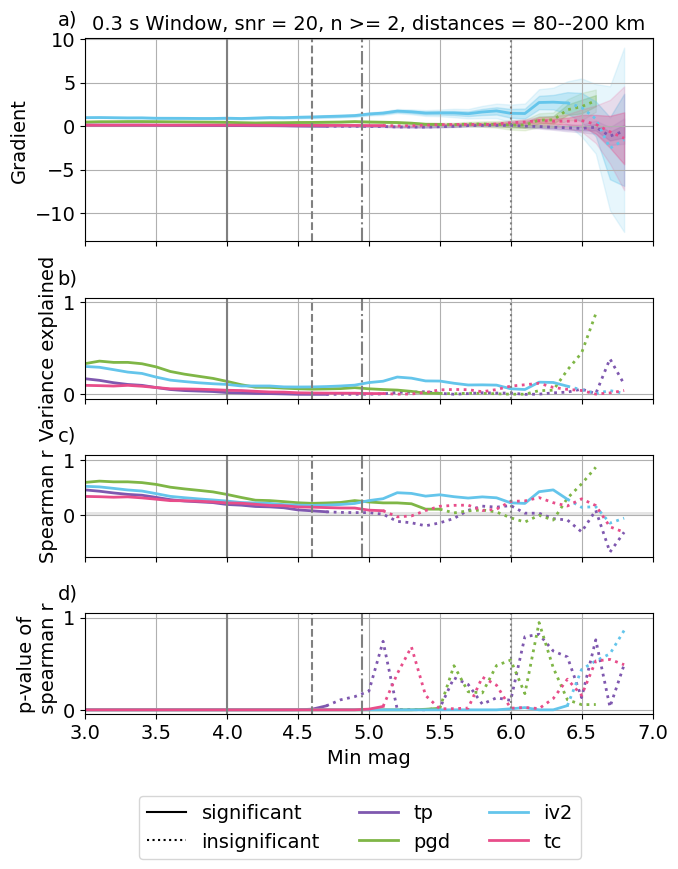

tp 0.4280221950862352
pgd 0.5812104625552563
tc 0.274808794502722
iv2 0.5258157951567004
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


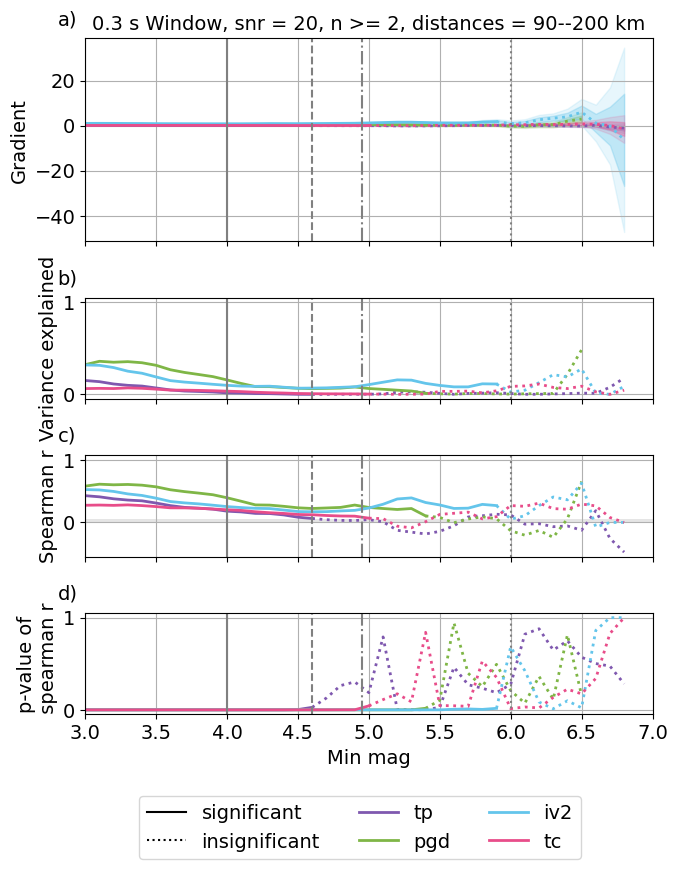

tp 0.6300499797947987
pgd 0.6066635892141742
tc 0.6730413646228371
iv2 0.4423410564315505
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


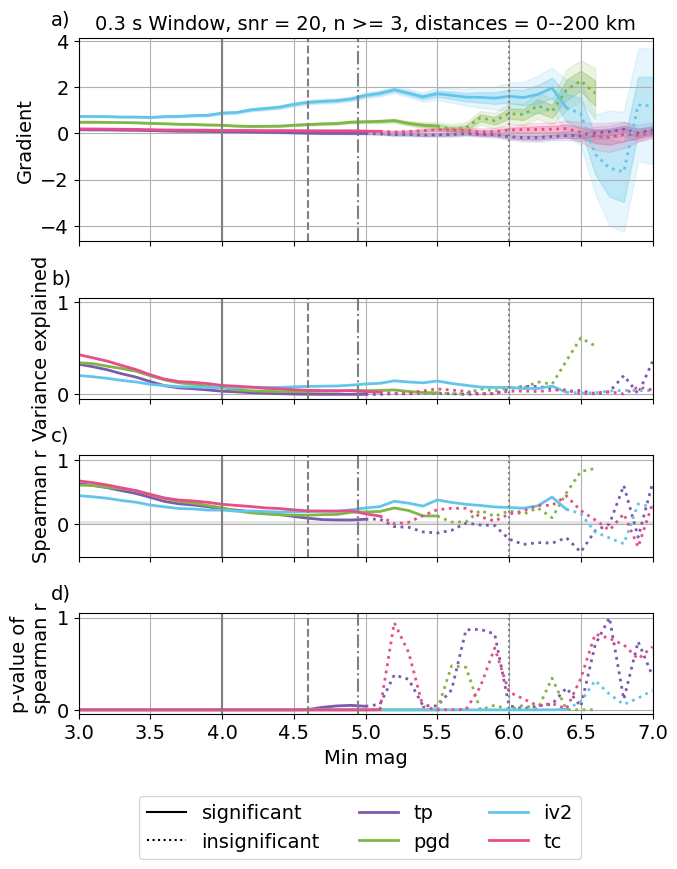

tp 0.6248449061367143
pgd 0.6000321358475605
tc 0.6526614142777304
iv2 0.43961854242678683
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


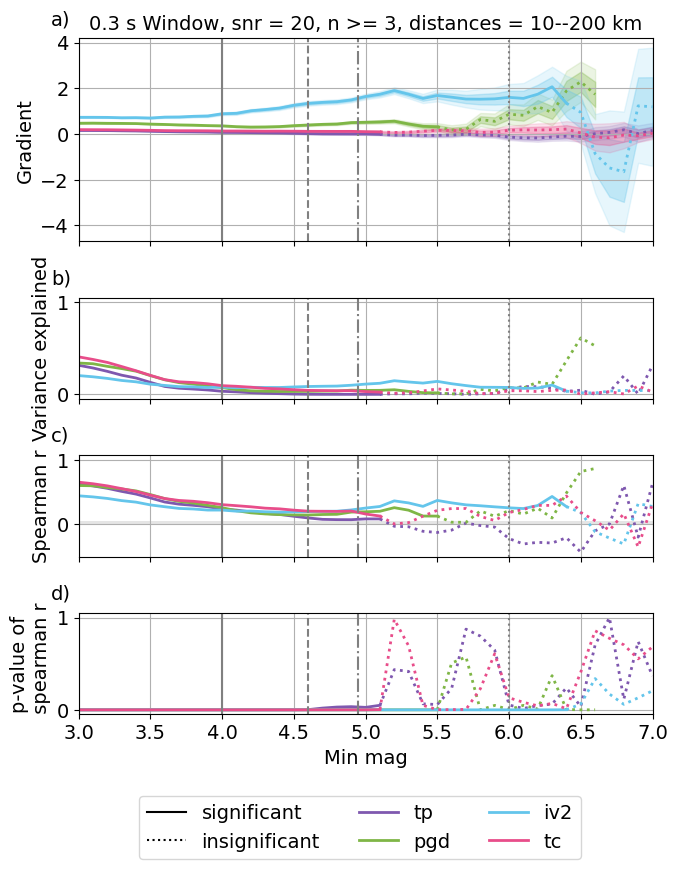

tp 0.6080254951151669
pgd 0.5917597276543781
tc 0.639539822394289
iv2 0.4385178222488471
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


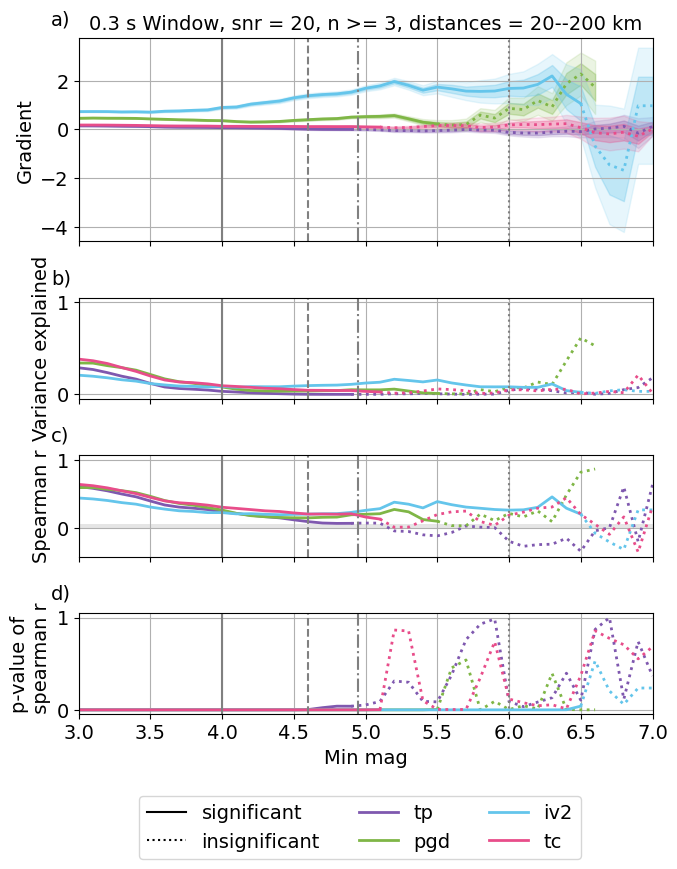

tp 0.5991269188838755
pgd 0.581335555345236
tc 0.6041738886695963
iv2 0.42617853742903306
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


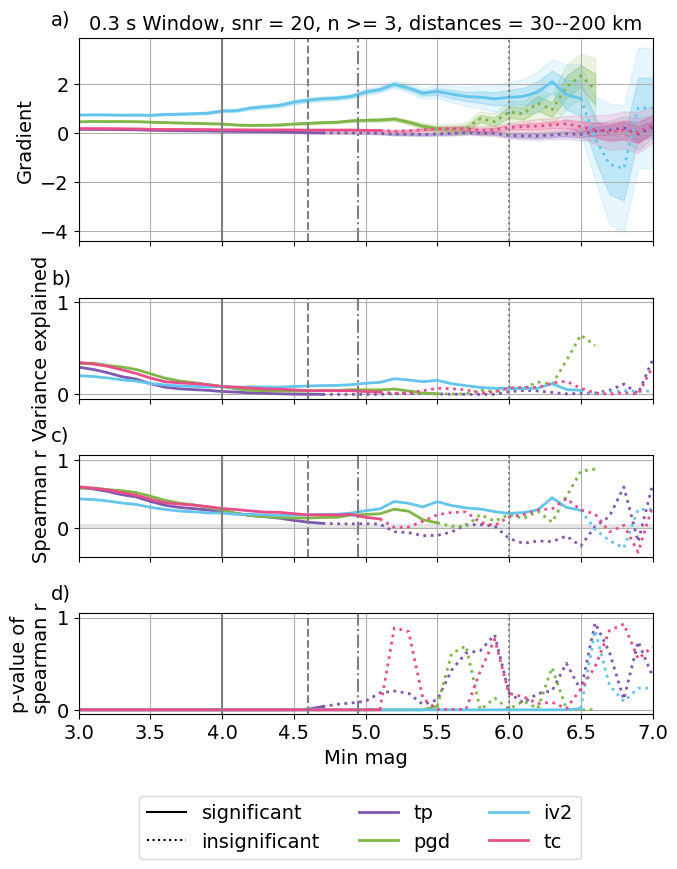

tp 0.5885524480485894
pgd 0.5740884392313096
tc 0.5792978732883783
iv2 0.4201507515169582
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


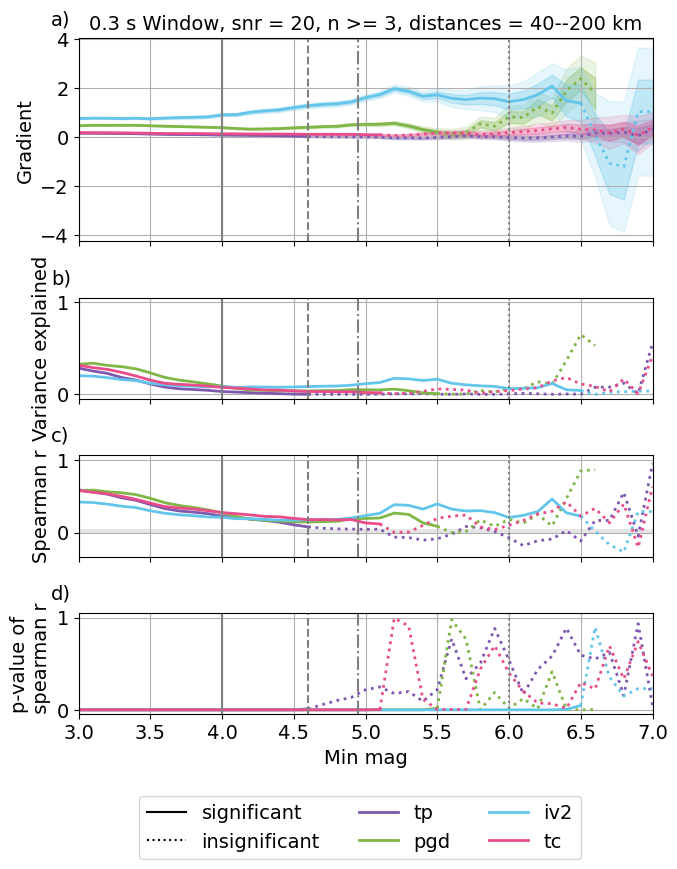

tp 0.5828302194711071
pgd 0.5813699664997308
tc 0.5470578559199536
iv2 0.43410504145221906
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


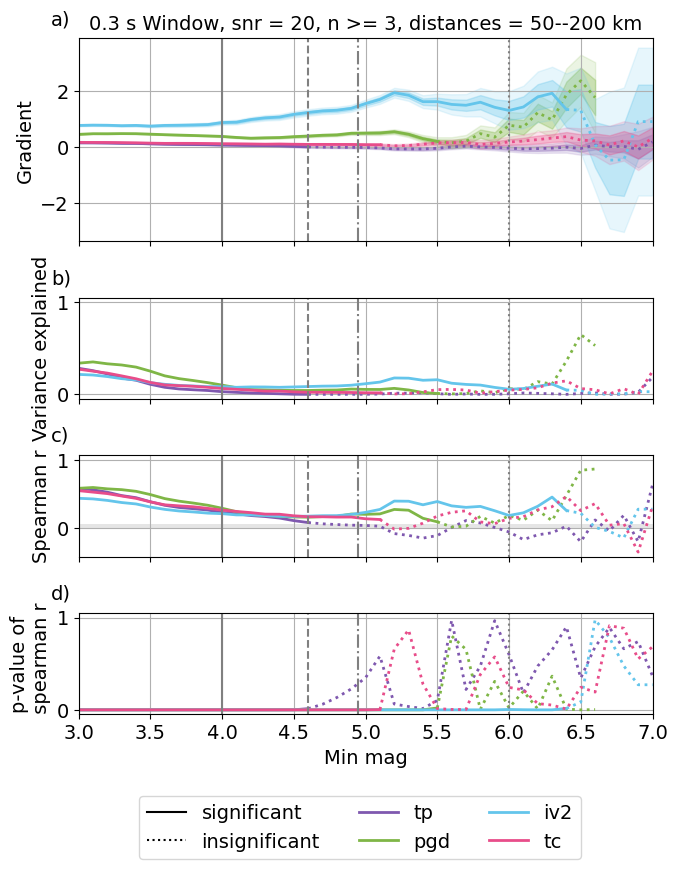

tp 0.5660429710005147
pgd 0.5847875799122799
tc 0.49109820639244195
iv2 0.4592348406390435
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


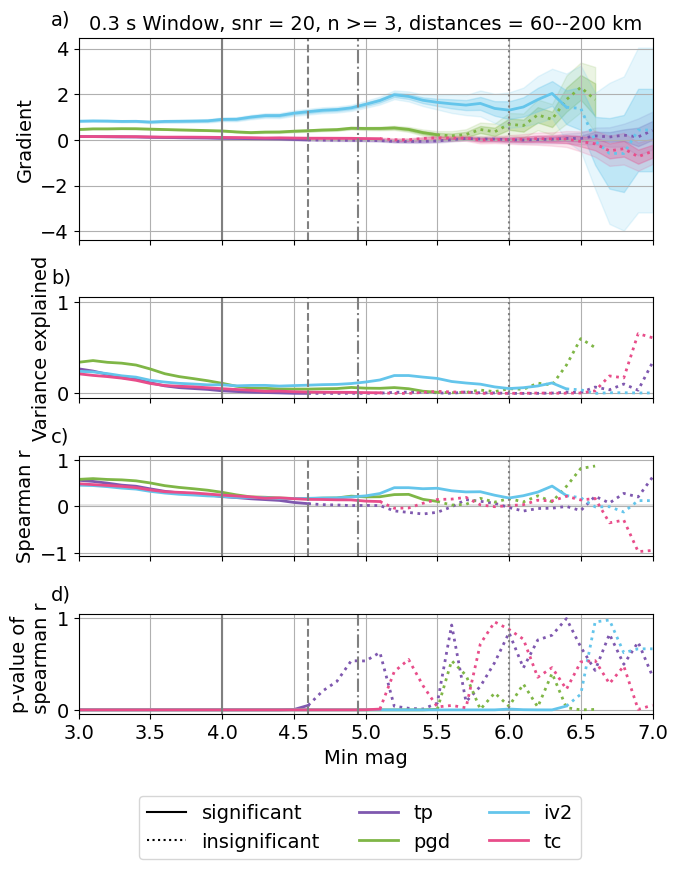

tp 0.5589024466614279
pgd 0.5926618266430642
tc 0.42709413091225884
iv2 0.49525542216291407
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


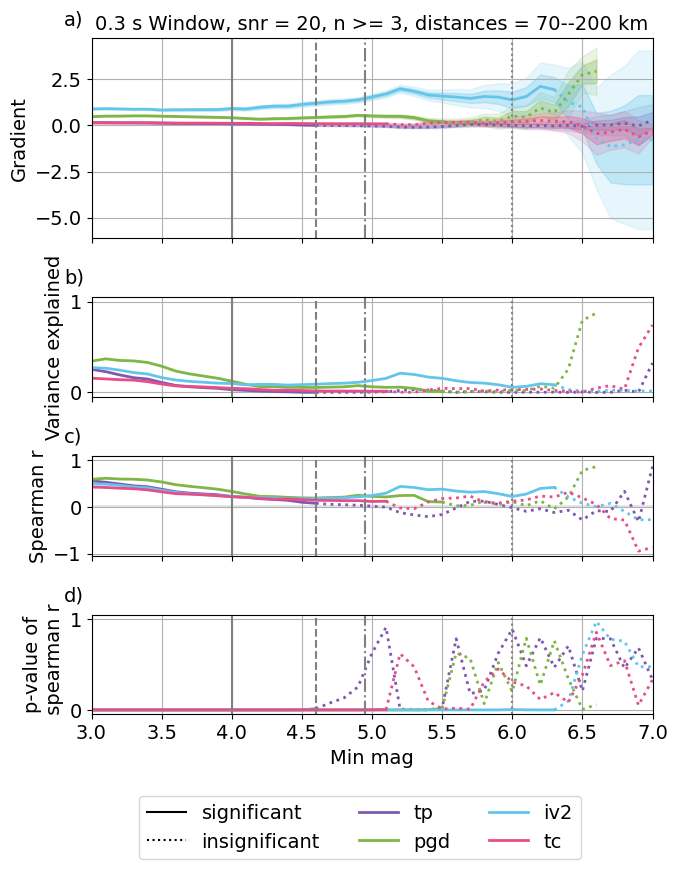

tp 0.5114172046390248
pgd 0.5918689469700742
tc 0.33686999972806925
iv2 0.5281399500540663
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


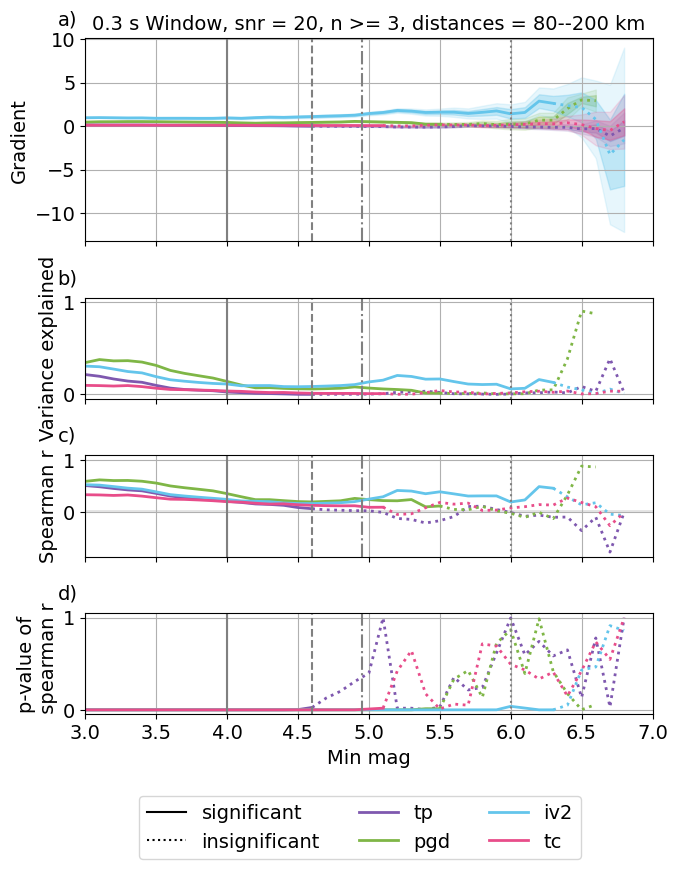

tp 0.48611814771505135
pgd 0.5771094494629057
tc 0.2633976828642425
iv2 0.531721268166309
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


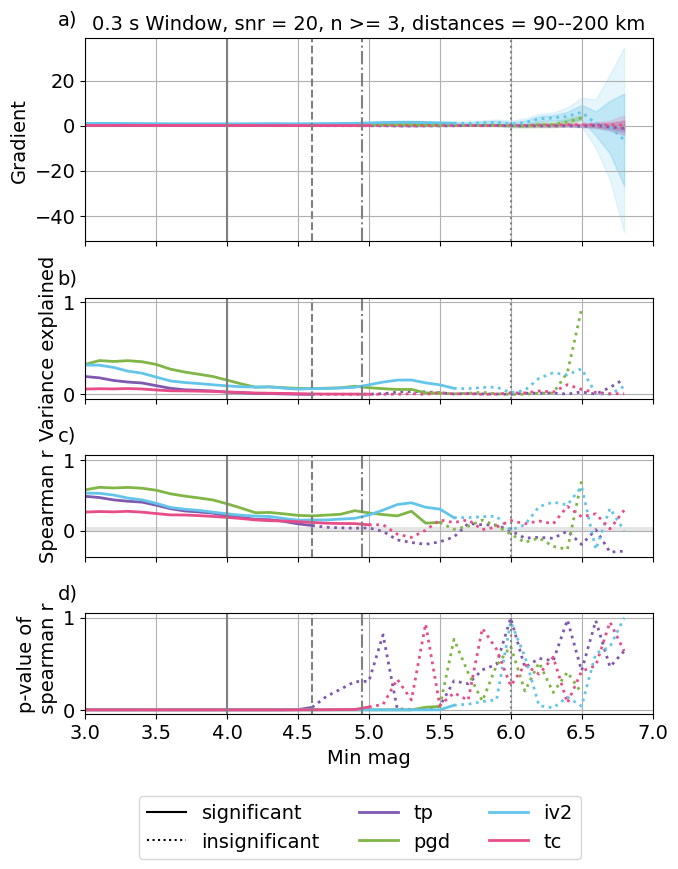

tp 0.6810834291034706
pgd 0.6013318285134083
tc 0.71163248654109
iv2 0.4349758146257554
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


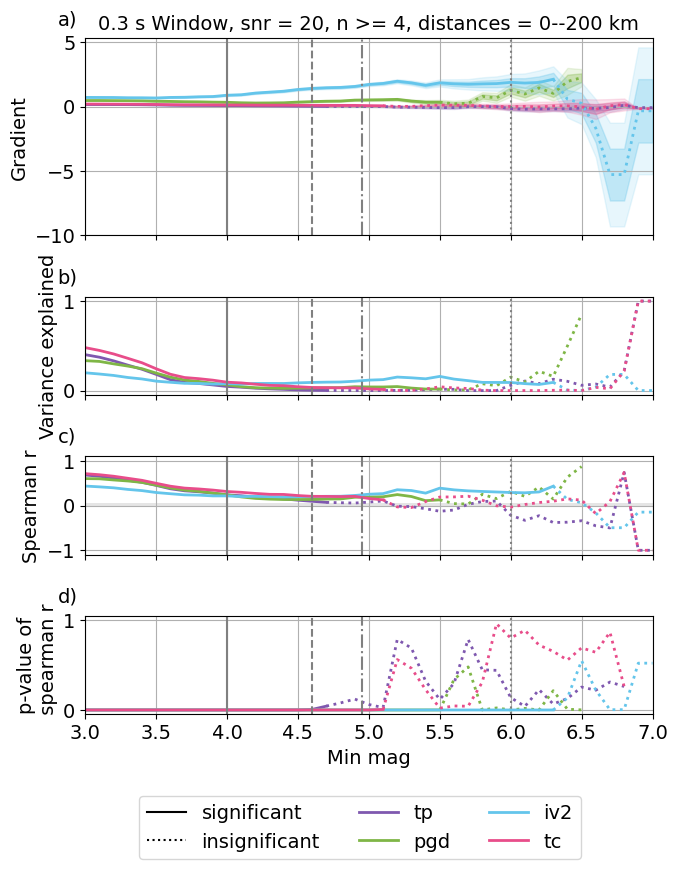

tp 0.6725264403404747
pgd 0.5950763667063226
tc 0.6905194445059392
iv2 0.4320813963327231
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


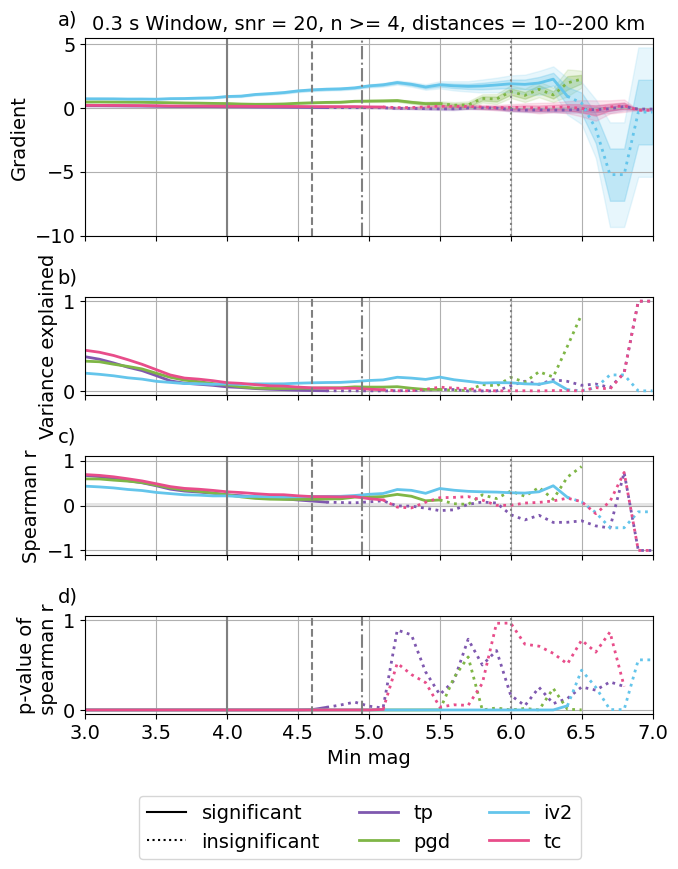

tp 0.6601755994231604
pgd 0.5874139615134824
tc 0.6785872660395736
iv2 0.4316270018151432
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


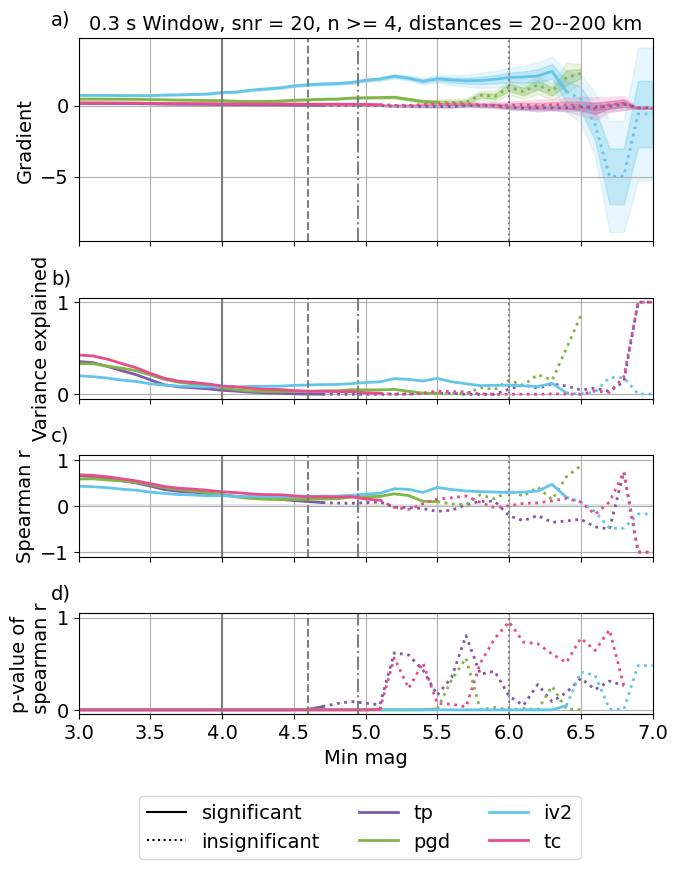

tp 0.648263956685415
pgd 0.5778556991769012
tc 0.6419173866861572
iv2 0.41963774346151383
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


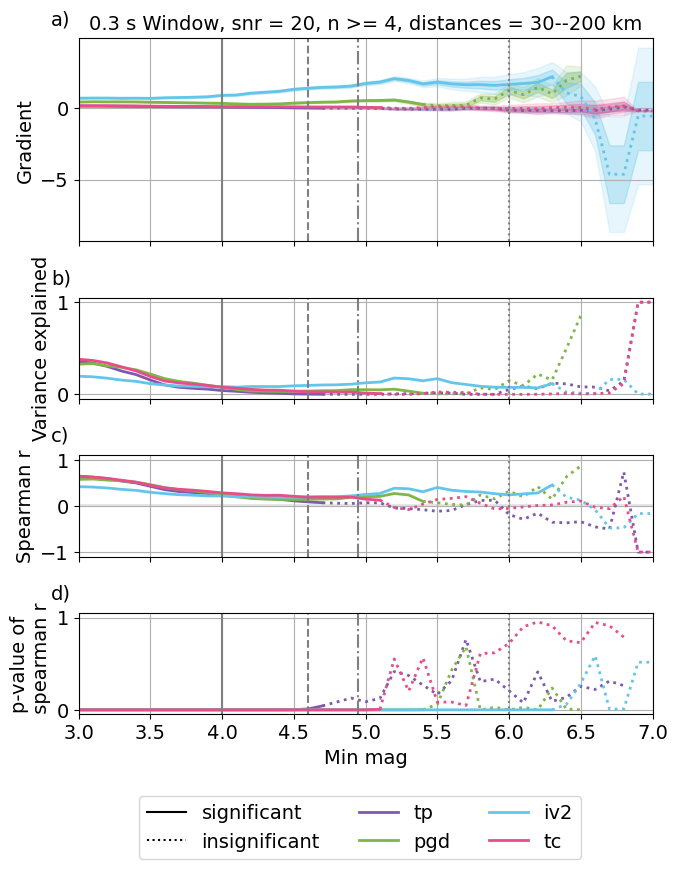

tp 0.6341895984094099
pgd 0.5715177567623386
tc 0.6149819945932068
iv2 0.41494970705159334
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


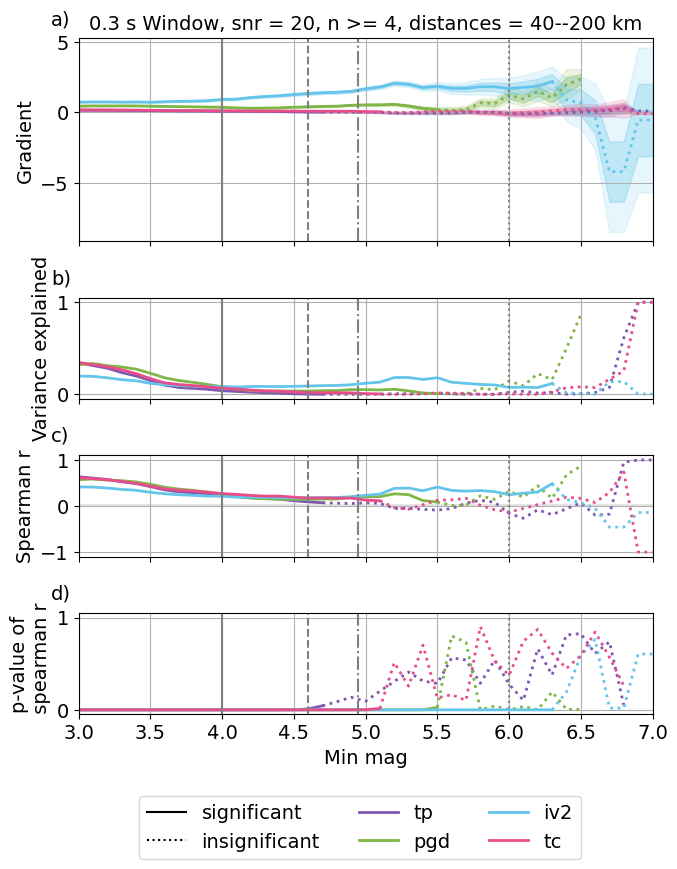

tp 0.627380315994737
pgd 0.5800909995408206
tc 0.5802516739405182
iv2 0.4307081200250849
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


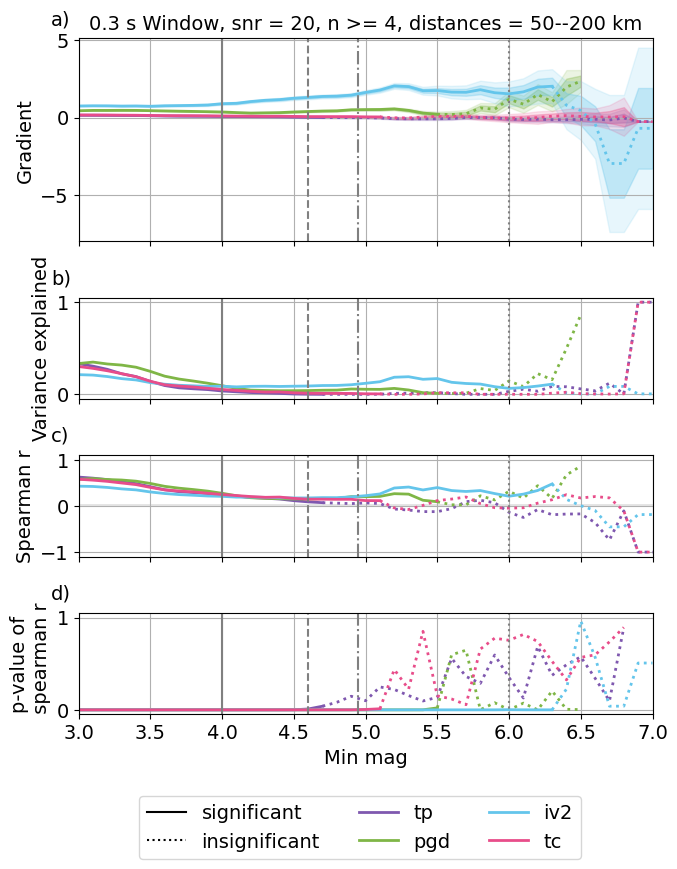

tp 0.60679664723645
pgd 0.5821599615570864
tc 0.5182434898558724
iv2 0.4573895049161443
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


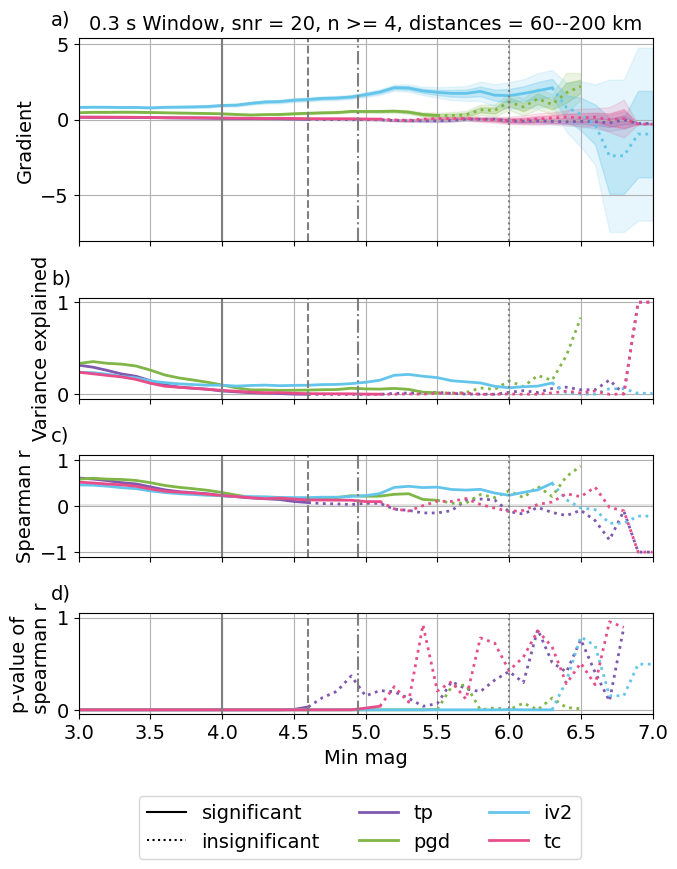

tp 0.5995983235030626
pgd 0.5893887412359582
tc 0.4463418463319018
iv2 0.4979425204784265
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


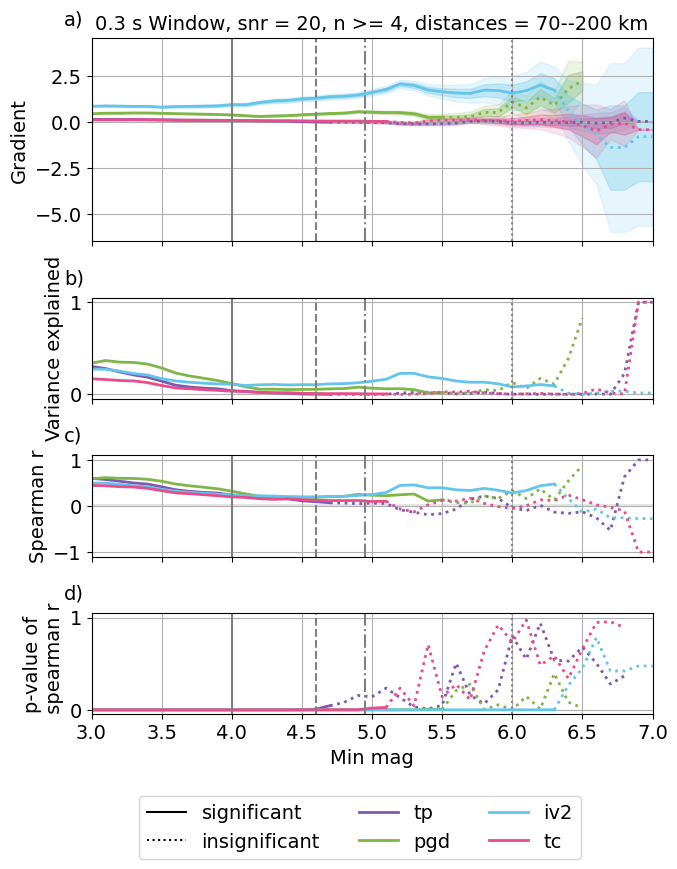

tp 0.5473075627137958
pgd 0.5867566262564179
tc 0.3471004025485127
iv2 0.5375806393980056
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


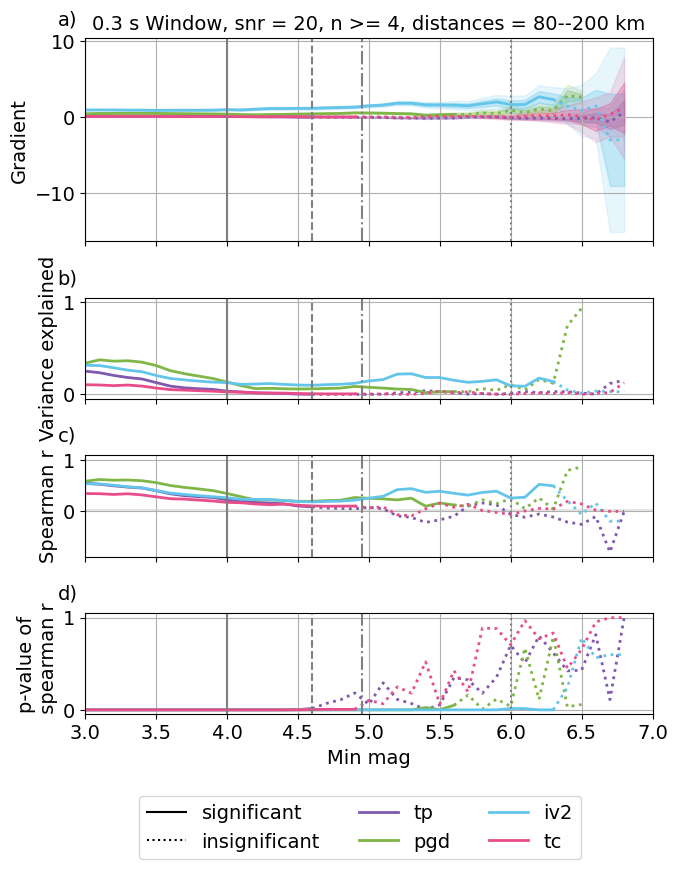

tp 0.5199800095289063
pgd 0.5679612276536217
tc 0.27238806793105147
iv2 0.538926898374247
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


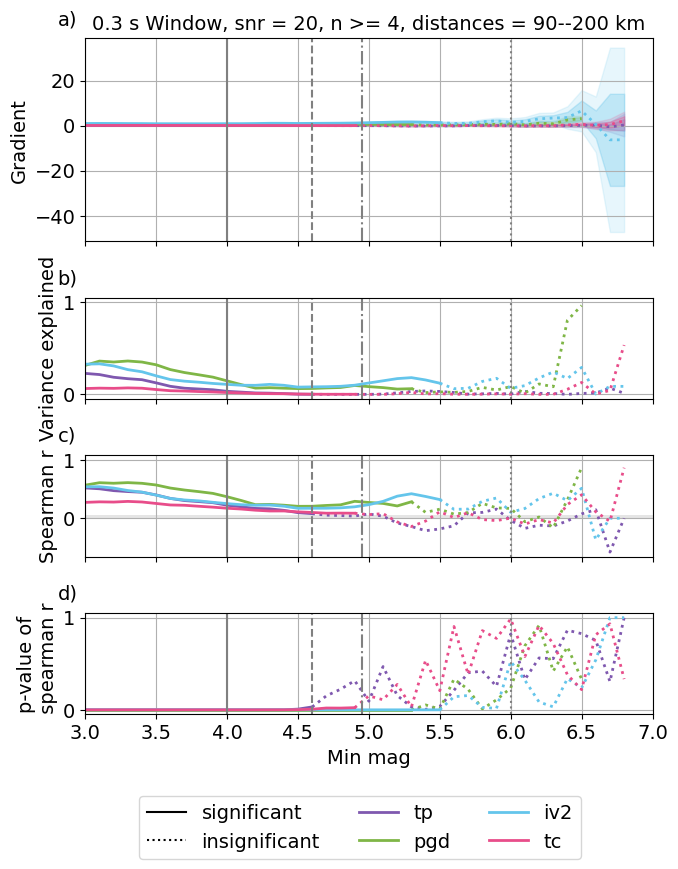

tp 0.7071228025532371
pgd 0.5988549272083004
tc 0.7370653565288269
iv2 0.4329540432680593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


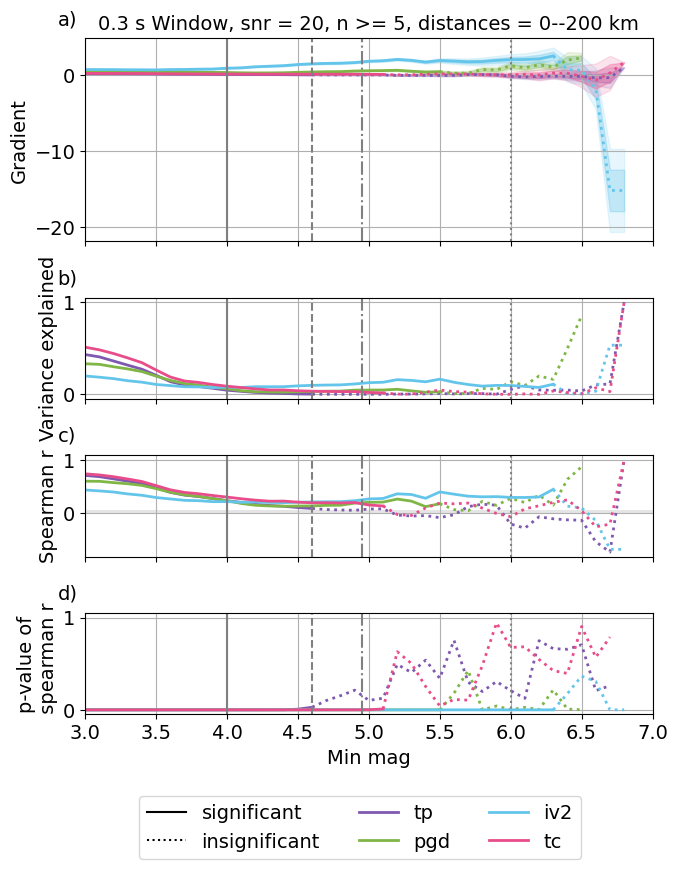

tp 0.6969080706450074
pgd 0.5934081012418666
tc 0.721880284069102
iv2 0.43013816453181947
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


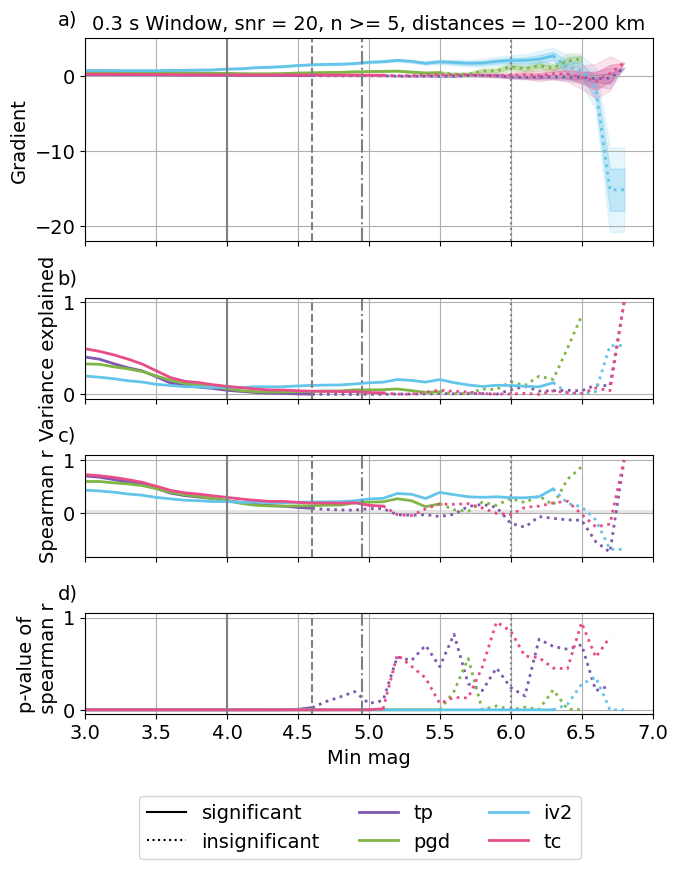

tp 0.6855048845683464
pgd 0.5870352164579598
tc 0.7085877481996729
iv2 0.43062590543019896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


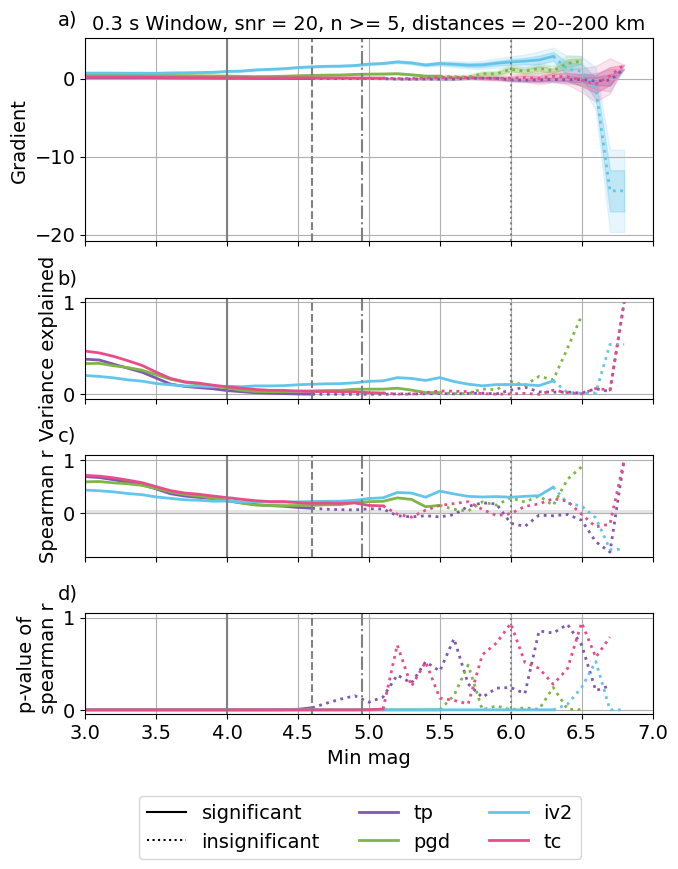

tp 0.6792403274382922
pgd 0.5794724209631974
tc 0.6770631699768977
iv2 0.4196166727093648
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


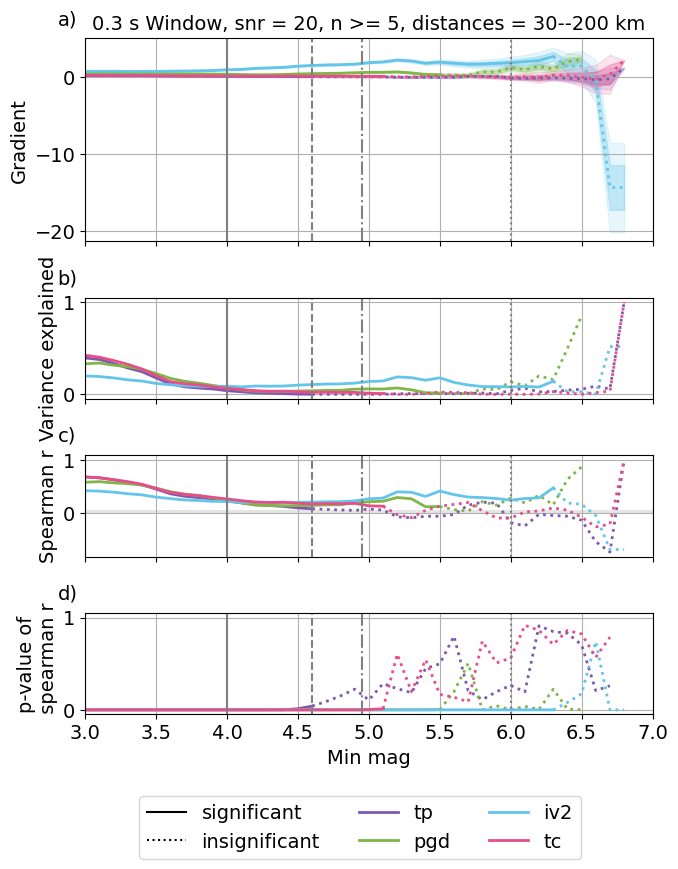

tp 0.6676090375572391
pgd 0.5751348898666279
tc 0.646640798277084
iv2 0.4157422038516936
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


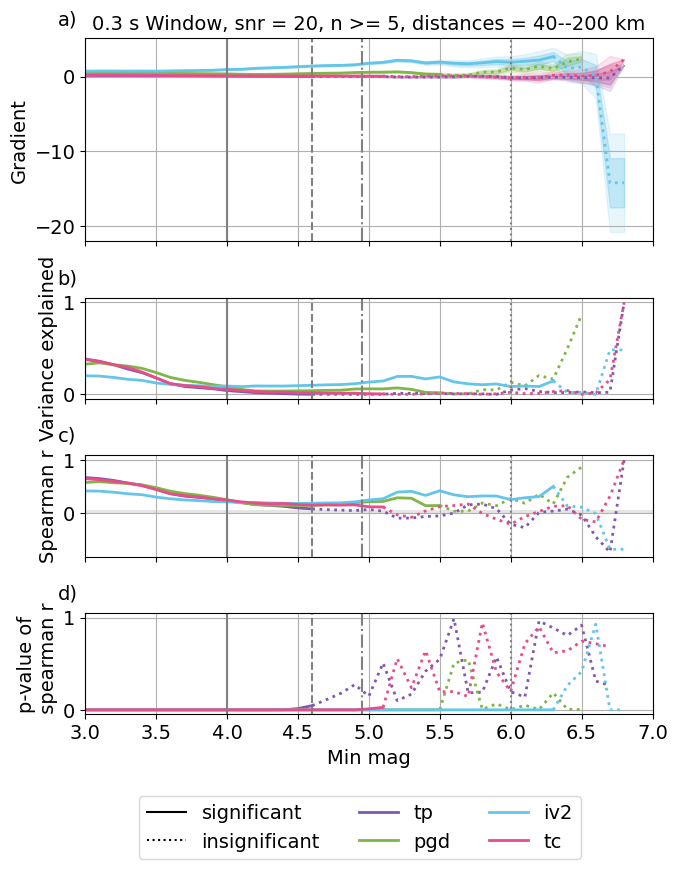

tp 0.6563467733736706
pgd 0.5848745521627388
tc 0.6172567106317592
iv2 0.43239497220617634
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


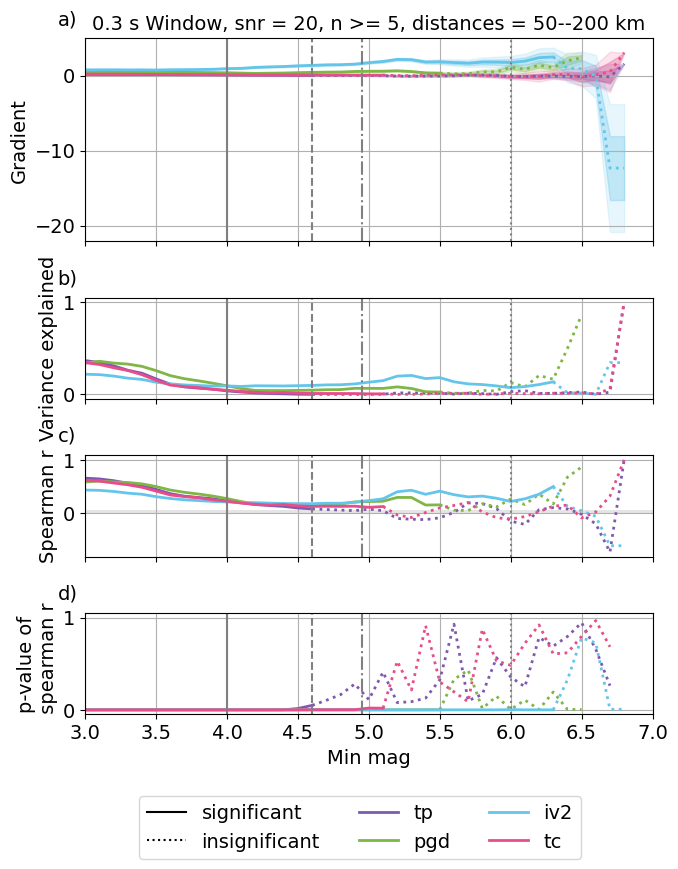

tp 0.6334111301095826
pgd 0.5874965271789833
tc 0.5572741070859464
iv2 0.4577859652169467
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


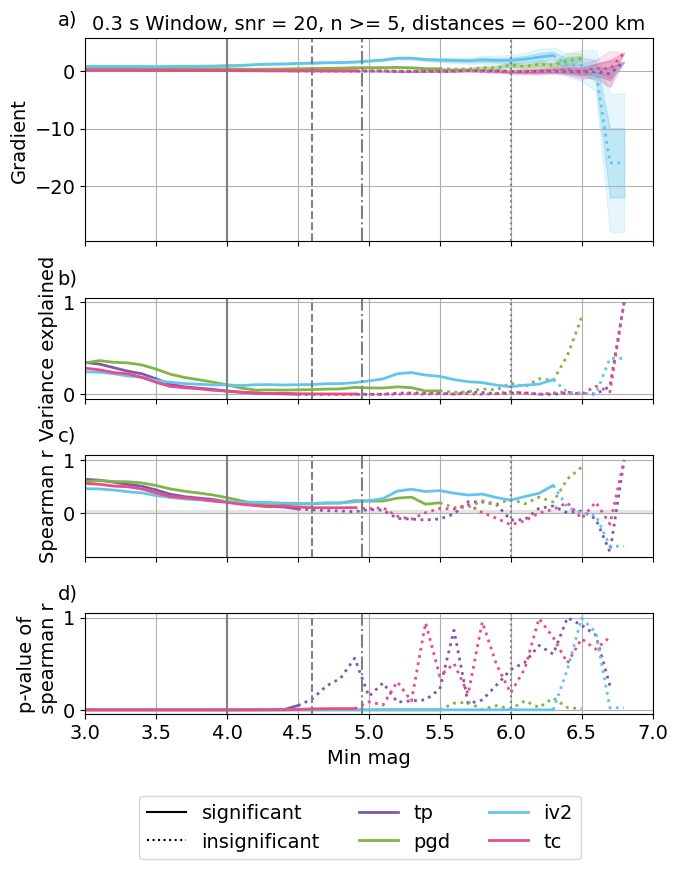

tp 0.6256455359977042
pgd 0.5927989827571155
tc 0.48163893858709417
iv2 0.5007047840759045
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


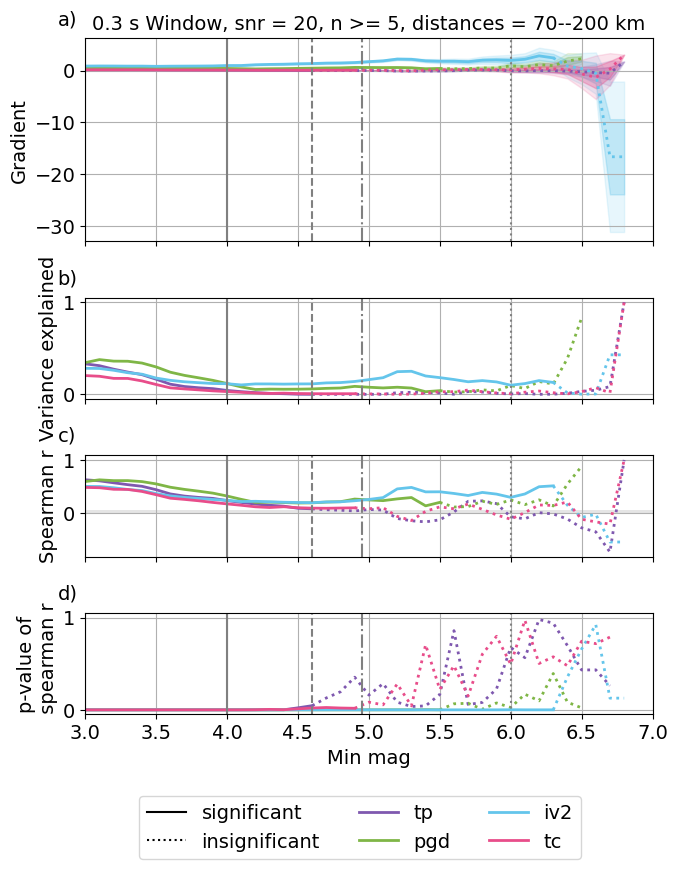

tp 0.5656527689939024
pgd 0.5921408840423417
tc 0.3645939598837362
iv2 0.5487820506199463
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


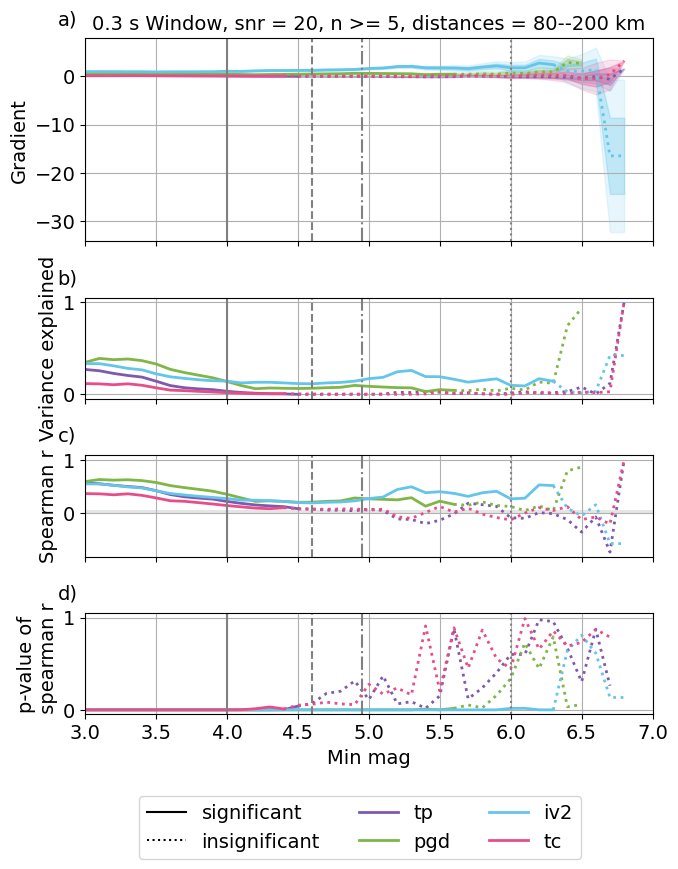

tp 0.5468524319583561
pgd 0.5725582574329569
tc 0.28336444893393886
iv2 0.5564569980431502
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


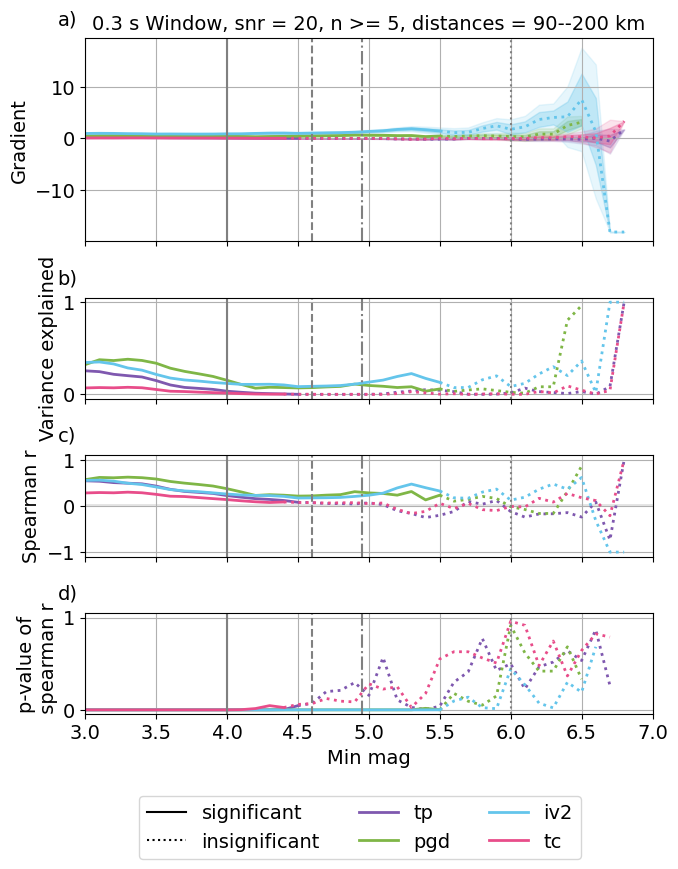

tp 0.7305420989943451
pgd 0.5936173459584555
tc 0.7538036489407042
iv2 0.427607911706213
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


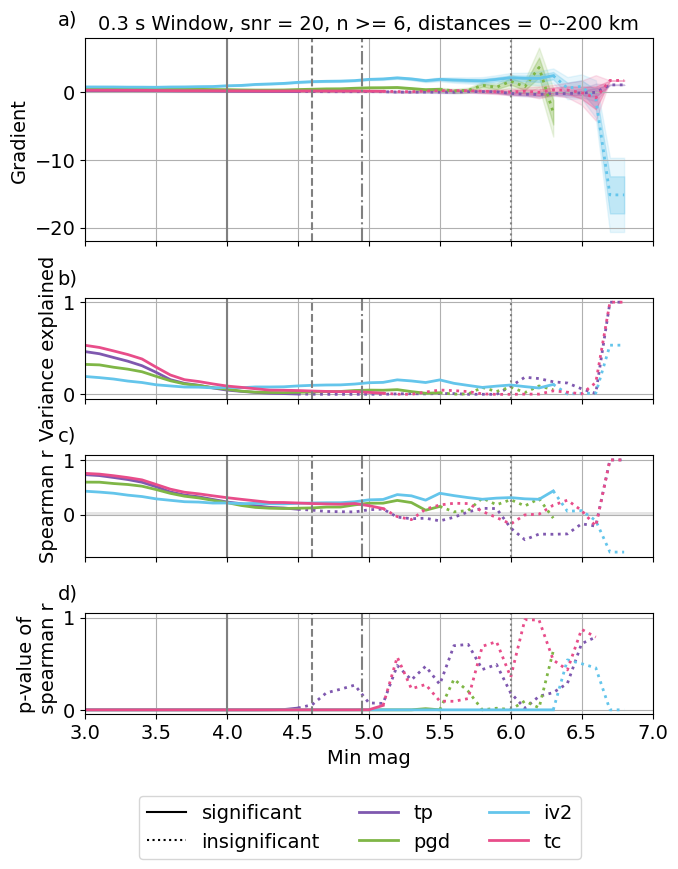

tp 0.7202158835015418
pgd 0.5877728750953792
tc 0.7380677793587401
iv2 0.4253069331276153
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


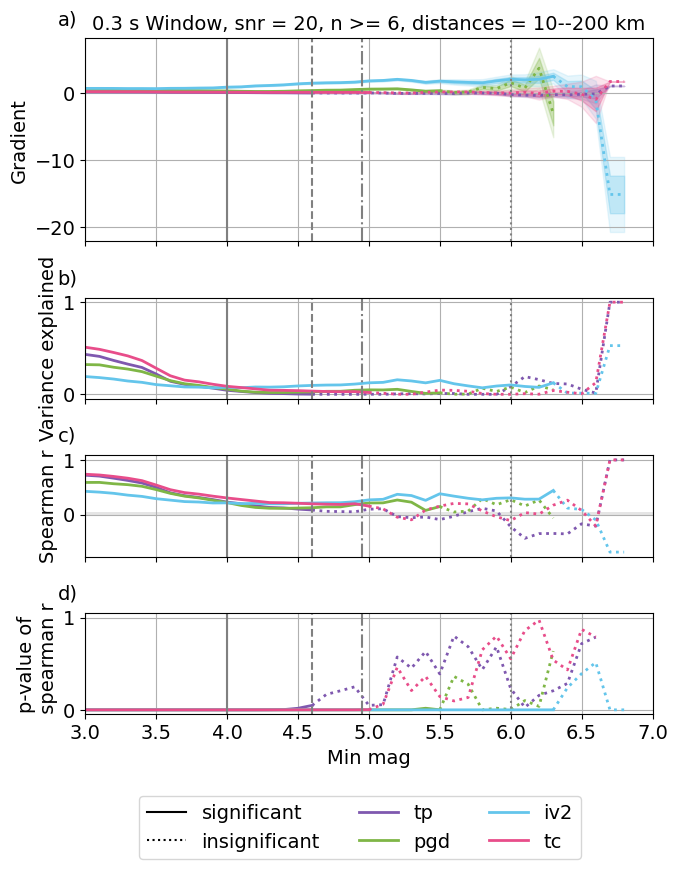

tp 0.7076106299581253
pgd 0.5816958962721672
tc 0.7300144798117443
iv2 0.4254215307372914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


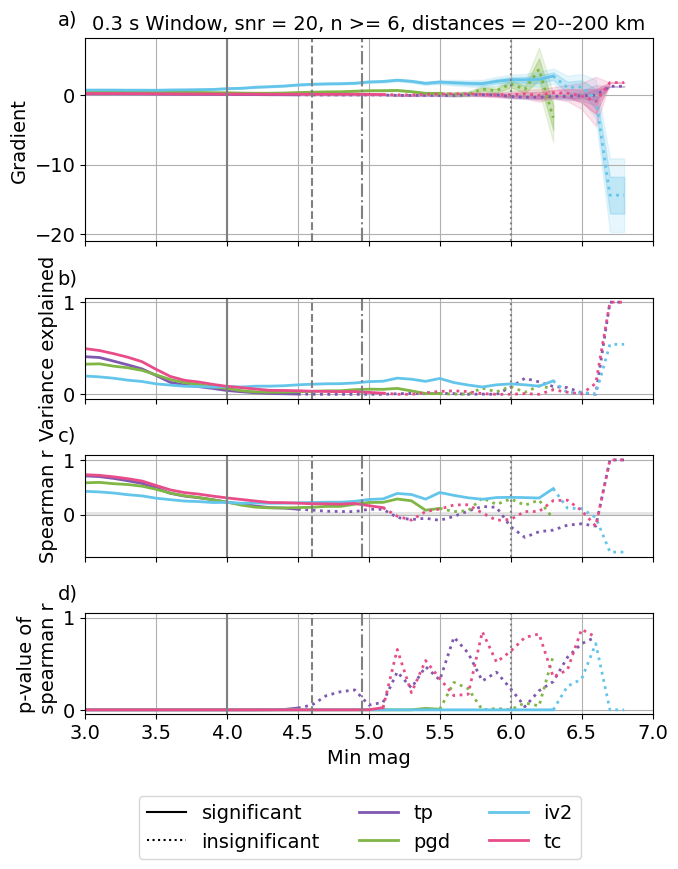

tp 0.7105226801113884
pgd 0.5755799166232733
tc 0.7100850133352514
iv2 0.41510467906007376
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


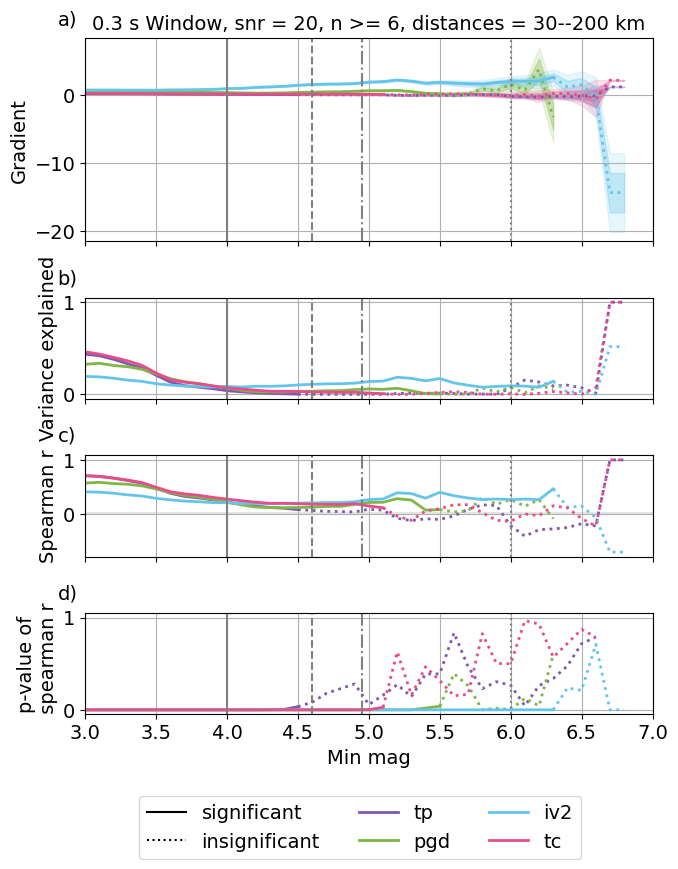

tp 0.7002417785065108
pgd 0.5719427017326384
tc 0.6819040801384336
iv2 0.4110916152548353
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


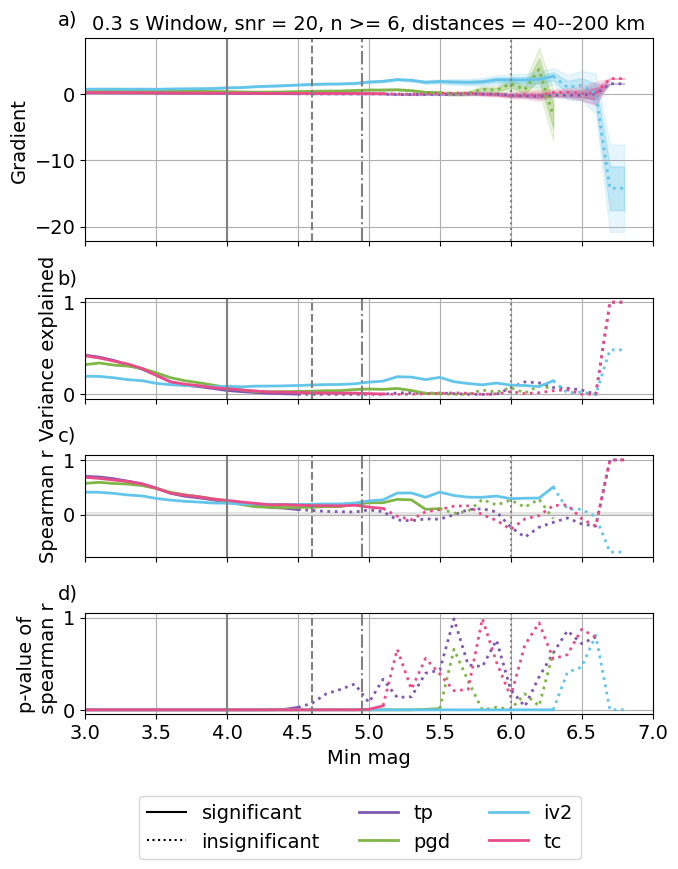

tp 0.6902925367881428
pgd 0.5812842409194559
tc 0.6511900212987742
iv2 0.42597882183670954
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


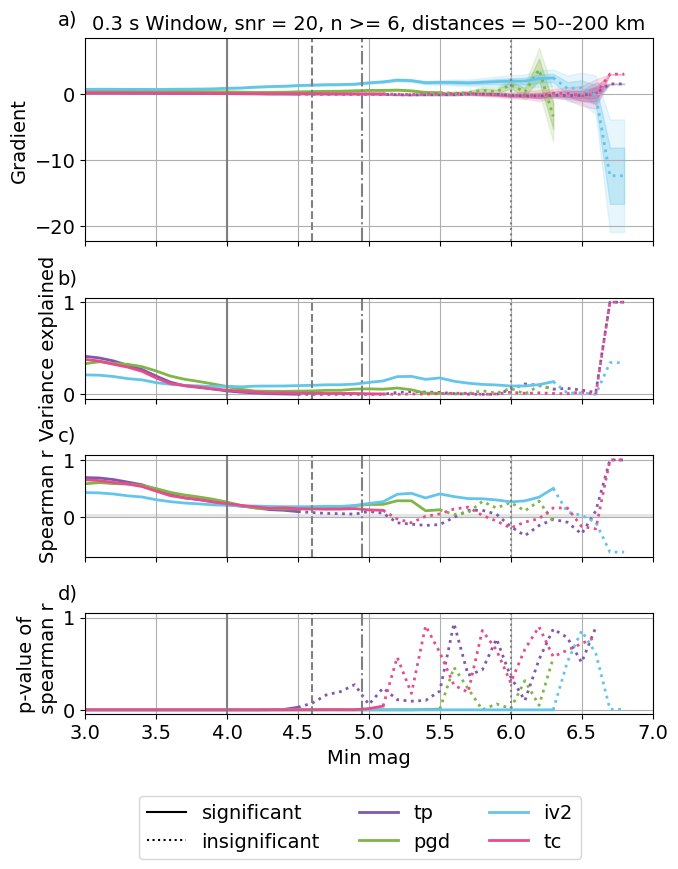

tp 0.6637659654652177
pgd 0.5839536088543474
tc 0.5866057587051771
iv2 0.4520937089594897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


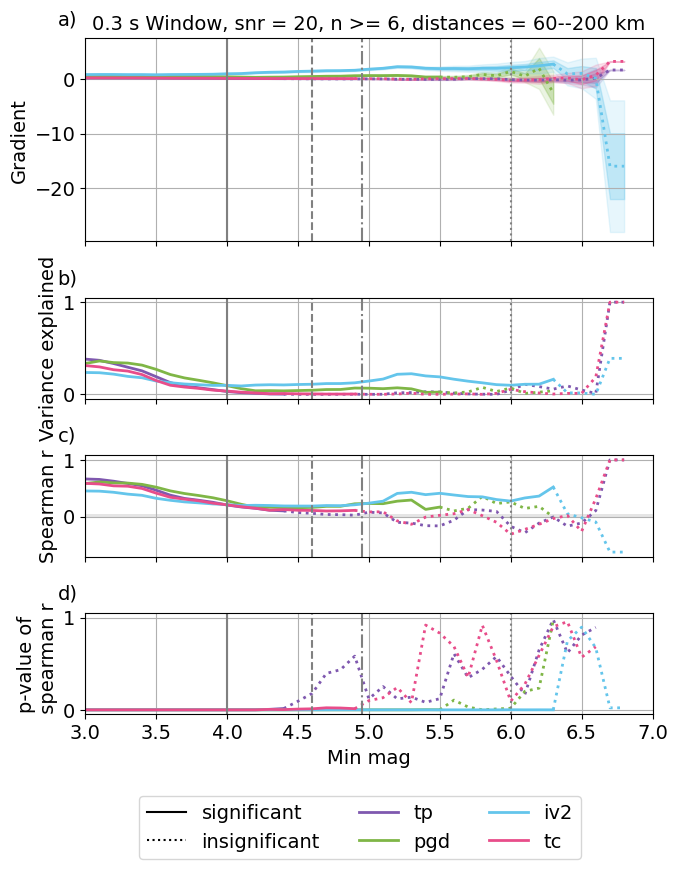

tp 0.6578810375184575
pgd 0.5892667837333755
tc 0.5077655174990929
iv2 0.49587338341095594
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


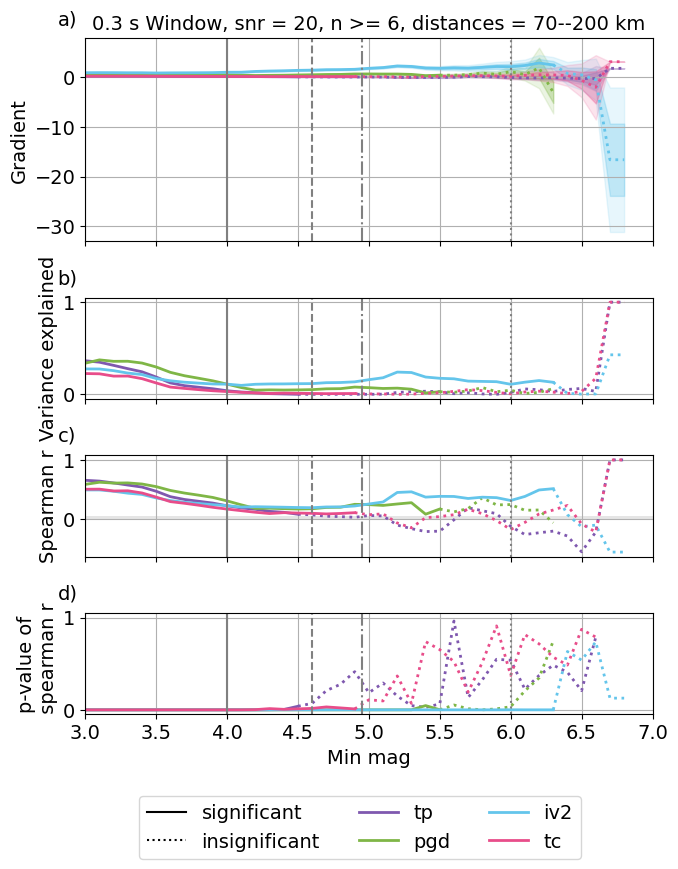

tp 0.5962081158279374
pgd 0.5882396928979238
tc 0.37492626229442033
iv2 0.5503081213520603
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


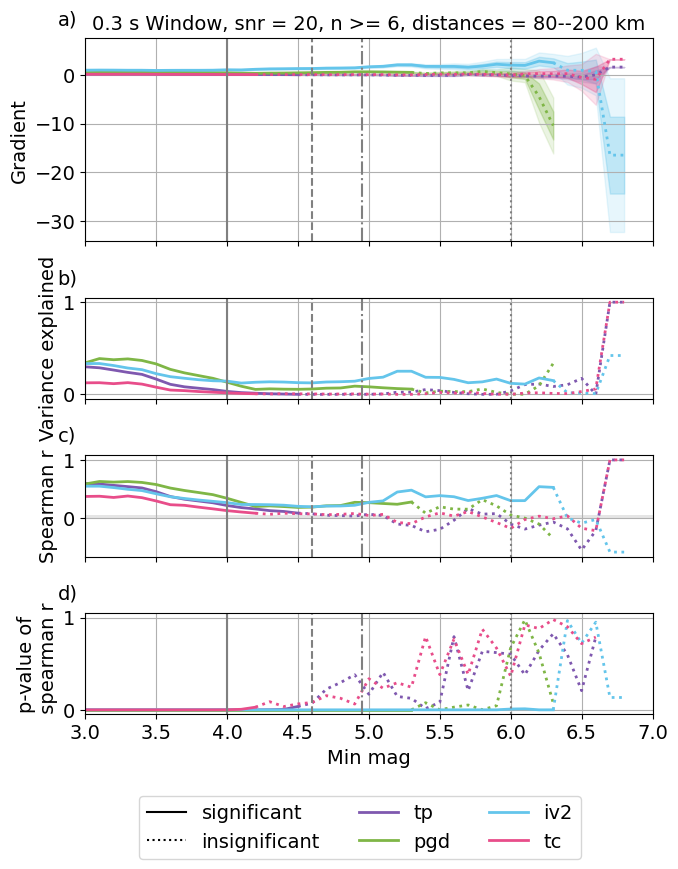

tp 0.5672105276281716
pgd 0.5709166110660551
tc 0.29880283013141207
iv2 0.5624090741856489
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


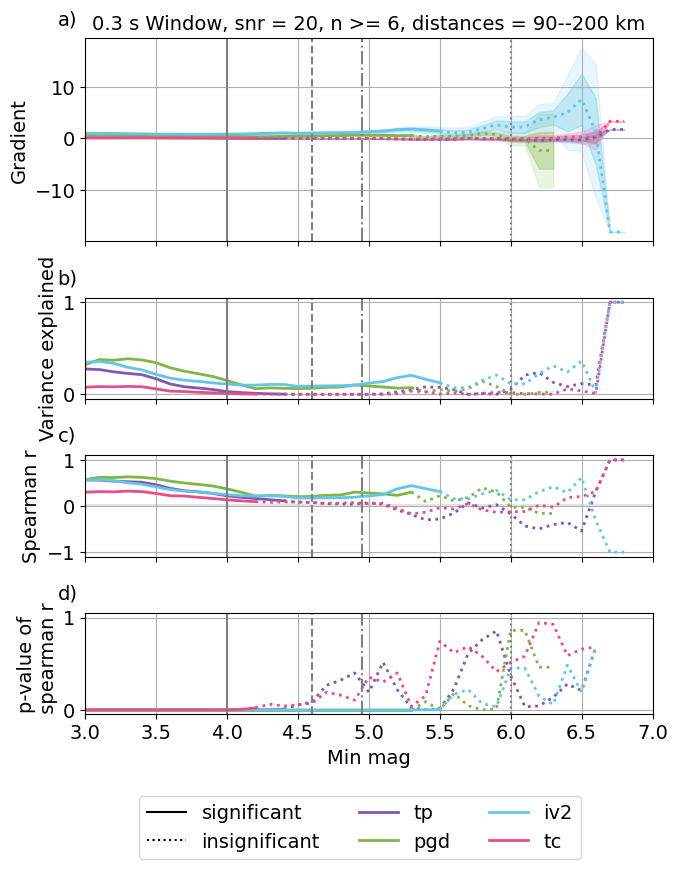

eq_object_05s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.526911144980591
pgd 0.7009132152553517
tc 0.6848619924192391
iv2 0.546661181167167
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


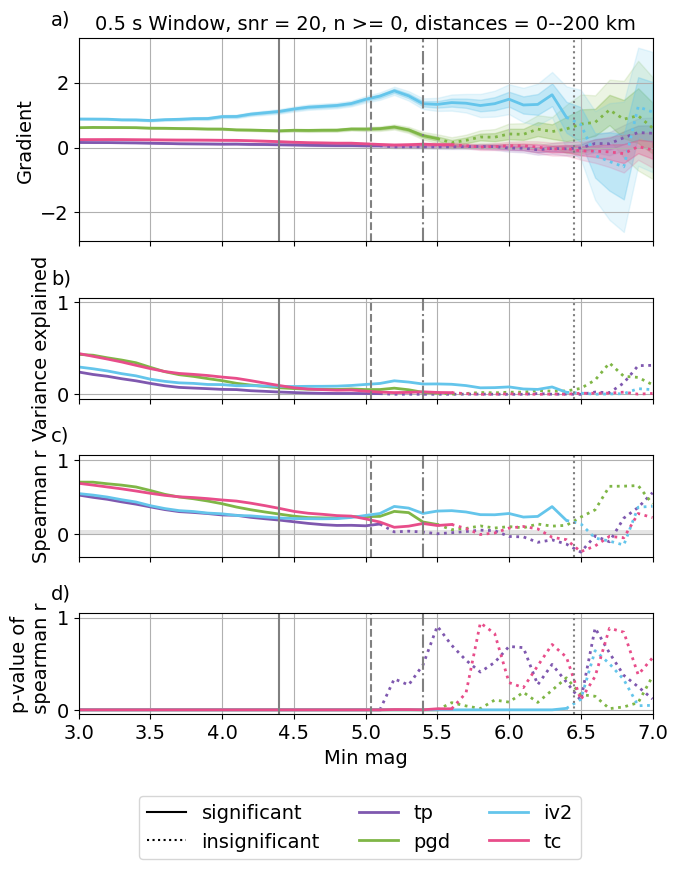

tp 0.5171888391616406
pgd 0.6961748122512399
tc 0.6756123891437886
iv2 0.5434957815338146
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


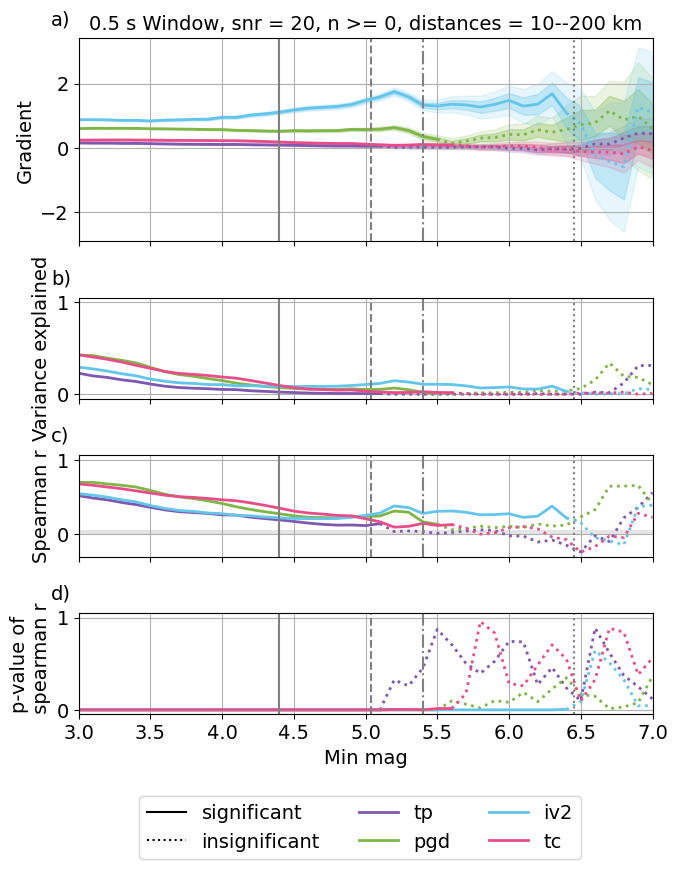

tp 0.5026810809746507
pgd 0.6863868952976343
tc 0.6637191264010797
iv2 0.5336474102228052
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


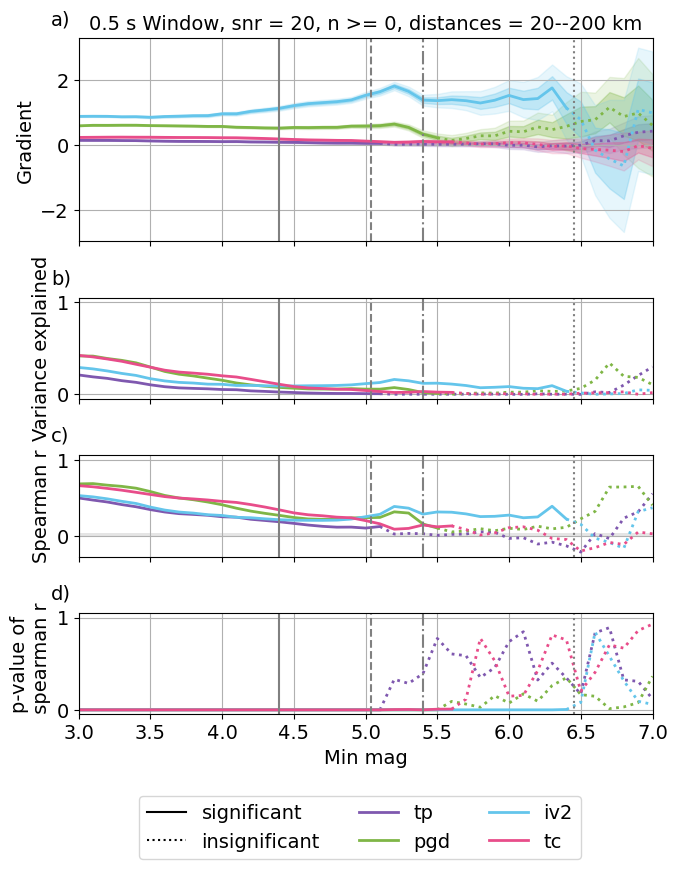

tp 0.49790292931236035
pgd 0.6745678349285876
tc 0.6404731890776708
iv2 0.5168773902086966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


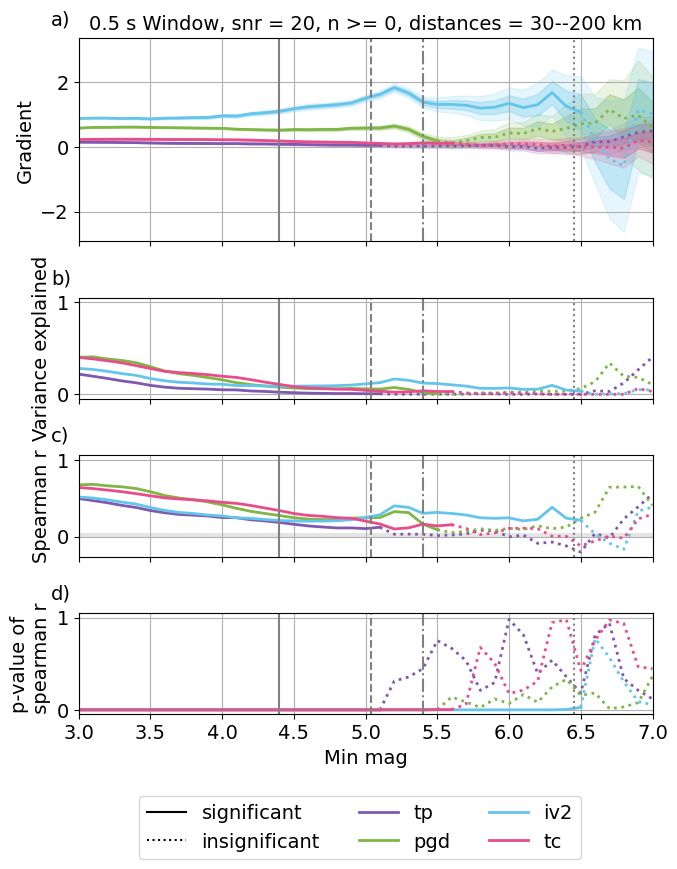

tp 0.4865298543089198
pgd 0.6643355659431396
tc 0.6234478840523544
iv2 0.5024259728416122
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


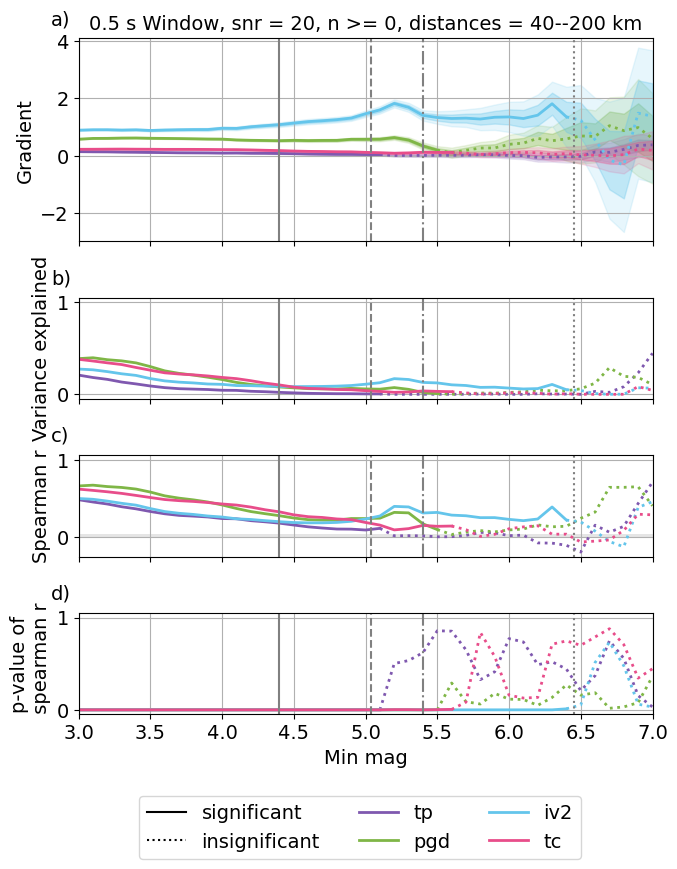

tp 0.4772249100808634
pgd 0.6669855195968508
tc 0.6036613747873858
iv2 0.5116439496308781
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


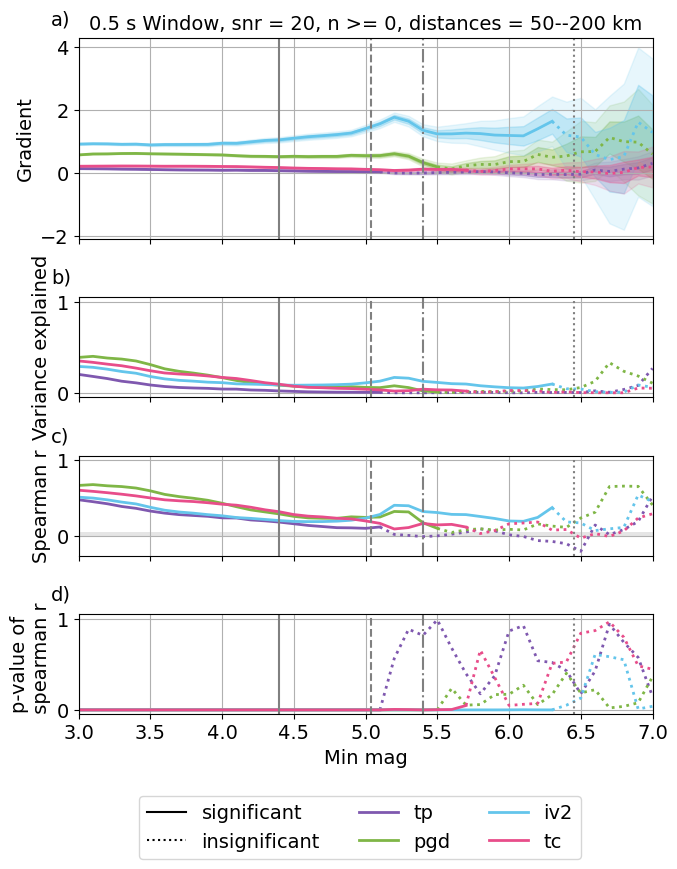

tp 0.46149441312689754
pgd 0.6683540353450487
tc 0.5742096962336667
iv2 0.5285211631078217
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


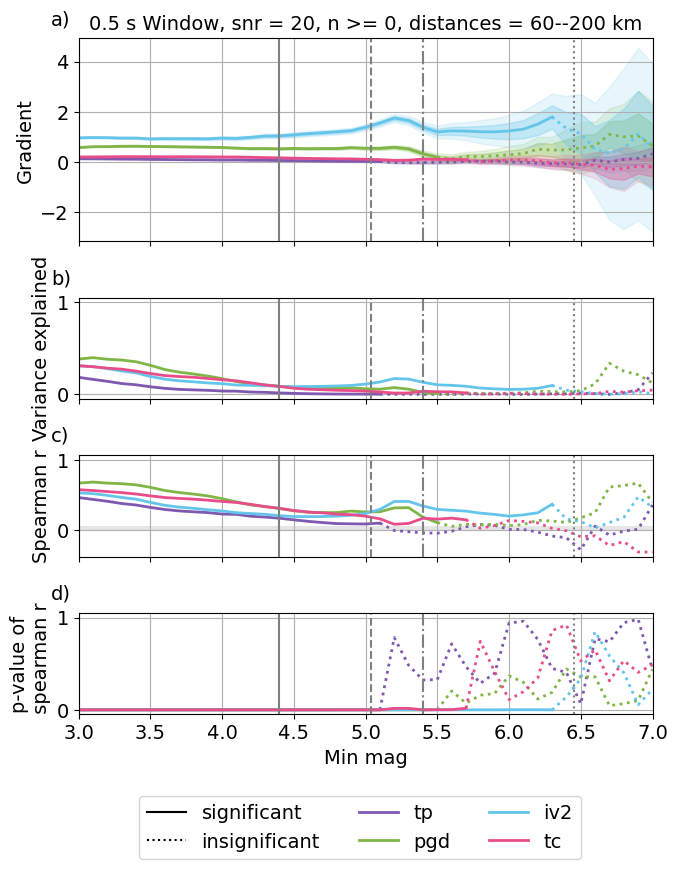

tp 0.4592277436860772
pgd 0.6745416156344536
tc 0.5346642661035577
iv2 0.5557941246662619
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


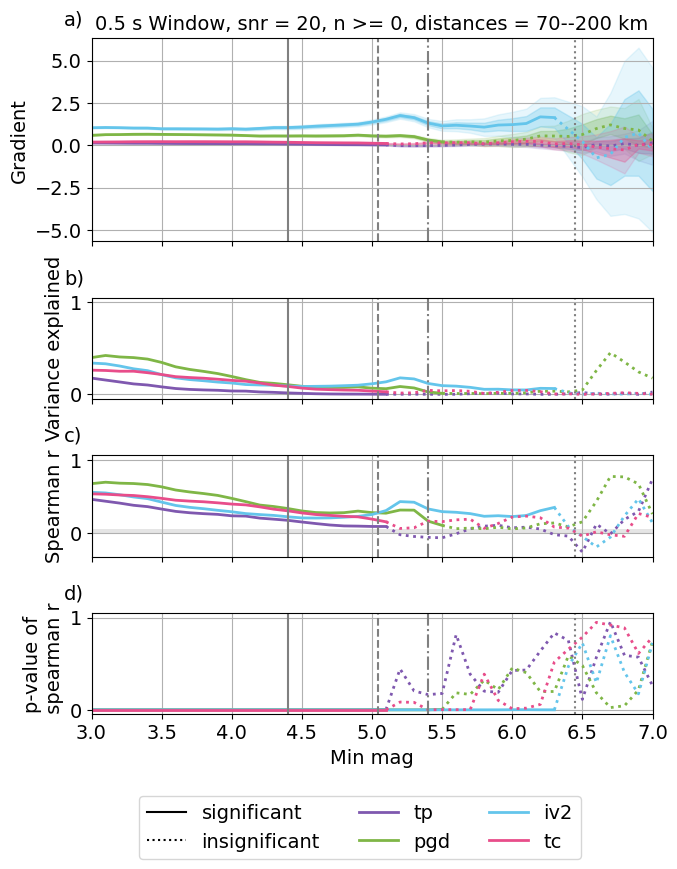

tp 0.43669265485947106
pgd 0.6697005000054757
tc 0.4744847503220214
iv2 0.5715944060005956
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


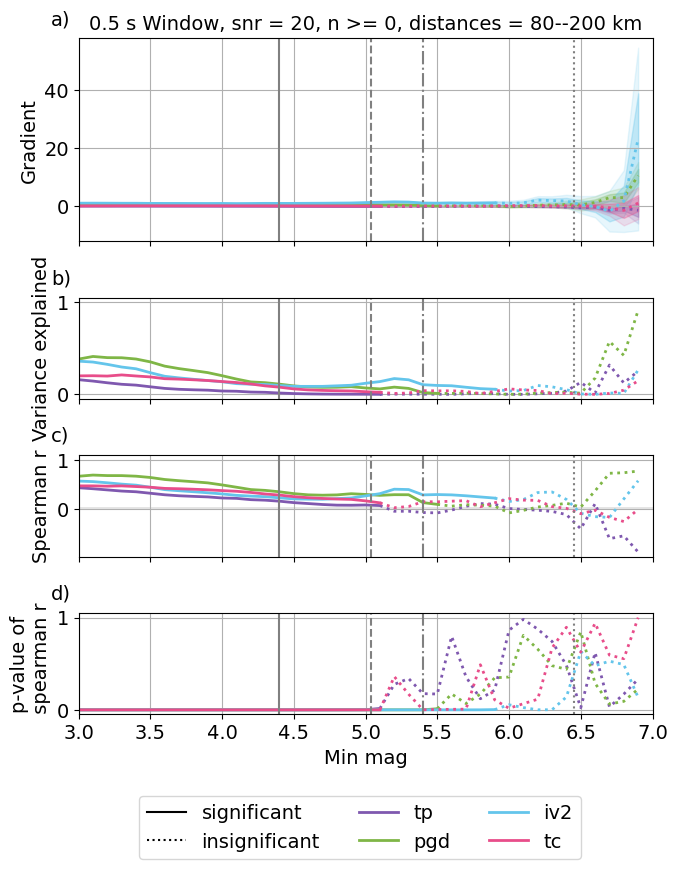

tp 0.4176262117270644
pgd 0.6575486915245613
tc 0.4255061887875776
iv2 0.5639587194318232
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


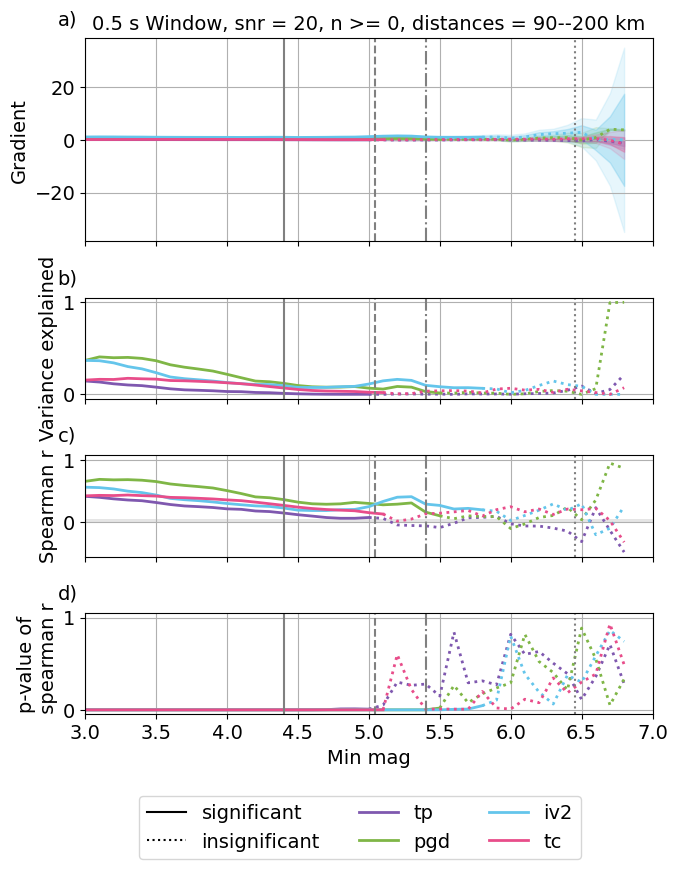

tp 0.526911144980591
pgd 0.7009132152553517
tc 0.6848619924192391
iv2 0.546661181167167
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


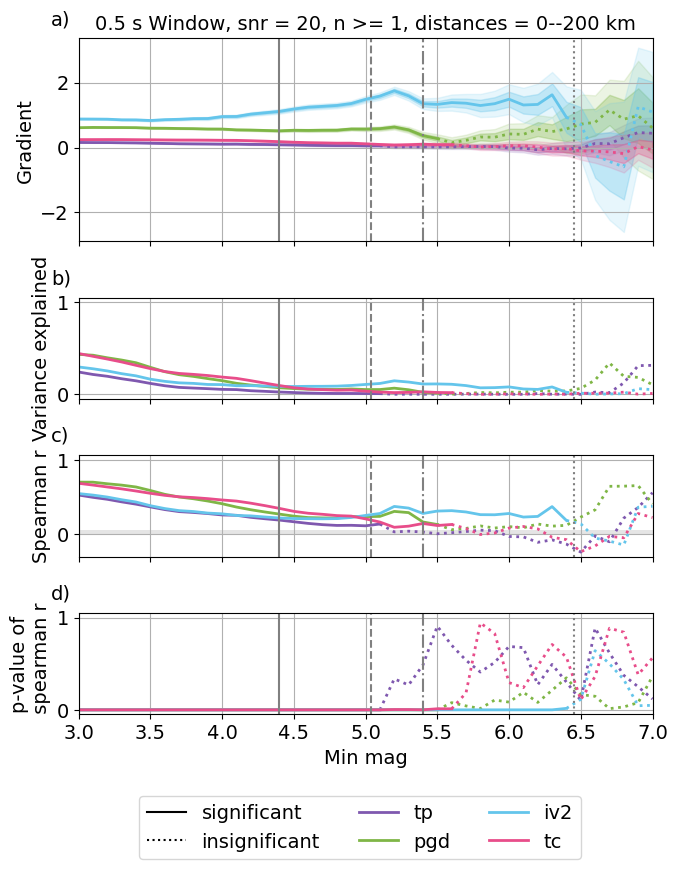

tp 0.5171888391616406
pgd 0.6961748122512399
tc 0.6756123891437886
iv2 0.5434957815338146
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


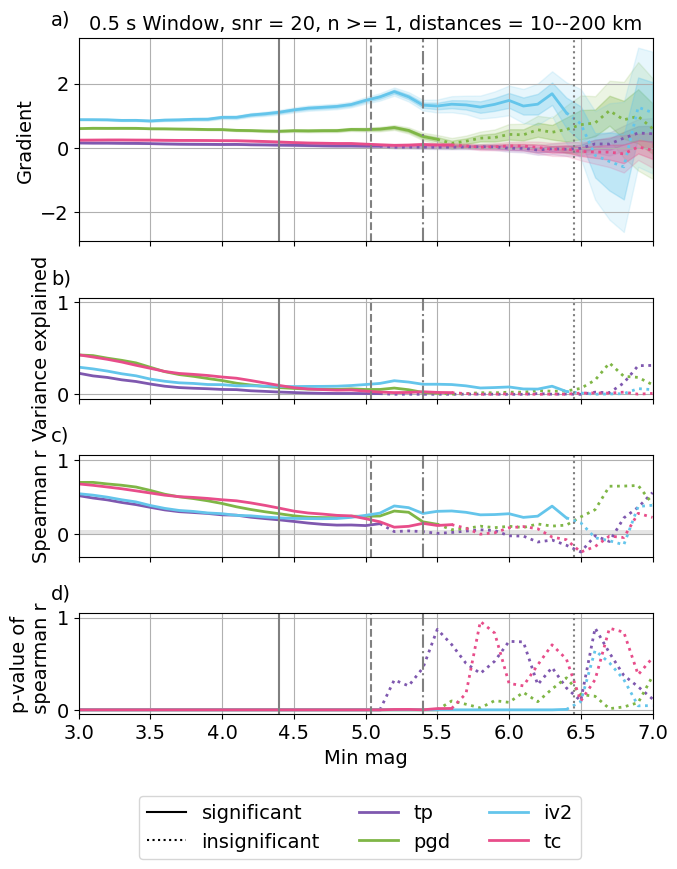

tp 0.5026810809746507
pgd 0.6863868952976343
tc 0.6637191264010797
iv2 0.5336474102228052
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


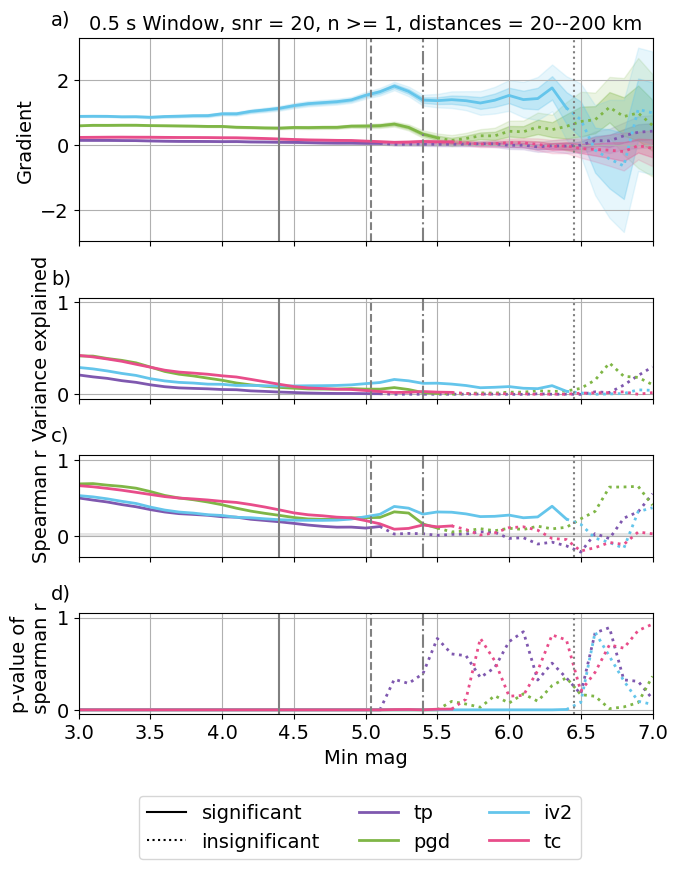

tp 0.49790292931236035
pgd 0.6745678349285876
tc 0.6404731890776708
iv2 0.5168773902086966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


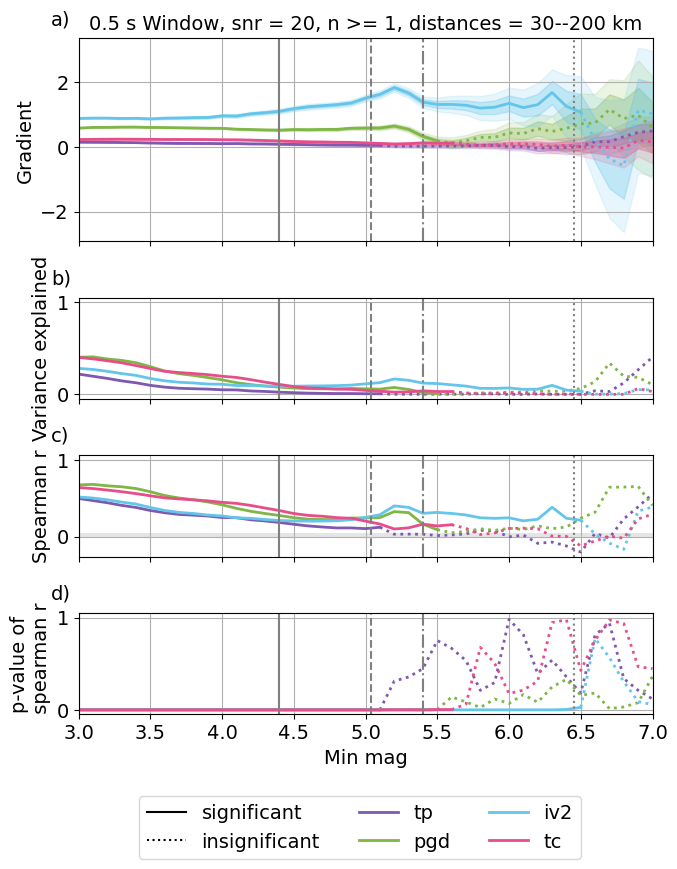

tp 0.4865298543089198
pgd 0.6643355659431396
tc 0.6234478840523544
iv2 0.5024259728416122
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


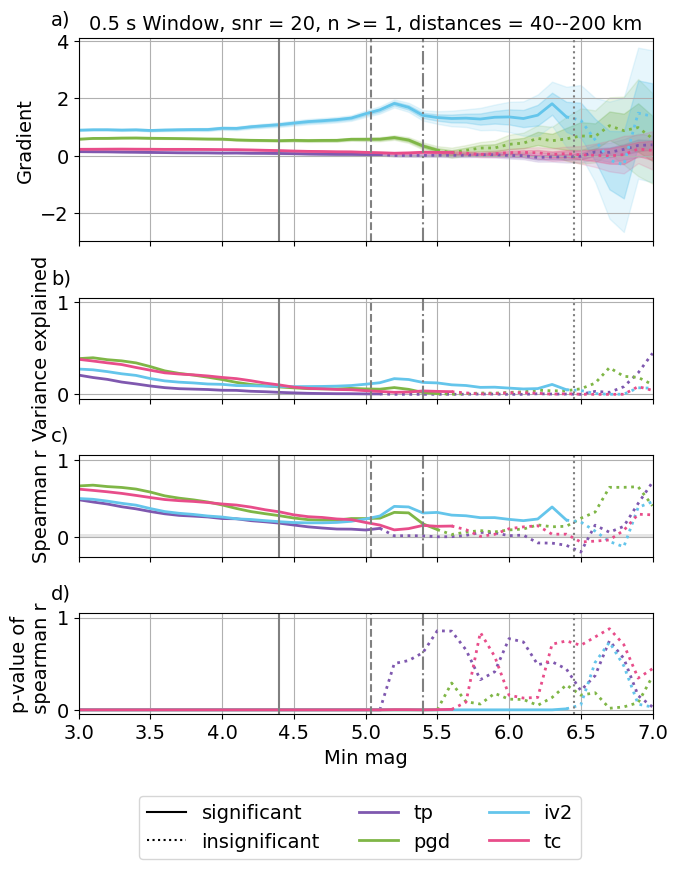

tp 0.4772249100808634
pgd 0.6669855195968508
tc 0.6036613747873858
iv2 0.5116439496308781
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


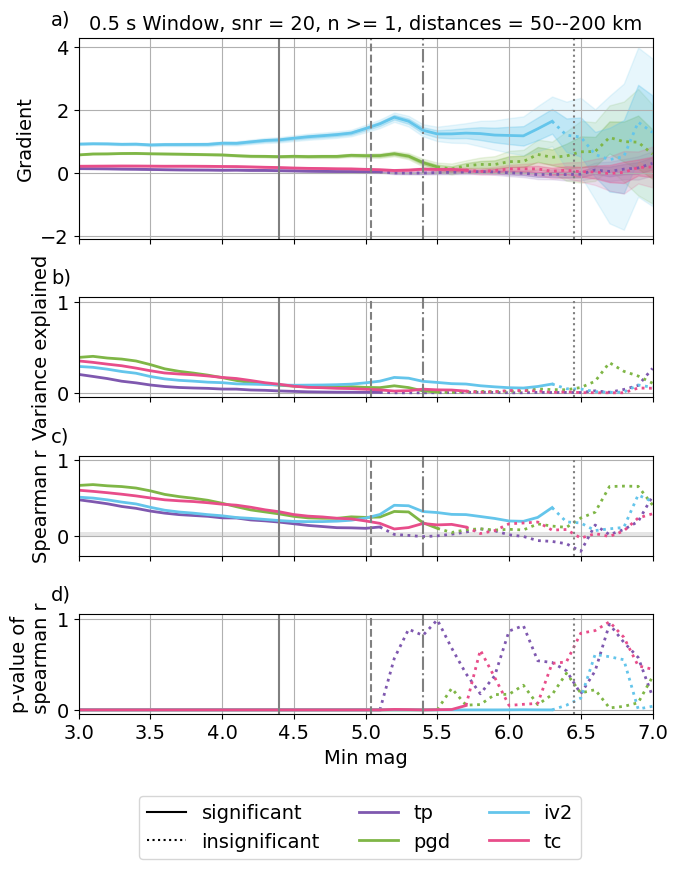

tp 0.46149441312689754
pgd 0.6683540353450487
tc 0.5742096962336667
iv2 0.5285211631078217
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


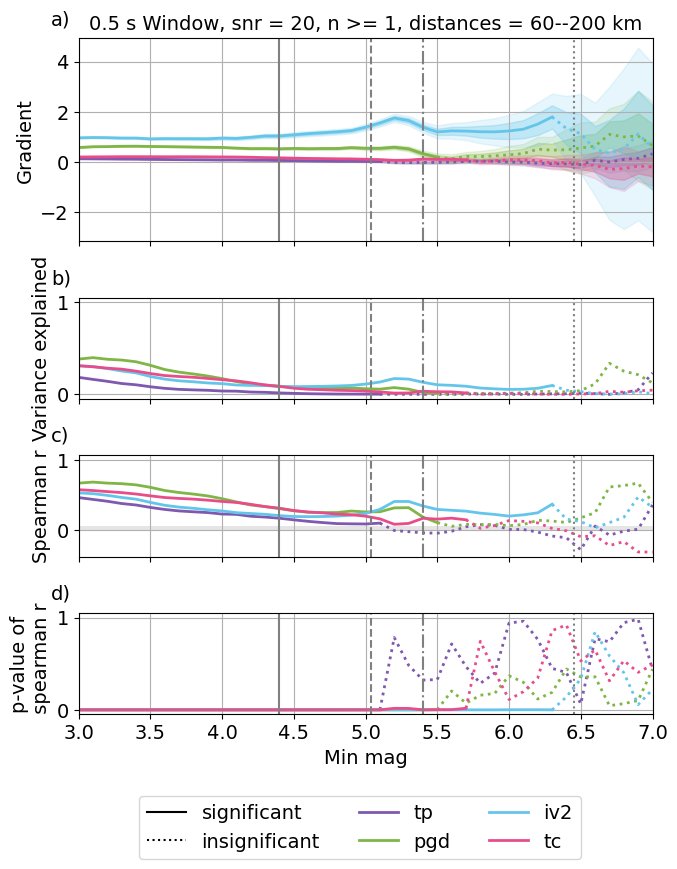

tp 0.4592277436860772
pgd 0.6745416156344536
tc 0.5346642661035577
iv2 0.5557941246662619
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


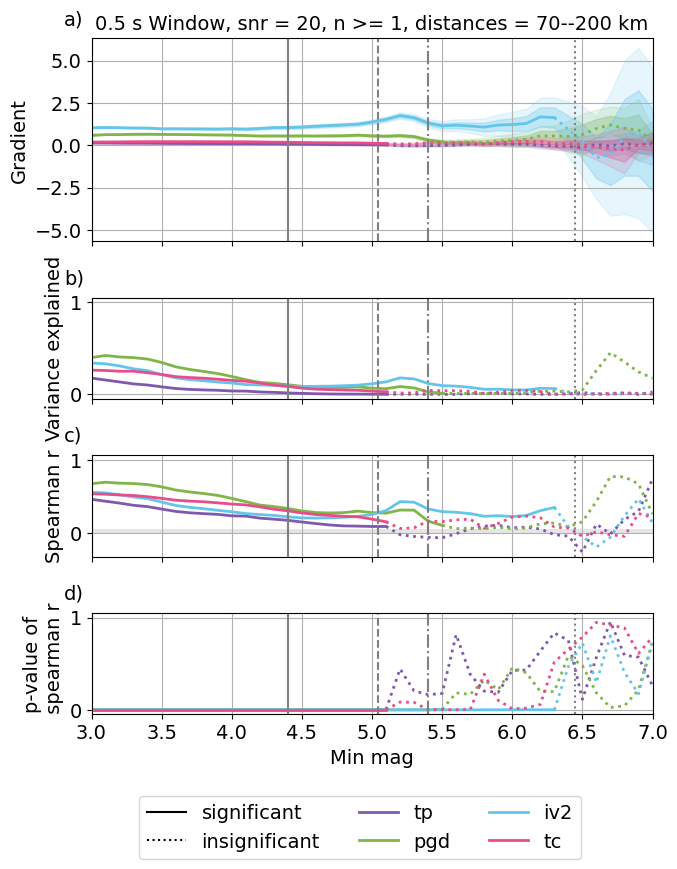

tp 0.43669265485947106
pgd 0.6697005000054757
tc 0.4744847503220214
iv2 0.5715944060005956
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


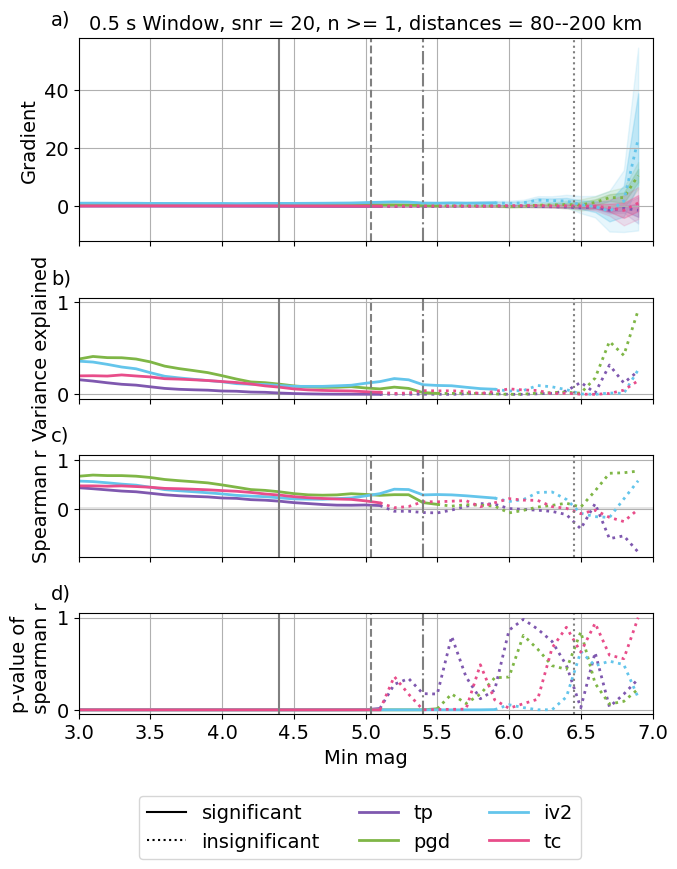

tp 0.4176262117270644
pgd 0.6575486915245613
tc 0.4255061887875776
iv2 0.5639587194318232
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


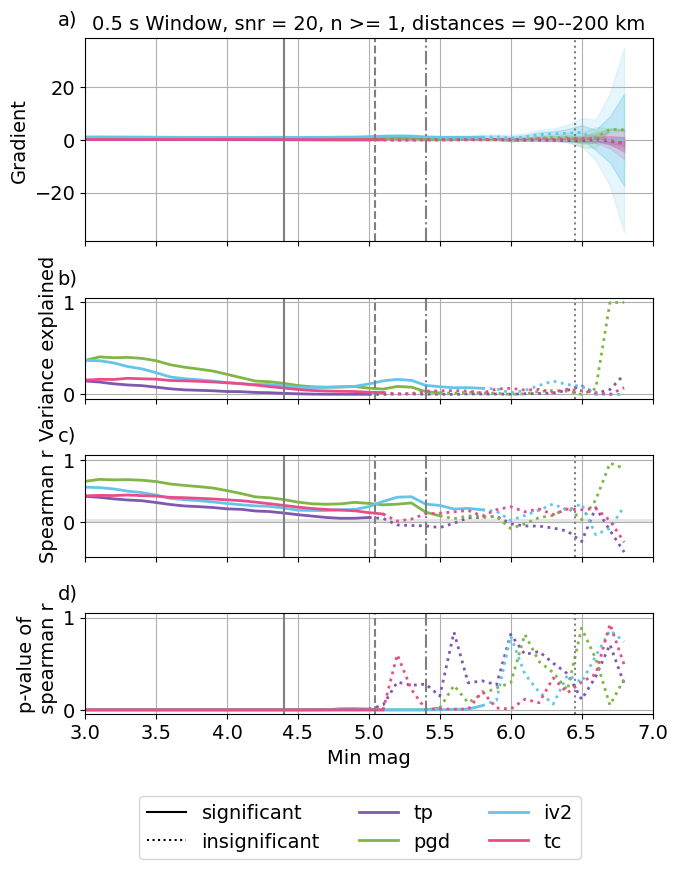

tp 0.6160772006844962
pgd 0.7007997933562345
tc 0.7364037125713302
iv2 0.5463917403169899
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


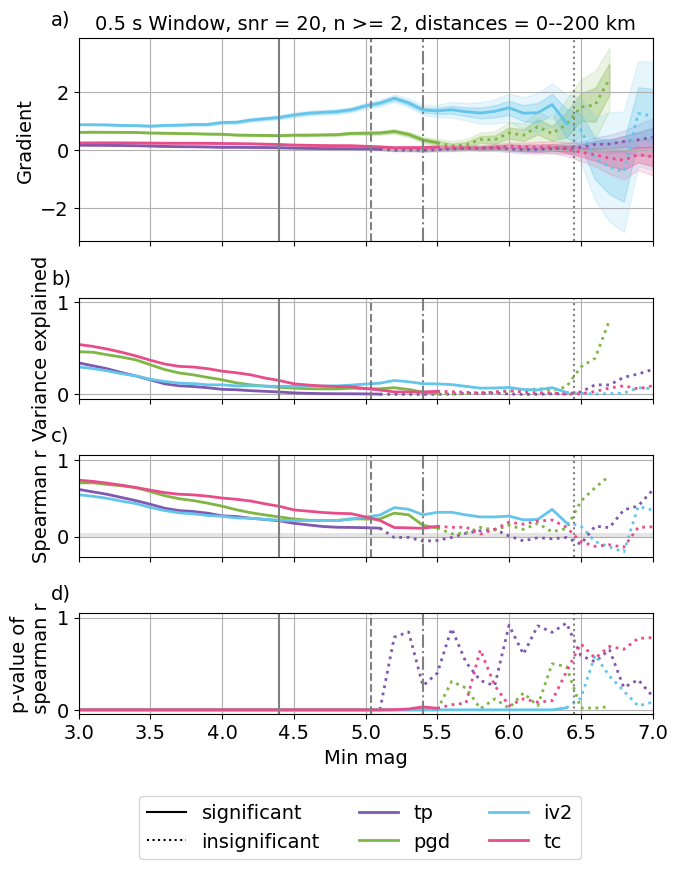

tp 0.6050749601340797
pgd 0.6962481999103967
tc 0.7232956197401346
iv2 0.5434629467714505
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


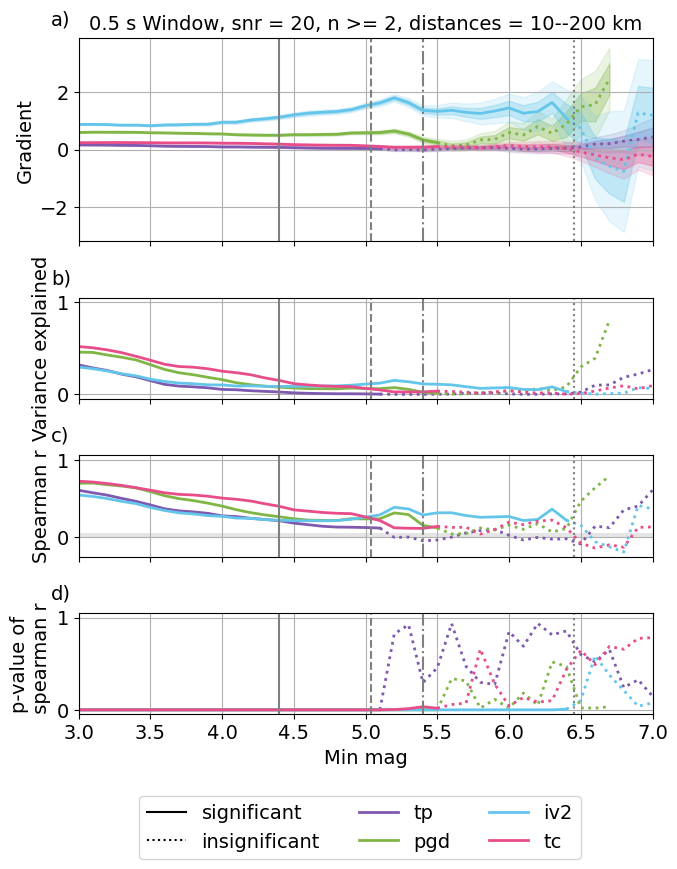

tp 0.5884511593908345
pgd 0.6866539379505666
tc 0.7079064496840082
iv2 0.5341460839152868
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


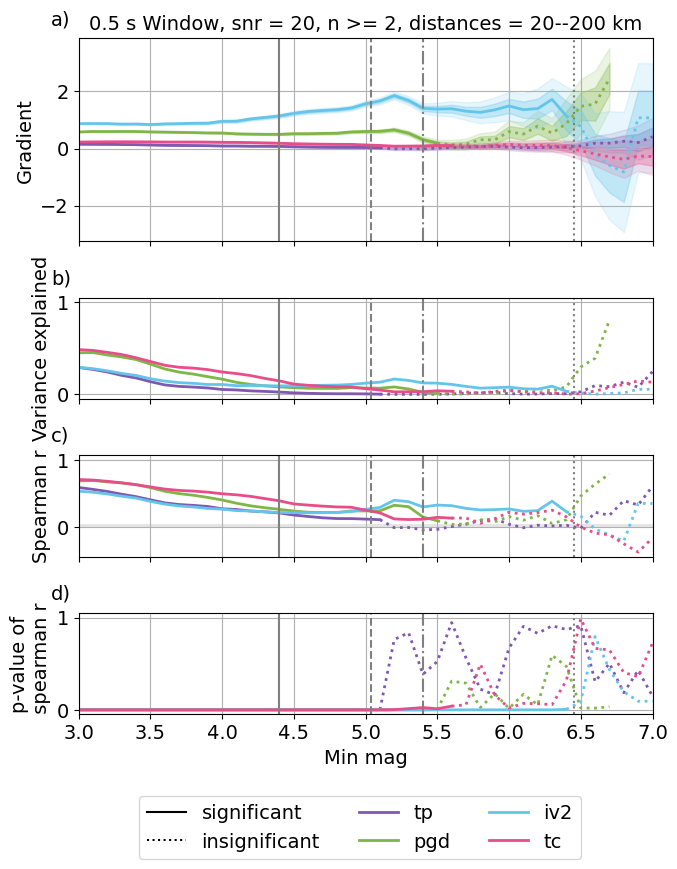

tp 0.578928172764398
pgd 0.6760562905381983
tc 0.6824535027329367
iv2 0.517234896975843
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


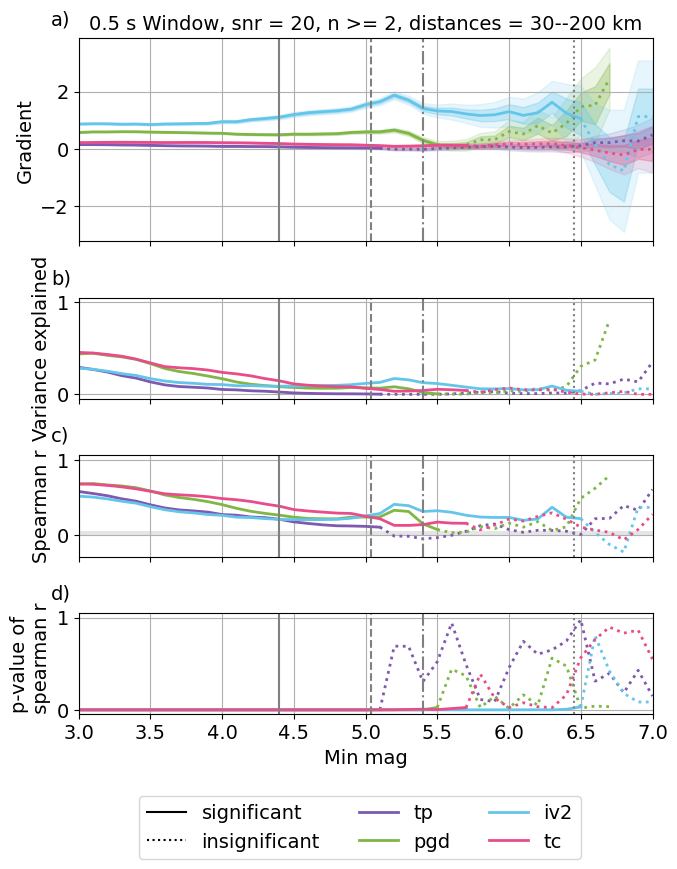

tp 0.568240909816164
pgd 0.6667891244276166
tc 0.6664499205203418
iv2 0.5035762484549082
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


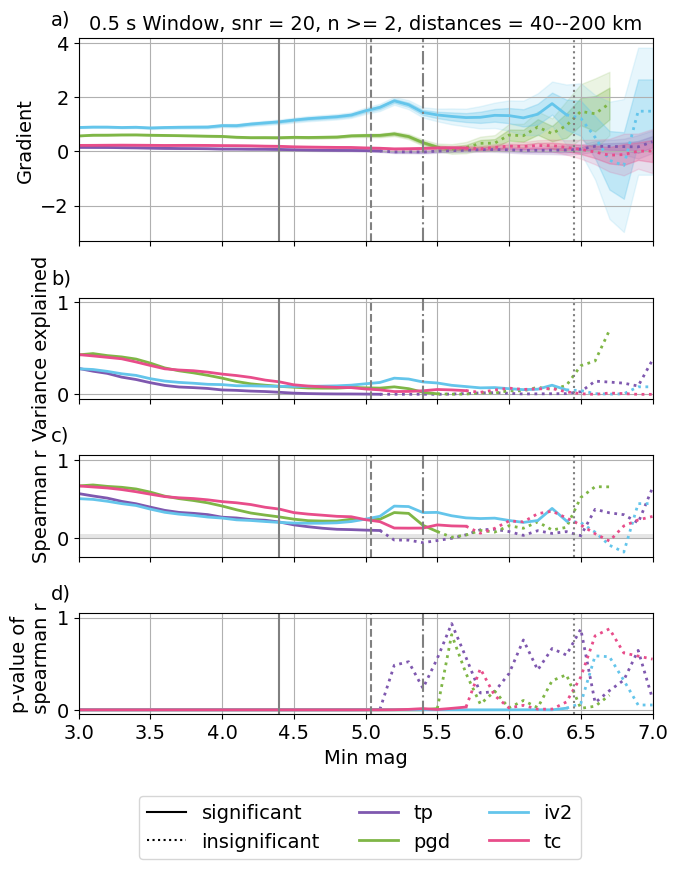

tp 0.5570507098695133
pgd 0.6704862801295562
tc 0.643700874331361
iv2 0.5146552846769074
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


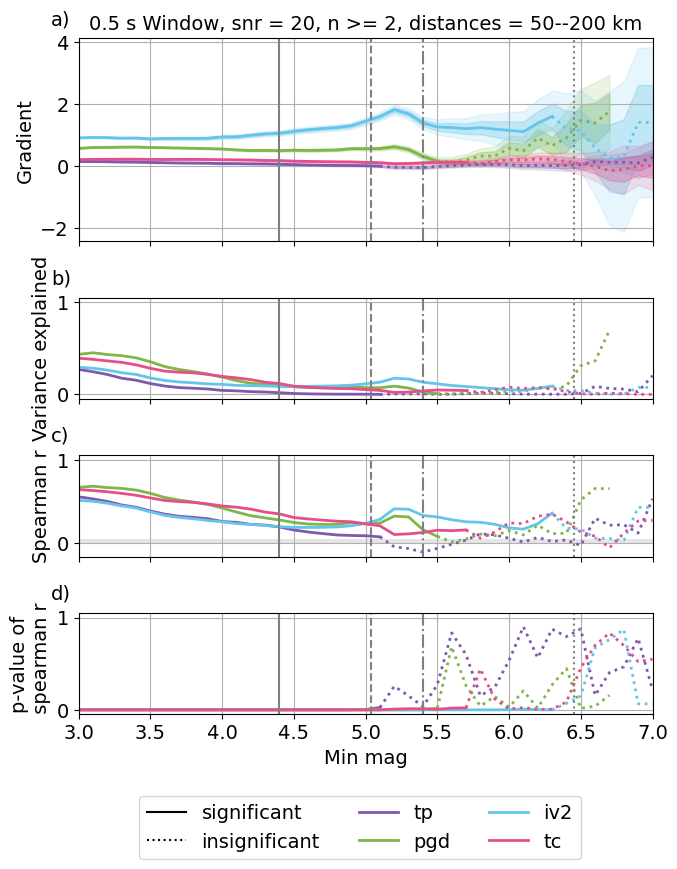

tp 0.5378929109838962
pgd 0.6719255252697924
tc 0.6068143190303571
iv2 0.5337172015048891
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


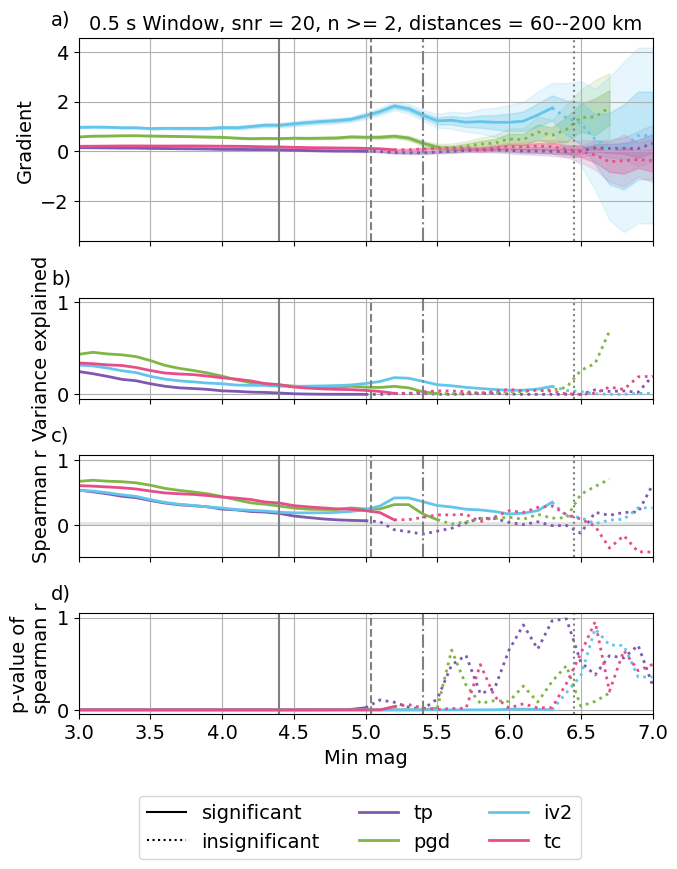

tp 0.5291997070355359
pgd 0.6772626430258161
tc 0.5566006744242641
iv2 0.5631131154491473
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


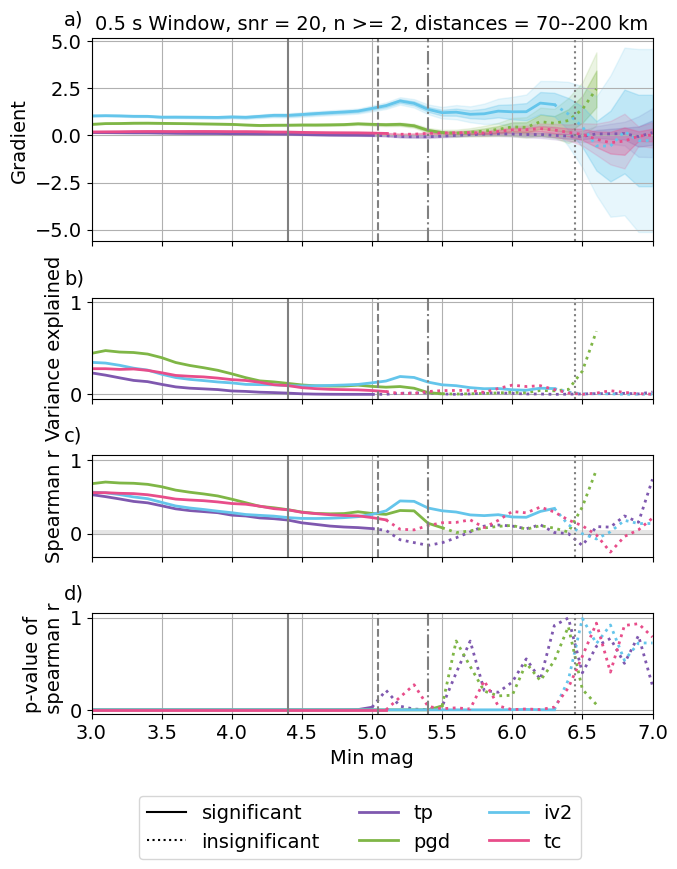

tp 0.4966491954571767
pgd 0.6730437500275472
tc 0.4845162163703976
iv2 0.5851328528013128
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


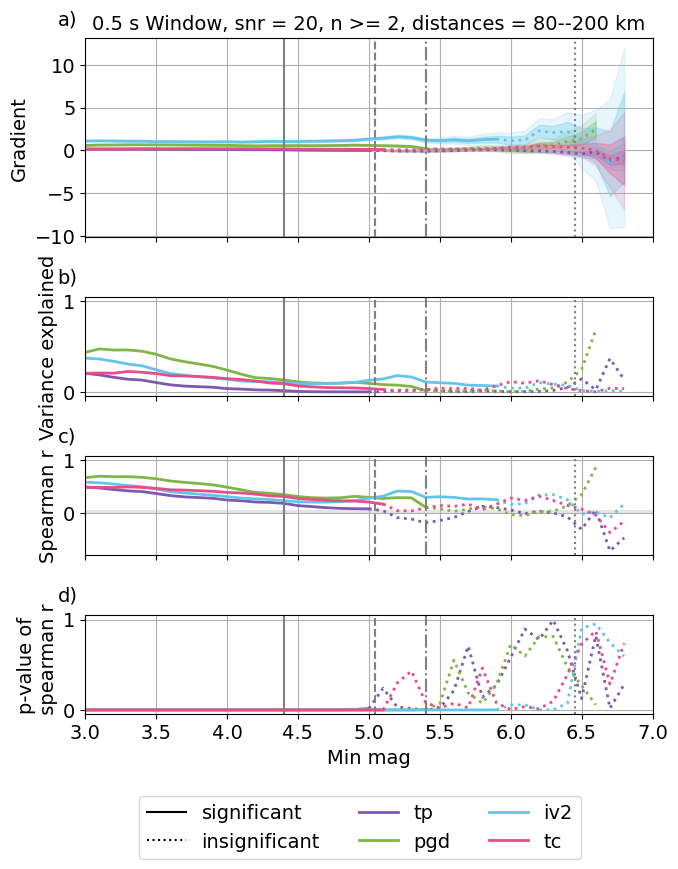

tp 0.46972892443207814
pgd 0.6580003668655398
tc 0.4246435101065343
iv2 0.5862860791237469
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


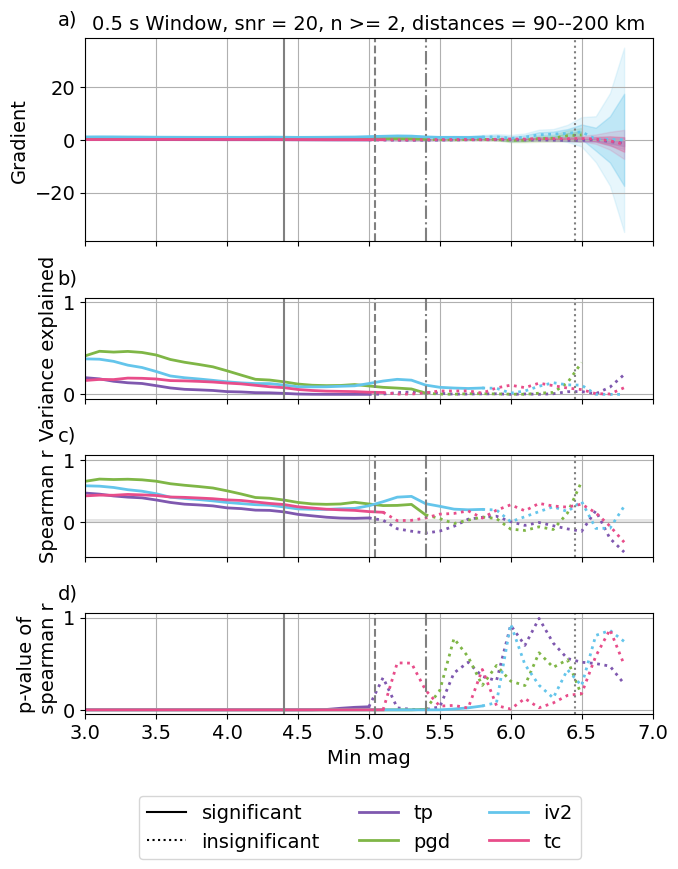

tp 0.6625684310953529
pgd 0.6971697949912664
tc 0.7660231136160353
iv2 0.5418688012621092
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


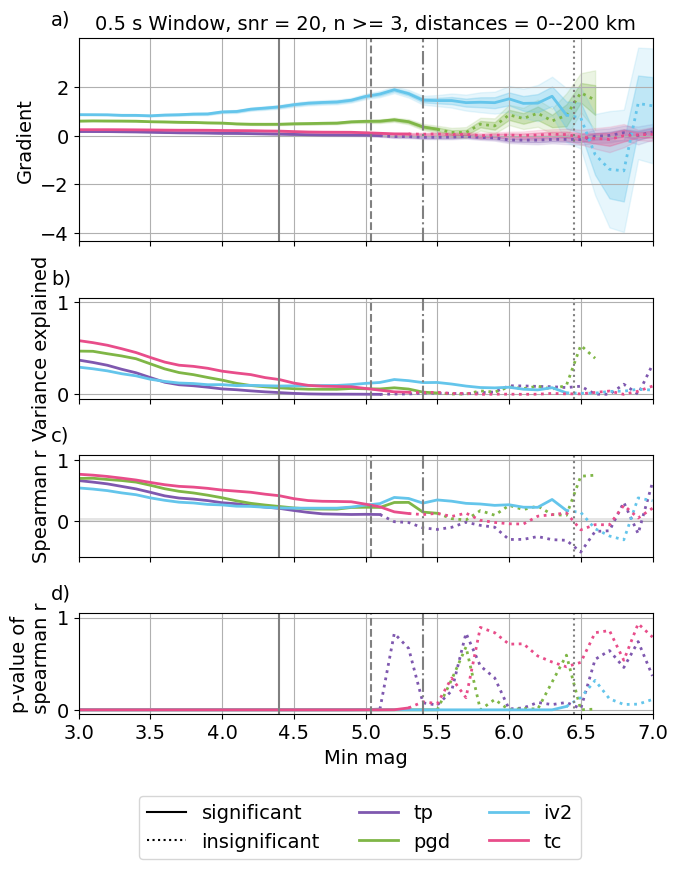

tp 0.6572336203256405
pgd 0.6932747245394546
tc 0.7519212838323086
iv2 0.5391314188941172
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


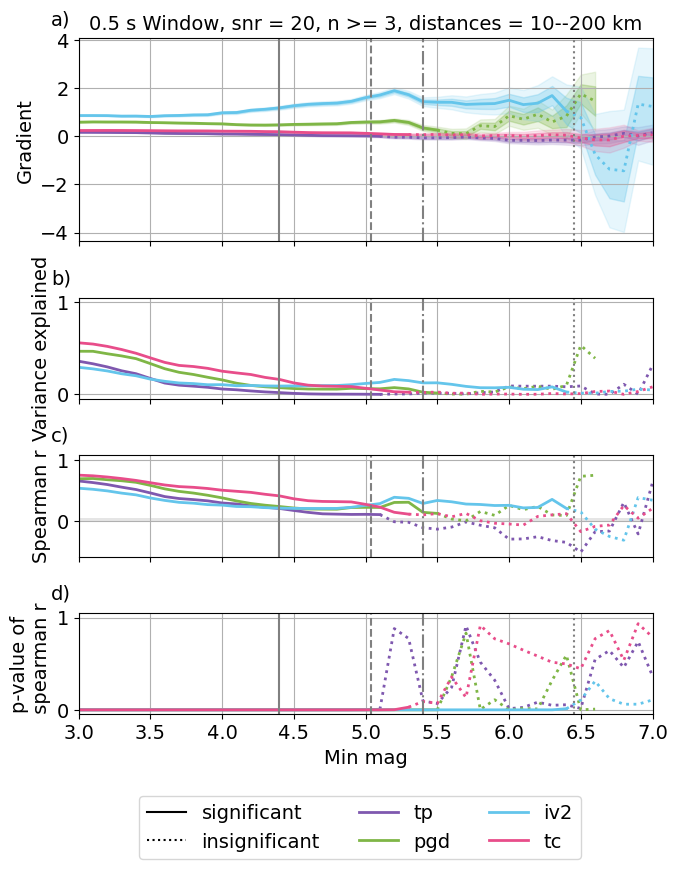

tp 0.6417776628852142
pgd 0.6844501019956399
tc 0.7393421837828824
iv2 0.531690933867111
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


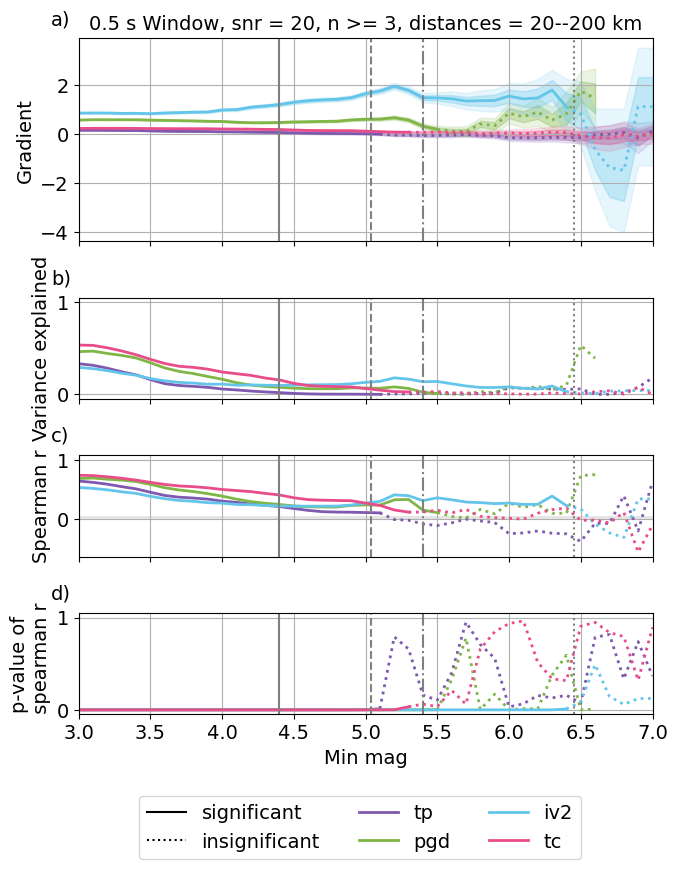

tp 0.6359763853327267
pgd 0.674562627062271
tc 0.7164085084686045
iv2 0.5157697524023641
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


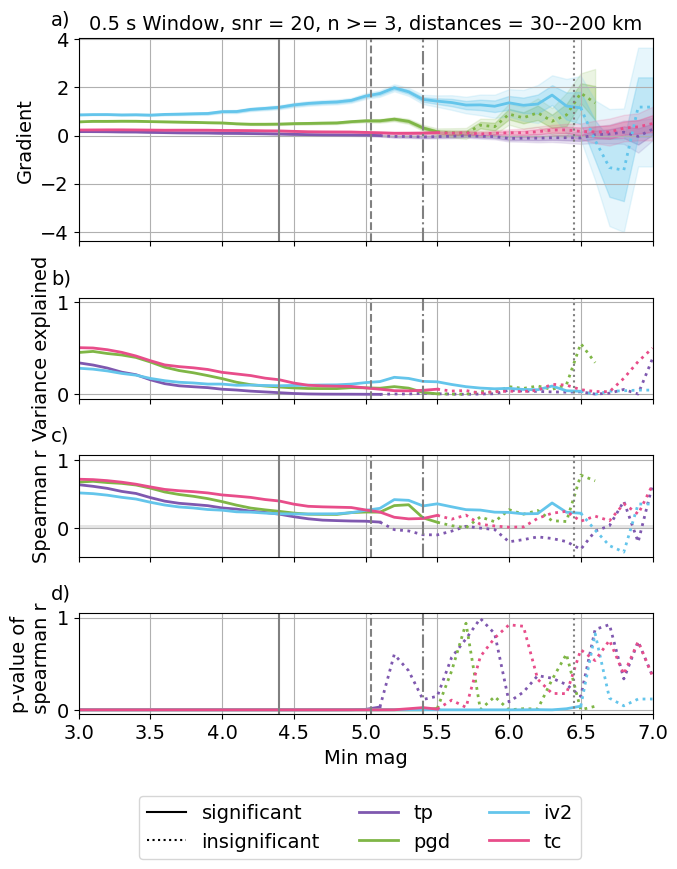

tp 0.6259293561182288
pgd 0.6661752288225353
tc 0.6941867594915929
iv2 0.5040320028162025
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


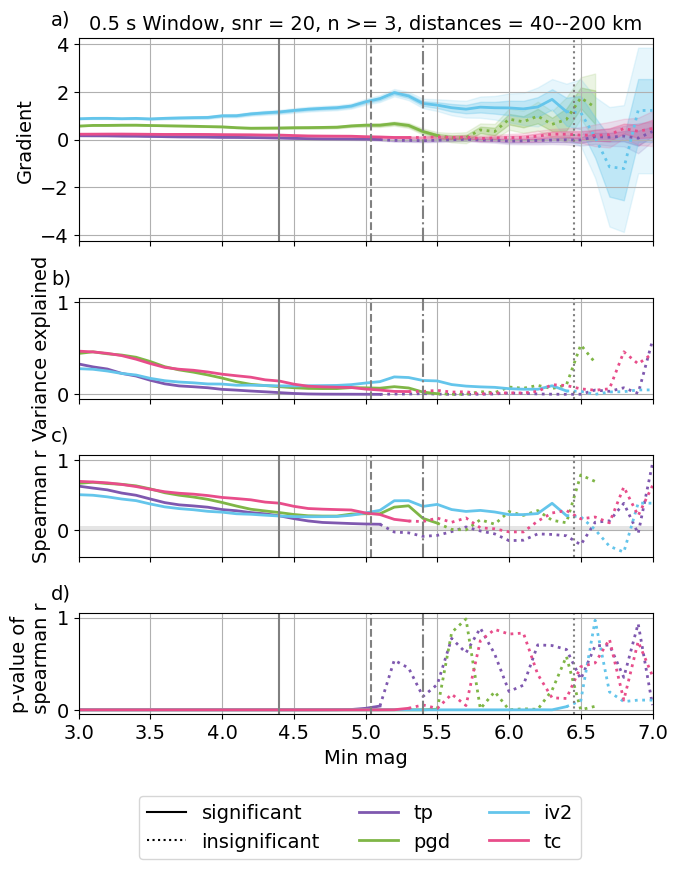

tp 0.6197565134407179
pgd 0.6708678340598822
tc 0.66698627874621
iv2 0.516207152115665
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


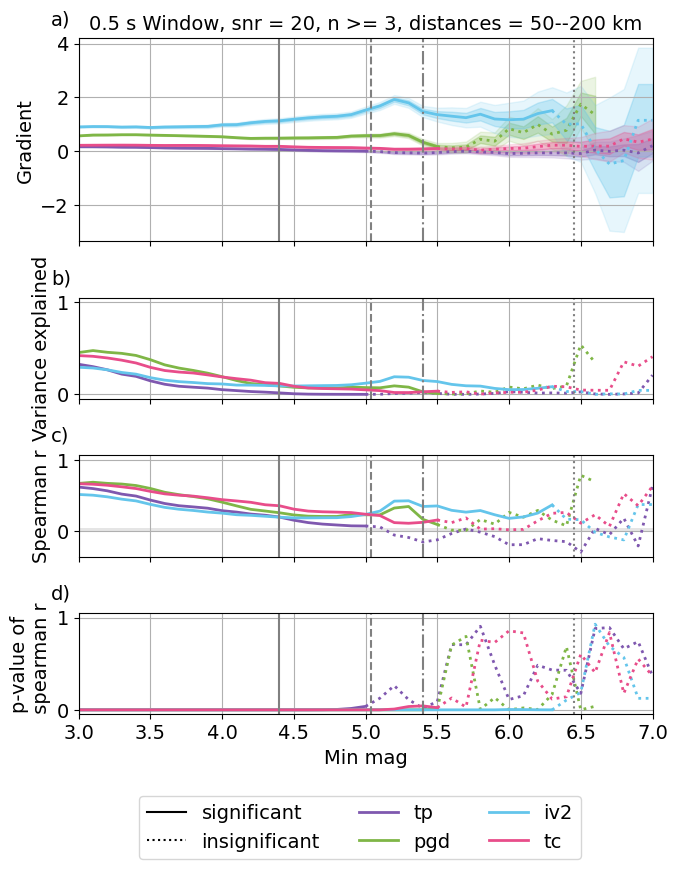

tp 0.6047667625859584
pgd 0.6722649208626905
tc 0.624704250933789
iv2 0.5378062602718808
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


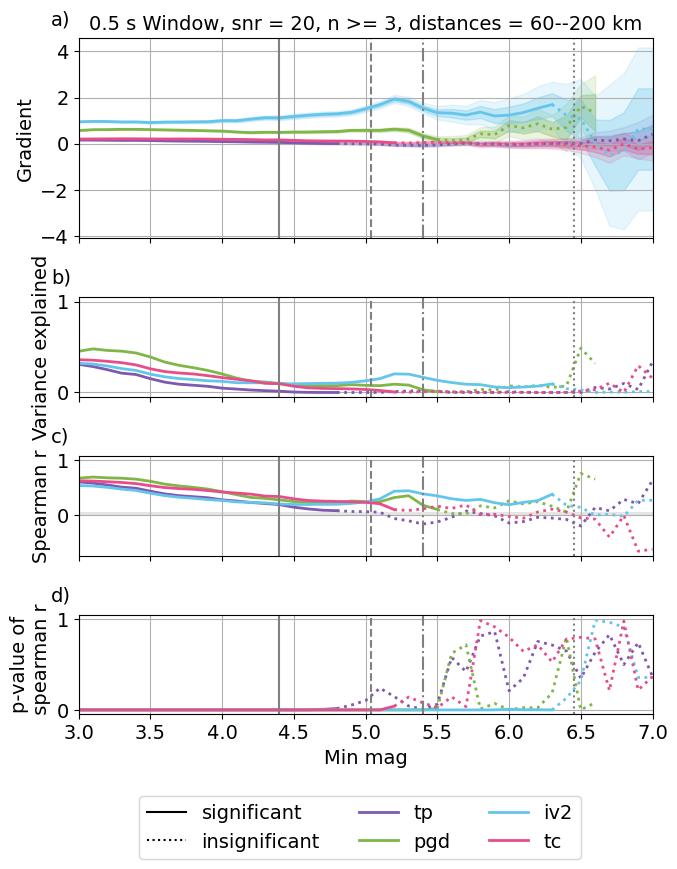

tp 0.5966856777298696
pgd 0.6761168793723734
tc 0.5687885099752656
iv2 0.5682366187574253
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


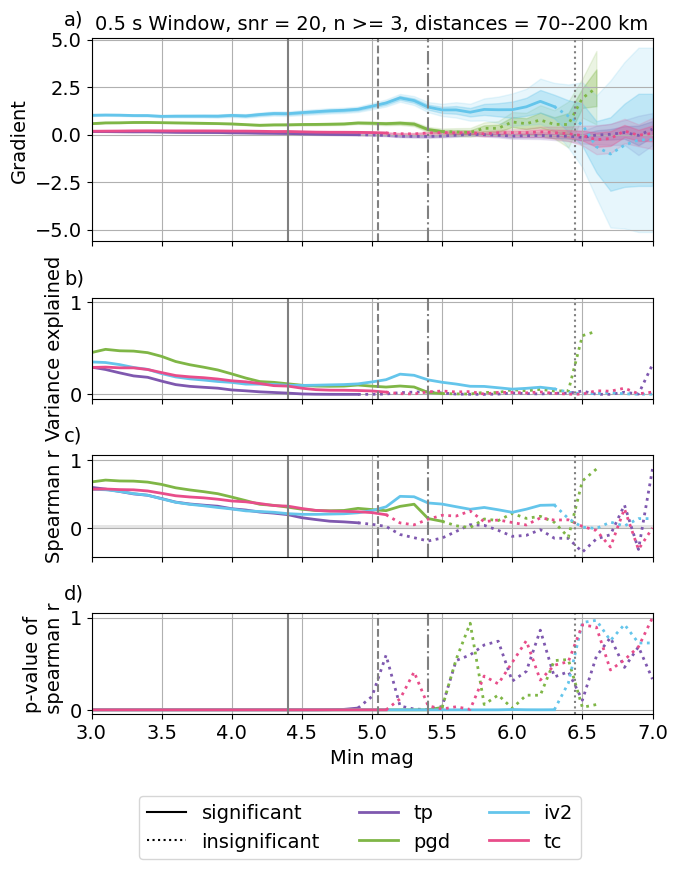

tp 0.5536387656700907
pgd 0.6703037205426823
tc 0.4854048194190934
iv2 0.5928745495532136
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


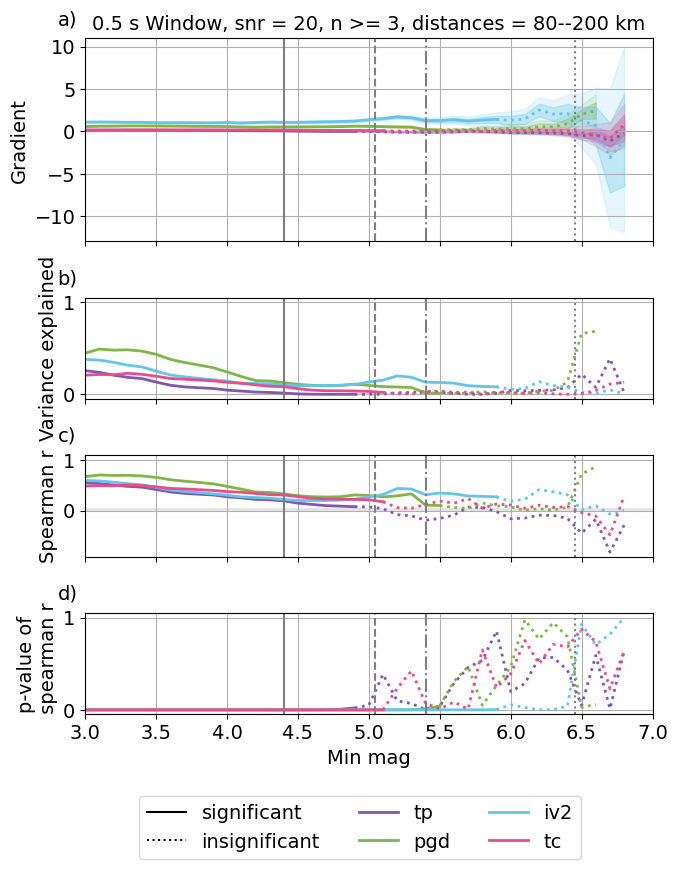

tp 0.5267576316345541
pgd 0.6533264744683732
tc 0.4143238127685273
iv2 0.5940163974915429
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


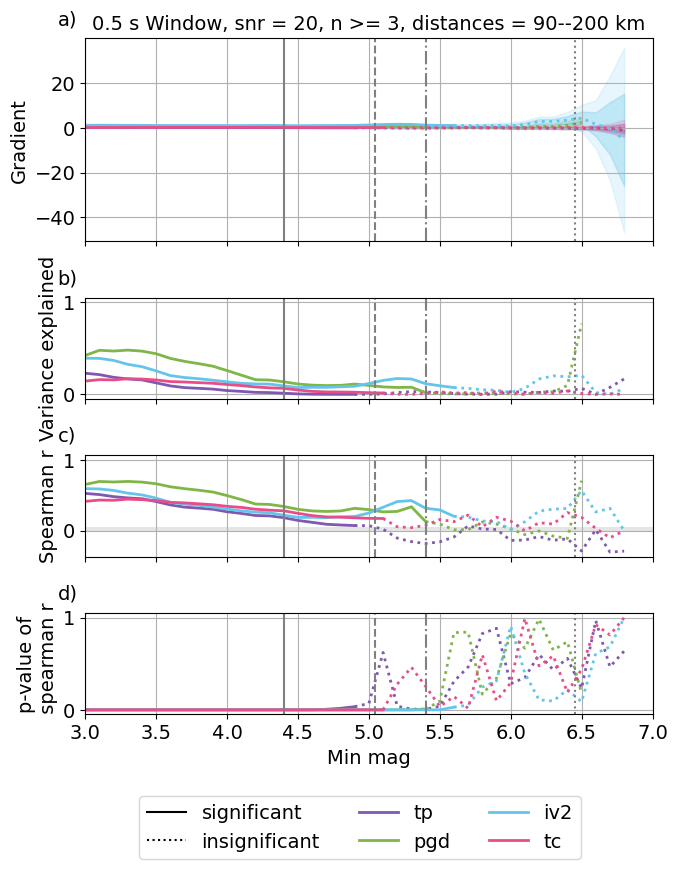

tp 0.7109052053026208
pgd 0.6908175238813171
tc 0.7866725295338975
iv2 0.5326650516265677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


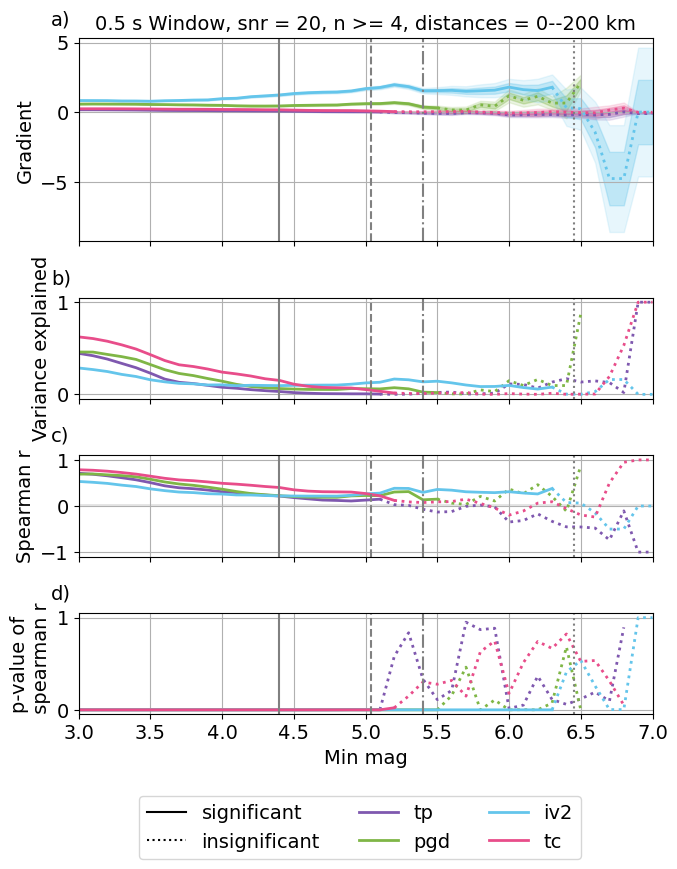

tp 0.7022453984185262
pgd 0.6873491015098762
tc 0.7711641931472536
iv2 0.5300252701578362
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


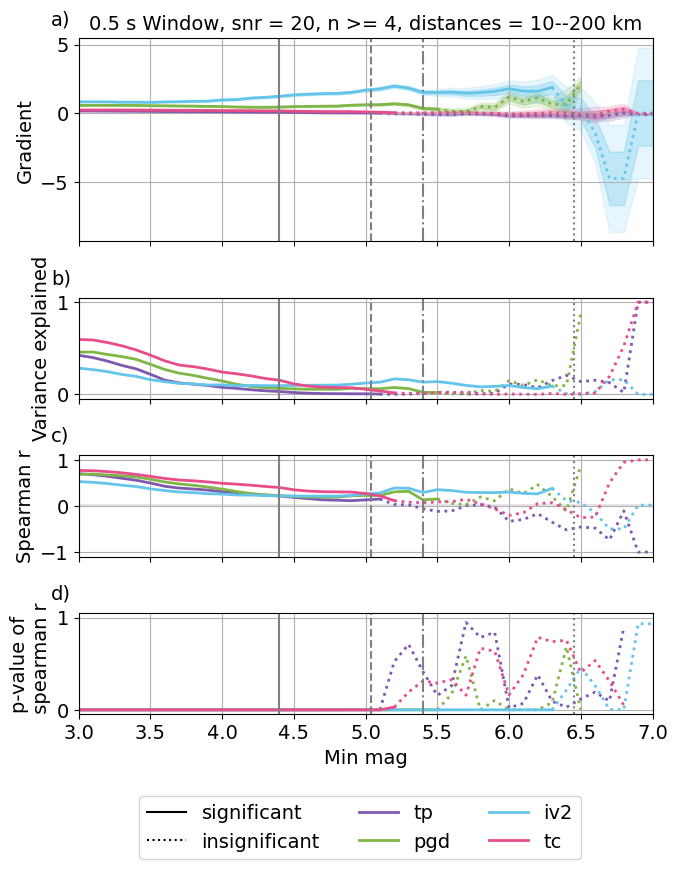

tp 0.6914598887174135
pgd 0.6785381680661408
tc 0.7573207042813132
iv2 0.52340376832577
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


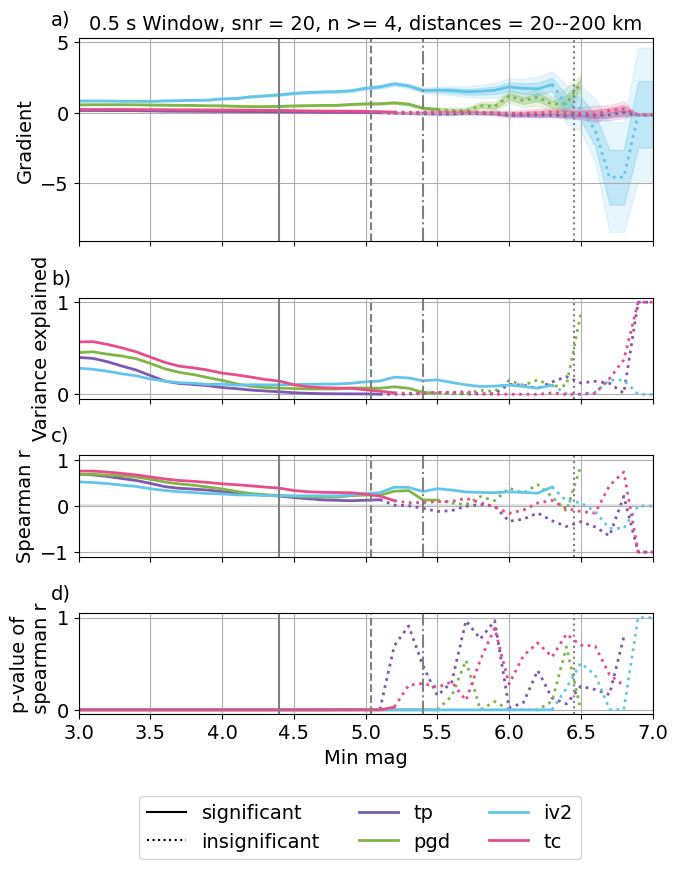

tp 0.68208264229751
pgd 0.6693041704418328
tc 0.7308059175984618
iv2 0.508359937742953
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


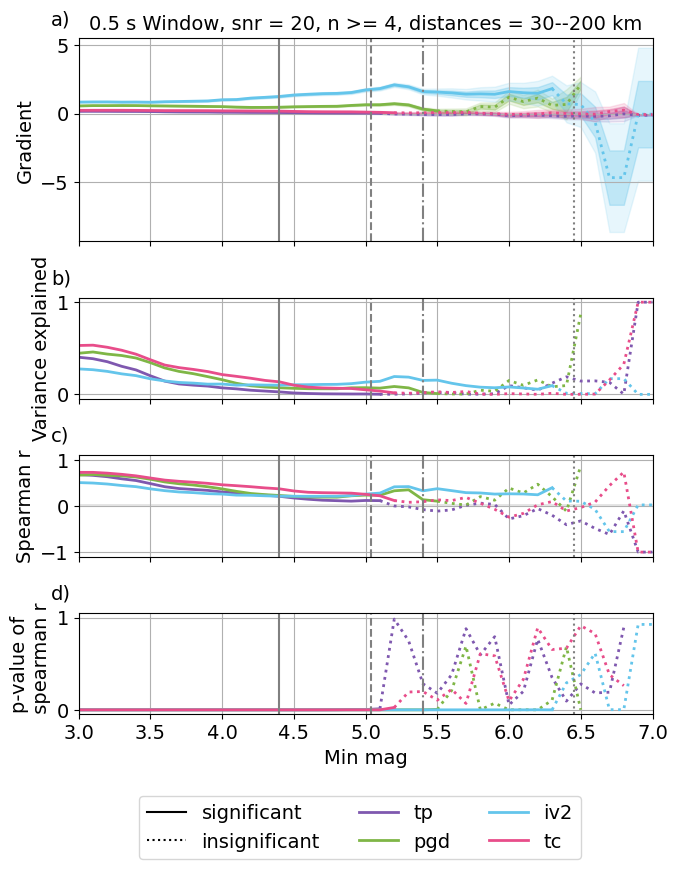

tp 0.6691002251002874
pgd 0.6613895565261941
tc 0.7092875394589755
iv2 0.4976438516940109
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


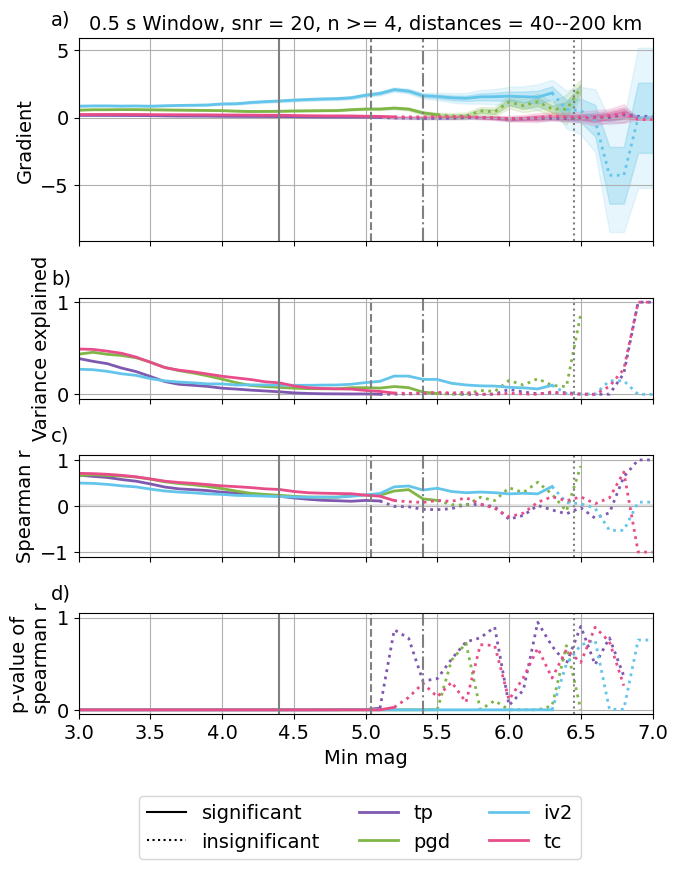

tp 0.6601038971834212
pgd 0.6668290861117541
tc 0.6813480073134062
iv2 0.5122165759364716
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


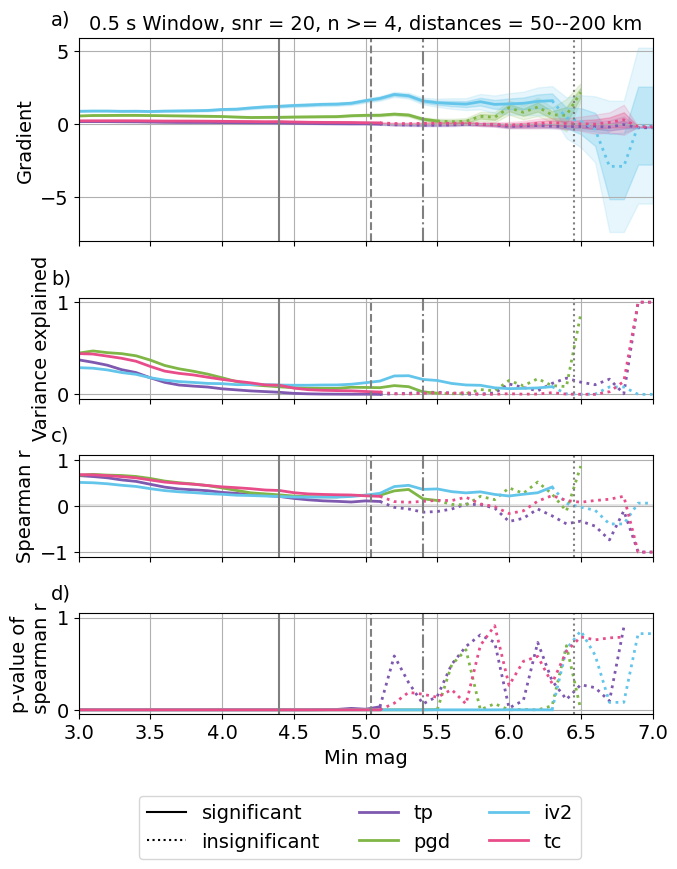

tp 0.643254684207618
pgd 0.6666184383538907
tc 0.6382113315751812
iv2 0.5348007588878476
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


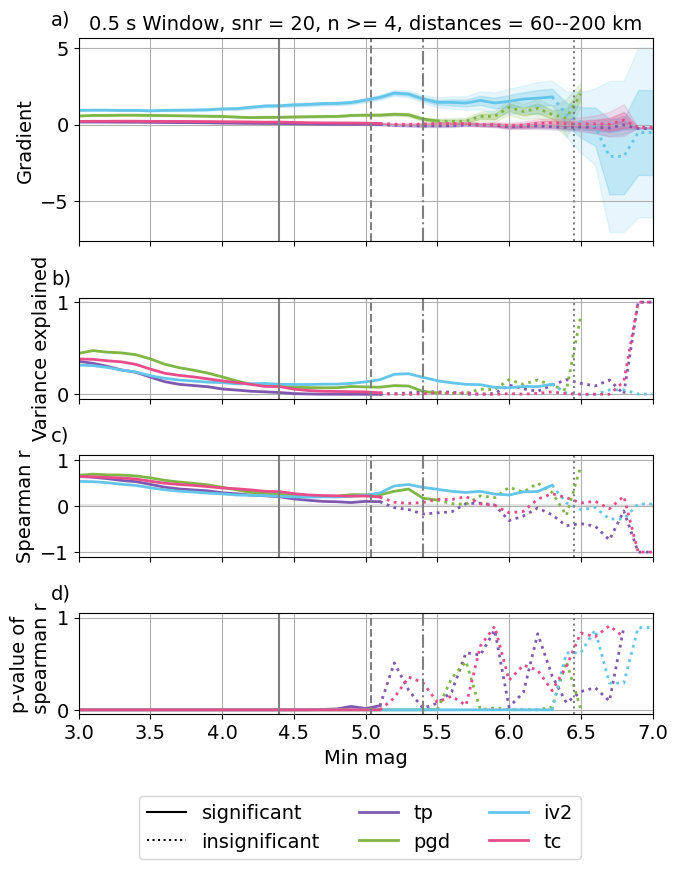

tp 0.6340654675238612
pgd 0.6707956314244605
tc 0.5736102162484173
iv2 0.5707622908450893
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


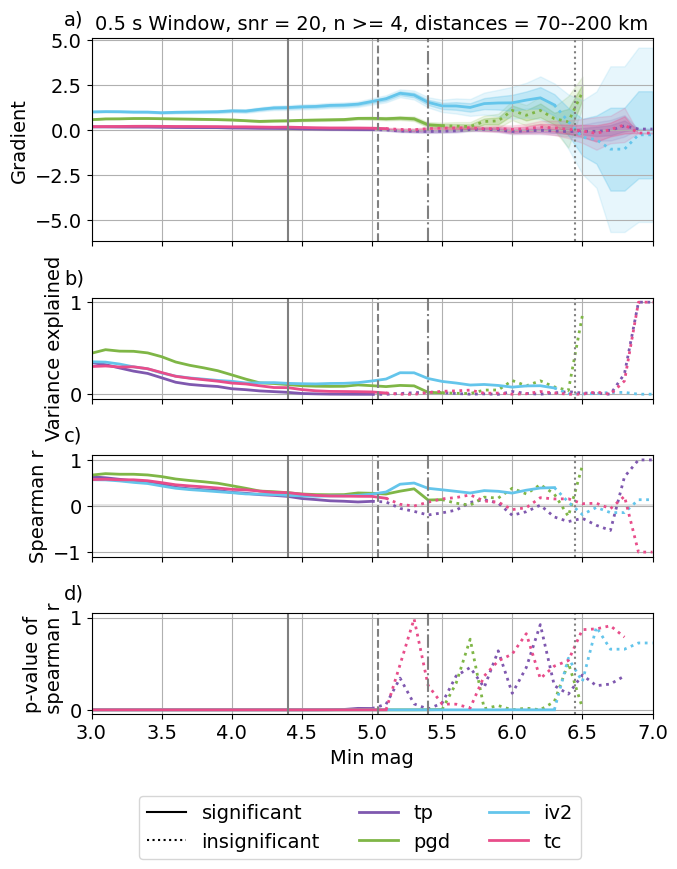

tp 0.5885392426448617
pgd 0.6641536423603888
tc 0.4841778067448107
iv2 0.6027653864615884
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


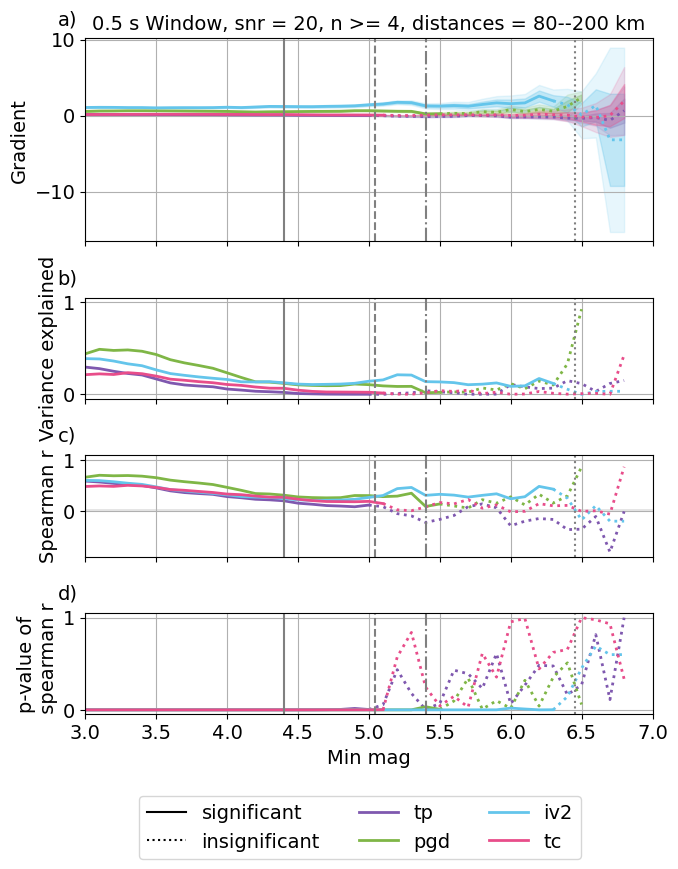

tp 0.5630793751526387
pgd 0.643557482073757
tc 0.410578522974118
iv2 0.6045665332690372
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


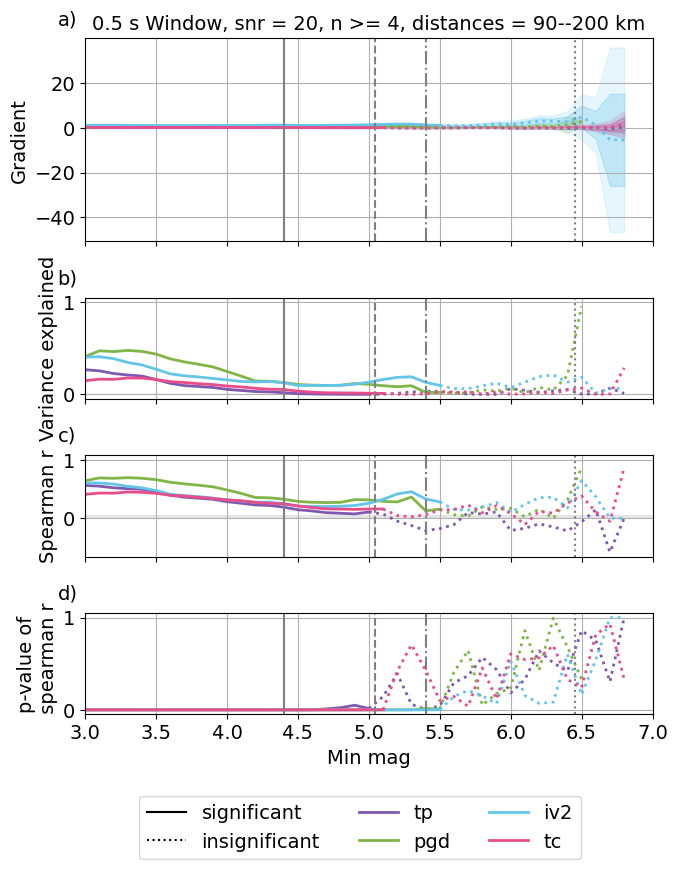

tp 0.7353367983111653
pgd 0.6860524945822111
tc 0.7991217313402343
iv2 0.5293073156037617
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


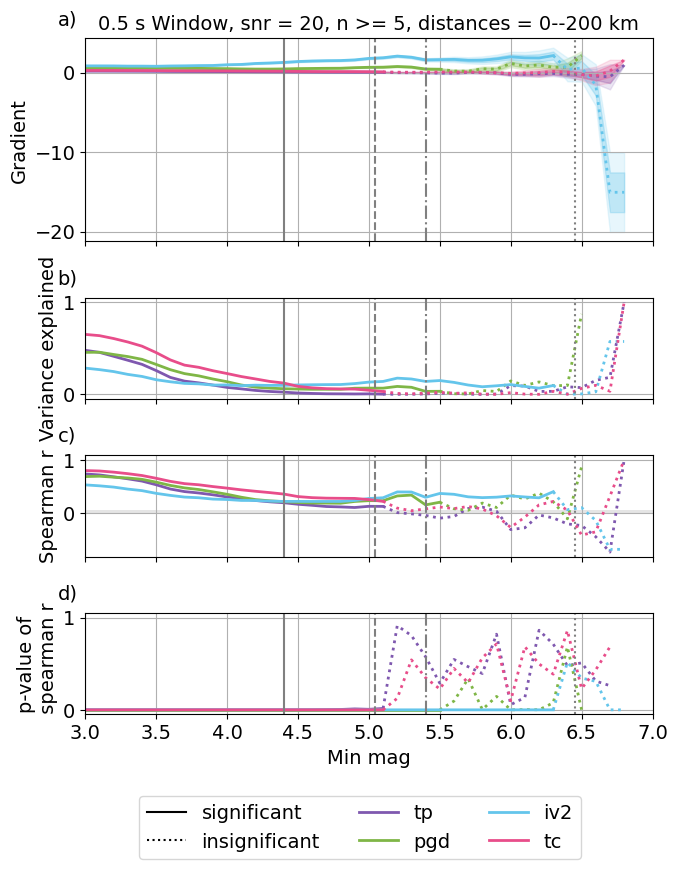

tp 0.7247775954112706
pgd 0.6831579320327376
tc 0.7889929658798703
iv2 0.5270434551418504
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


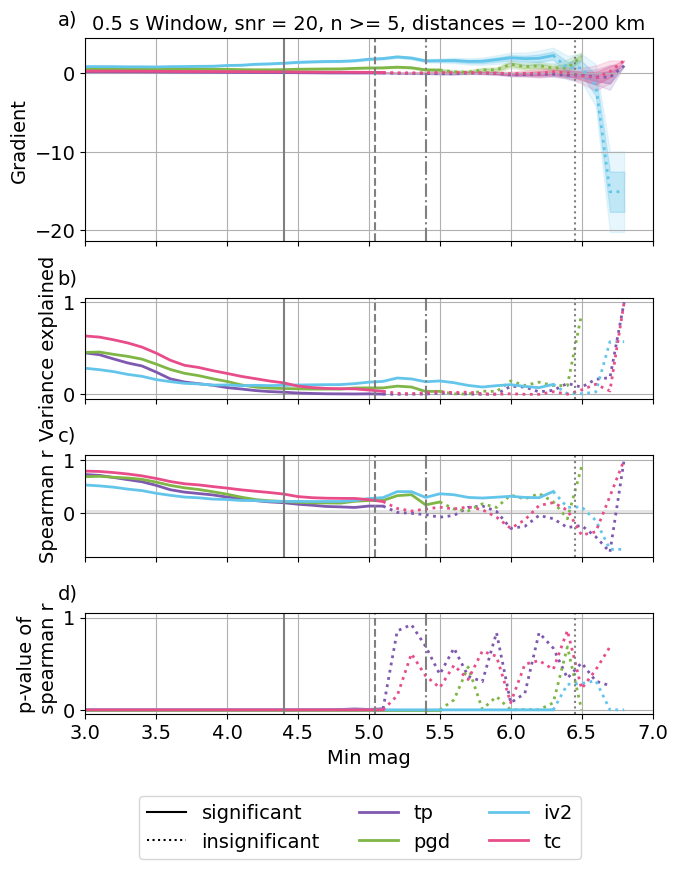

tp 0.7149191734172694
pgd 0.675262057200001
tc 0.7762120944479121
iv2 0.5213401289242896
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


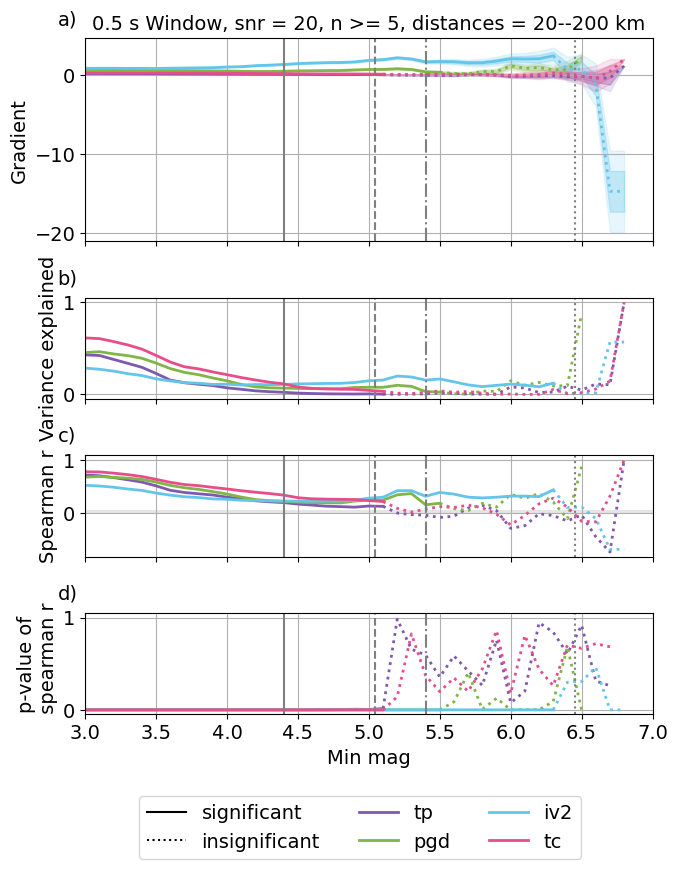

tp 0.70963096670788
pgd 0.6679713555314483
tc 0.7525816679809001
iv2 0.5074940482302222
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


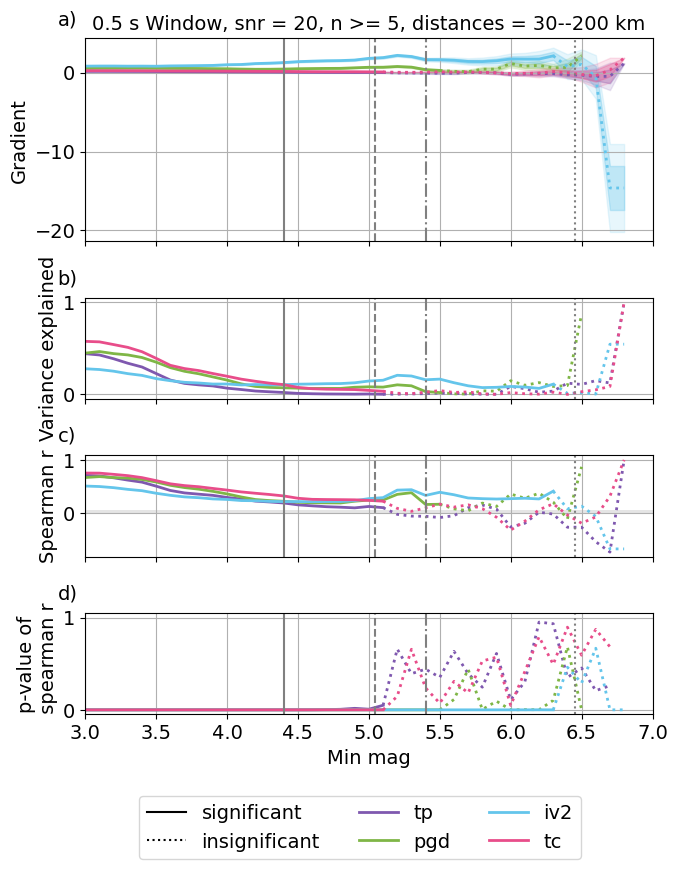

tp 0.6991641285141997
pgd 0.661389083639402
tc 0.7295654023280298
iv2 0.49756940923315773
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


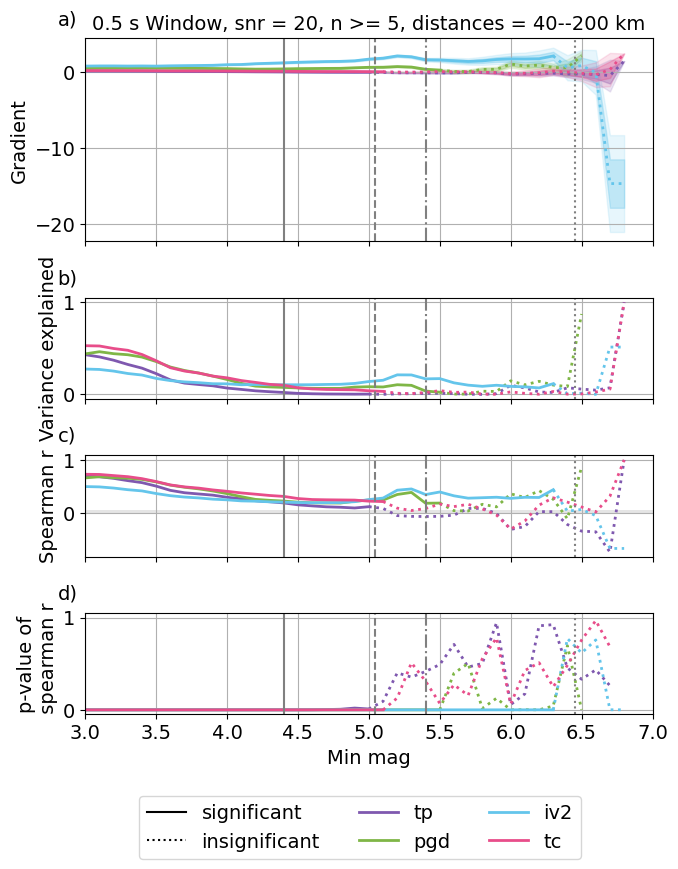

tp 0.6862694972326355
pgd 0.6679189532655012
tc 0.7049370104928574
iv2 0.5138531005002924
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


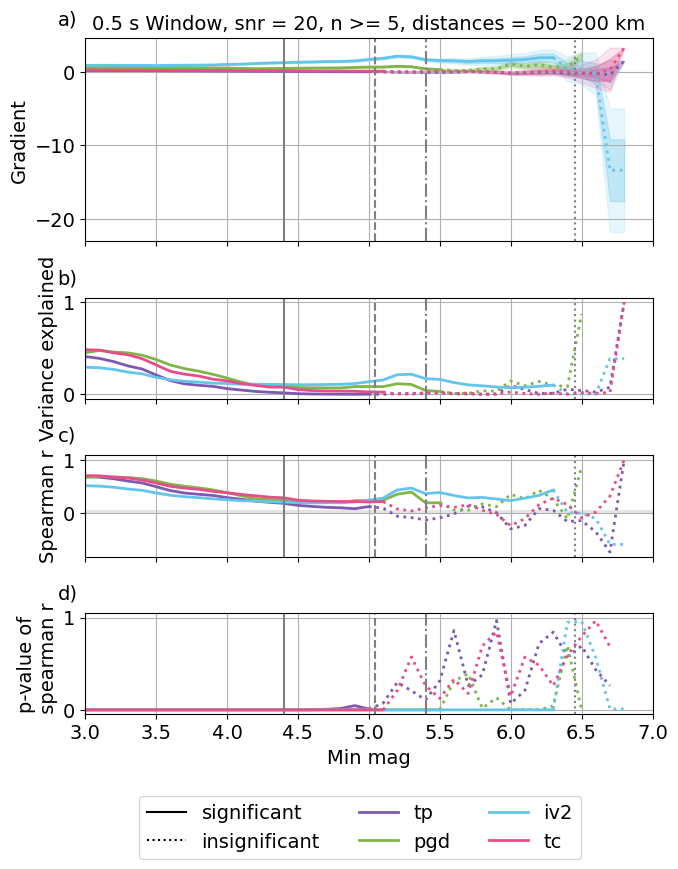

tp 0.6666287164259946
pgd 0.6678867573787023
tc 0.6623351966193084
iv2 0.536275591710394
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


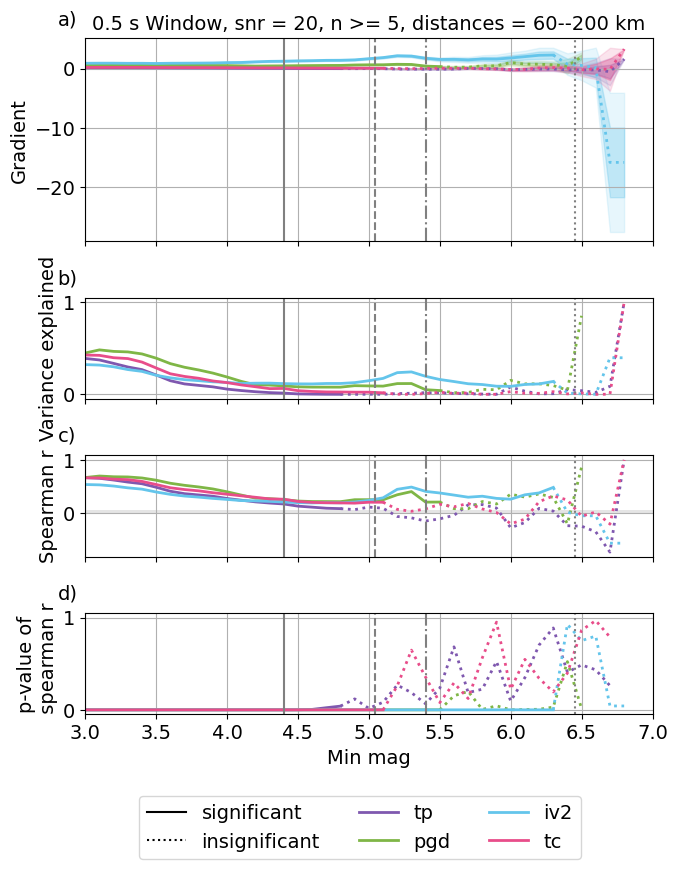

tp 0.6549804730158691
pgd 0.6704103495296486
tc 0.5970225256323537
iv2 0.5737613737593519
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


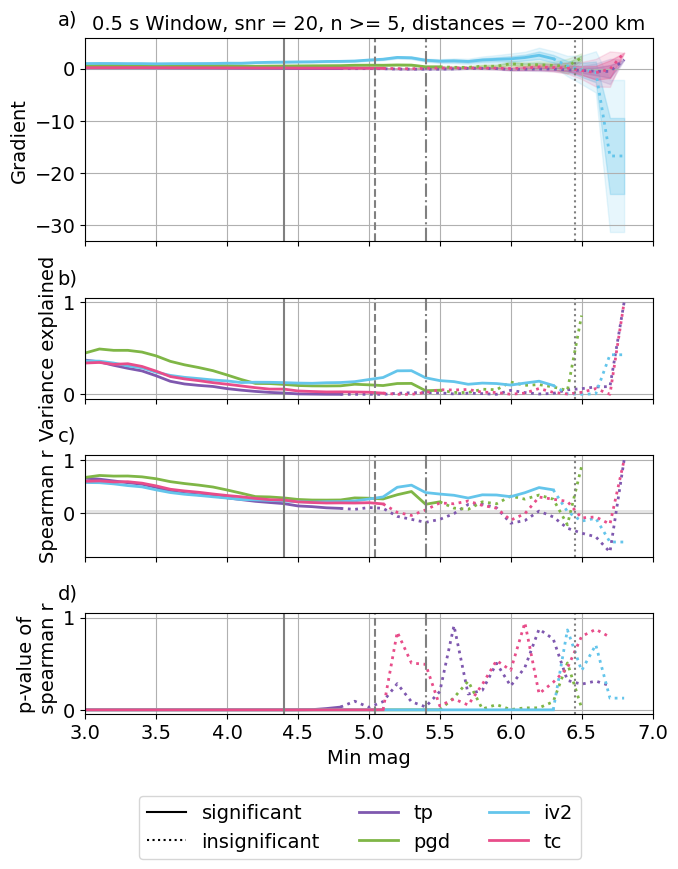

tp 0.6025083821879591
pgd 0.6645973851137965
tc 0.48881313011386524
iv2 0.6140832220970703
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


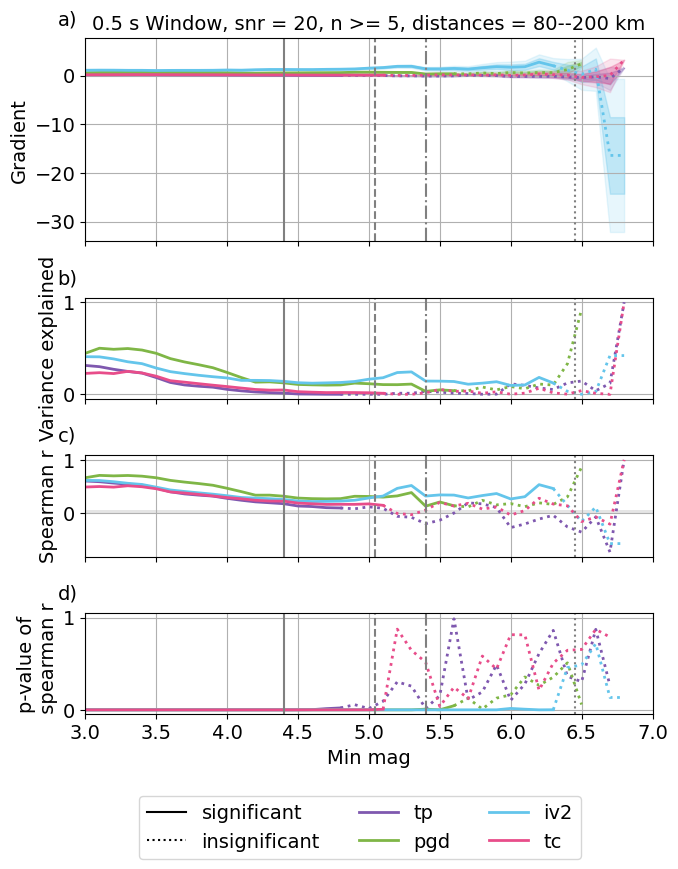

tp 0.5832300428205723
pgd 0.643715747007613
tc 0.4123932802375511
iv2 0.6214132088702792
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


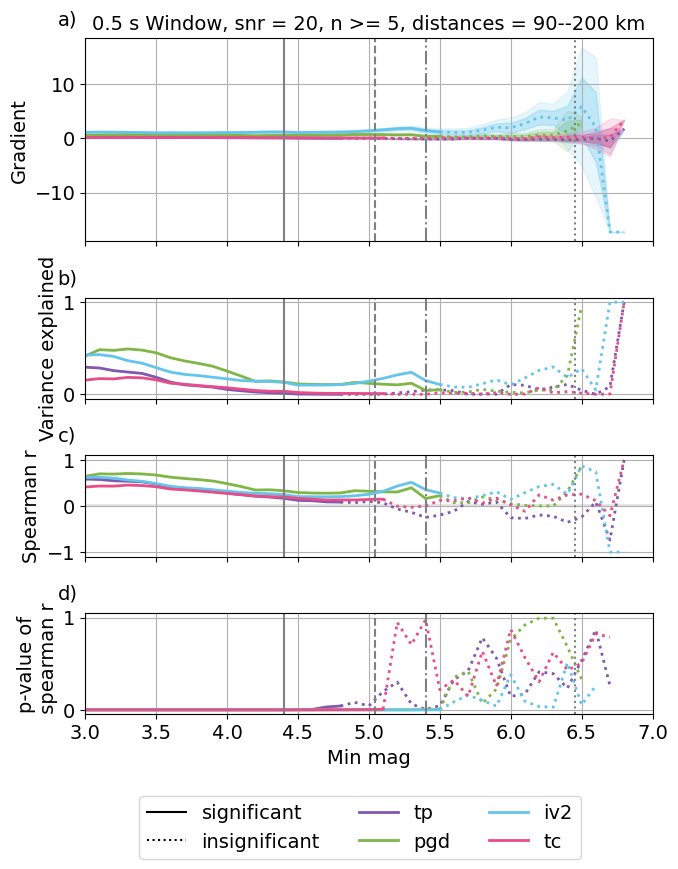

tp 0.7556407164544288
pgd 0.6798531008419205
tc 0.8133390223529045
iv2 0.5231427280460722
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


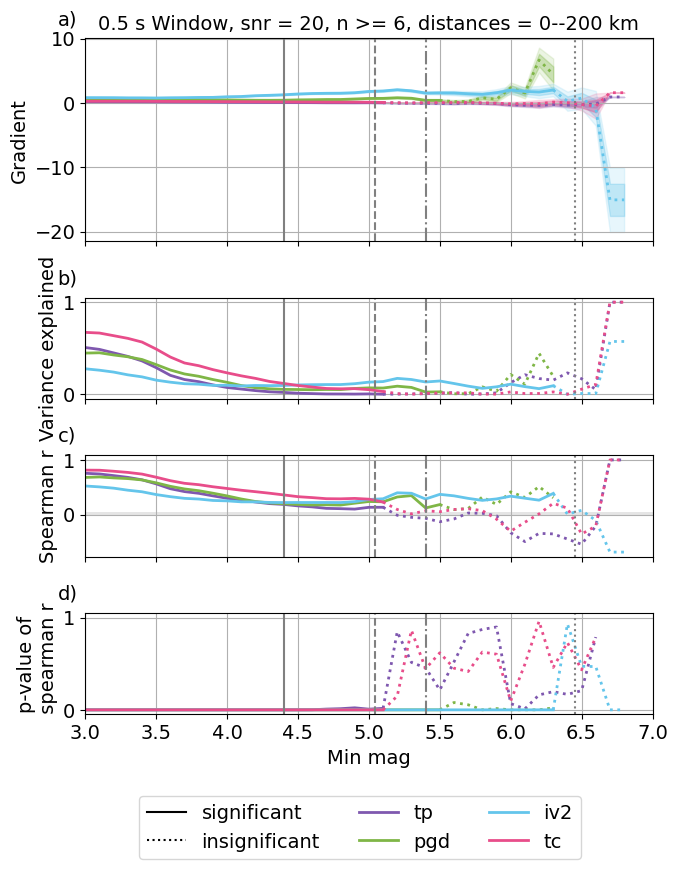

tp 0.7448132477223759
pgd 0.6768940512862921
tc 0.8018210375182702
iv2 0.5212474661415769
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


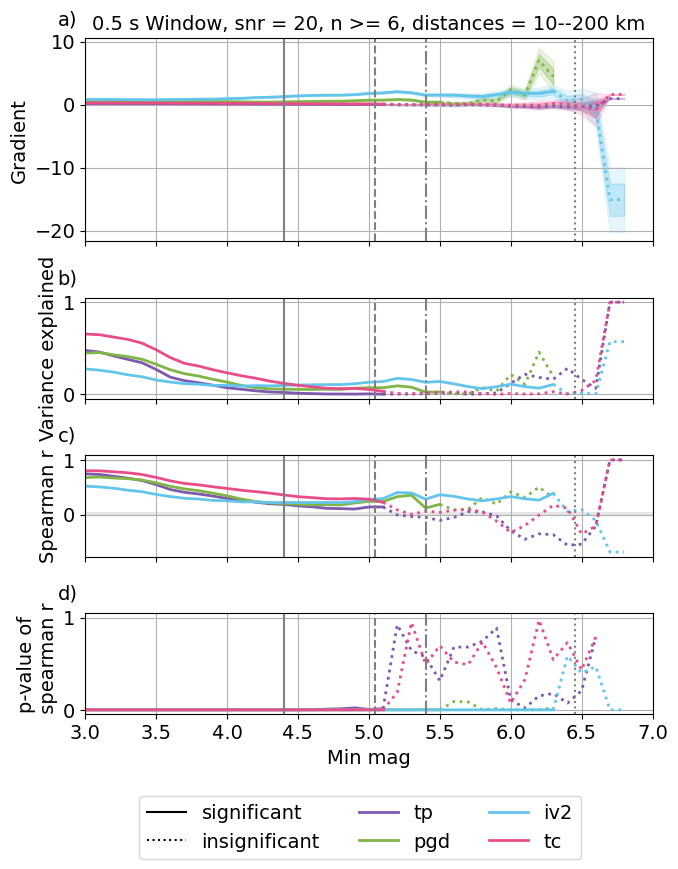

tp 0.7332187215396827
pgd 0.66886235653328
tc 0.7933681627170962
iv2 0.5151180244414654
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


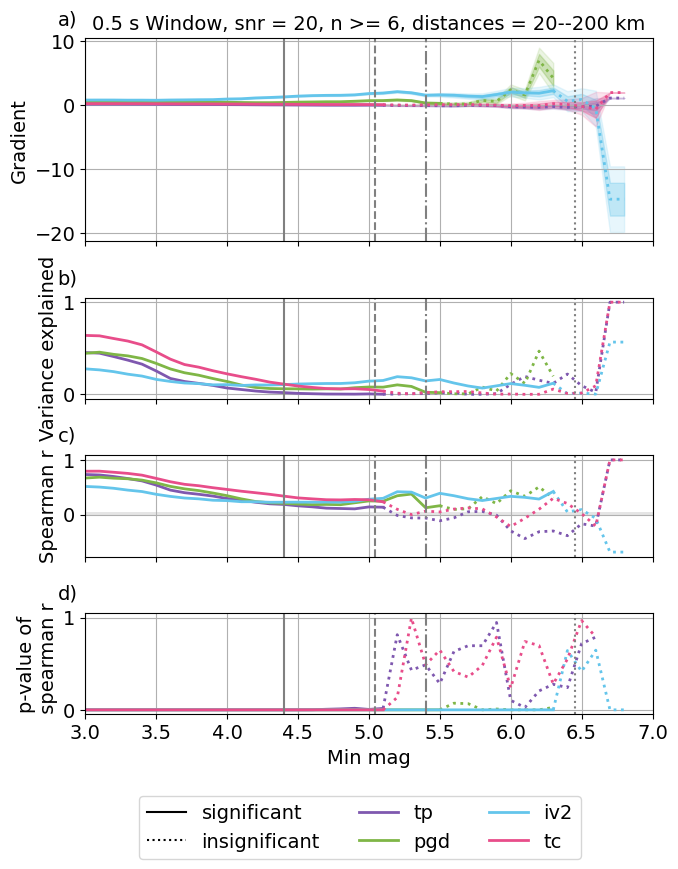

tp 0.7356519560848004
pgd 0.66282860994079
tc 0.7798316731086936
iv2 0.5020752235248561
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


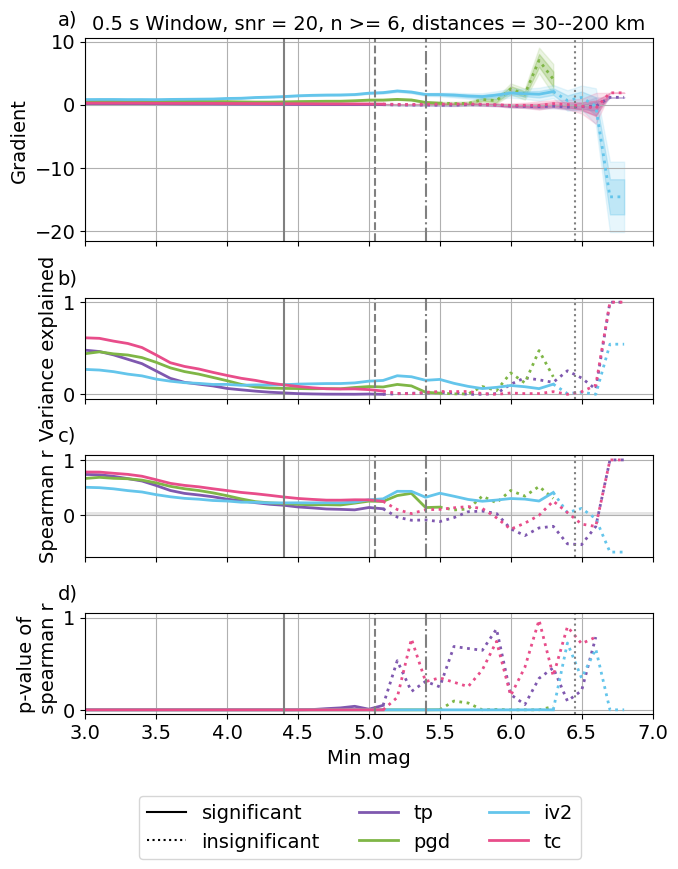

tp 0.7259567574049736
pgd 0.6570877494538757
tc 0.7560442366140483
iv2 0.4930646402846114
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


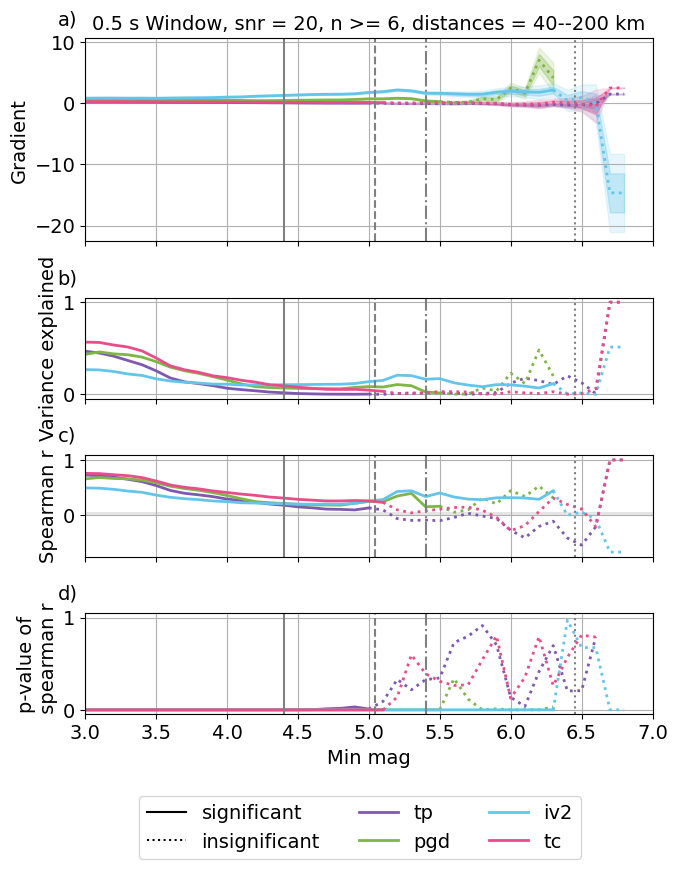

tp 0.7149283853820584
pgd 0.6636116989453285
tc 0.7291101324958682
iv2 0.508734365438319
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


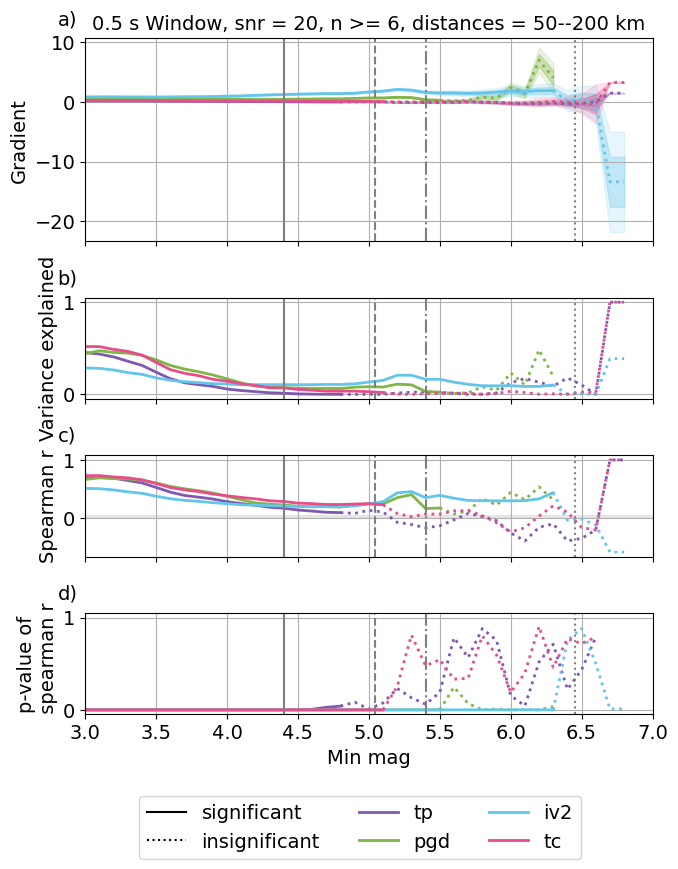

tp 0.694043750984817
pgd 0.6634341035797907
tc 0.6801575583036754
iv2 0.532294532316172
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


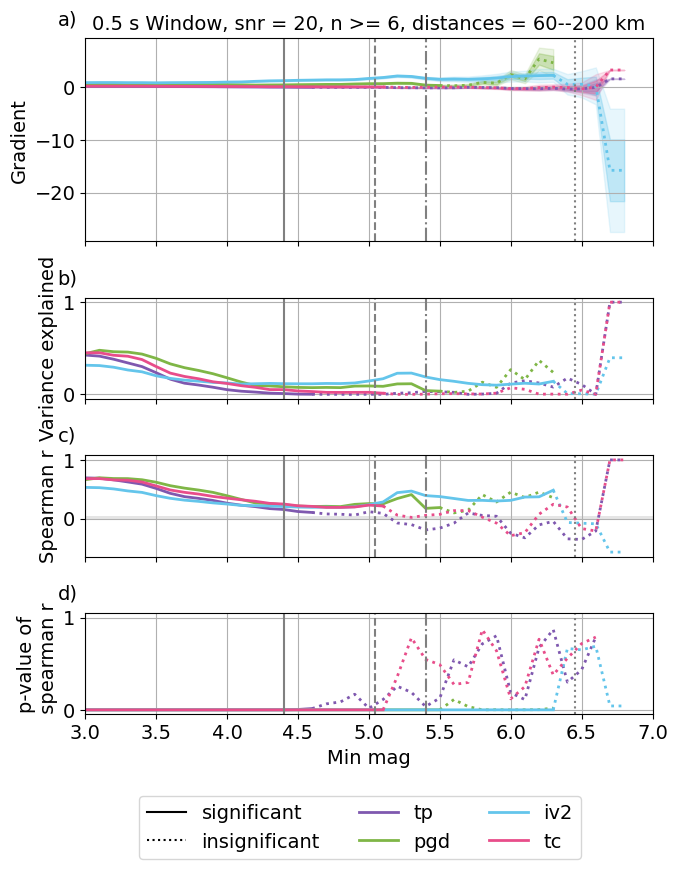

tp 0.6851914349677055
pgd 0.6655735480256368
tc 0.6147018515459602
iv2 0.569494801619513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


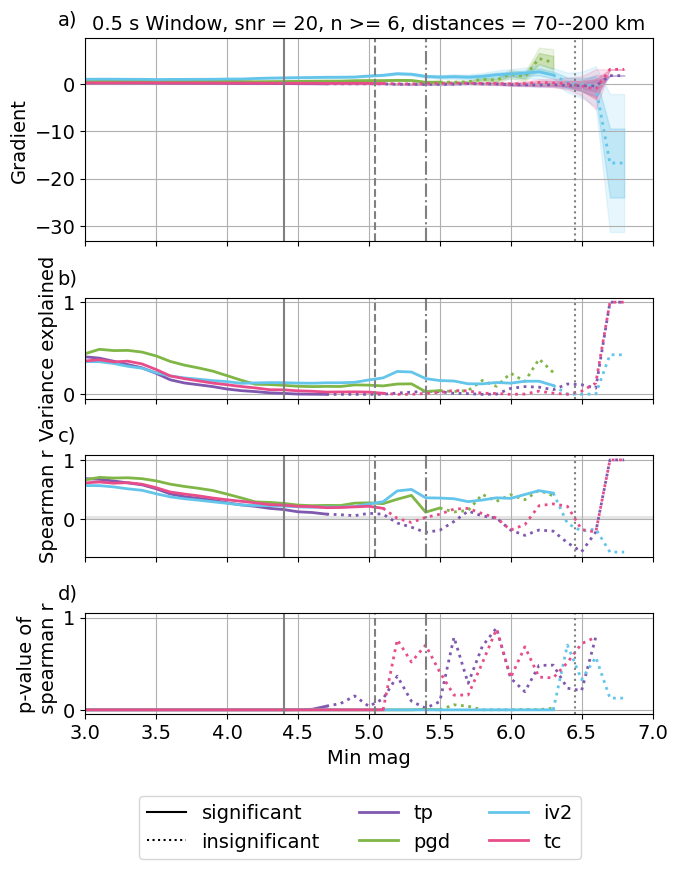

tp 0.6315171817592458
pgd 0.6592708531111483
tc 0.4966506795799729
iv2 0.6149783772644501
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


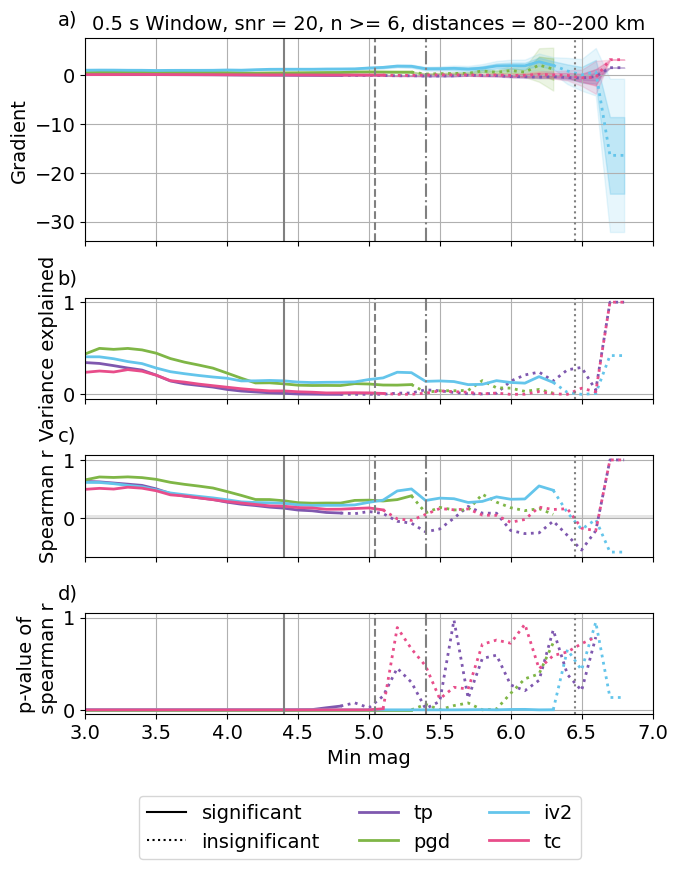

tp 0.603267826427909
pgd 0.6392805151054566
tc 0.41749431859788133
iv2 0.6274331966944893
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


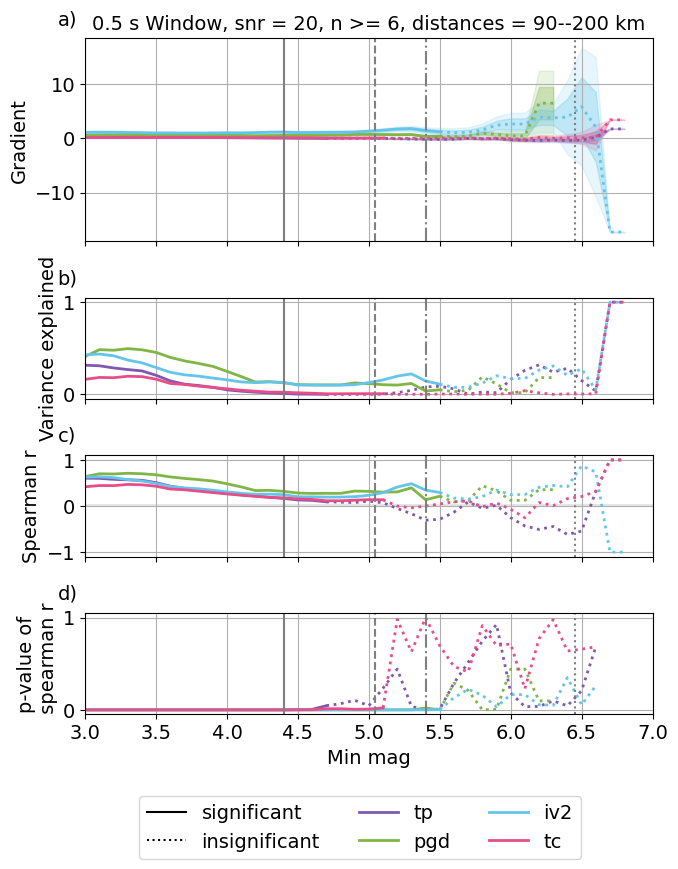

eq_object_1s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.5512087145694392
pgd 0.7843421371281877
tc 0.7626003645814441
iv2 0.6636591359076717
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


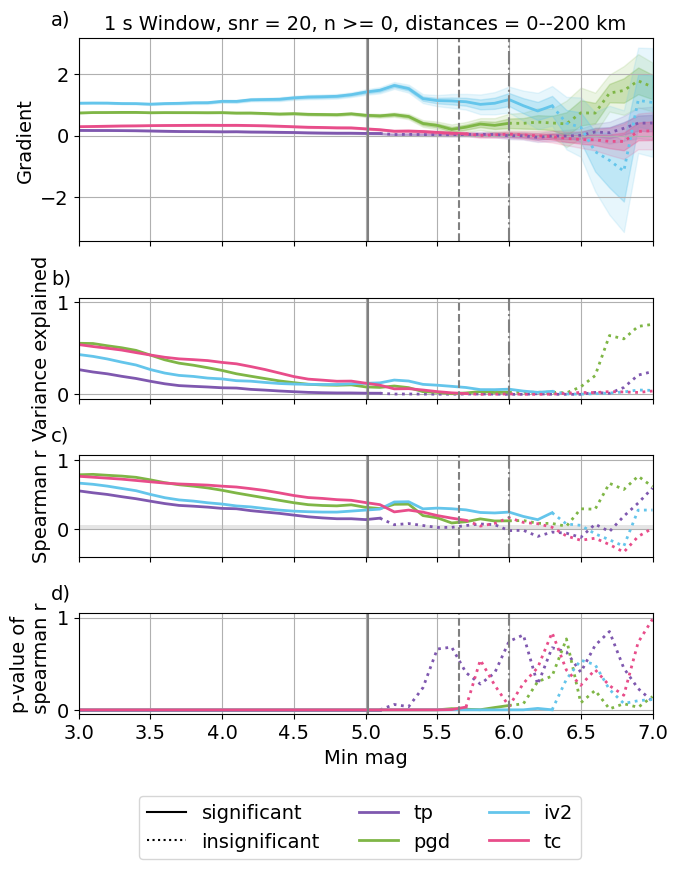

tp 0.5419636926649177
pgd 0.7815531072205659
tc 0.7563087078463073
iv2 0.6610594513622373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


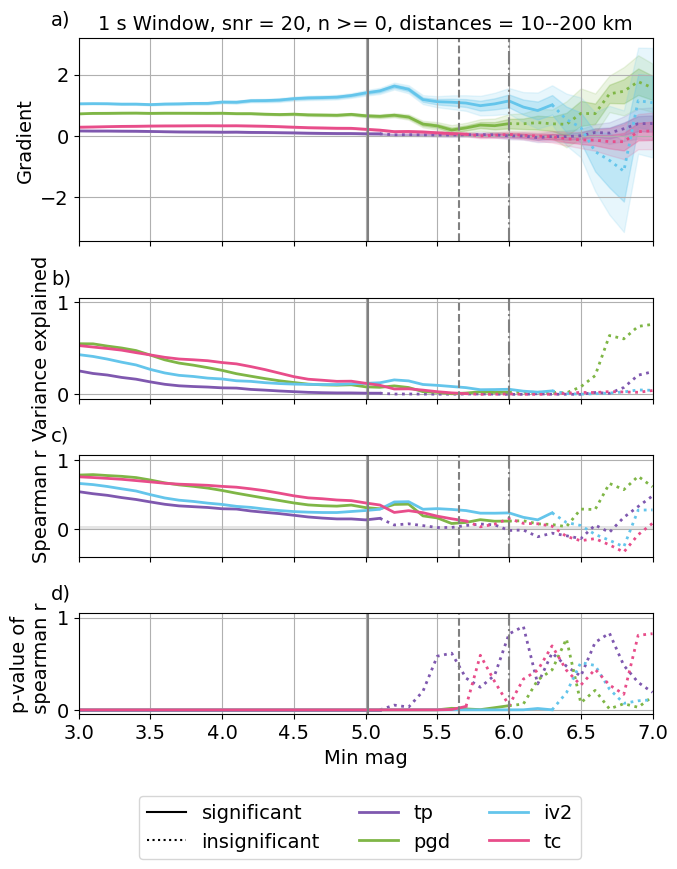

tp 0.5276755240487865
pgd 0.7736454216873317
tc 0.746277679020406
iv2 0.6474520251440593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


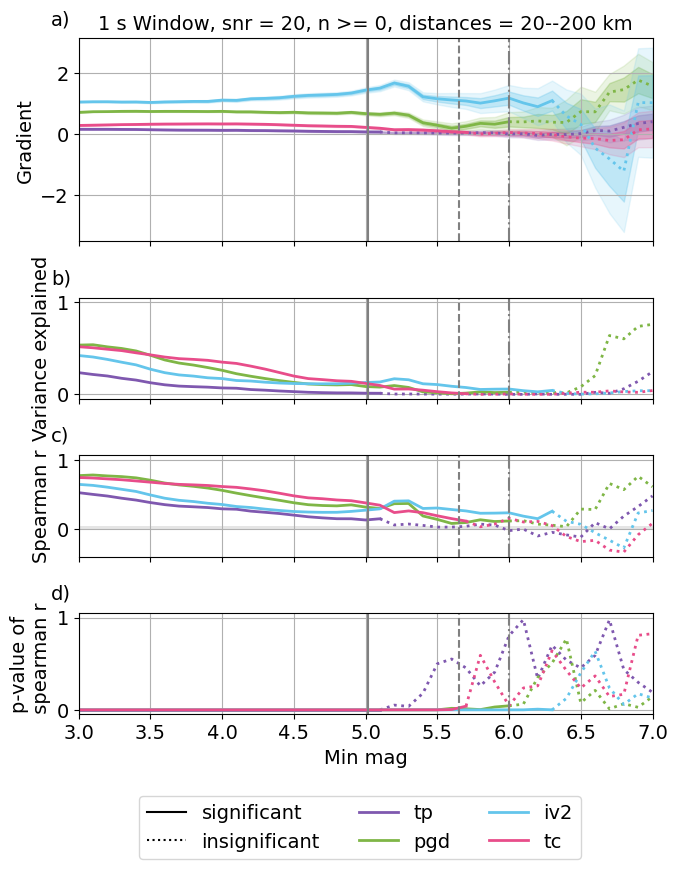

tp 0.5229966607885129
pgd 0.7627166394956099
tc 0.7337670739368669
iv2 0.6242263906596388
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


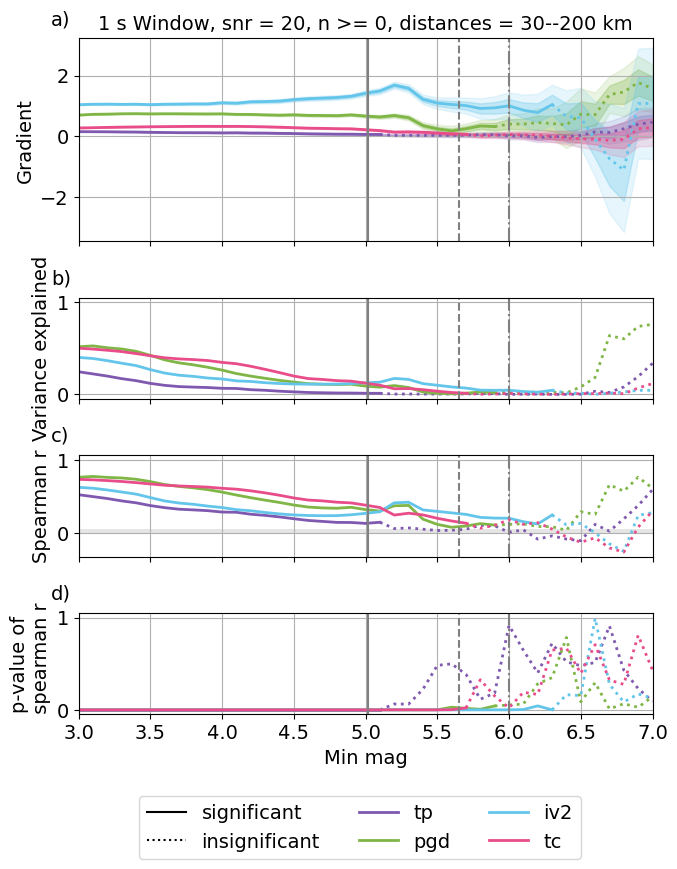

tp 0.5127434710845911
pgd 0.7529130375137443
tc 0.7249592893498725
iv2 0.6055852664423204
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


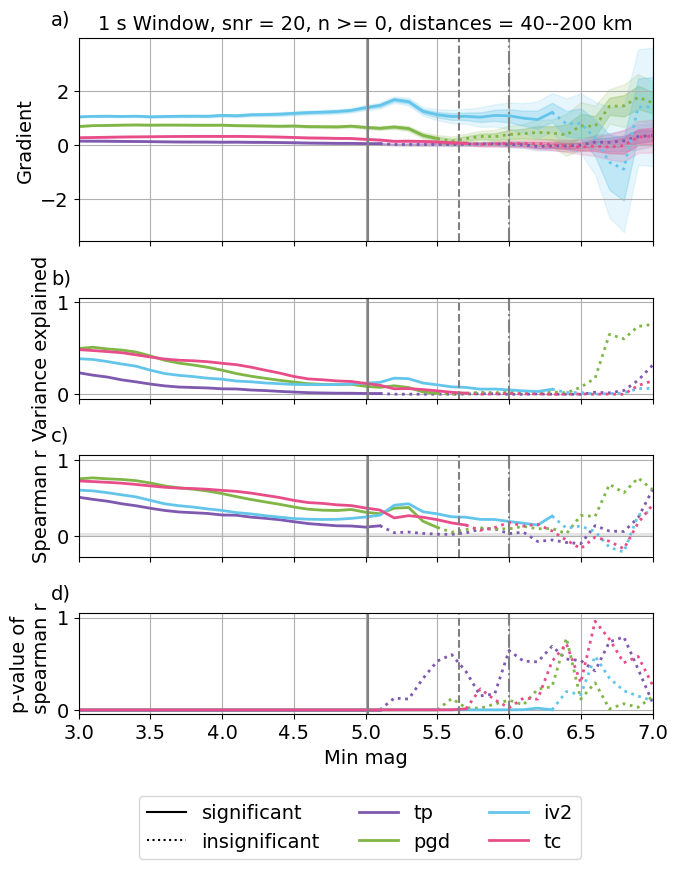

tp 0.5038172130774503
pgd 0.750902053192964
tc 0.7122183909207396
iv2 0.6075178918253333
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


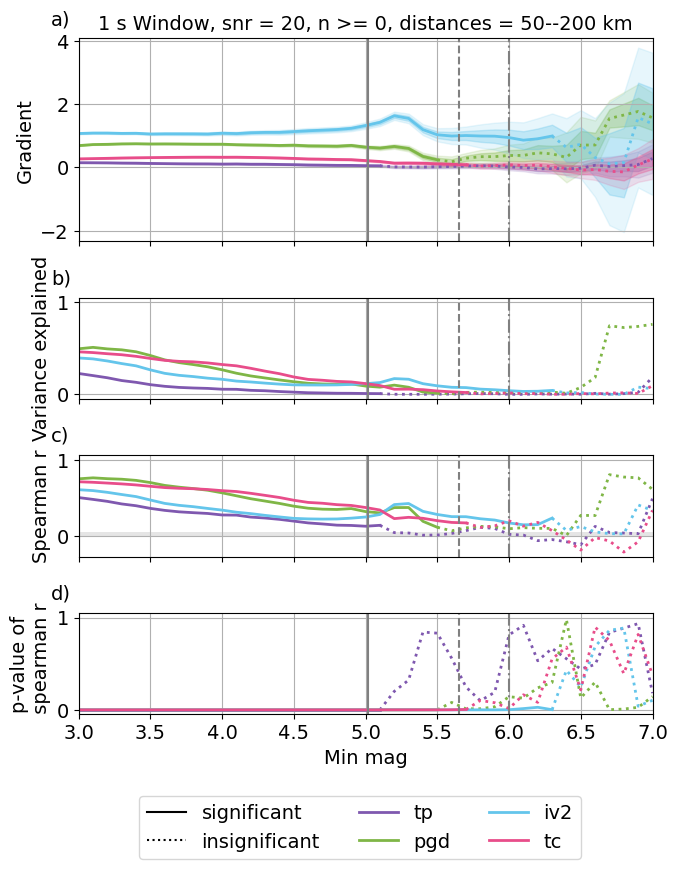

tp 0.48842724906827983
pgd 0.7487212854285258
tc 0.6872340515567524
iv2 0.6162893240675861
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


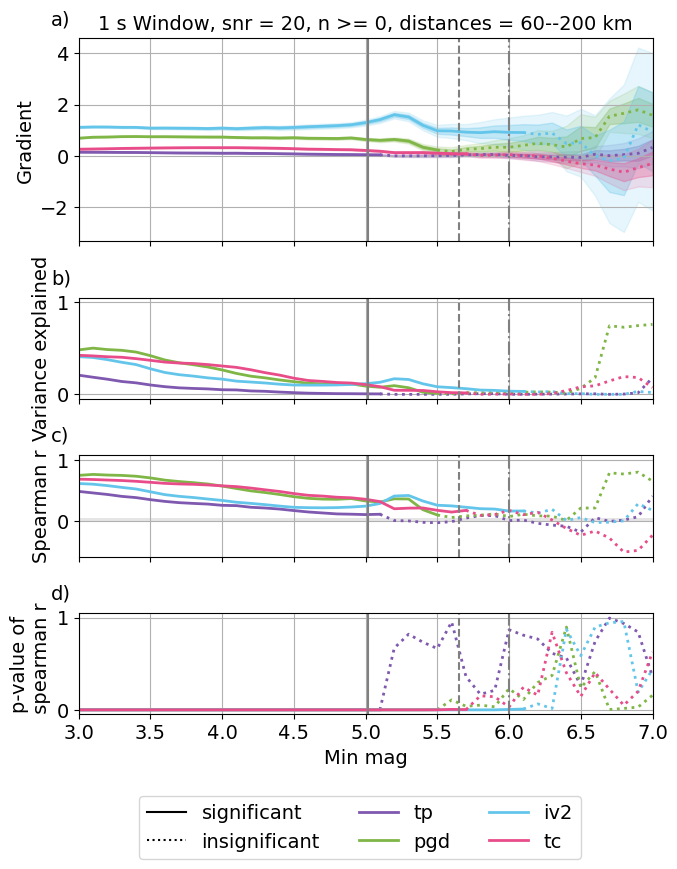

tp 0.485902171795519
pgd 0.748142211847721
tc 0.6577952580962916
iv2 0.6319559588579112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


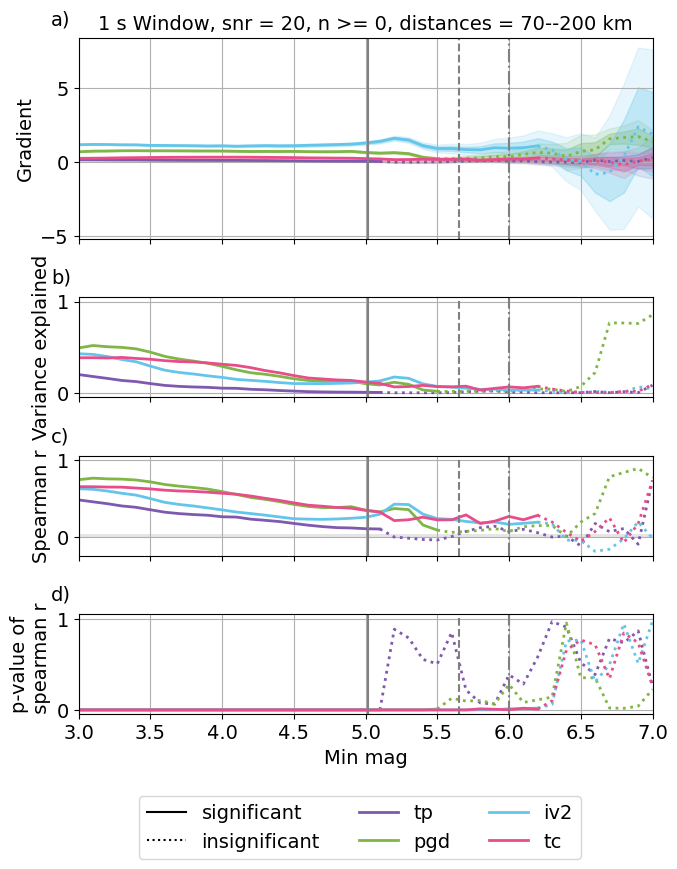

tp 0.46271925228753347
pgd 0.7406220328930815
tc 0.6092141241990964
iv2 0.645050471929609
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


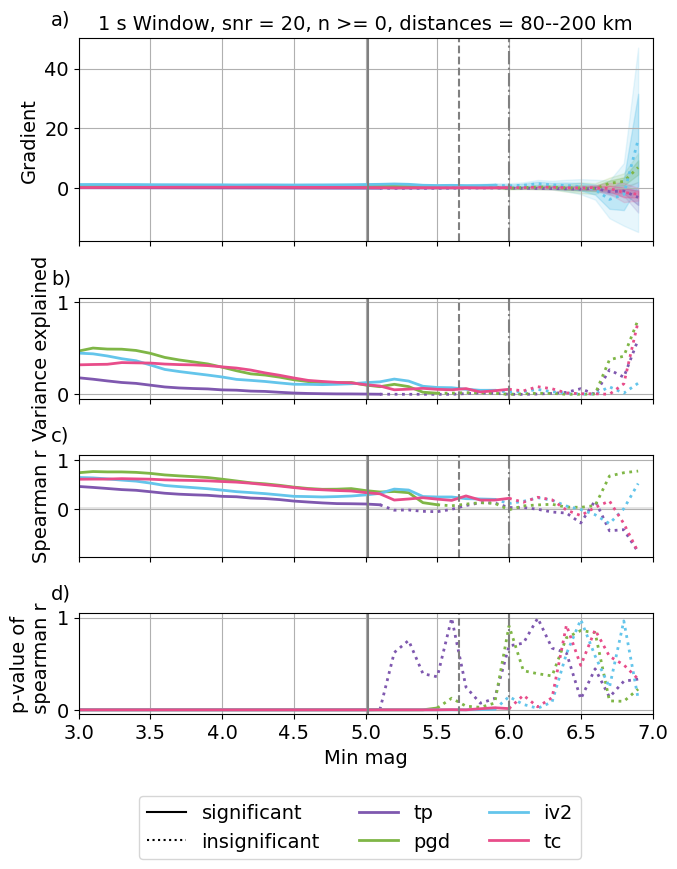

tp 0.437604362795213
pgd 0.7248890797451294
tc 0.5705912880980833
iv2 0.6358179787817336
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


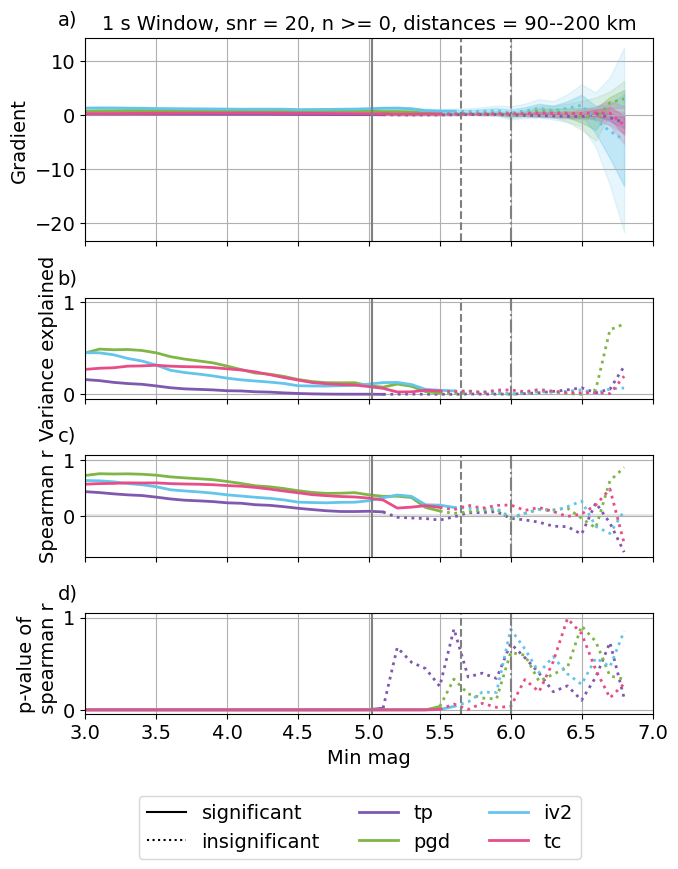

tp 0.5512087145694392
pgd 0.7843421371281877
tc 0.7626003645814441
iv2 0.6636591359076717
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


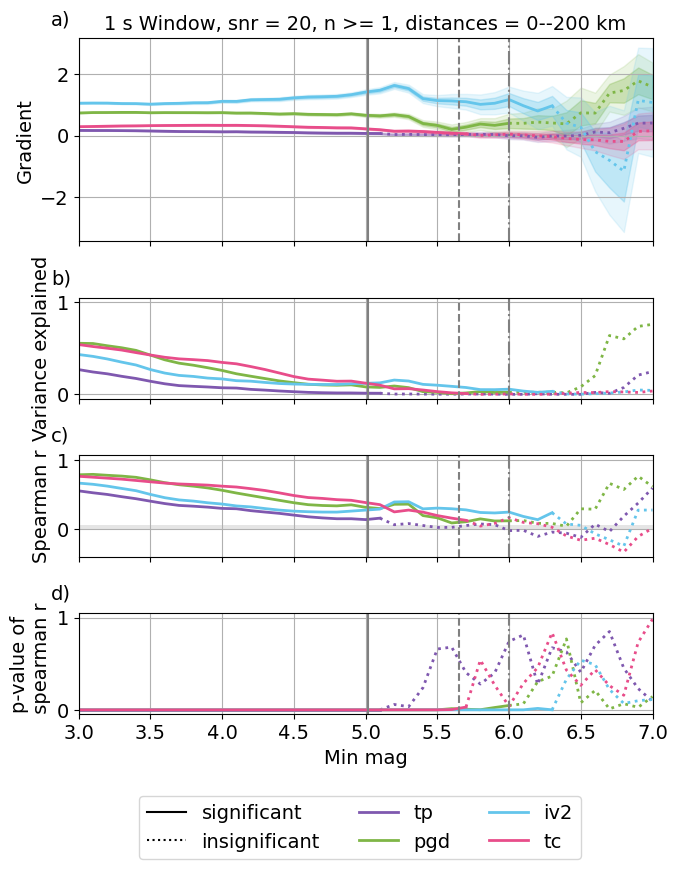

tp 0.5419636926649177
pgd 0.7815531072205659
tc 0.7563087078463073
iv2 0.6610594513622373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


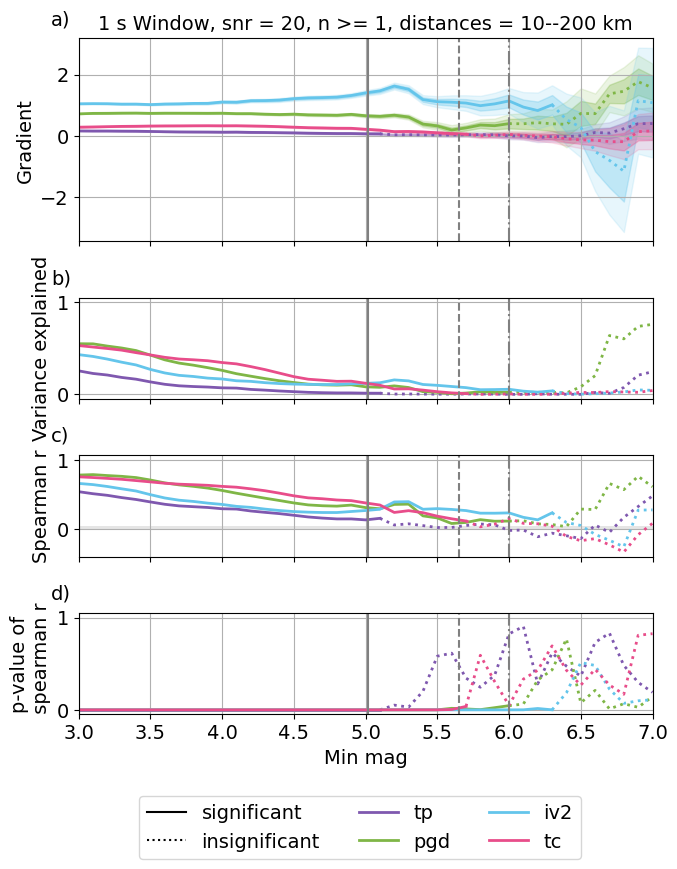

tp 0.5276755240487865
pgd 0.7736454216873317
tc 0.746277679020406
iv2 0.6474520251440593
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


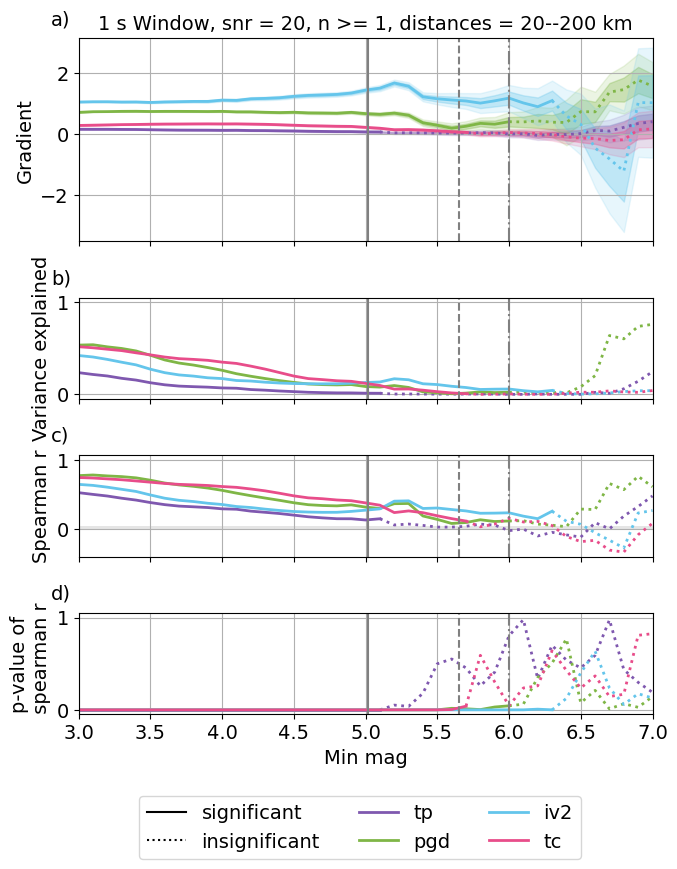

tp 0.5229966607885129
pgd 0.7627166394956099
tc 0.7337670739368669
iv2 0.6242263906596388
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


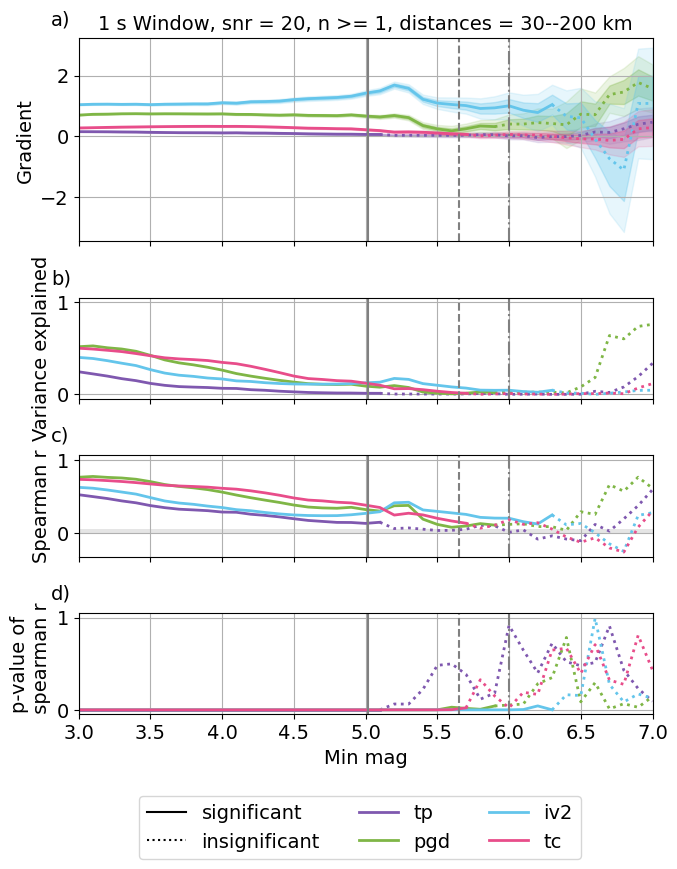

tp 0.5127434710845911
pgd 0.7529130375137443
tc 0.7249592893498725
iv2 0.6055852664423204
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


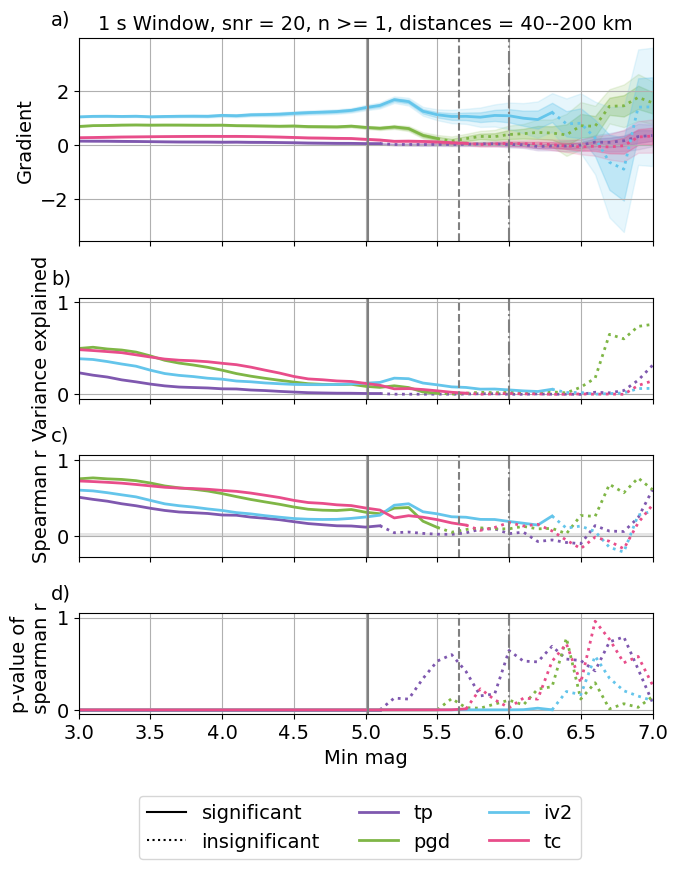

tp 0.5038172130774503
pgd 0.750902053192964
tc 0.7122183909207396
iv2 0.6075178918253333
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


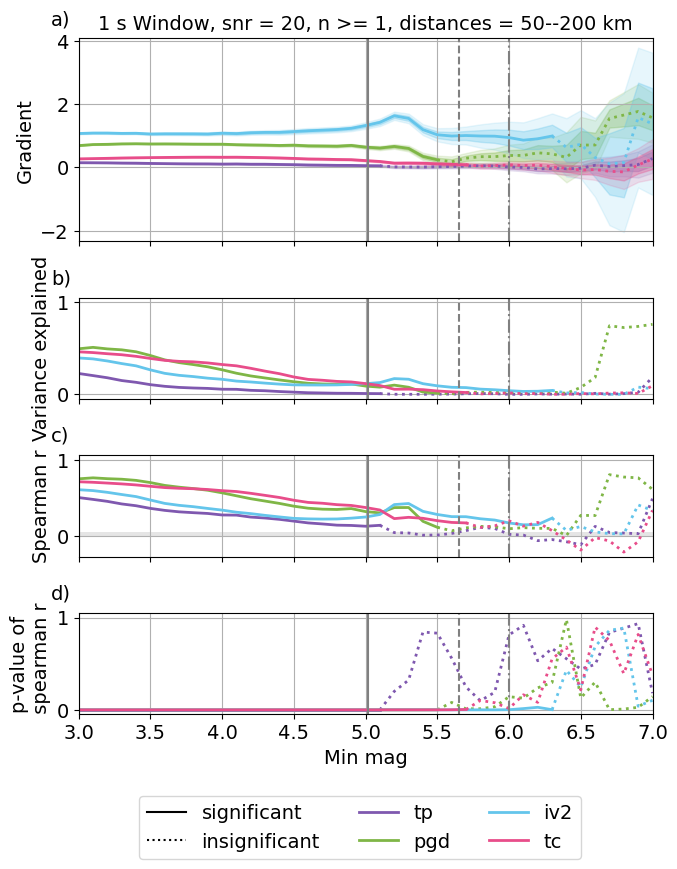

tp 0.48842724906827983
pgd 0.7487212854285258
tc 0.6872340515567524
iv2 0.6162893240675861
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


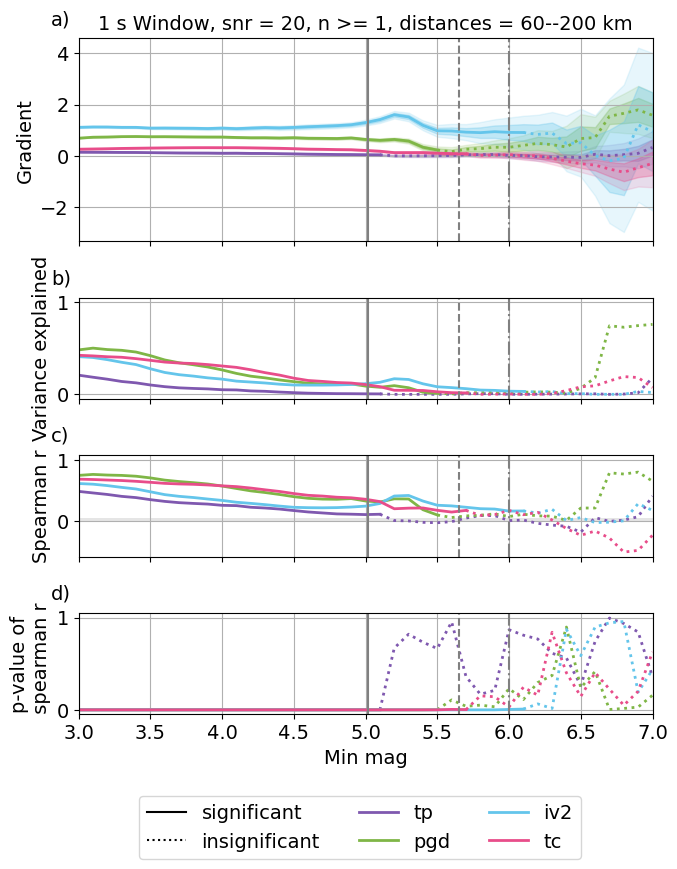

tp 0.485902171795519
pgd 0.748142211847721
tc 0.6577952580962916
iv2 0.6319559588579112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


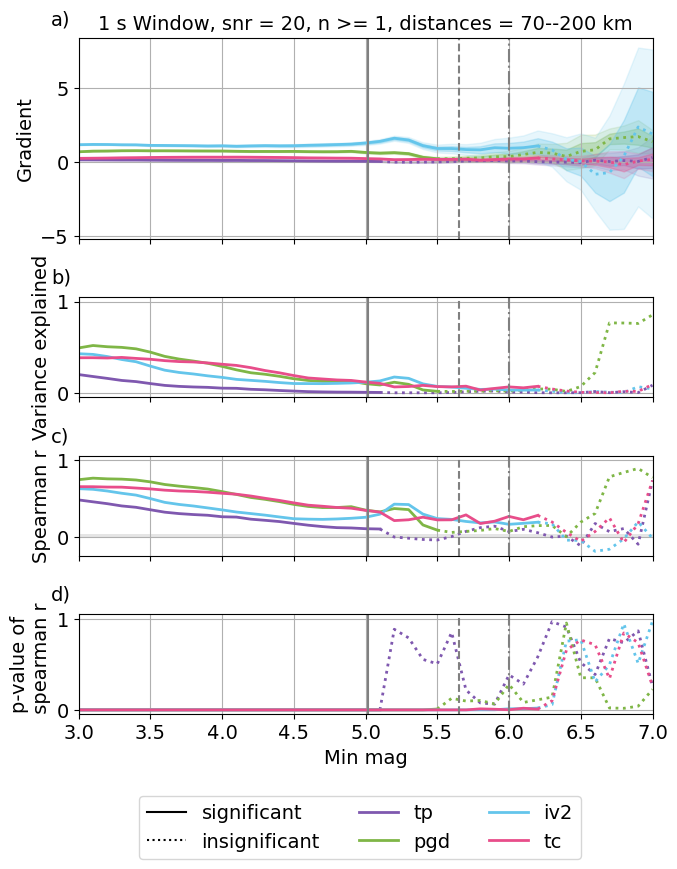

tp 0.46271925228753347
pgd 0.7406220328930815
tc 0.6092141241990964
iv2 0.645050471929609
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


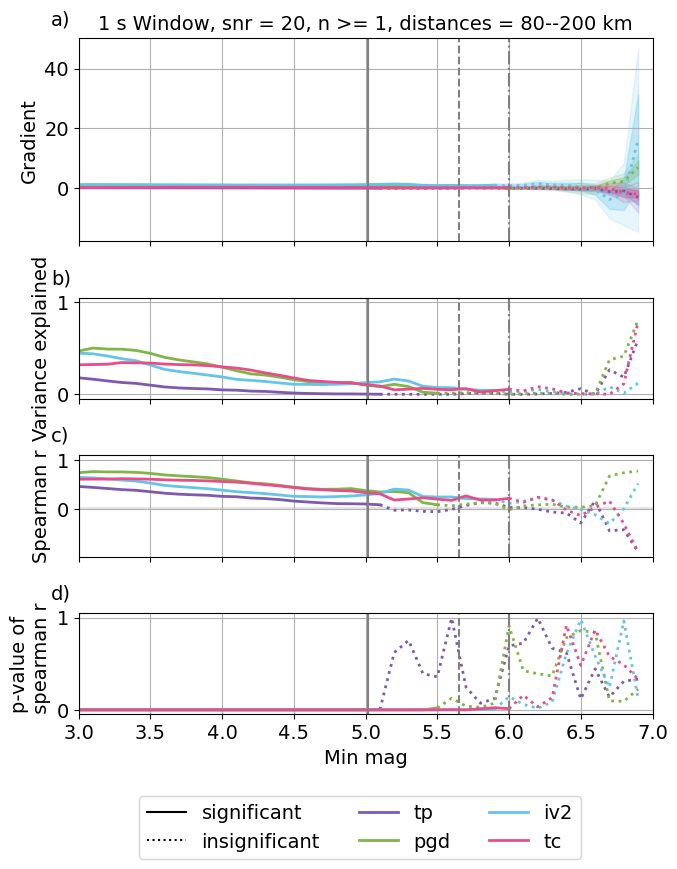

tp 0.437604362795213
pgd 0.7248890797451294
tc 0.5705912880980833
iv2 0.6358179787817336
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


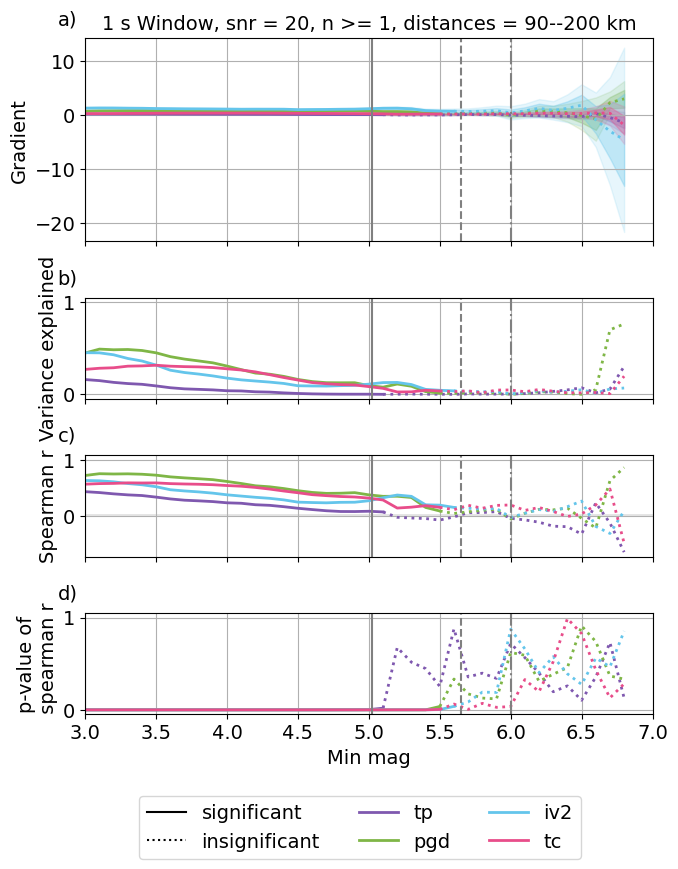

tp 0.6367026388824636
pgd 0.7846381582995257
tc 0.7991330395816855
iv2 0.6654711636637513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


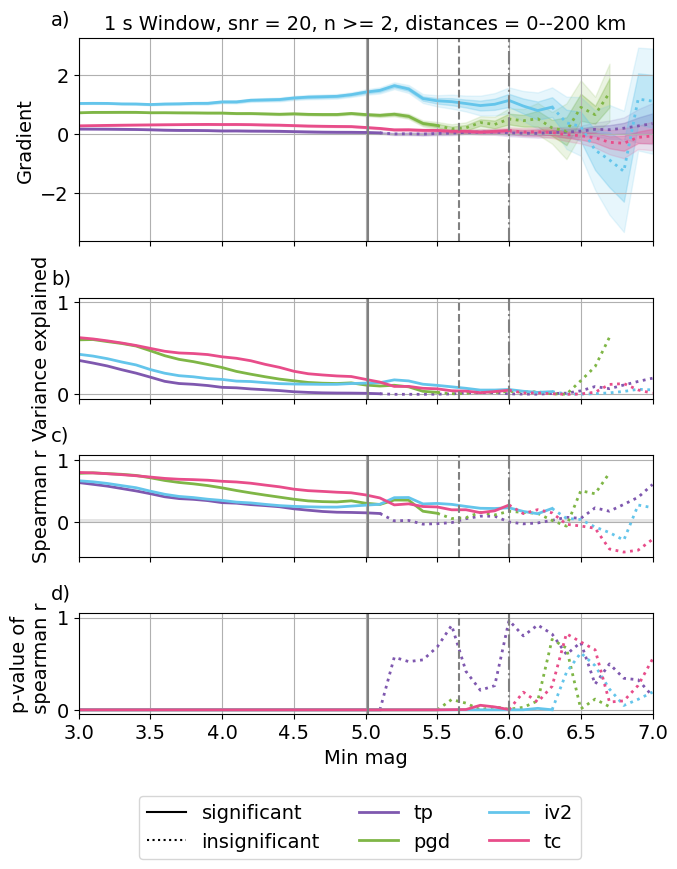

tp 0.6262727583797236
pgd 0.782093764146376
tc 0.788987922203304
iv2 0.6632040725662478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


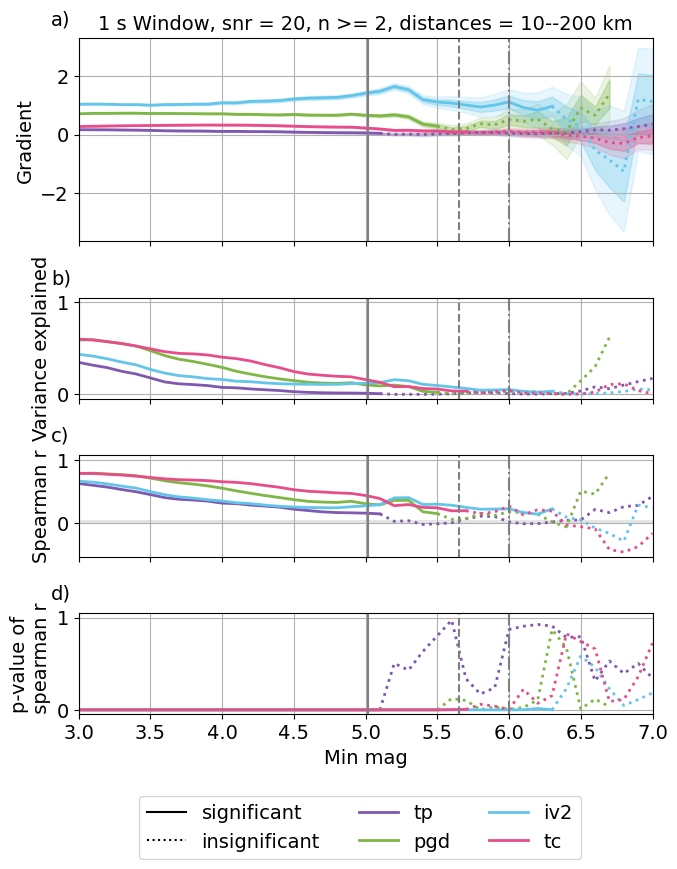

tp 0.6105026427401591
pgd 0.7741062099341737
tc 0.7748739316451556
iv2 0.6499850115428207
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


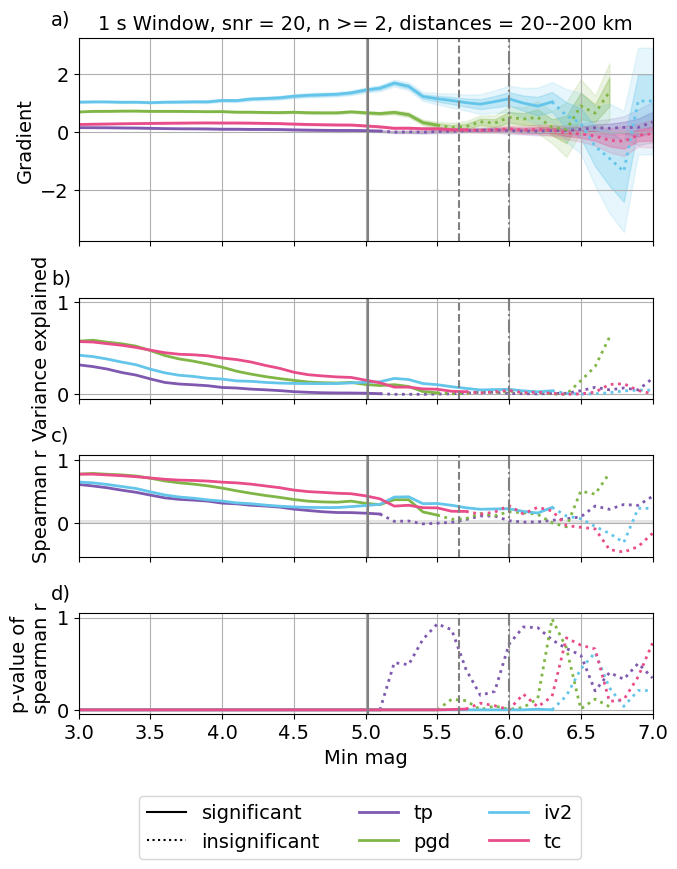

tp 0.6009571500712926
pgd 0.7639691741306918
tc 0.7582865643950142
iv2 0.6267349758539069
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


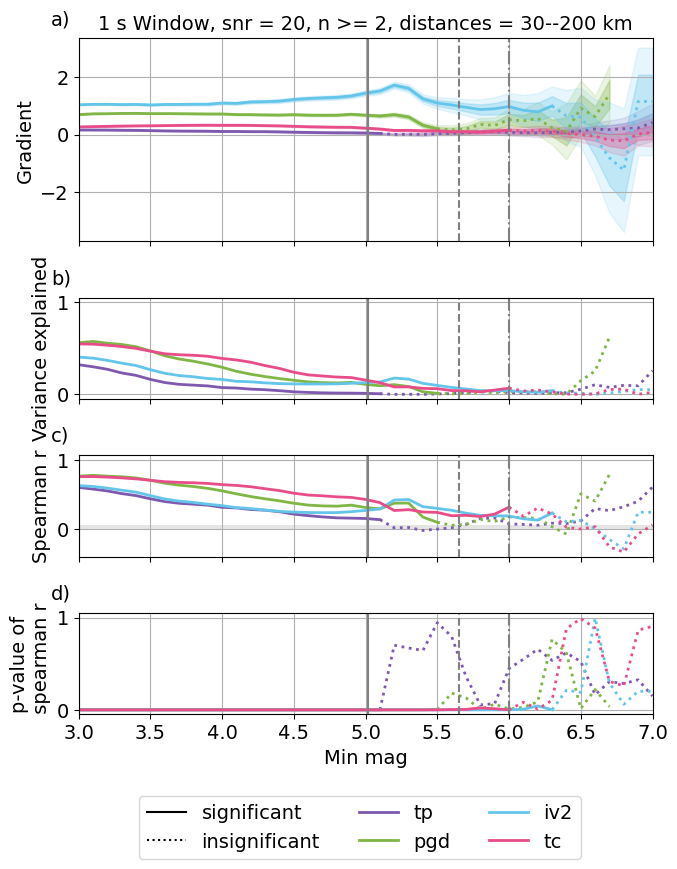

tp 0.5911365106582502
pgd 0.7549291476557112
tc 0.7519092293895164
iv2 0.6087268081762182
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


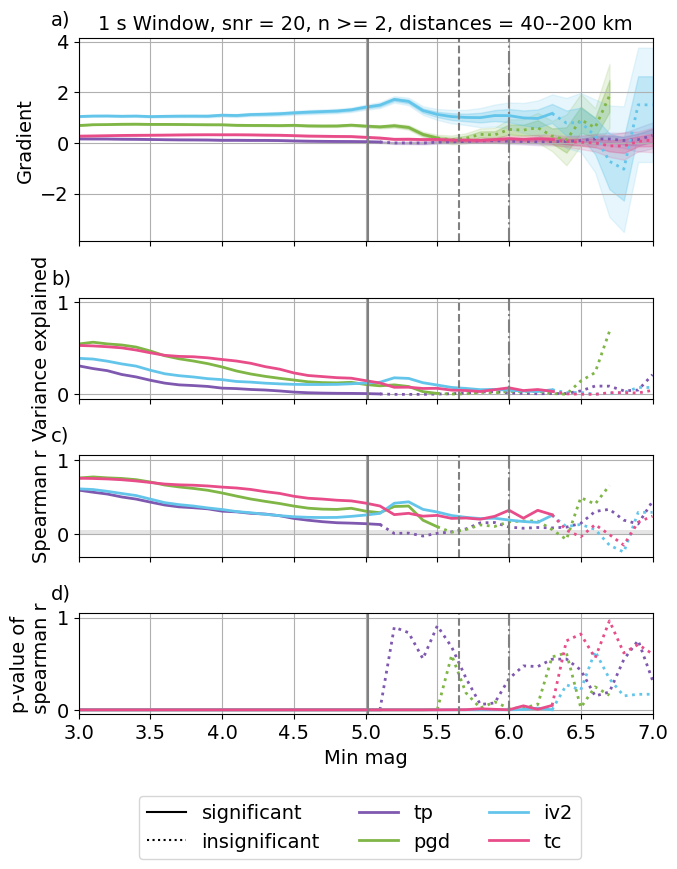

tp 0.5799544775732319
pgd 0.7532077499302827
tc 0.7344441349874743
iv2 0.6122446490509744
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


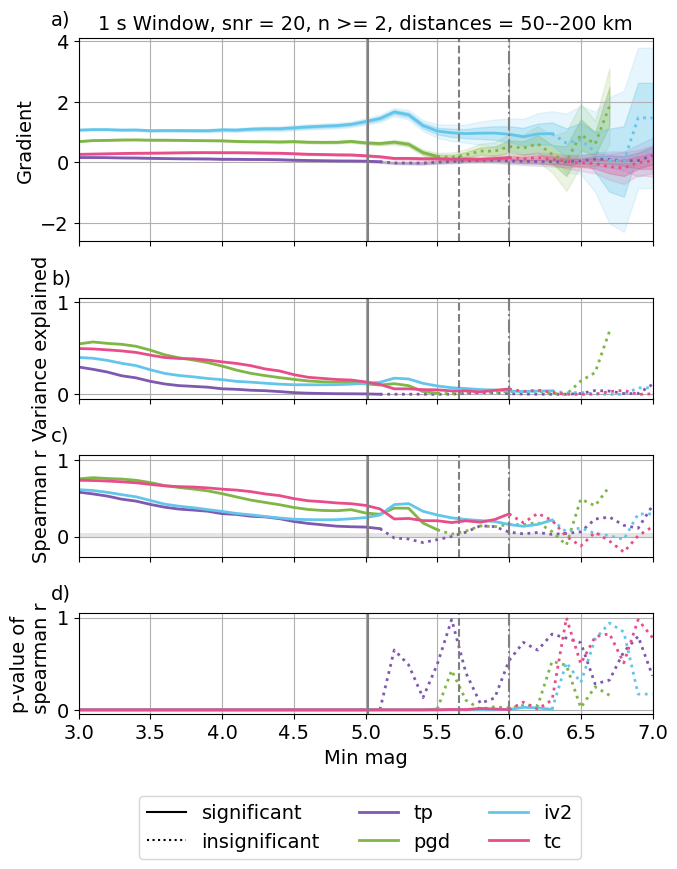

tp 0.5626931684823792
pgd 0.7511414101675891
tc 0.7064373475197028
iv2 0.6227824996025813
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


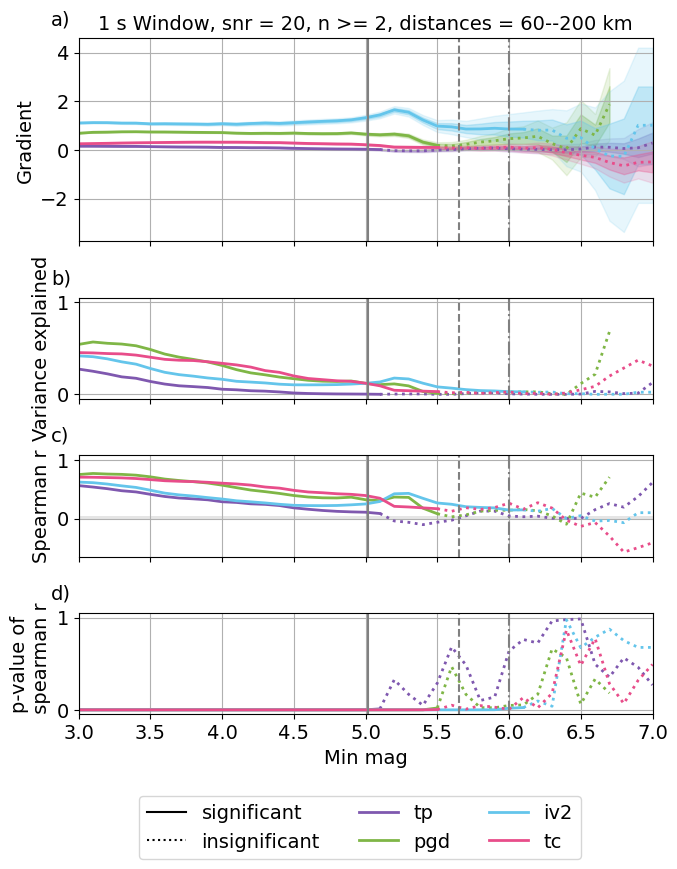

tp 0.5535409542099313
pgd 0.7494162787495428
tc 0.6693482654936967
iv2 0.6395825886326832
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


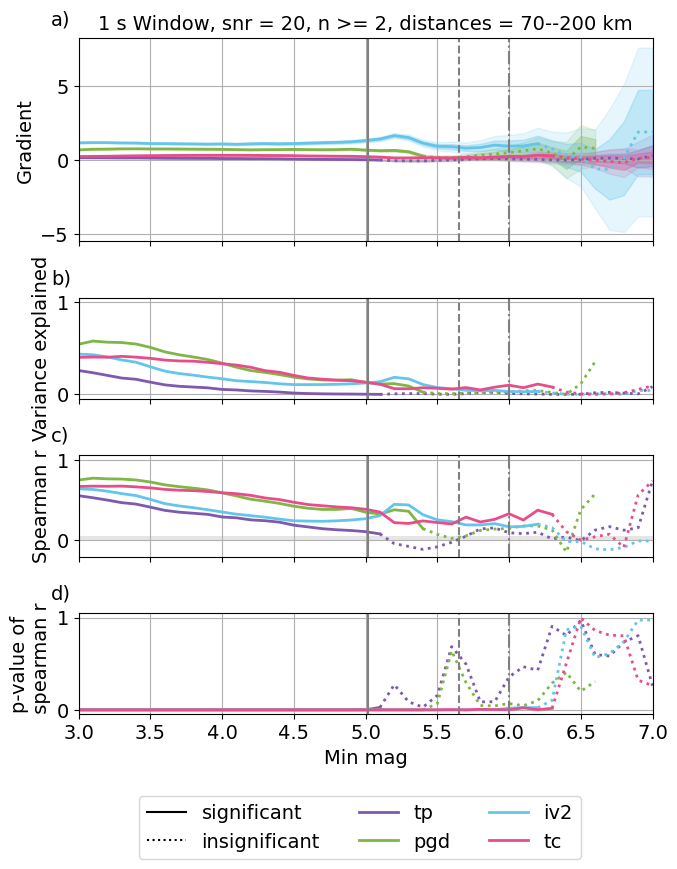

tp 0.5189893925390071
pgd 0.7422127972531061
tc 0.6107795353729175
iv2 0.6583947235782842
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


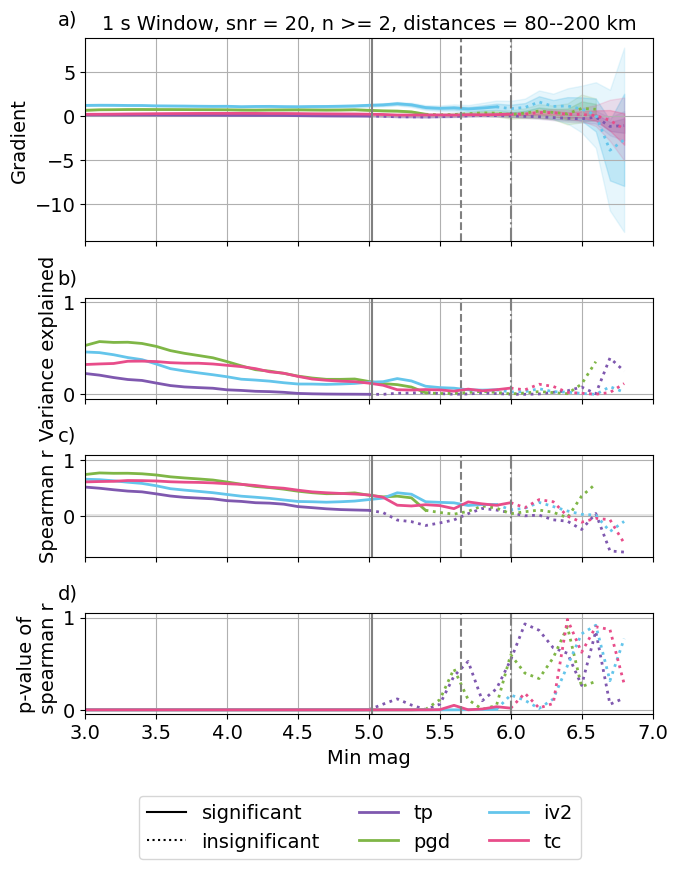

tp 0.4872952674500934
pgd 0.7240082250399628
tc 0.5691604292336742
iv2 0.6567998397464018
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


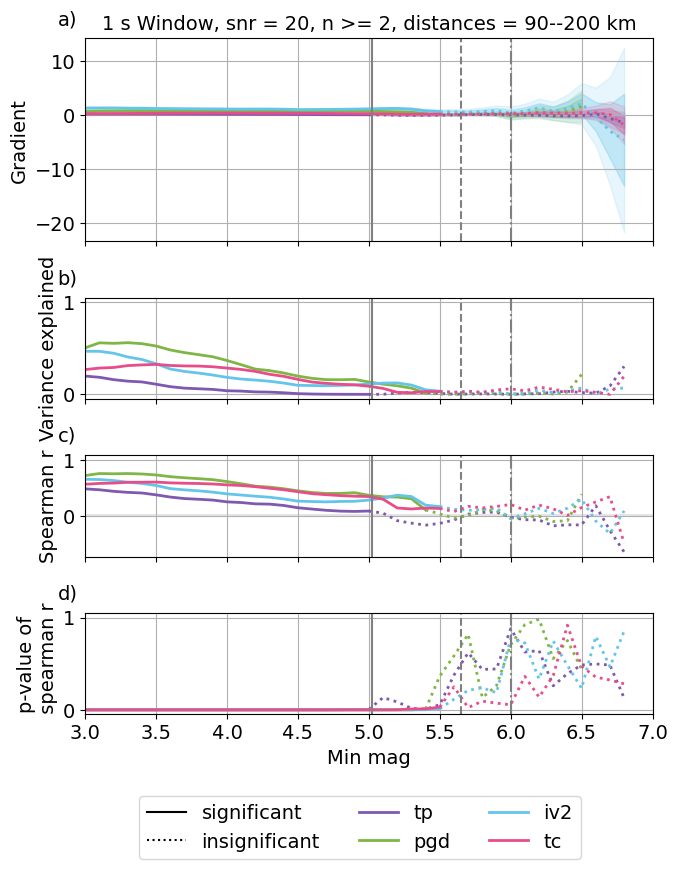

tp 0.6840645106158137
pgd 0.7818493606726978
tc 0.8087687058523882
iv2 0.6630965581124019
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


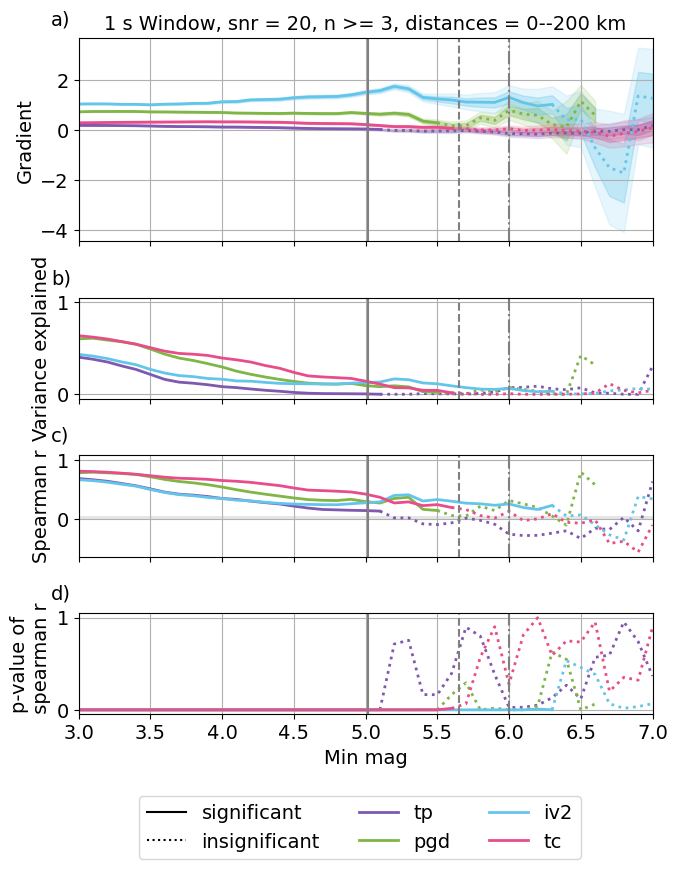

tp 0.6791338903983465
pgd 0.7798141976652352
tc 0.7991120736311317
iv2 0.661153092574373
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


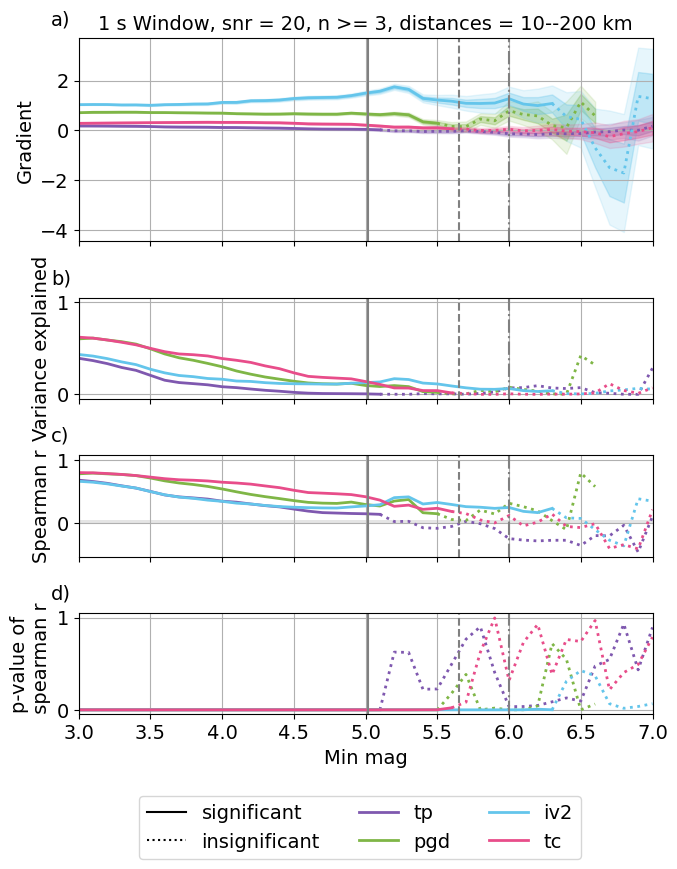

tp 0.663585203509251
pgd 0.7722018829460213
tc 0.7888998200451739
iv2 0.6497205384787665
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


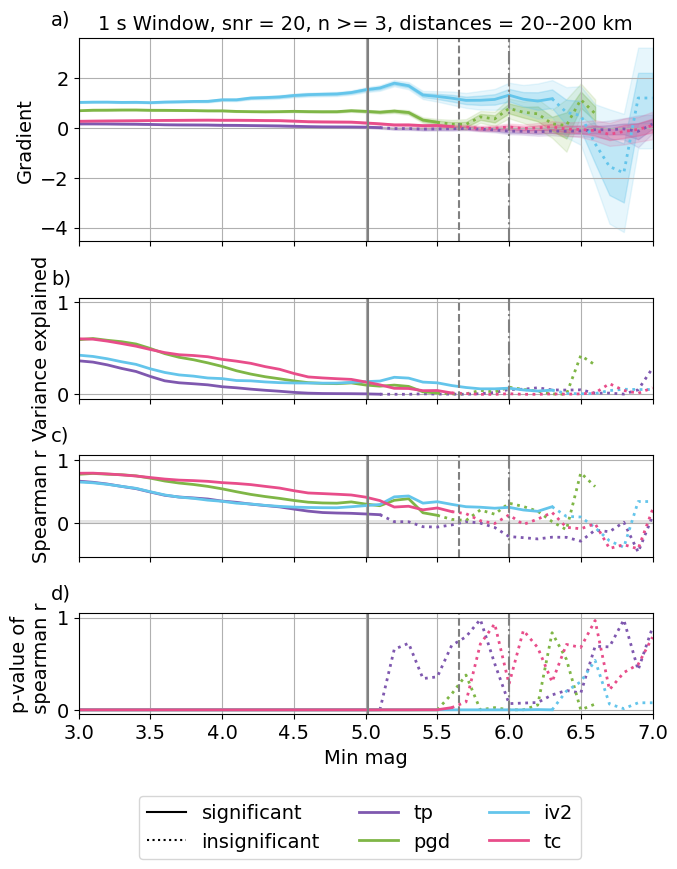

tp 0.6580752022571339
pgd 0.7625725033493627
tc 0.7713434217884405
iv2 0.627630809415938
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


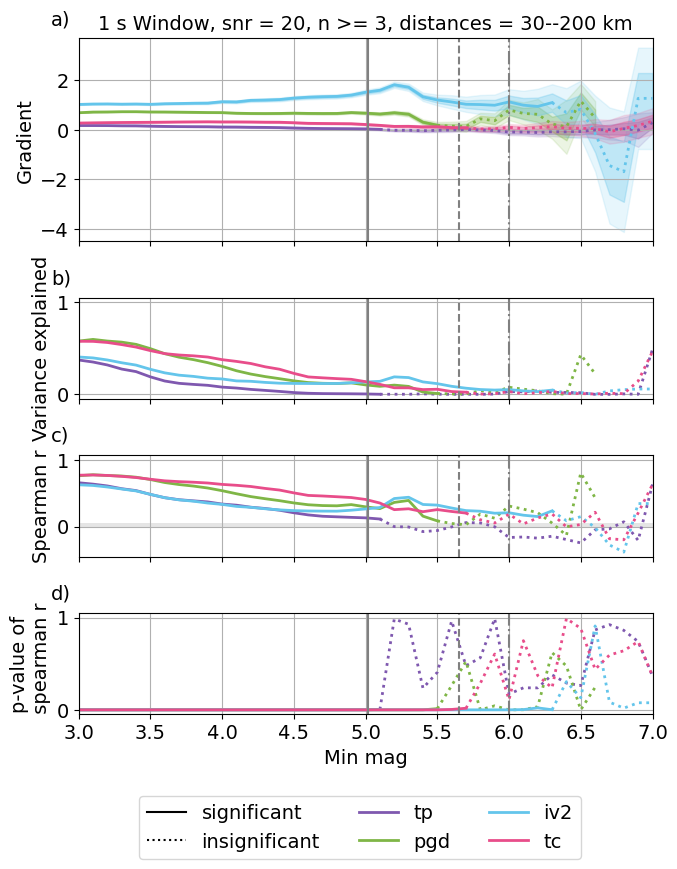

tp 0.648299974060191
pgd 0.754039403745296
tc 0.7590075360391026
iv2 0.6118737113500927
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


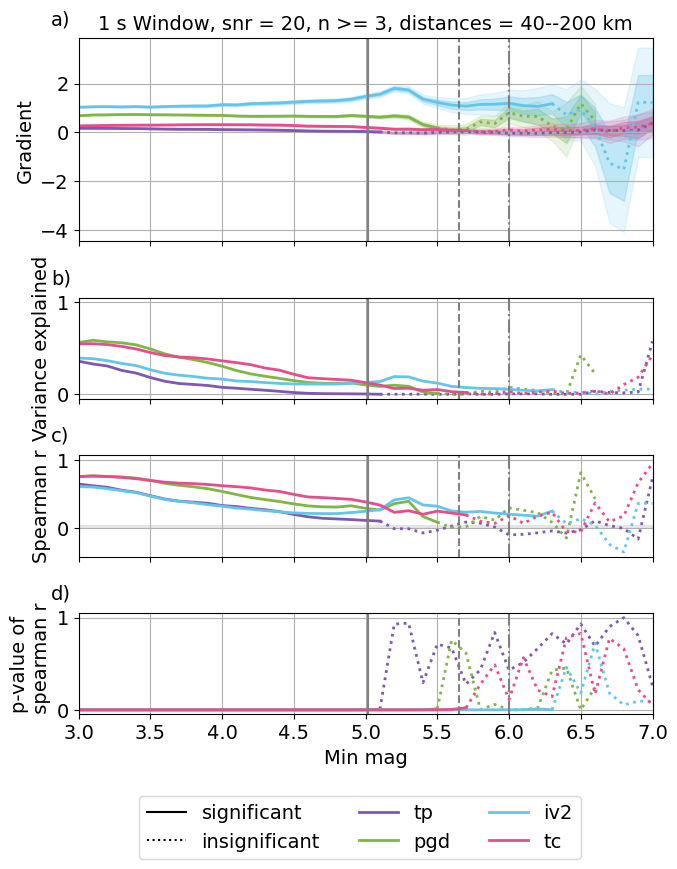

tp 0.641543712710611
pgd 0.7526961614911927
tc 0.7391975694682438
iv2 0.6162528101307737
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


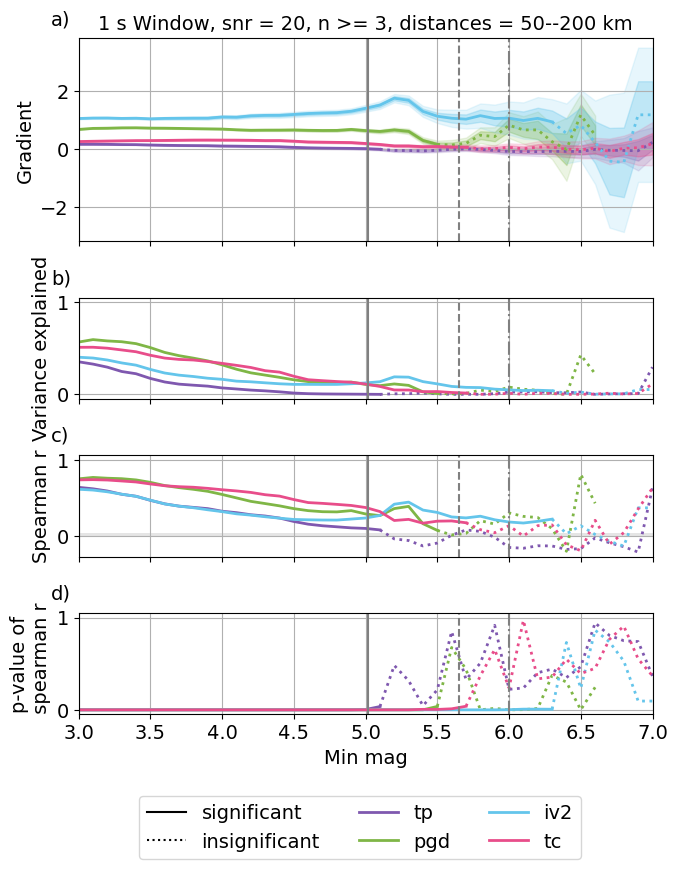

tp 0.6288693181364109
pgd 0.7499645777475654
tc 0.7090088719472984
iv2 0.6289819115884809
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


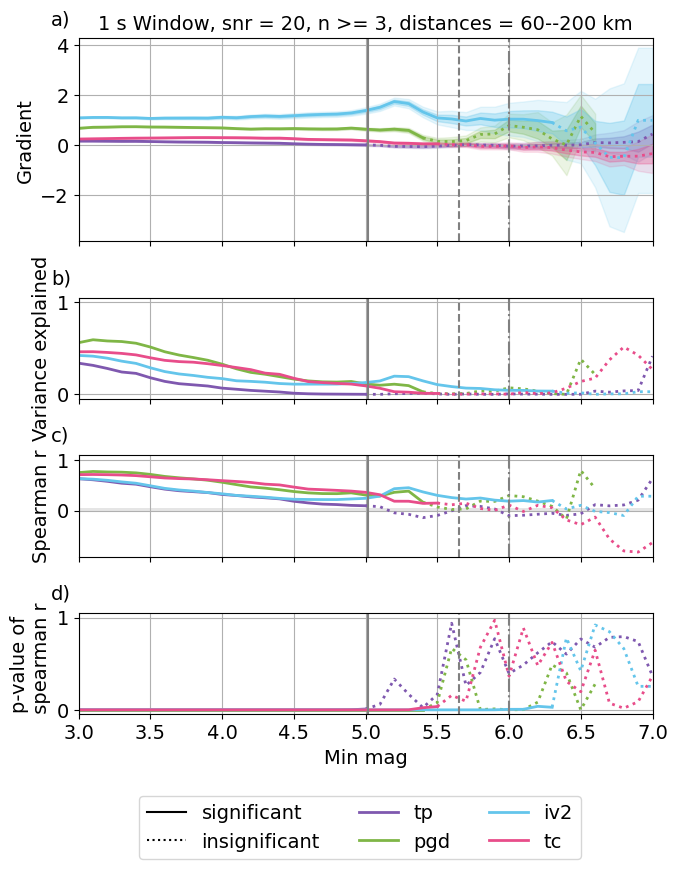

tp 0.6200820634979775
pgd 0.7461456423822442
tc 0.669435725187775
iv2 0.6444540903508
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


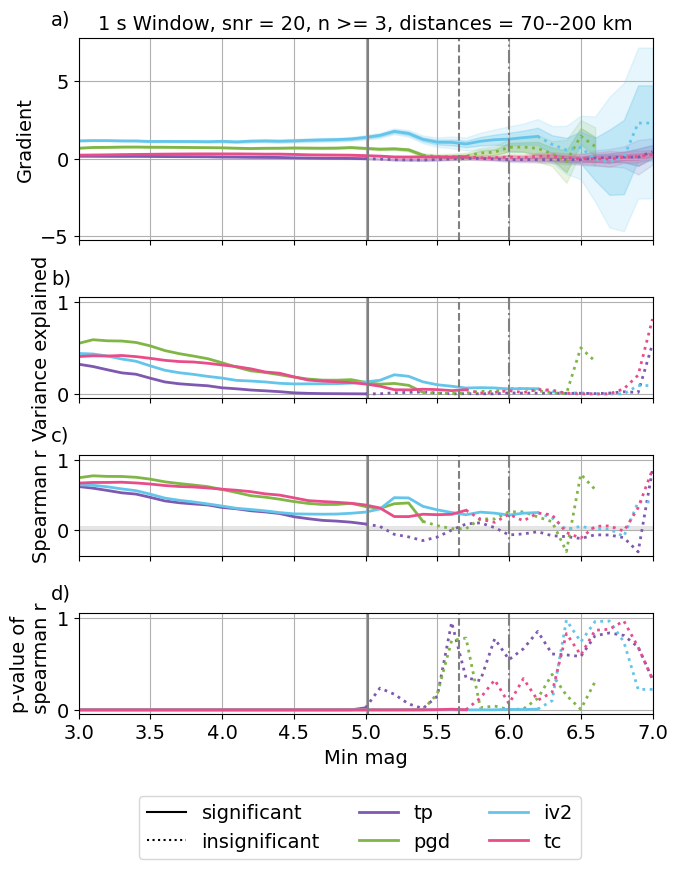

tp 0.5755217173763825
pgd 0.7367130102943859
tc 0.6042092481424959
iv2 0.6653823367164459
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


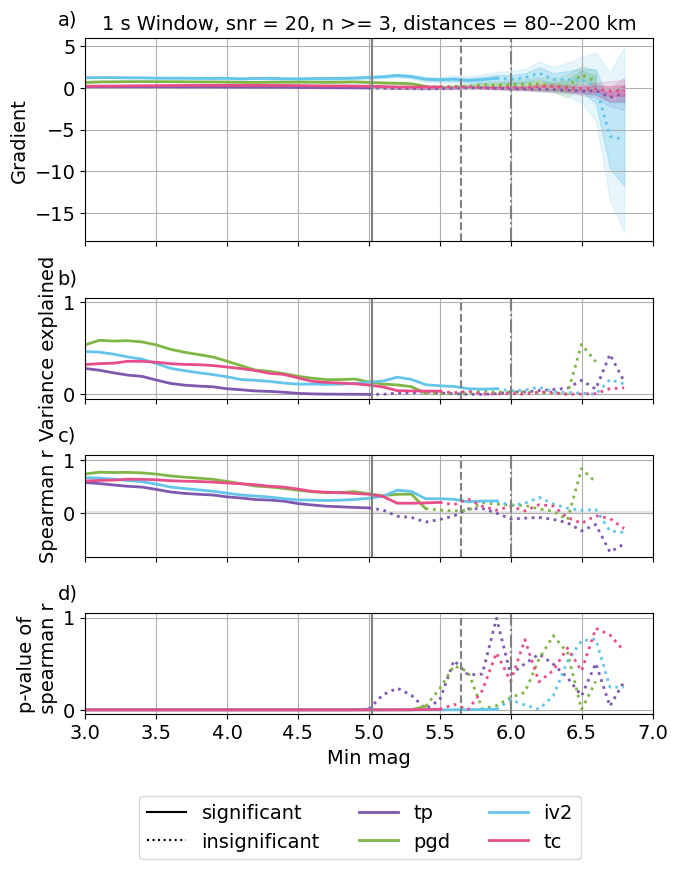

tp 0.5432868411362419
pgd 0.7160321057179433
tc 0.5584407387376096
iv2 0.664497971262494
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


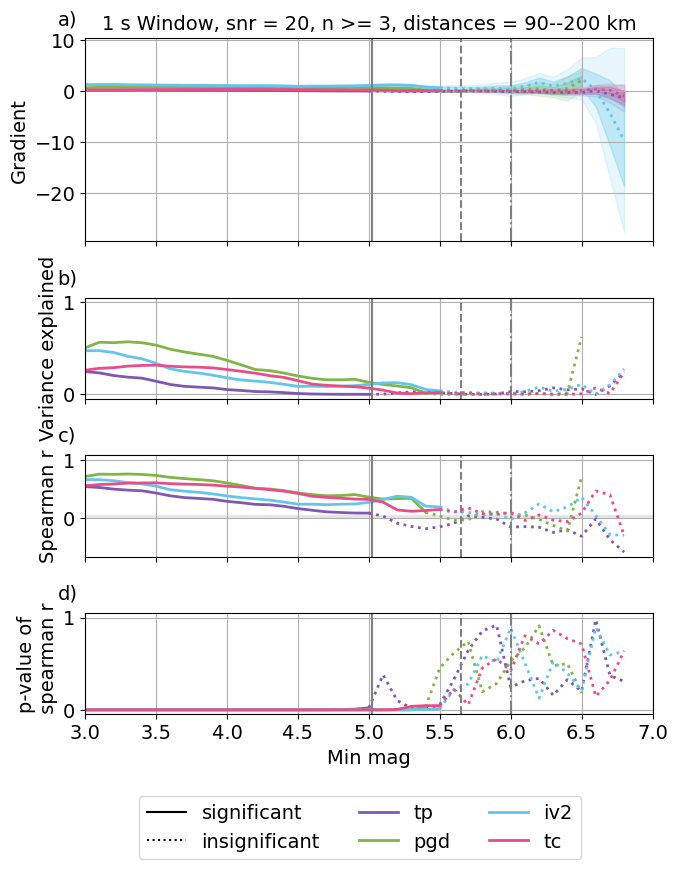

tp 0.7280620106825542
pgd 0.7769026513128152
tc 0.8163556527252285
iv2 0.6579694794672123
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


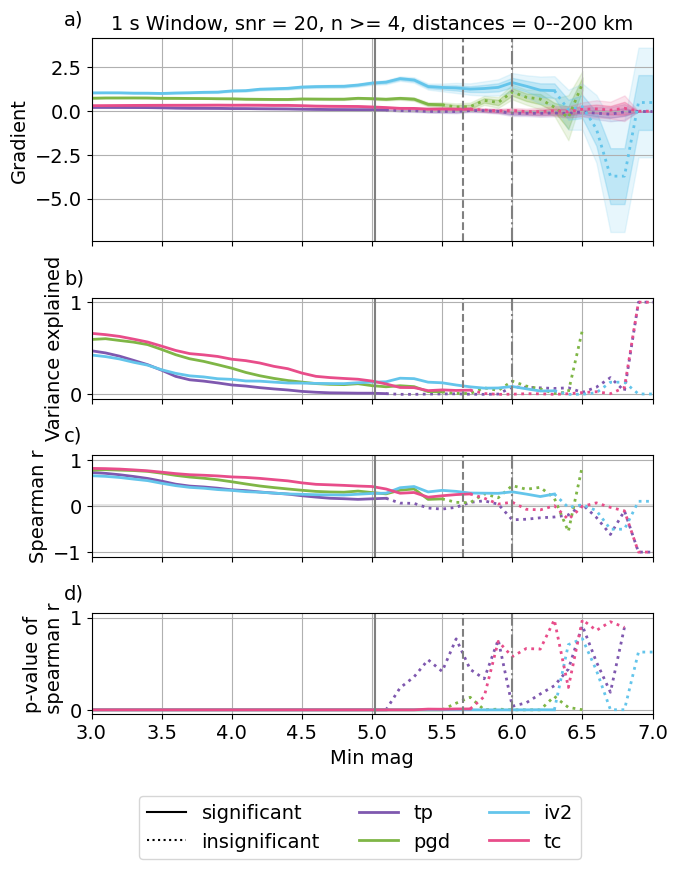

tp 0.7196200114372309
pgd 0.7751981968298115
tc 0.8049305075767654
iv2 0.6564459242130897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


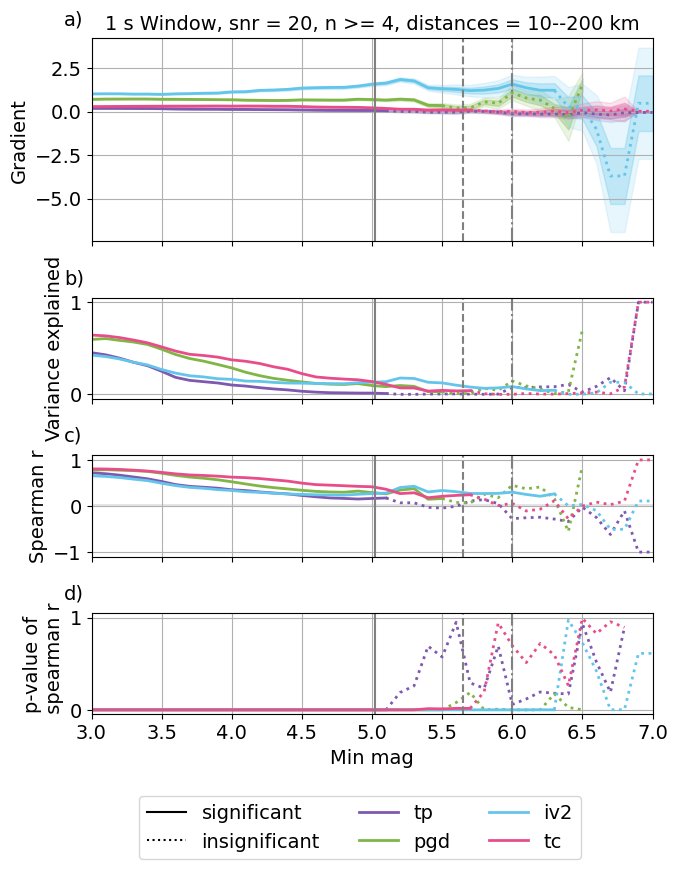

tp 0.708120013476559
pgd 0.7676283284813246
tc 0.7945080141475575
iv2 0.6458877637669984
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


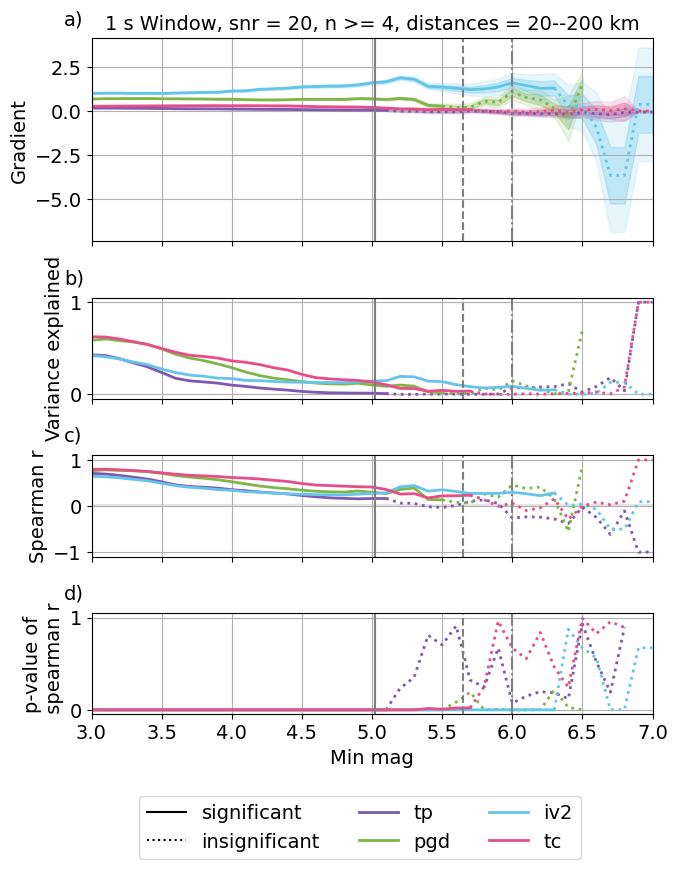

tp 0.6983161107286041
pgd 0.7582224312046428
tc 0.7743235092808982
iv2 0.624842889876616
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


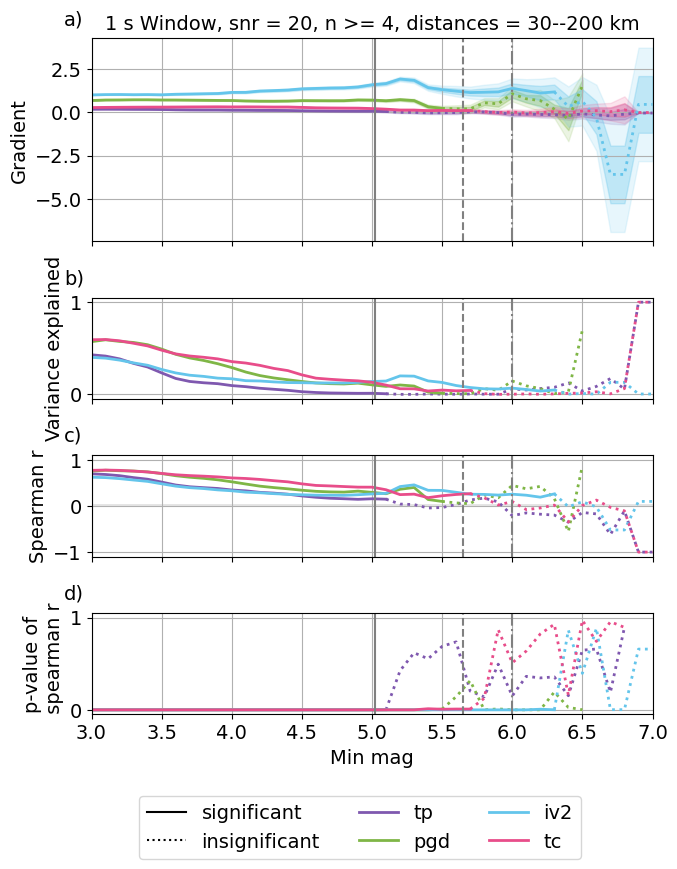

tp 0.6867173814107199
pgd 0.7499226946649623
tc 0.7608561508749011
iv2 0.610385765915939
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


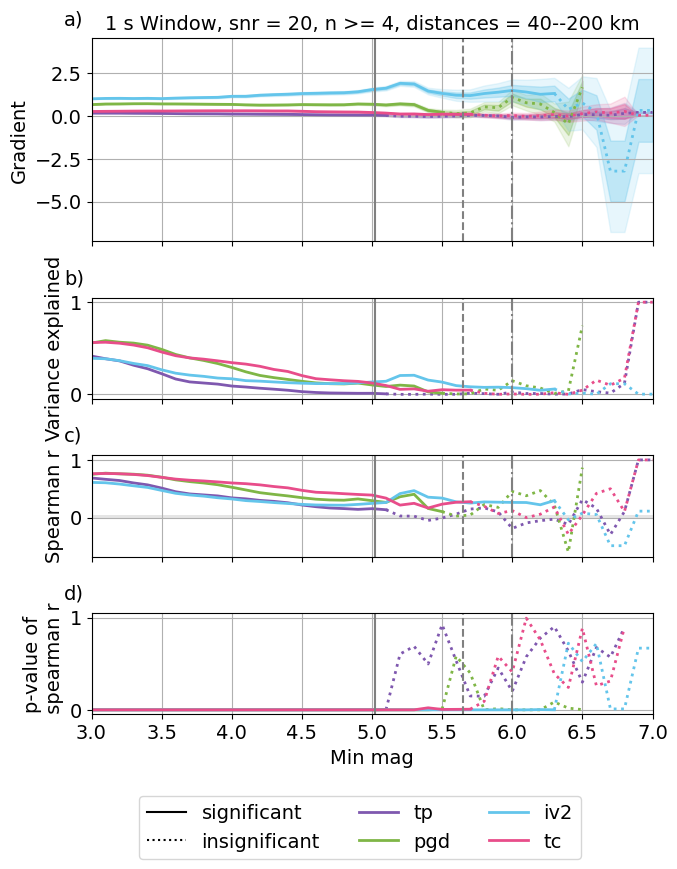

tp 0.6772759500644502
pgd 0.7485065932758432
tc 0.7395727615487278
iv2 0.6168405053839012
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


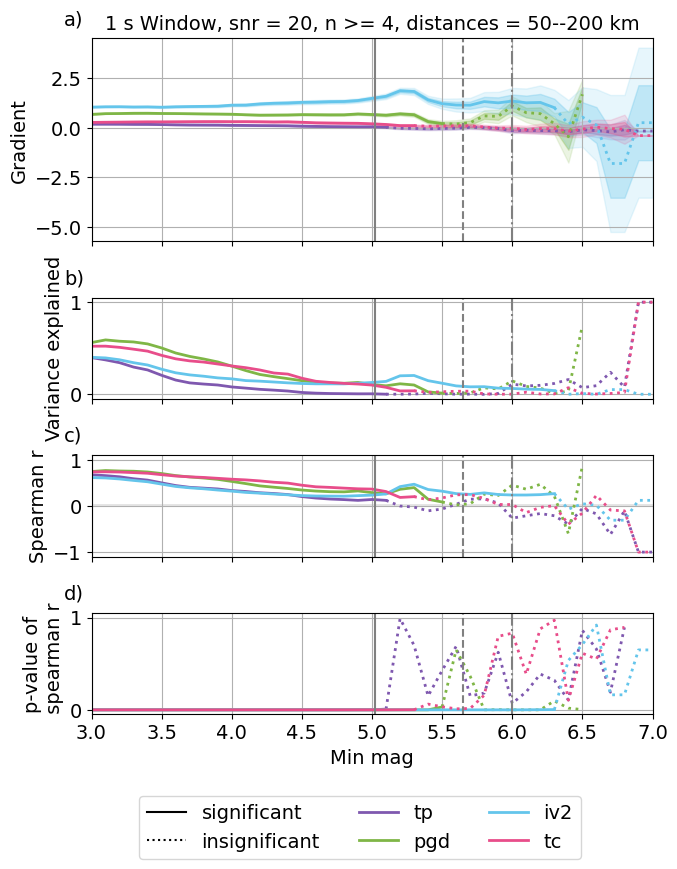

tp 0.663512370496701
pgd 0.7444568501346878
tc 0.7063277446245635
iv2 0.6303234437088089
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


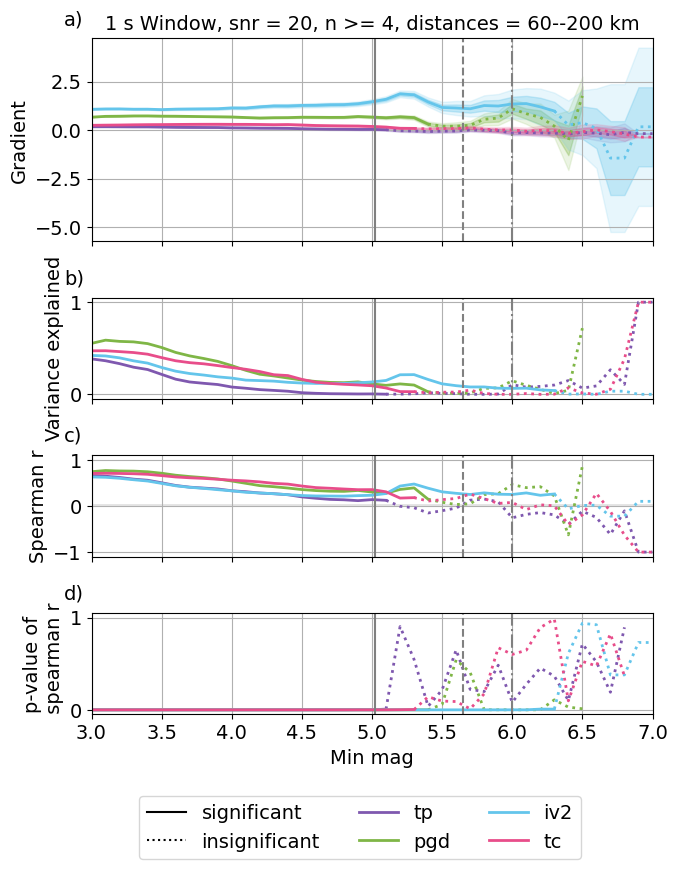

tp 0.6549845313486344
pgd 0.7398837910077536
tc 0.6625214474464238
iv2 0.6495653490929513
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


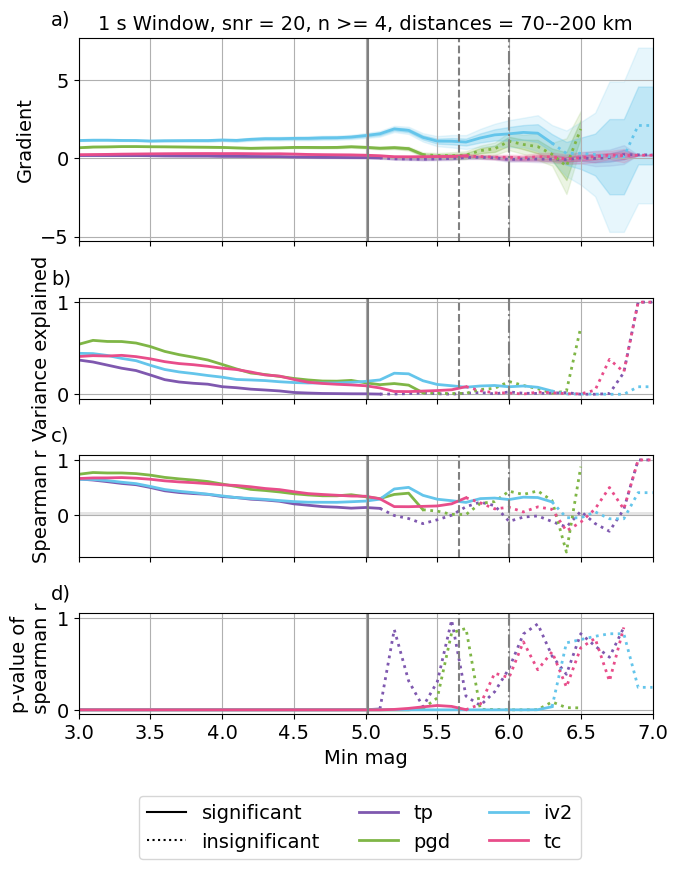

tp 0.6066285838730187
pgd 0.7297656059838965
tc 0.5927369154929844
iv2 0.6775356765369495
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


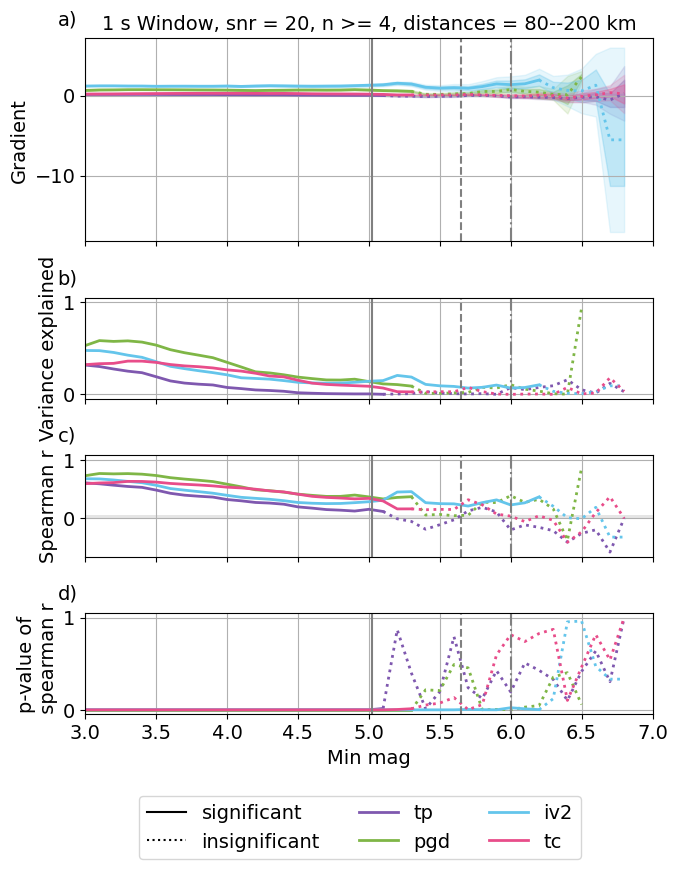

tp 0.5776427164269434
pgd 0.7062106705990565
tc 0.5471453291073228
iv2 0.6780055368515575
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


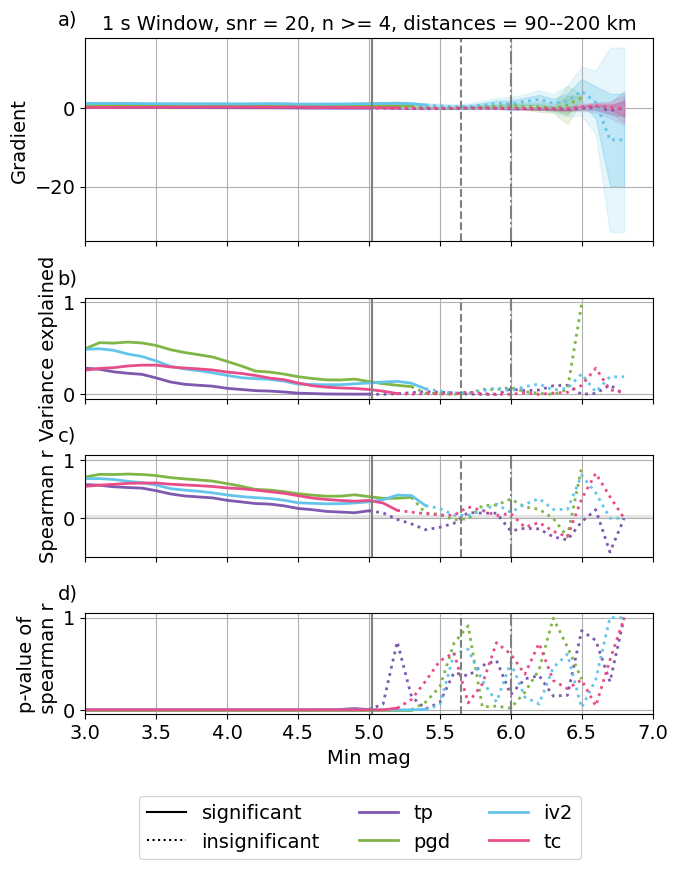

tp 0.7517786693061732
pgd 0.7728070299745304
tc 0.8279185361015103
iv2 0.6562355809606434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


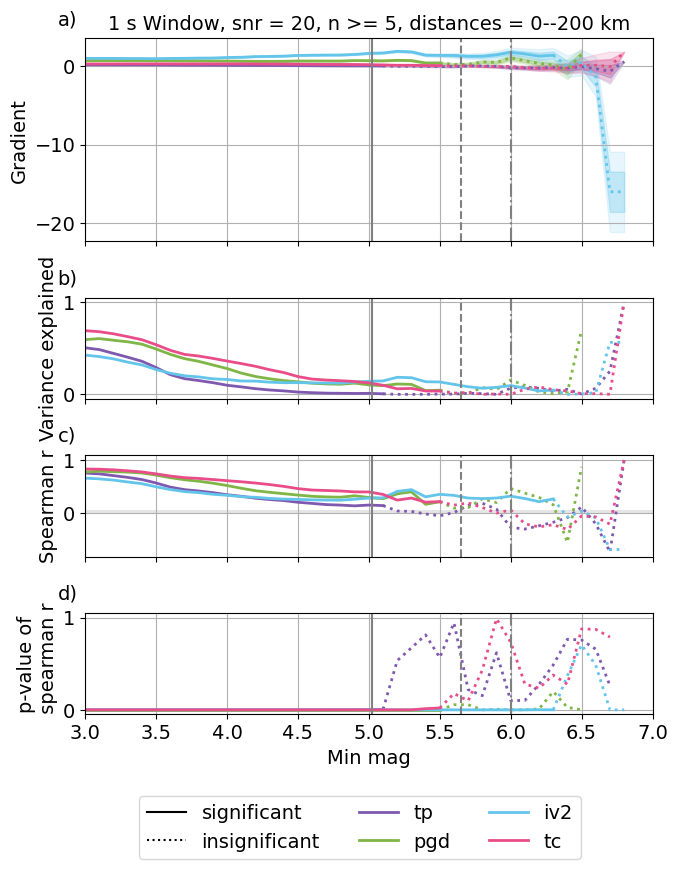

tp 0.741793037277005
pgd 0.771657663901403
tc 0.8199162060044551
iv2 0.6551591994364224
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


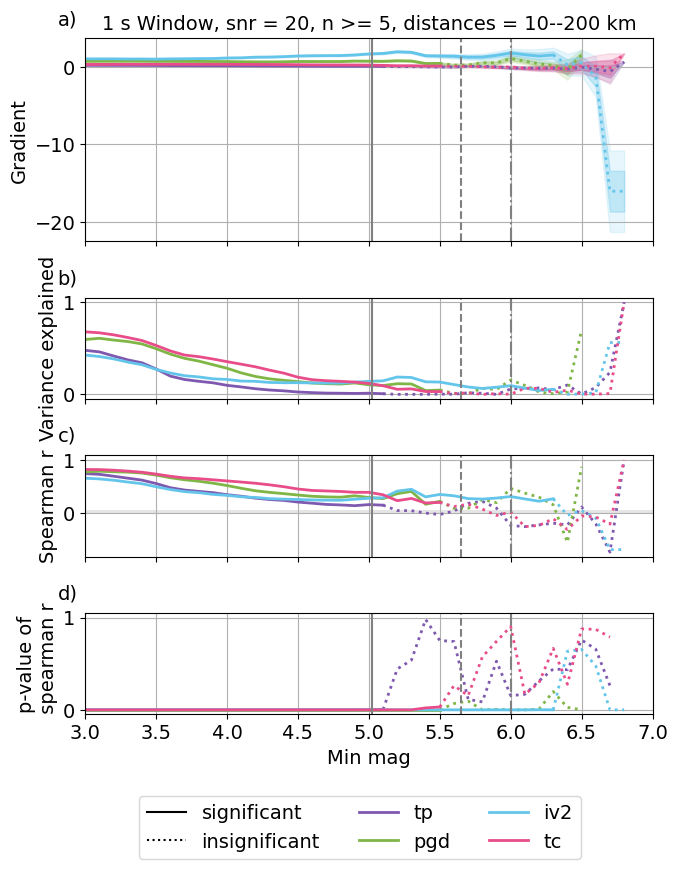

tp 0.7307693024552744
pgd 0.7645563351504112
tc 0.81166532890431
iv2 0.6456712973128996
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


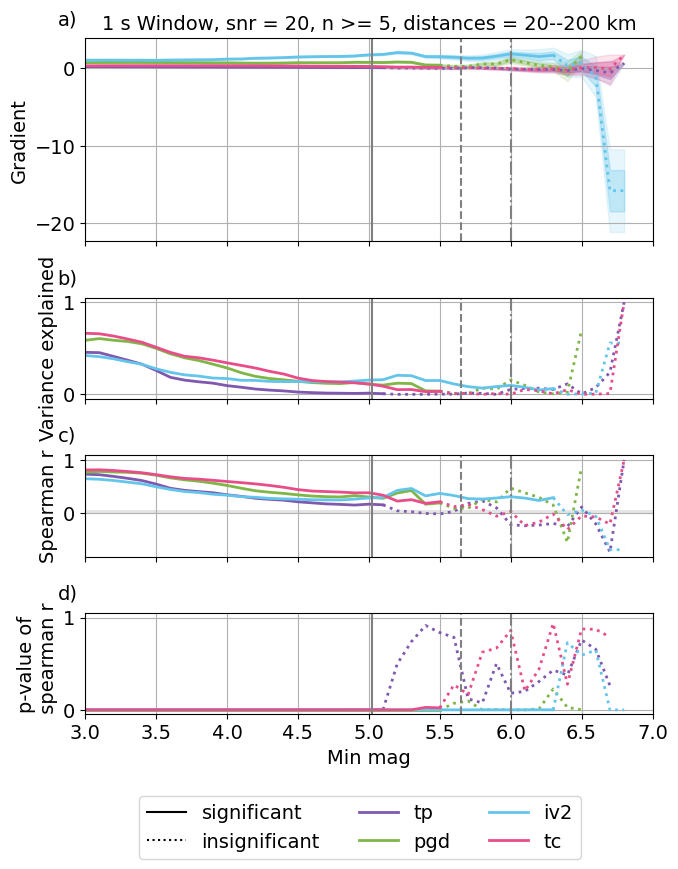

tp 0.7247776849849723
pgd 0.7565304736076754
tc 0.7928336500558673
iv2 0.6259488309665685
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


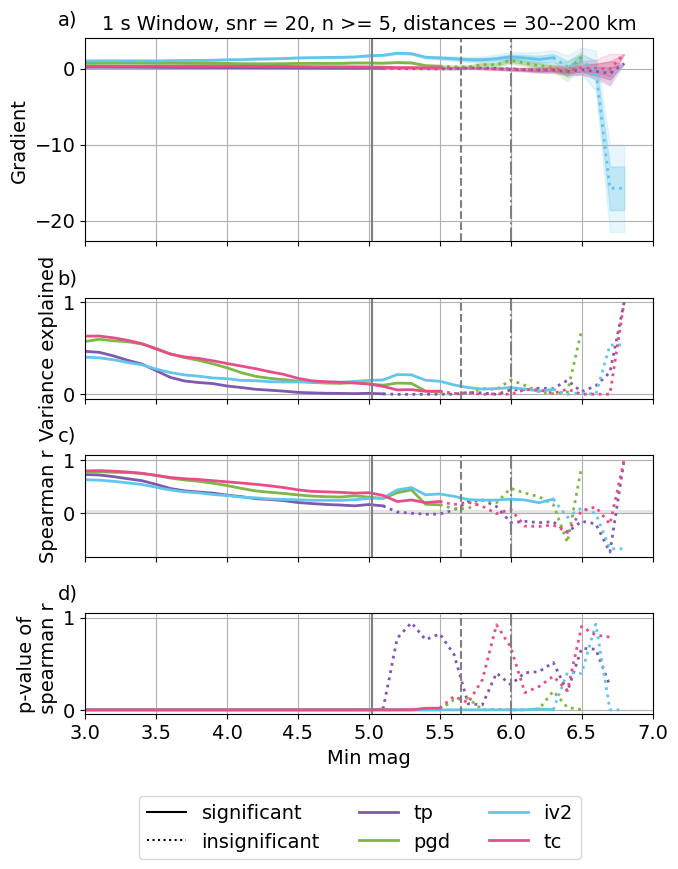

tp 0.7153929751981176
pgd 0.7491840578719999
tc 0.7755830392253963
iv2 0.6126246157315288
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


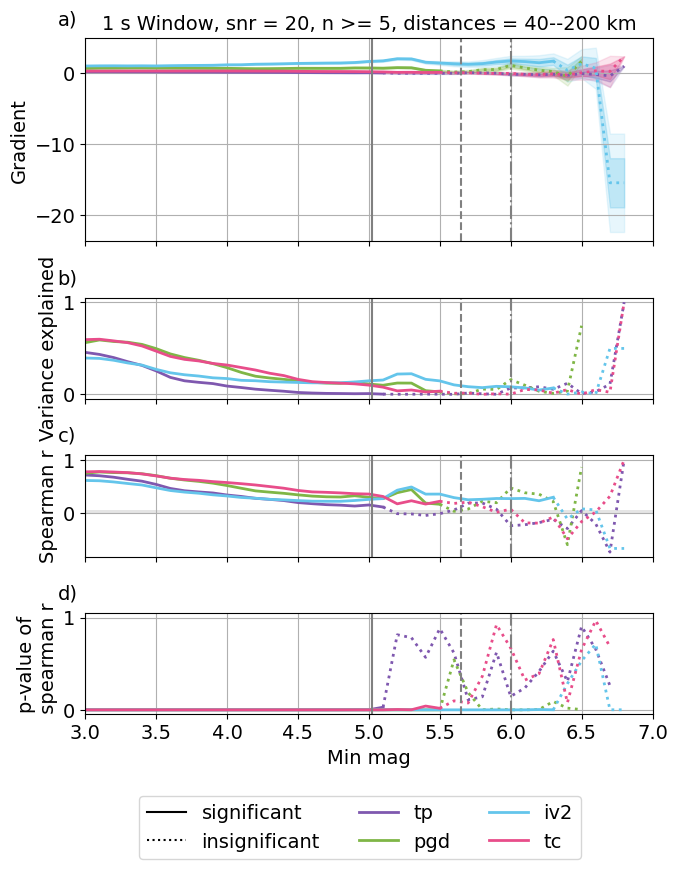

tp 0.7023380225692187
pgd 0.7482110902645643
tc 0.7561727865583381
iv2 0.6204470101363545
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


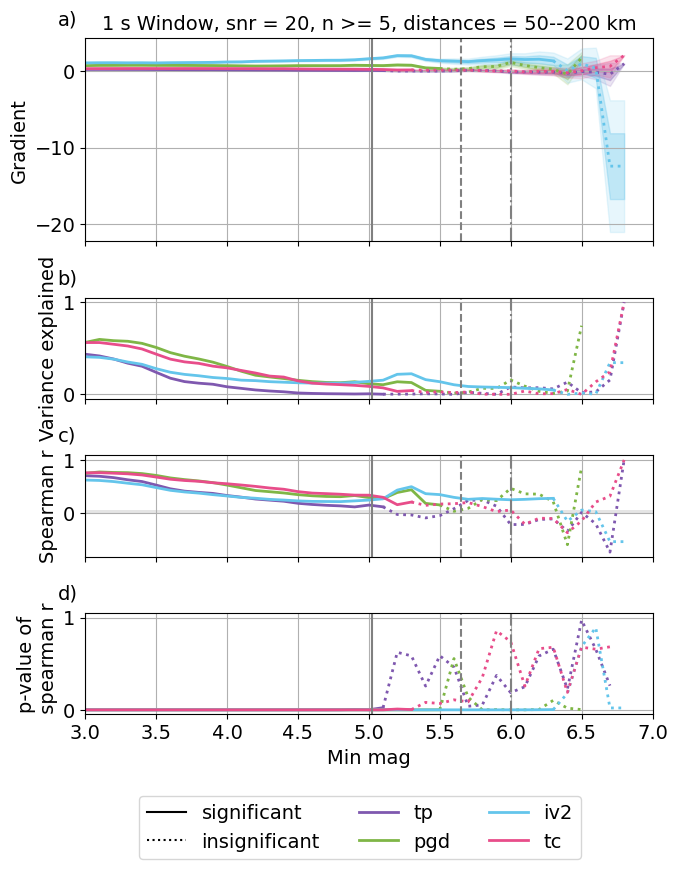

tp 0.685322628551746
pgd 0.7438085088771254
tc 0.7233070173748186
iv2 0.6339461248982128
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


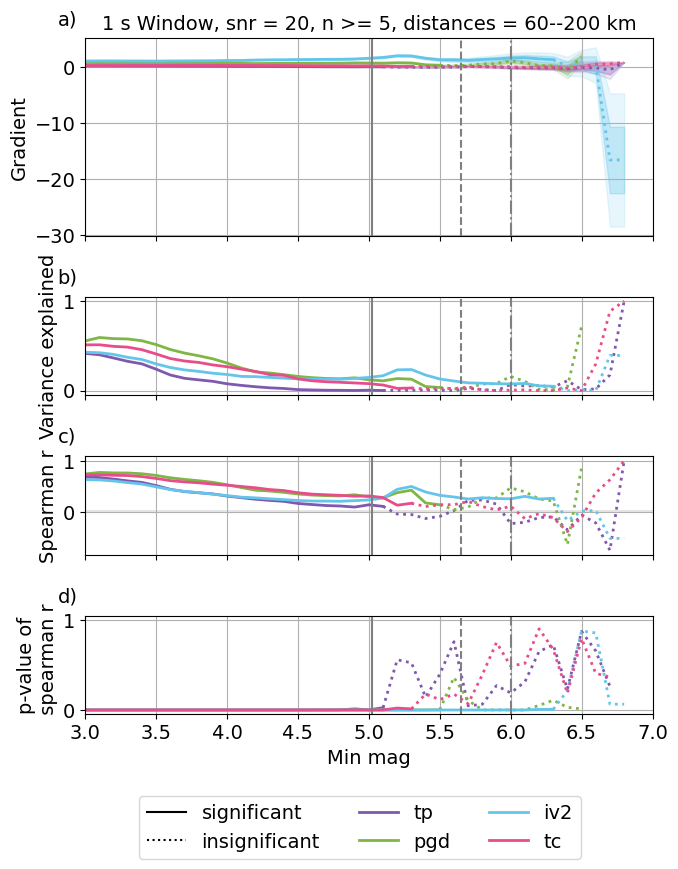

tp 0.6744860177982112
pgd 0.7370630005251213
tc 0.6786085100825672
iv2 0.6535223020277634
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


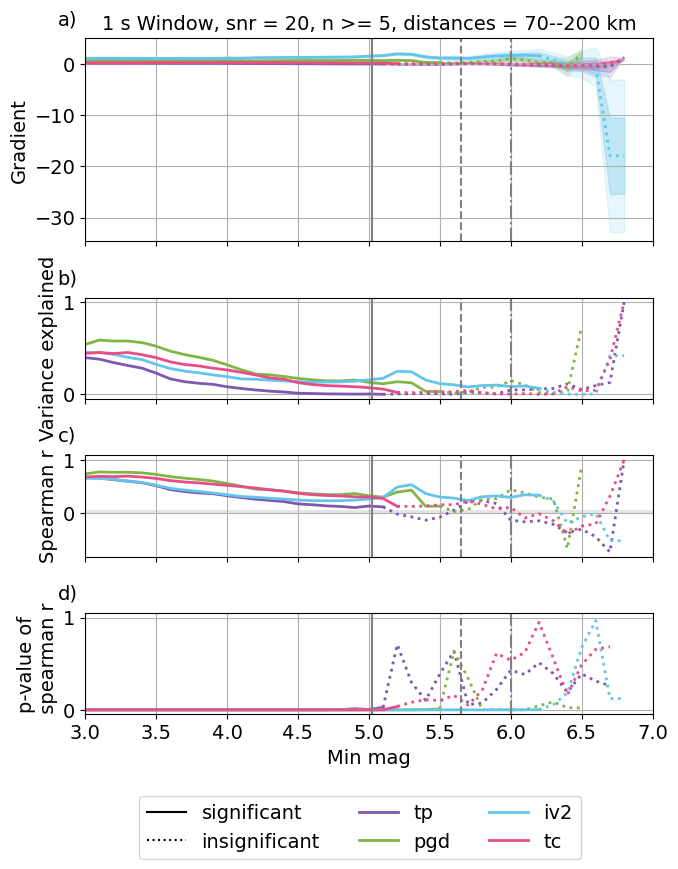

tp 0.6208089797009797
pgd 0.7270001333407607
tc 0.601129345399388
iv2 0.6882893909838815
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


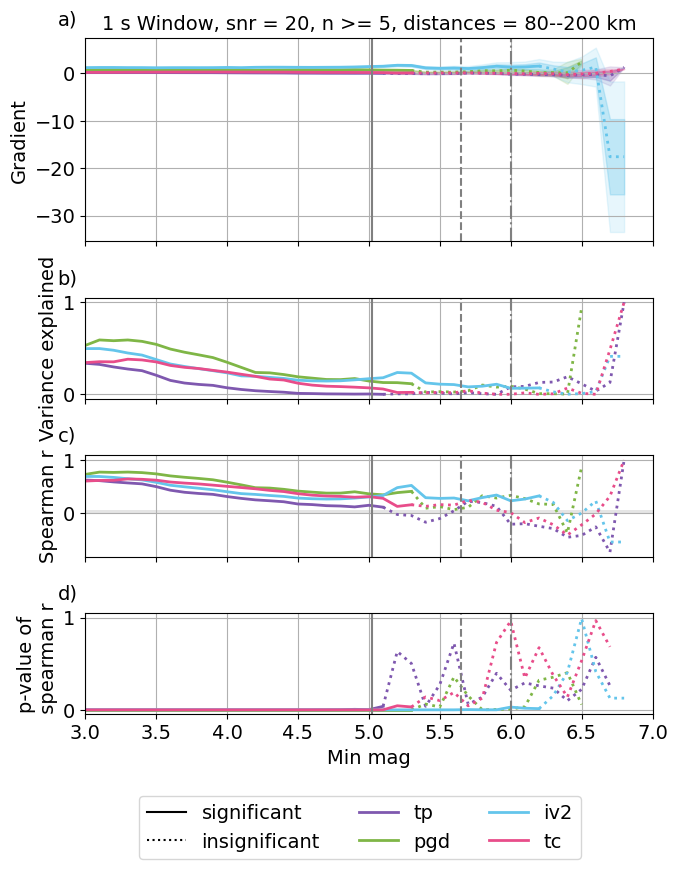

tp 0.5985013740043781
pgd 0.7030207682473173
tc 0.5528914771264516
iv2 0.6941782806458112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


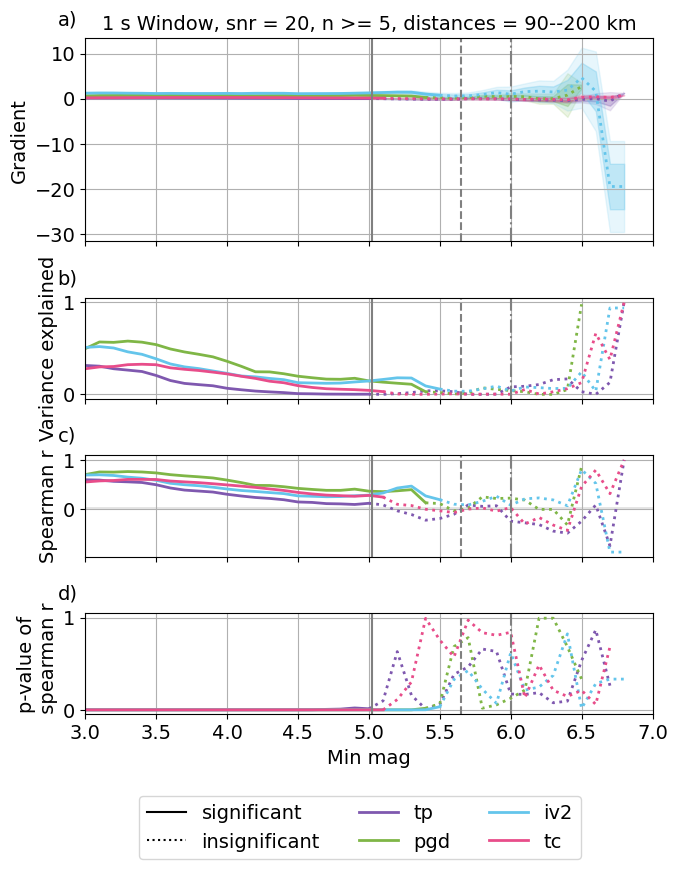

tp 0.767979935221993
pgd 0.7680277505501774
tc 0.8344050985588572
iv2 0.6505284739321837
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


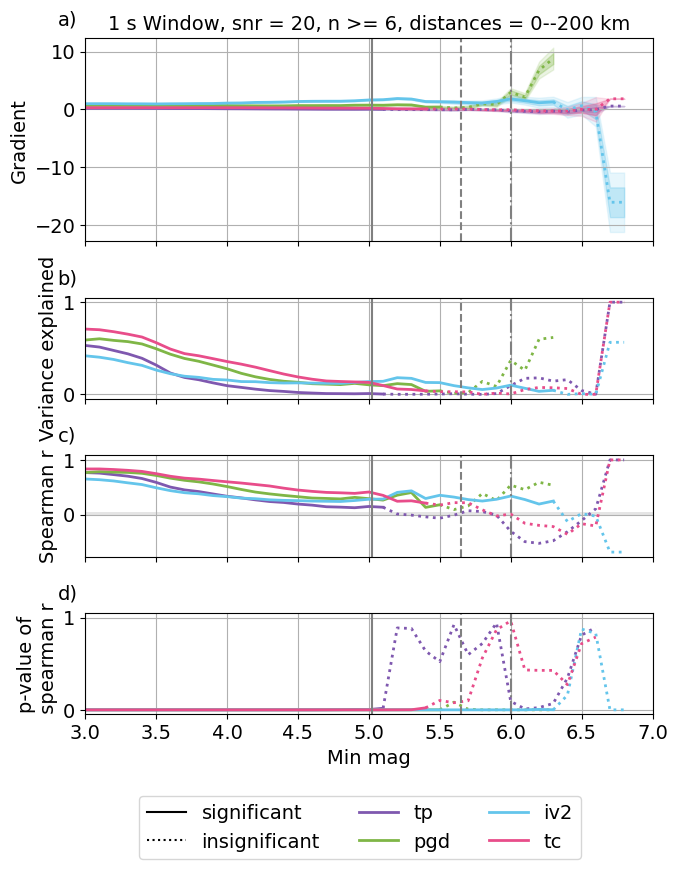

tp 0.7579659955335492
pgd 0.7670103058362239
tc 0.8269662470920898
iv2 0.6498188098144573
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


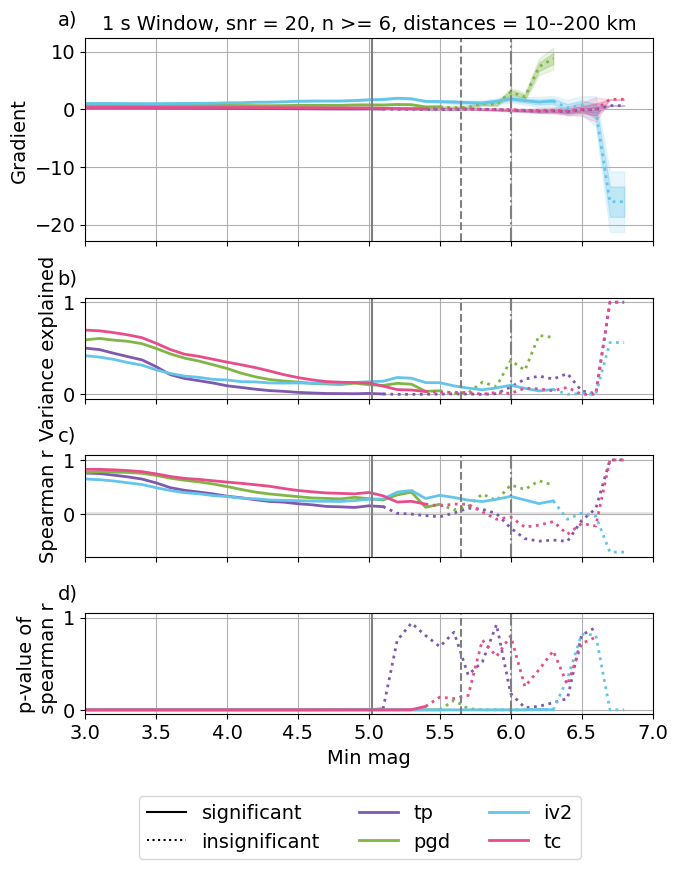

tp 0.7459476544317044
pgd 0.7597658598295837
tc 0.8218230565630477
iv2 0.6408684120959712
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


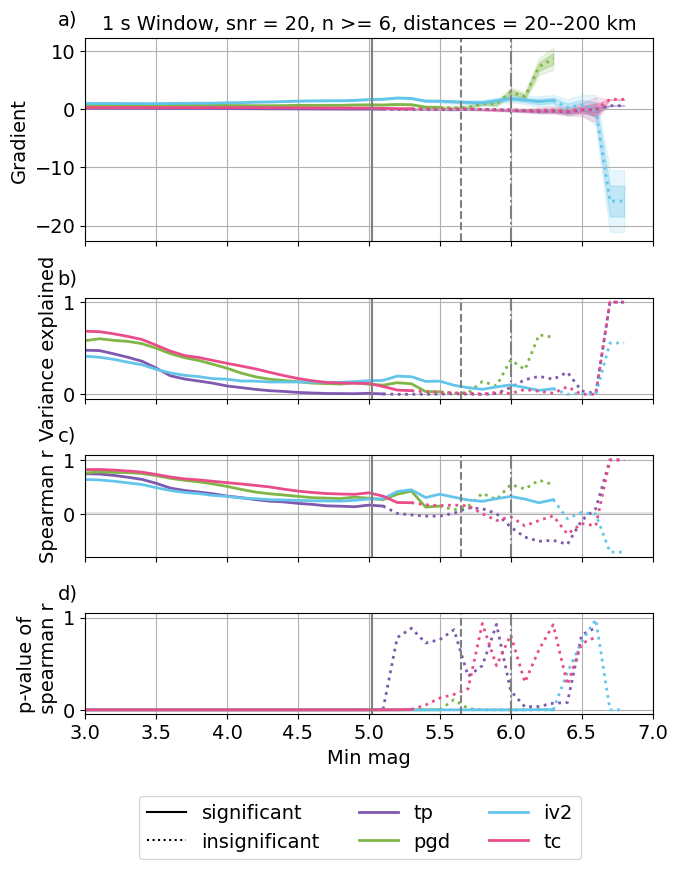

tp 0.7481787965612986
pgd 0.752627373825328
tc 0.8121704511006578
iv2 0.6218769999639538
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


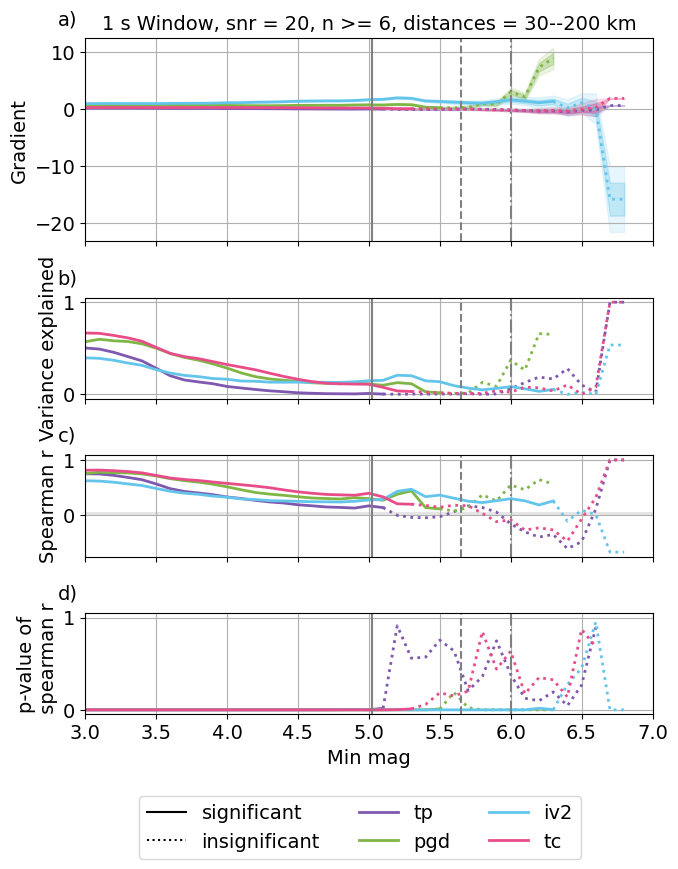

tp 0.7400973370692034
pgd 0.7463137424470541
tc 0.7966491298941631
iv2 0.6094694660111573
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


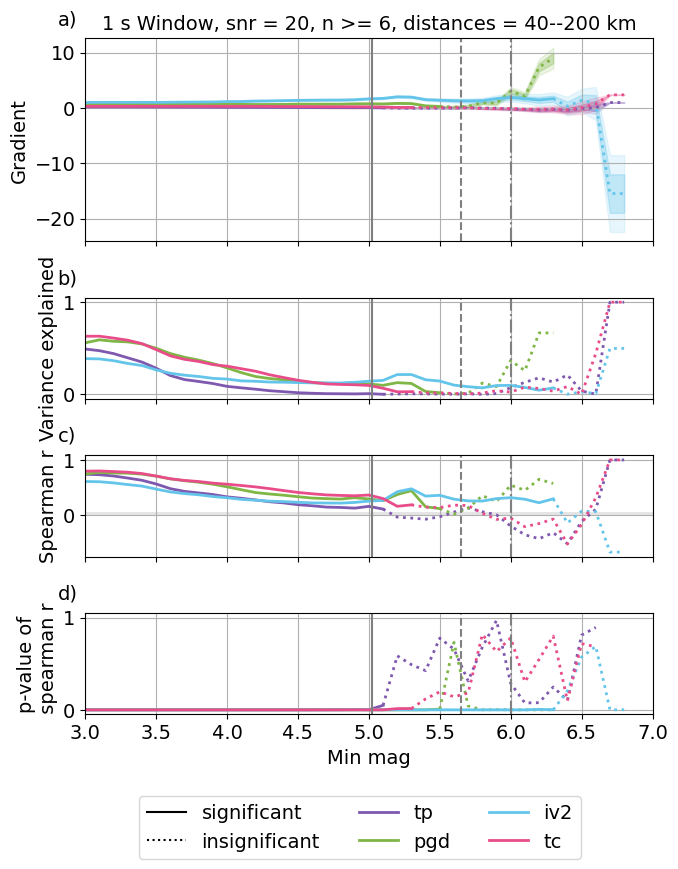

tp 0.728426875974986
pgd 0.7450897319776971
tc 0.7745884942564738
iv2 0.6165726140376722
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


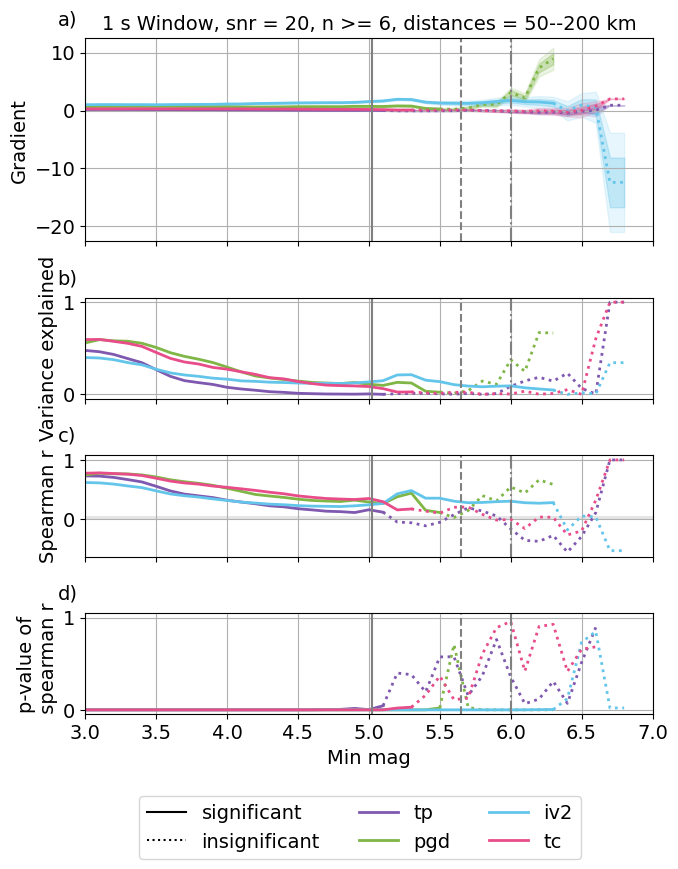

tp 0.7101279554464083
pgd 0.7403679487428785
tc 0.7405601311087888
iv2 0.6311619069152328
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


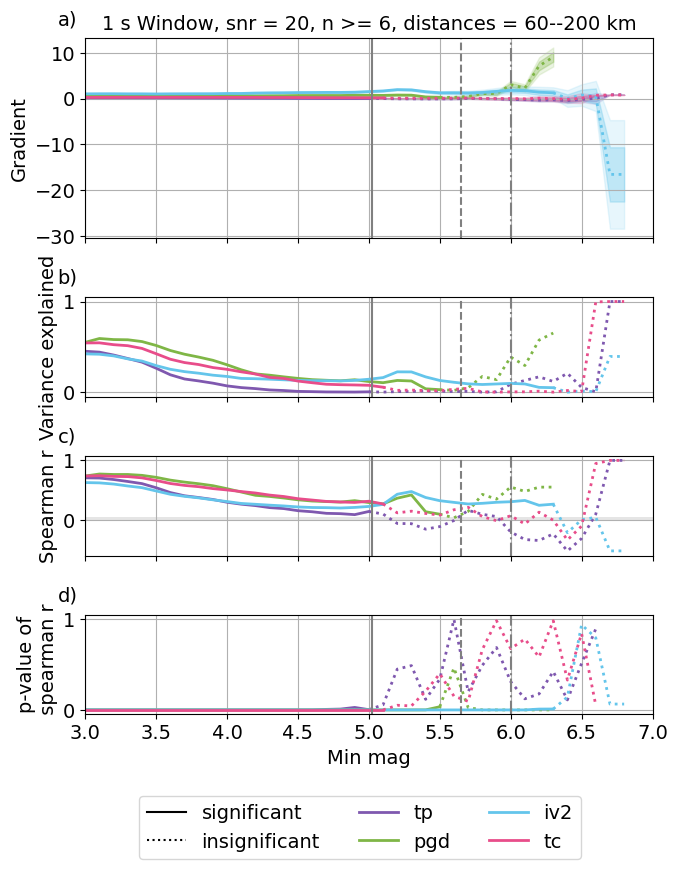

tp 0.701948515283156
pgd 0.7324248411805098
tc 0.6946676408653145
iv2 0.6487991375203737
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


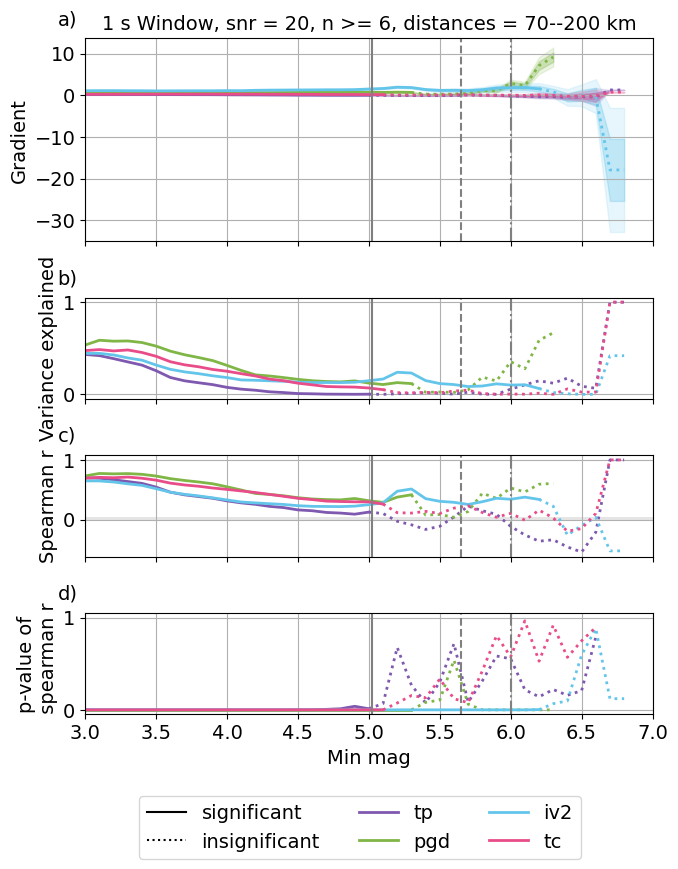

tp 0.6481847373665258
pgd 0.7216371141479317
tc 0.60822621418347
iv2 0.6877591796070966
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


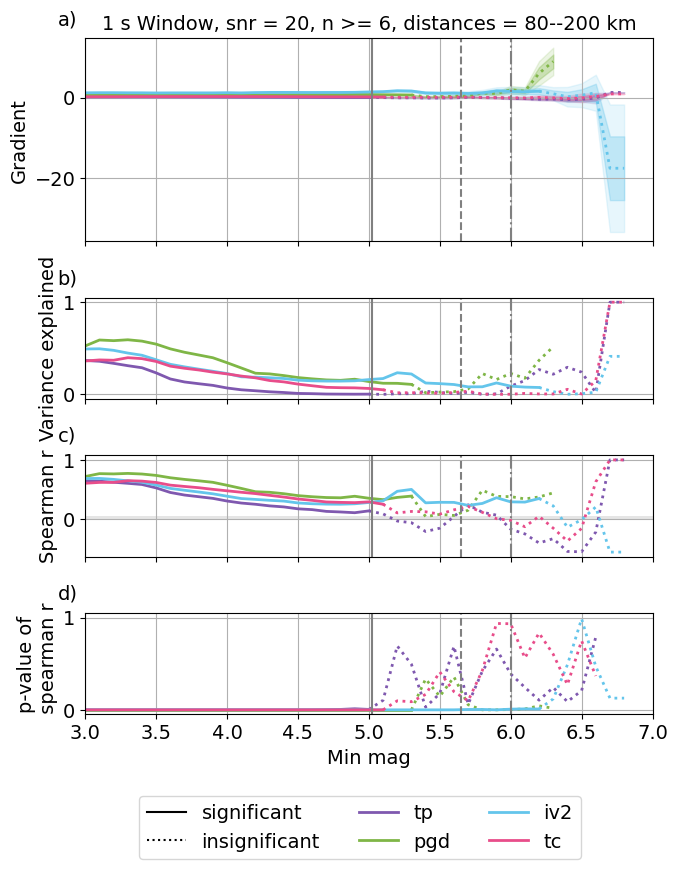

tp 0.6174192964449357
pgd 0.6977179848555174
tc 0.556862843277886
iv2 0.6994810066230356
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


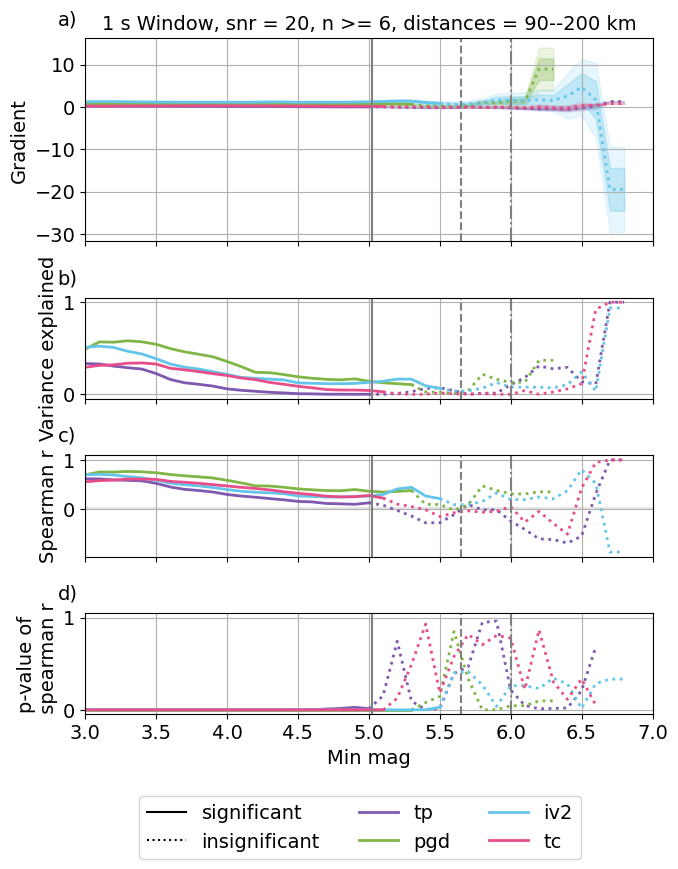

eq_object_4s_bandpass_01_19_snr_20_blank_0_new_snr20
tp 0.5603624374903112
pgd 0.8376397490811472
tc 0.7462561926338726
iv2 0.7945765889796864
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


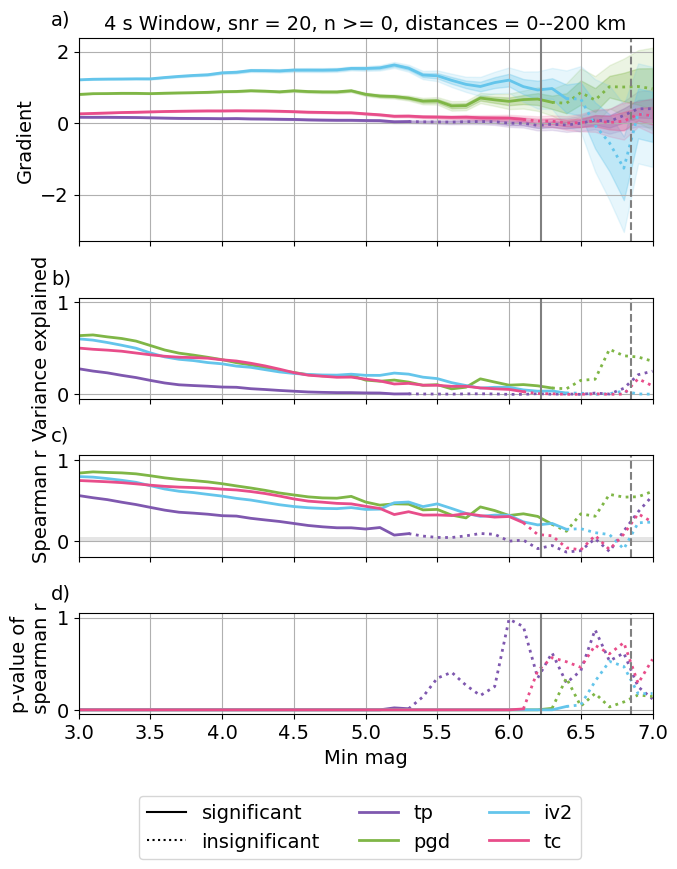

tp 0.5510160800078533
pgd 0.8375682623402342
tc 0.7387534649147377
iv2 0.7990533947638914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


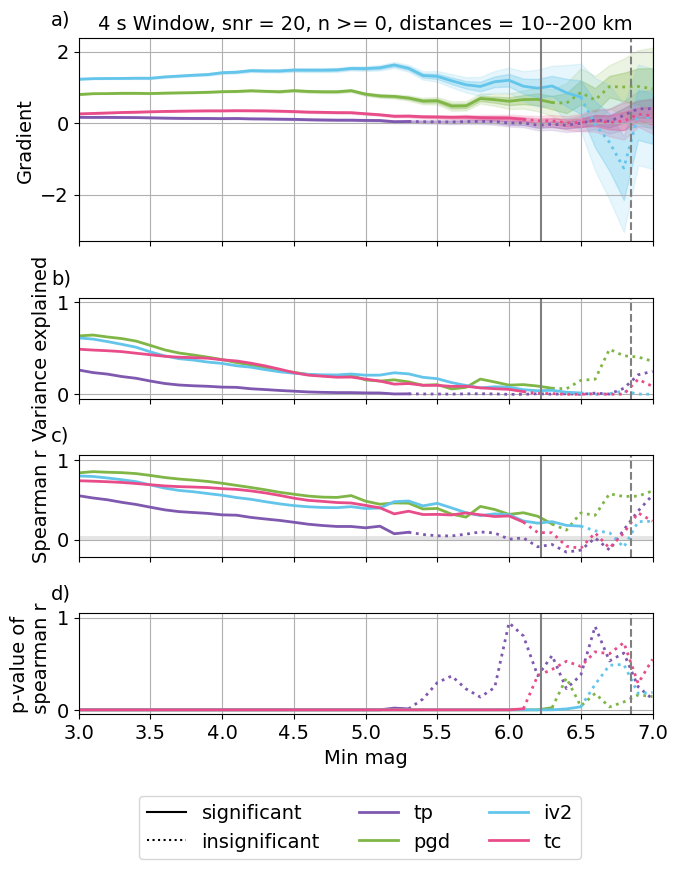

tp 0.5369873611542906
pgd 0.8372499699573678
tc 0.7303578972891807
iv2 0.8053370969216478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


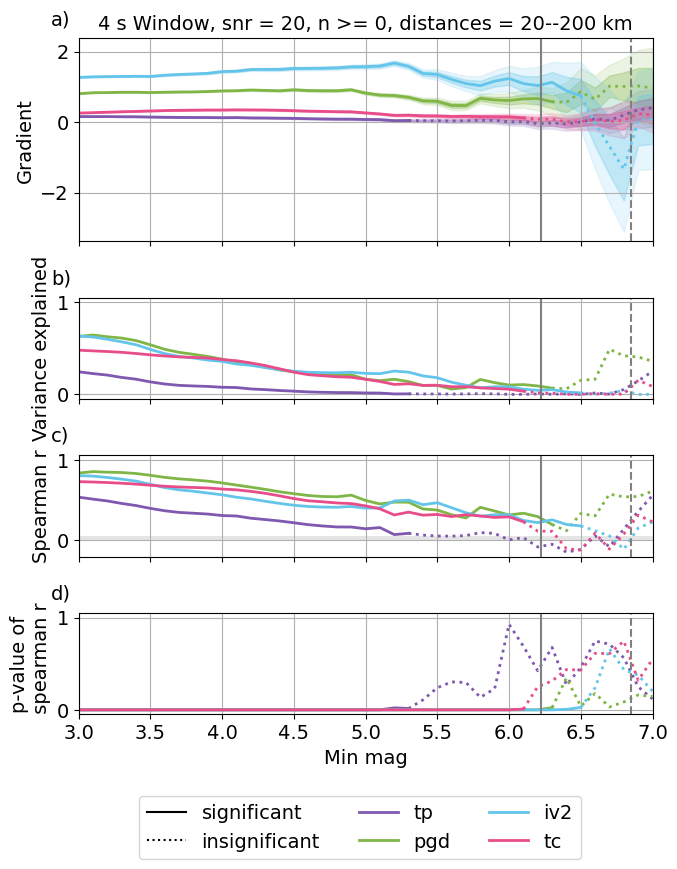

tp 0.5336092972004859
pgd 0.8331719118673695
tc 0.7277258122975332
iv2 0.7974663809383677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


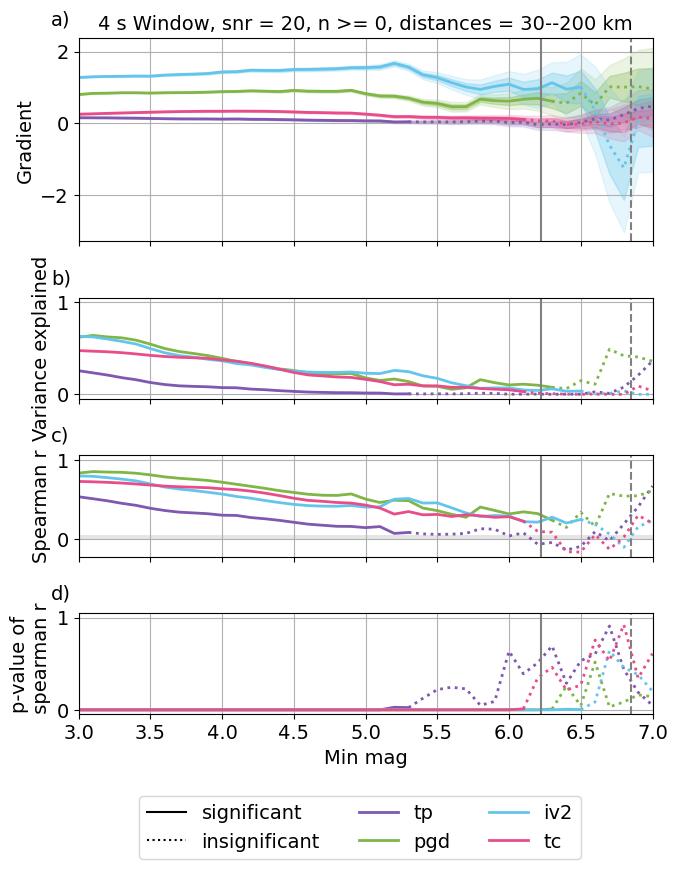

tp 0.5226679363560149
pgd 0.8245494395291202
tc 0.7238698408802374
iv2 0.7814160948074602
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


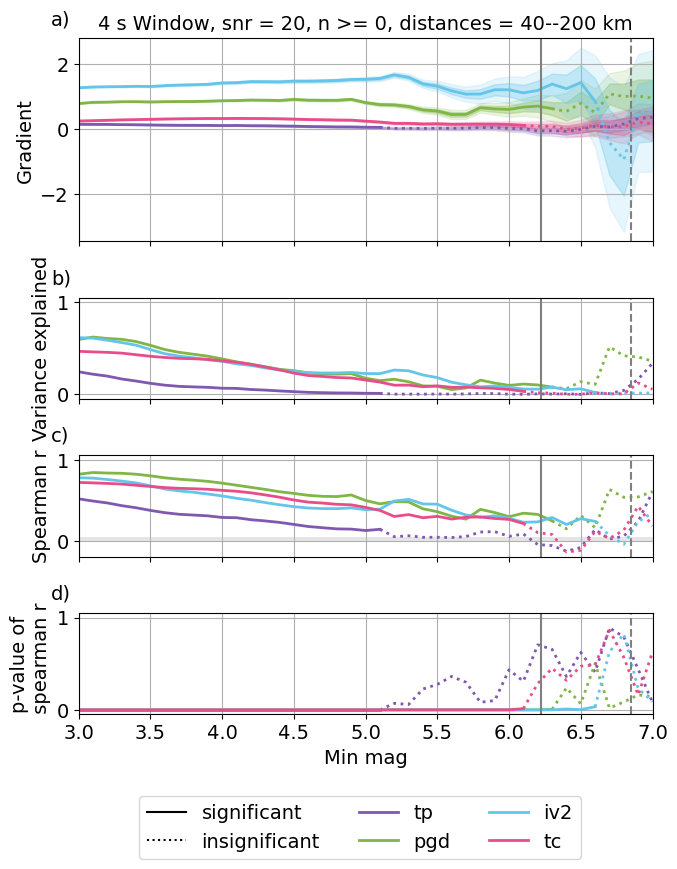

tp 0.513476490668751
pgd 0.8193565159771364
tc 0.7165261245177065
iv2 0.778420809658278
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


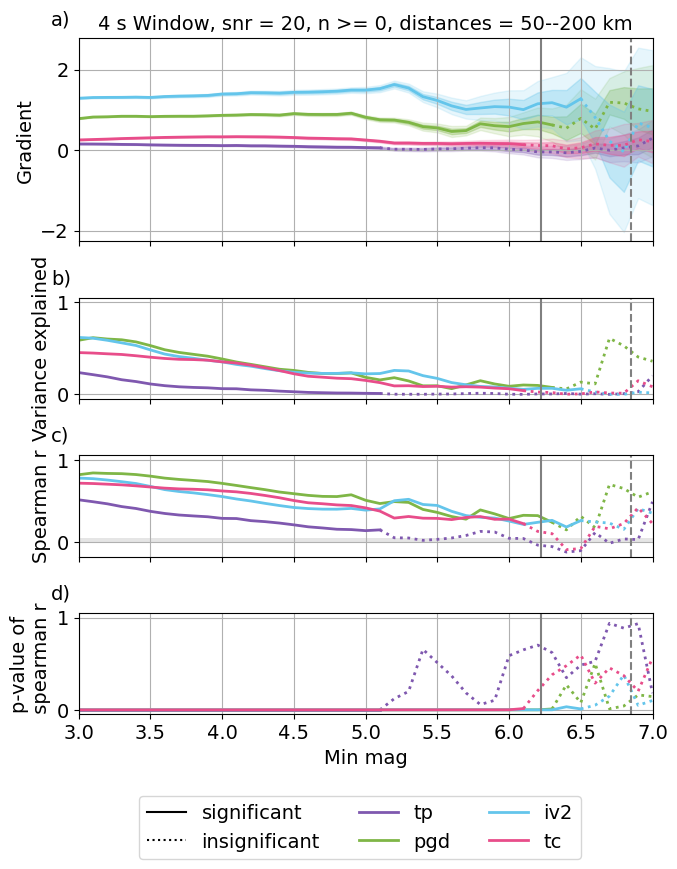

tp 0.4984389023938023
pgd 0.8127610097215017
tc 0.7039468585770712
iv2 0.7782792936617605
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


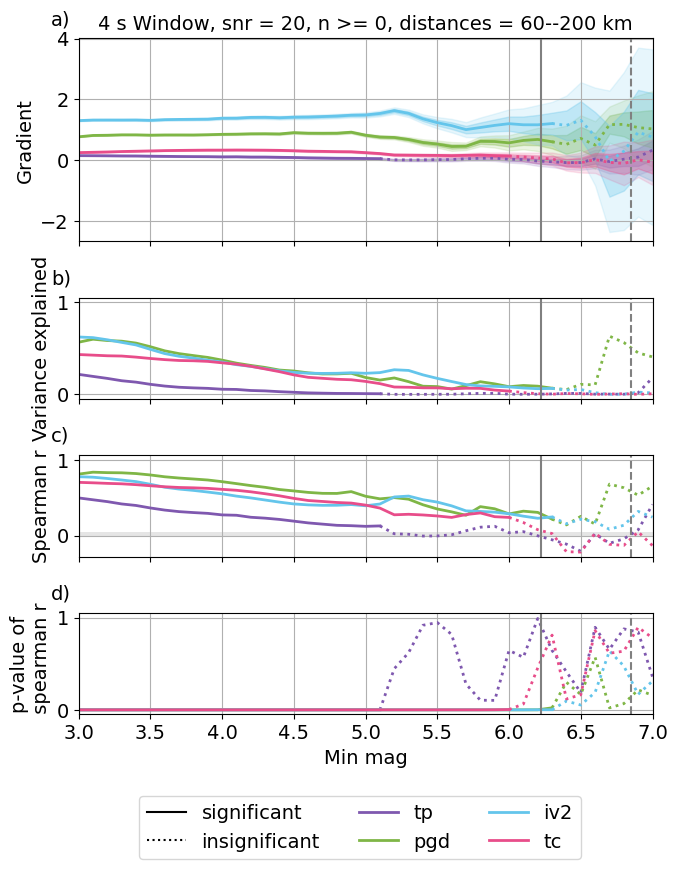

tp 0.4952083294969888
pgd 0.8023793031591886
tc 0.6875434402563068
iv2 0.778134848732668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


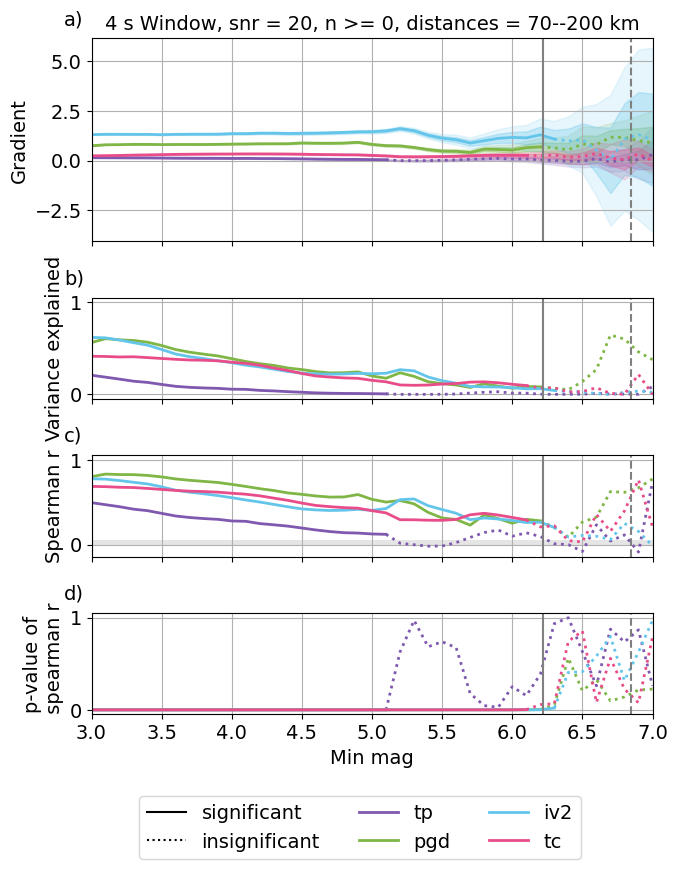

tp 0.47183489443744725
pgd 0.7826608436574285
tc 0.6614704296982963
iv2 0.7711242412497379
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


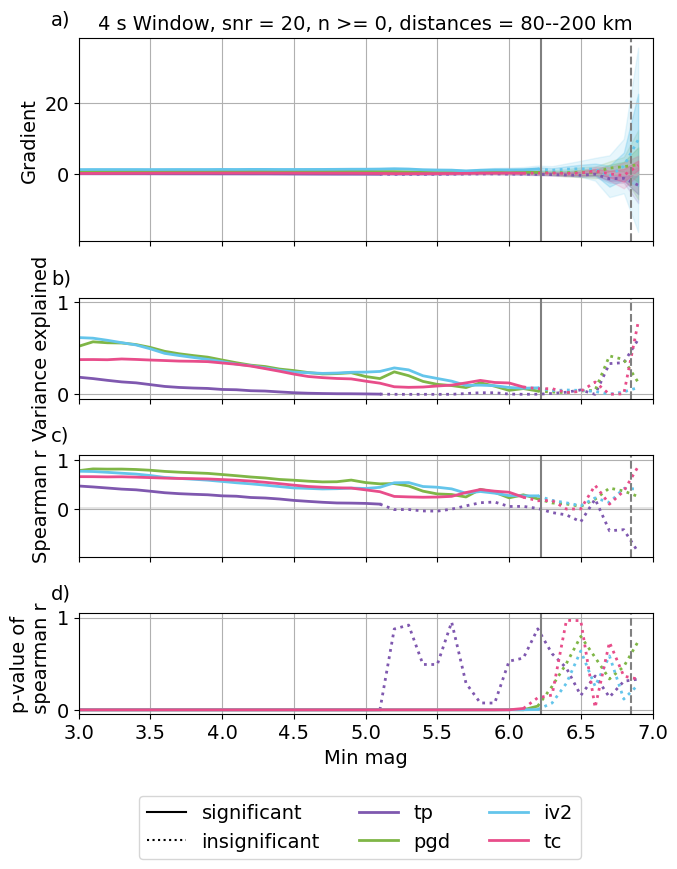

tp 0.44750054245530896
pgd 0.7547921935801893
tc 0.6421276358707624
iv2 0.757838404071535
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


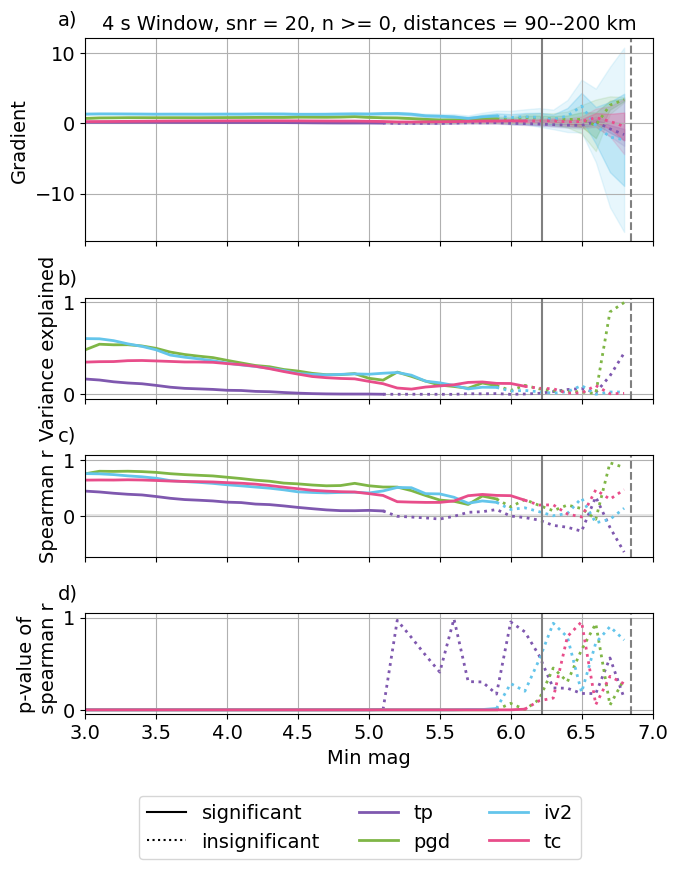

tp 0.5603624374903112
pgd 0.8376397490811472
tc 0.7462561926338726
iv2 0.7945765889796864
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


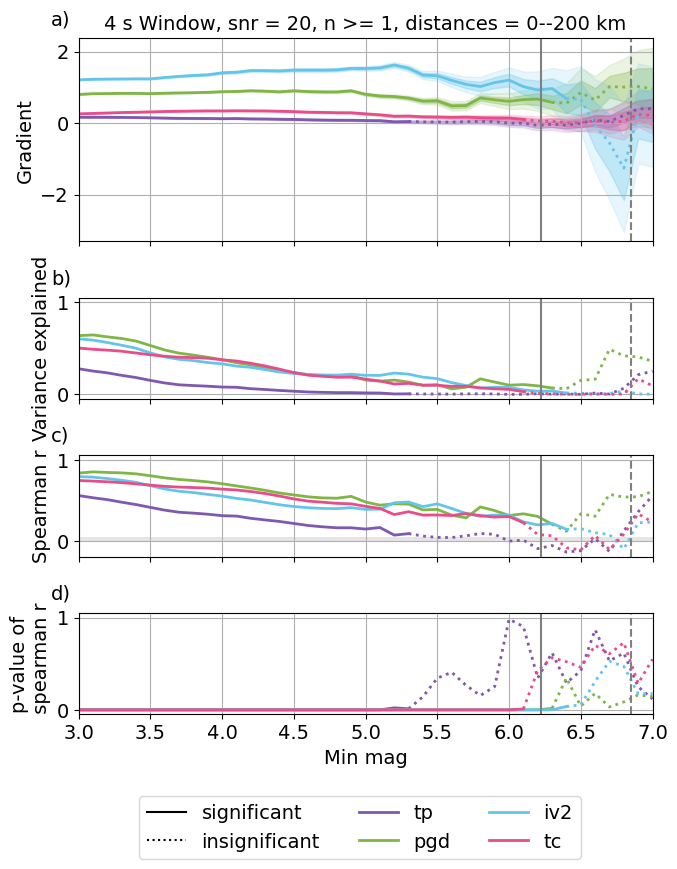

tp 0.5510160800078533
pgd 0.8375682623402342
tc 0.7387534649147377
iv2 0.7990533947638914
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


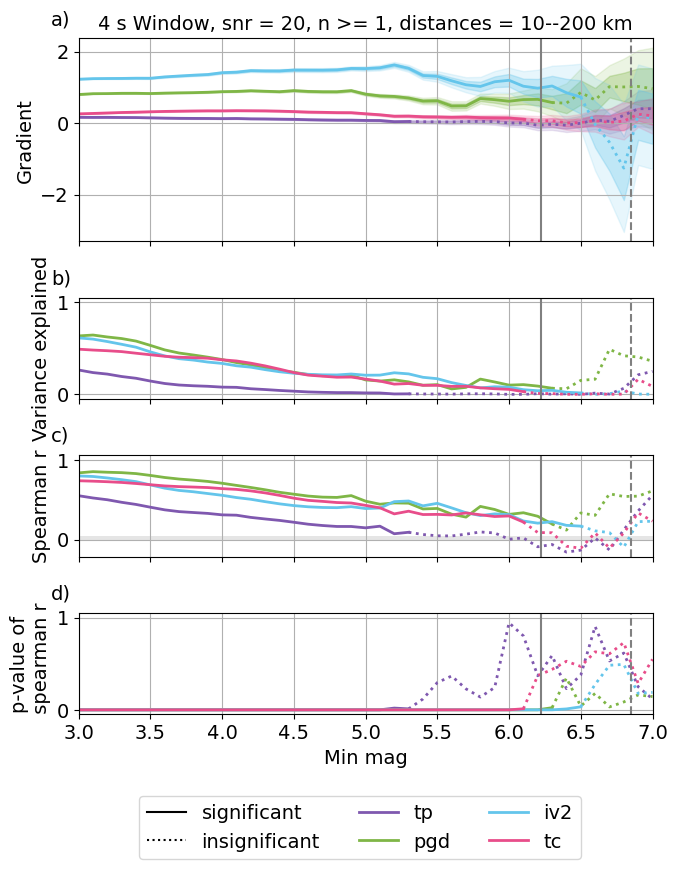

tp 0.5369873611542906
pgd 0.8372499699573678
tc 0.7303578972891807
iv2 0.8053370969216478
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


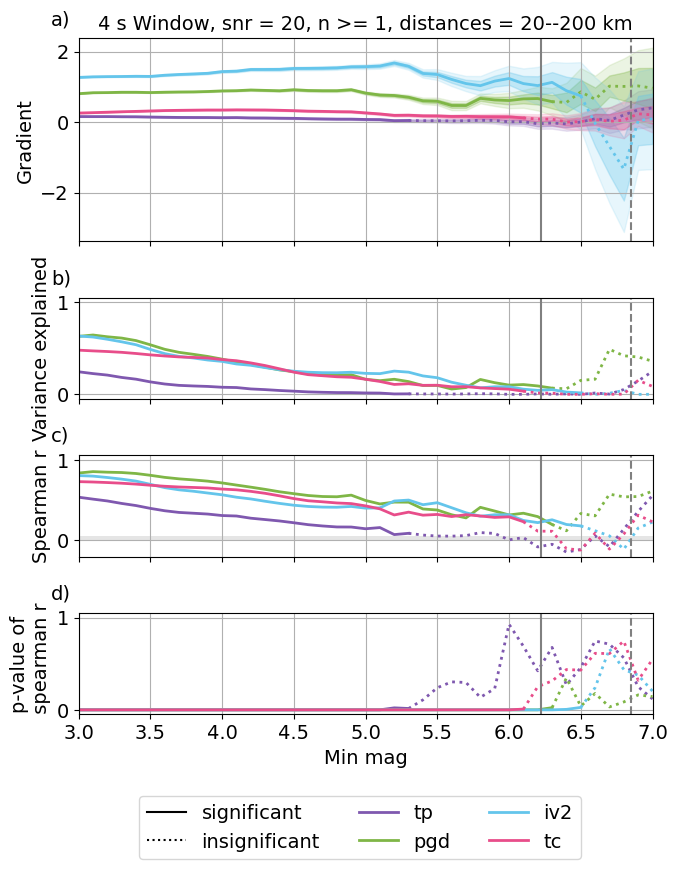

tp 0.5336092972004859
pgd 0.8331719118673695
tc 0.7277258122975332
iv2 0.7974663809383677
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


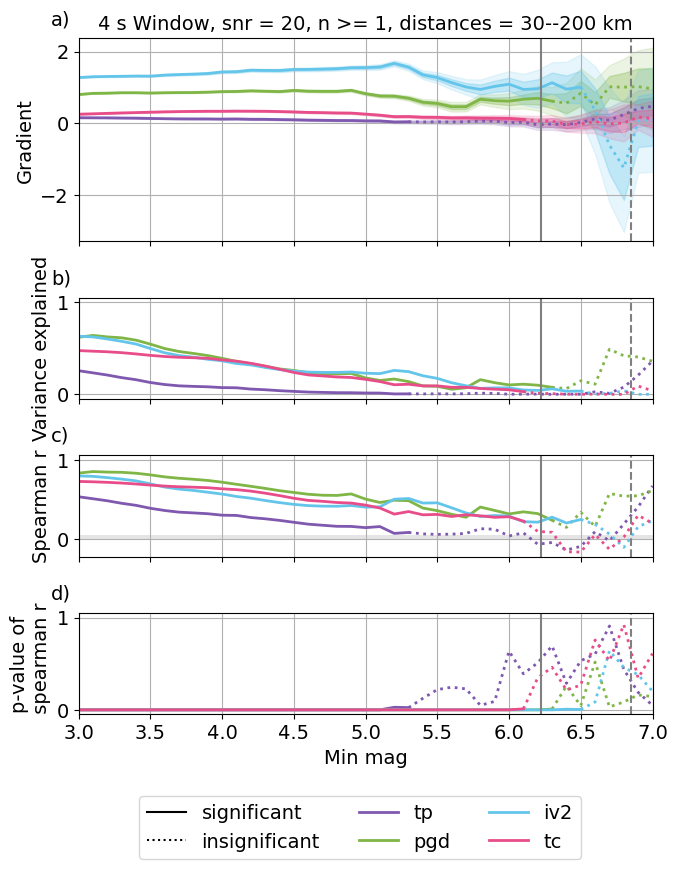

tp 0.5226679363560149
pgd 0.8245494395291202
tc 0.7238698408802374
iv2 0.7814160948074602
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


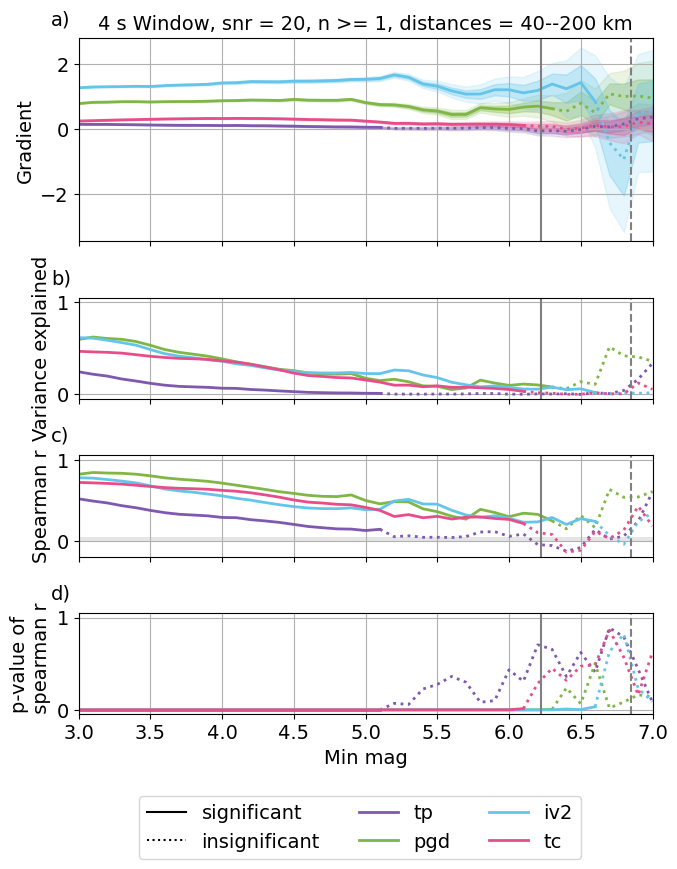

tp 0.513476490668751
pgd 0.8193565159771364
tc 0.7165261245177065
iv2 0.778420809658278
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


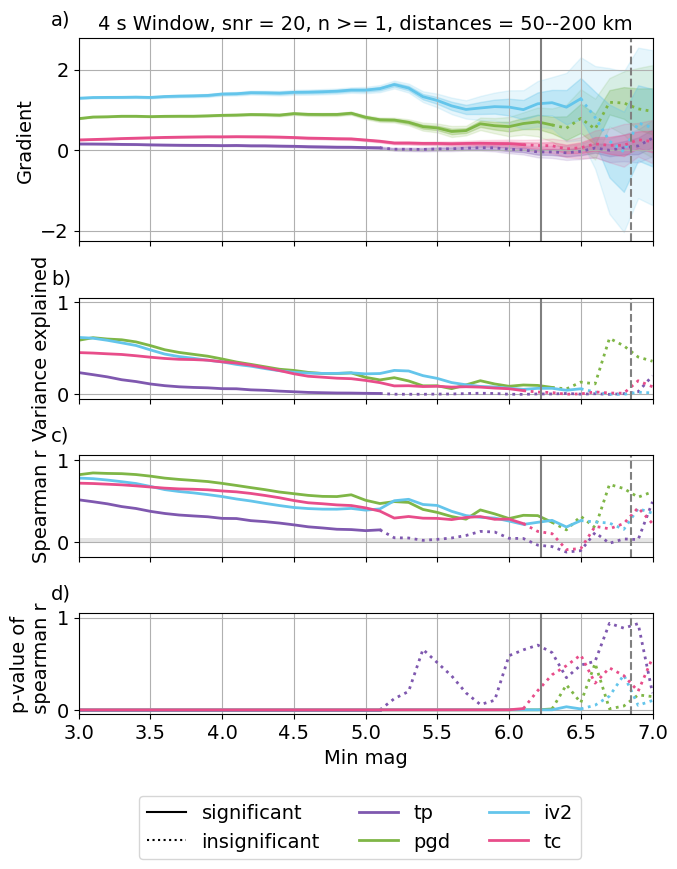

tp 0.4984389023938023
pgd 0.8127610097215017
tc 0.7039468585770712
iv2 0.7782792936617605
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


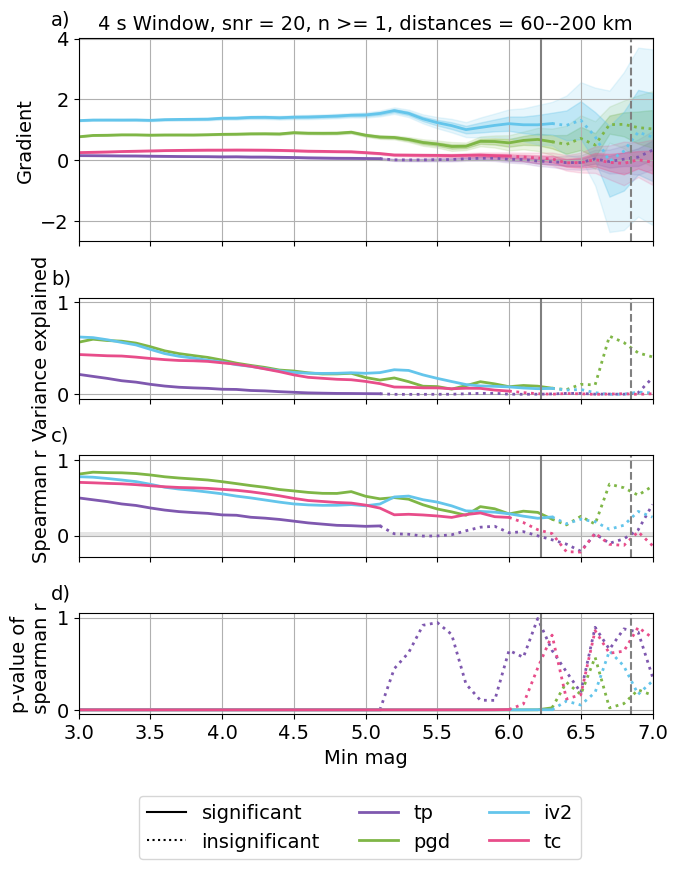

tp 0.4952083294969888
pgd 0.8023793031591886
tc 0.6875434402563068
iv2 0.778134848732668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


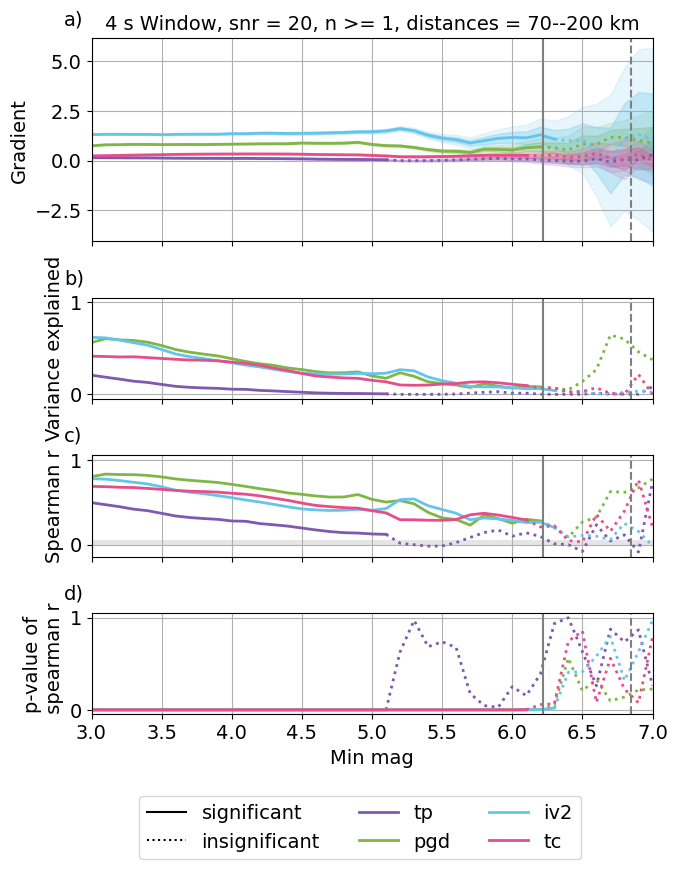

tp 0.47183489443744725
pgd 0.7826608436574285
tc 0.6614704296982963
iv2 0.7711242412497379
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


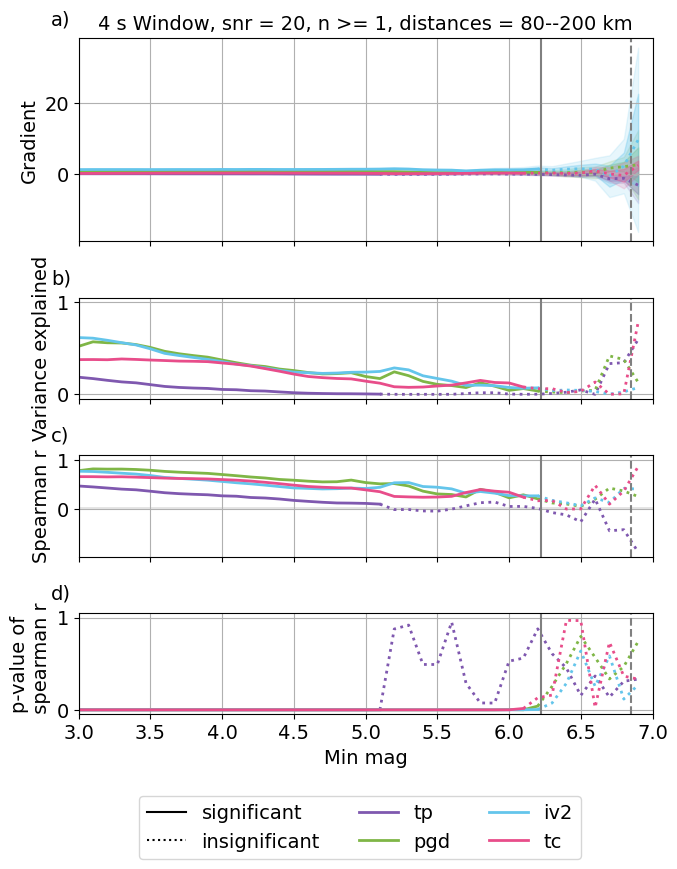

tp 0.44750054245530896
pgd 0.7547921935801893
tc 0.6421276358707624
iv2 0.757838404071535
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


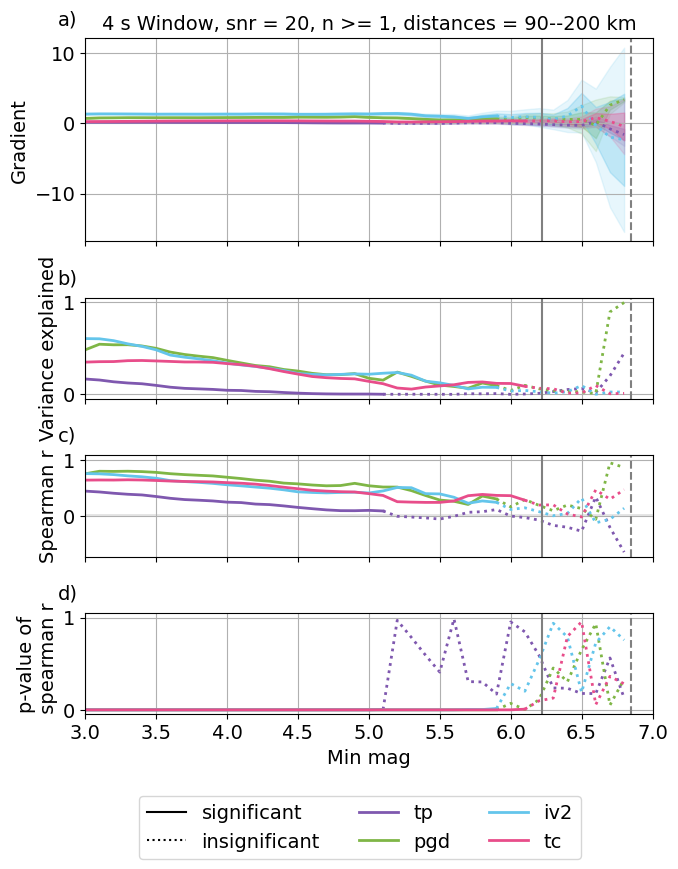

tp 0.6455551331594976
pgd 0.8393424123572862
tc 0.766411856328726
iv2 0.7995239433131685
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


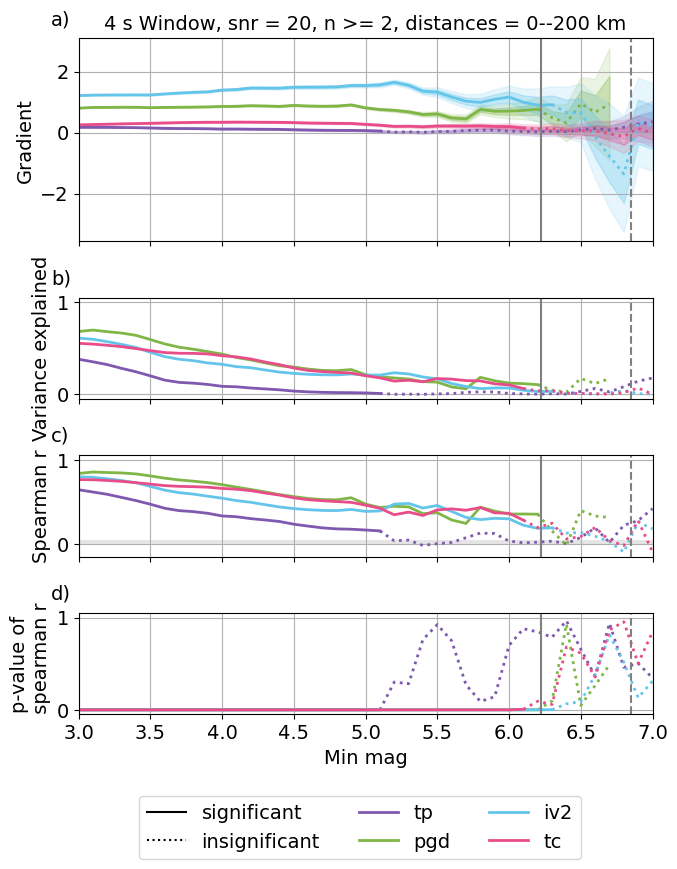

tp 0.6348821090879909
pgd 0.8395246688425204
tc 0.7553981174787758
iv2 0.8045081072329145
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


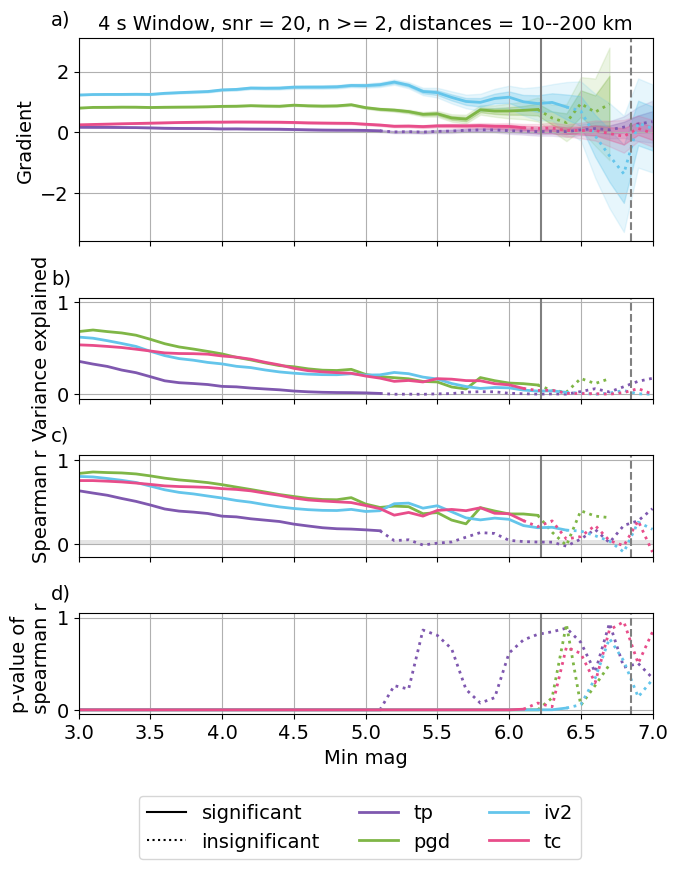

tp 0.6195963235208815
pgd 0.8393084120032746
tc 0.7440722055742887
iv2 0.8113405748456635
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


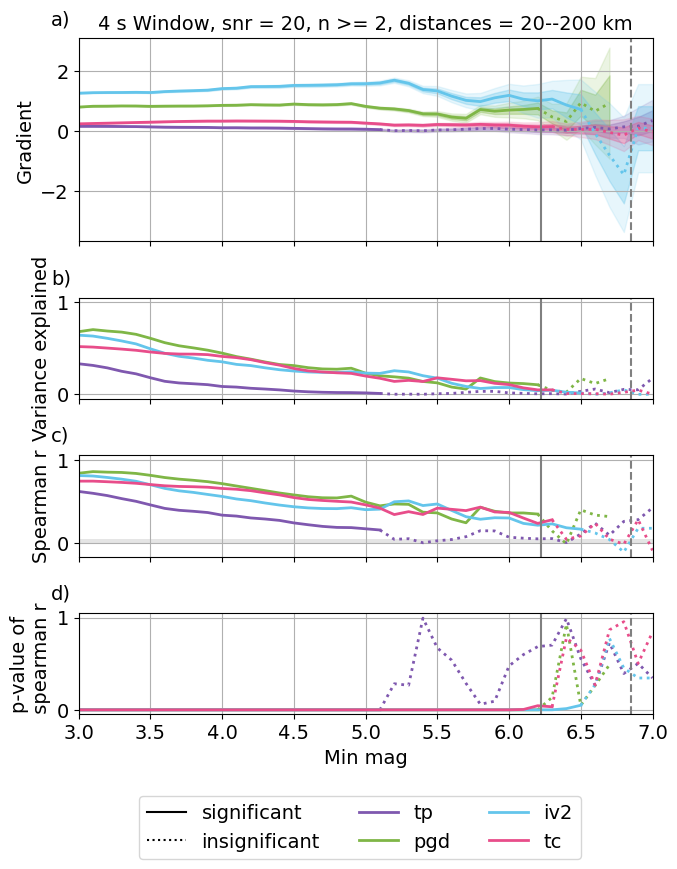

tp 0.611847775469593
pgd 0.835728228291805
tc 0.7391101705219308
iv2 0.8038589295565094
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


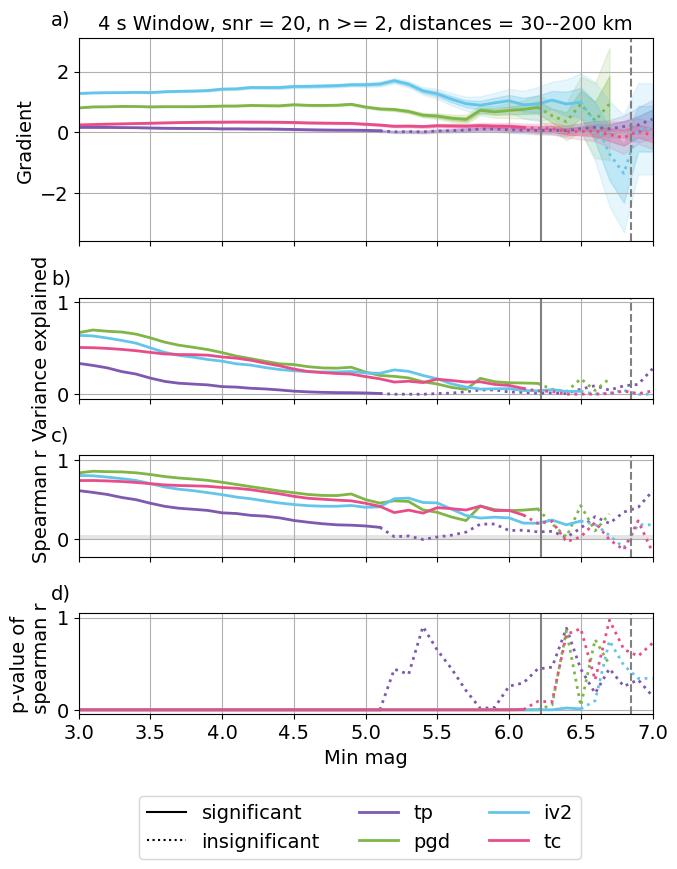

tp 0.6008876804764468
pgd 0.827624993357435
tc 0.737933065331615
iv2 0.788187763349663
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


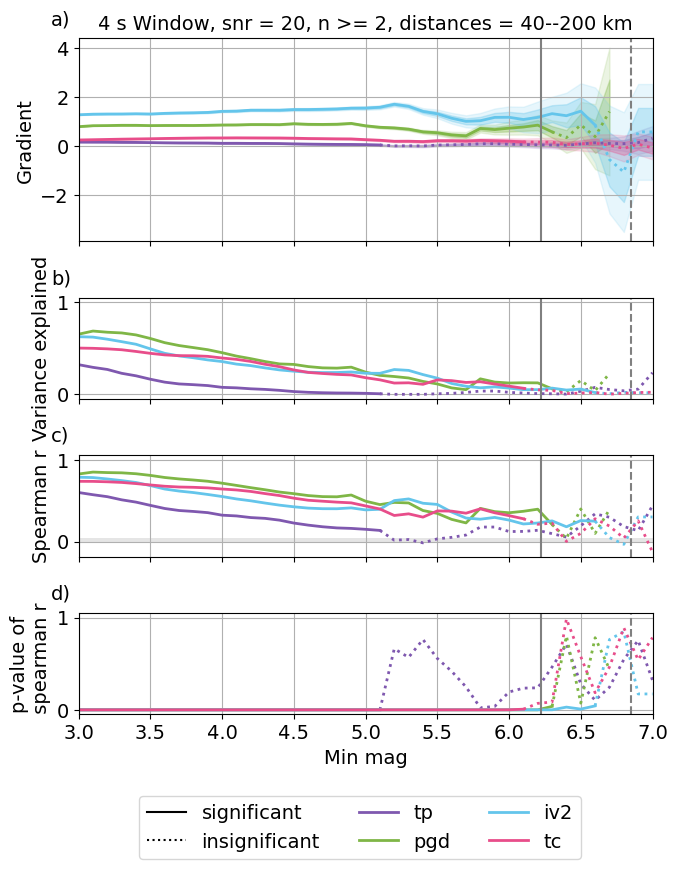

tp 0.5893324993540358
pgd 0.8227050911731247
tc 0.7292253997057788
iv2 0.7869008519666897
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


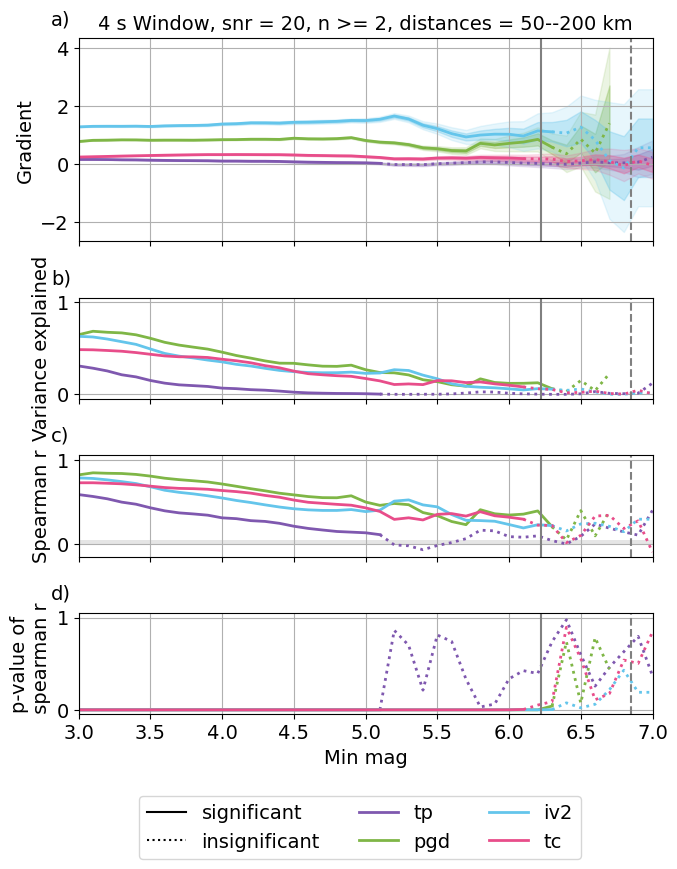

tp 0.5728630422187122
pgd 0.8161535154149928
tc 0.7159889782418046
iv2 0.7879235126796714
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


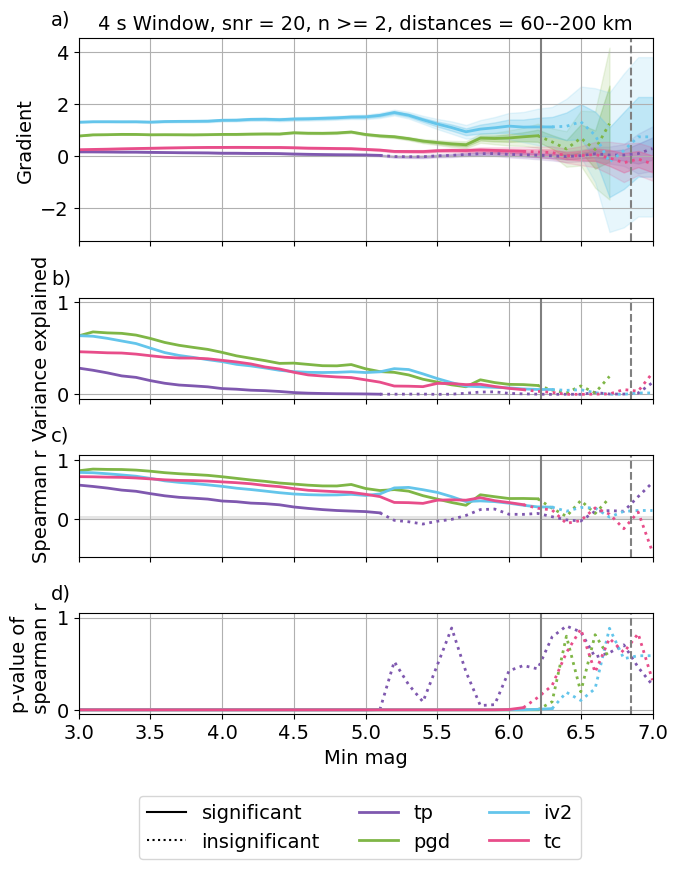

tp 0.5631537324200281
pgd 0.8044131922030936
tc 0.692620030518713
iv2 0.7890940876940054
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


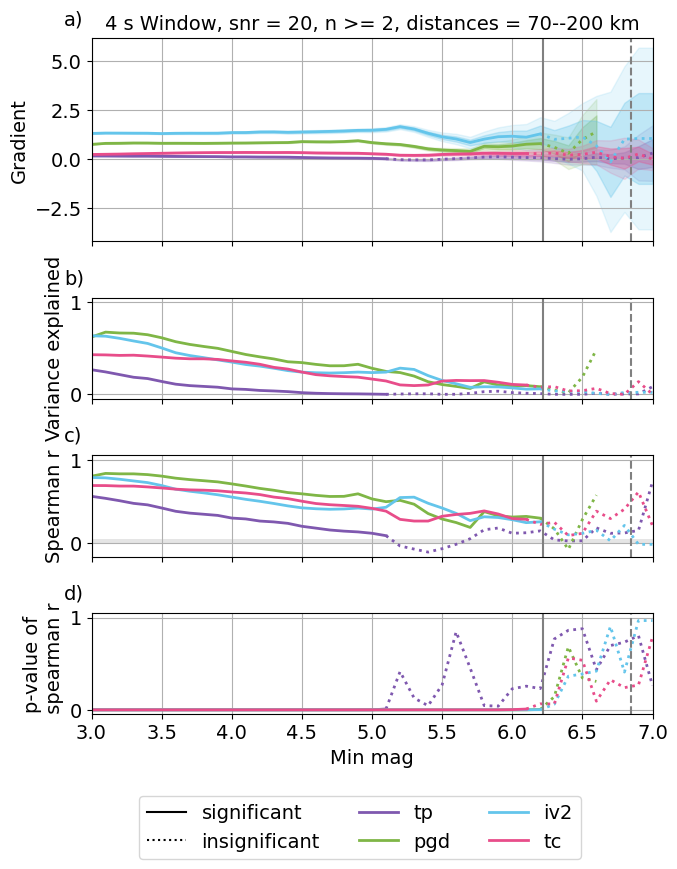

tp 0.5283019907241328
pgd 0.7843089639395048
tc 0.659212155094458
iv2 0.7856038708657668
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


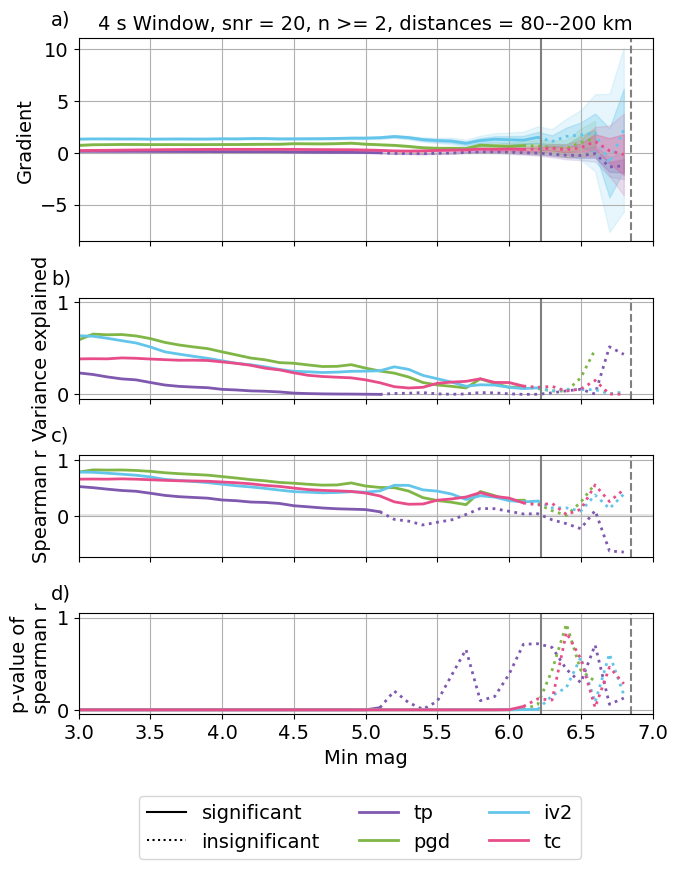

tp 0.49823127823682517
pgd 0.7543057791098645
tc 0.6373687247667605
iv2 0.7765527551175747
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


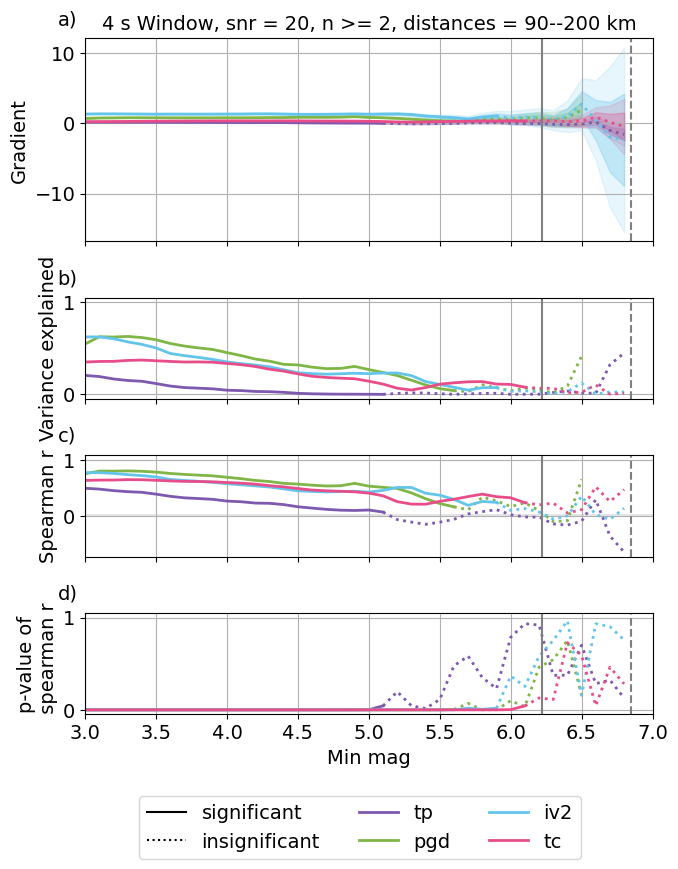

tp 0.6935226158405648
pgd 0.8380847213682087
tc 0.7782427980776387
iv2 0.8011586511657912
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


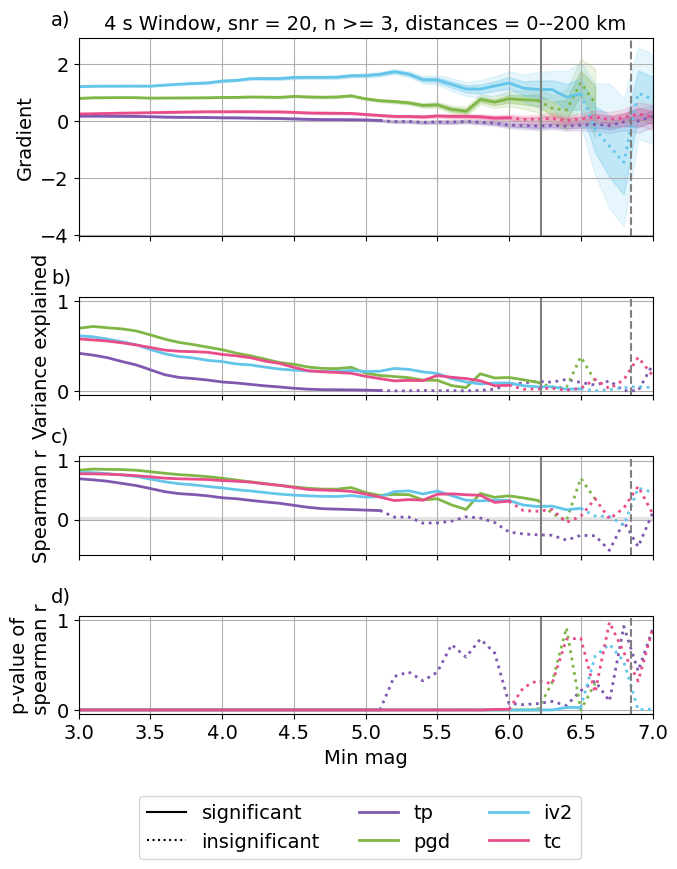

tp 0.6881554595235069
pgd 0.8387799366976685
tc 0.7674631837057665
iv2 0.8068325704908493
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


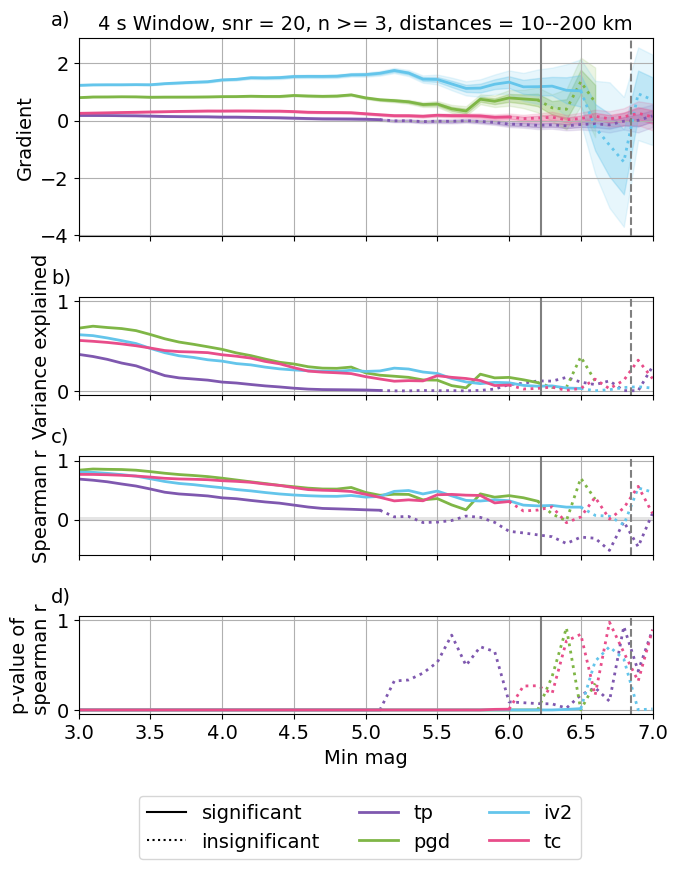

tp 0.6732168101385051
pgd 0.8389812921676627
tc 0.7574585841256718
iv2 0.8154697373027381
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


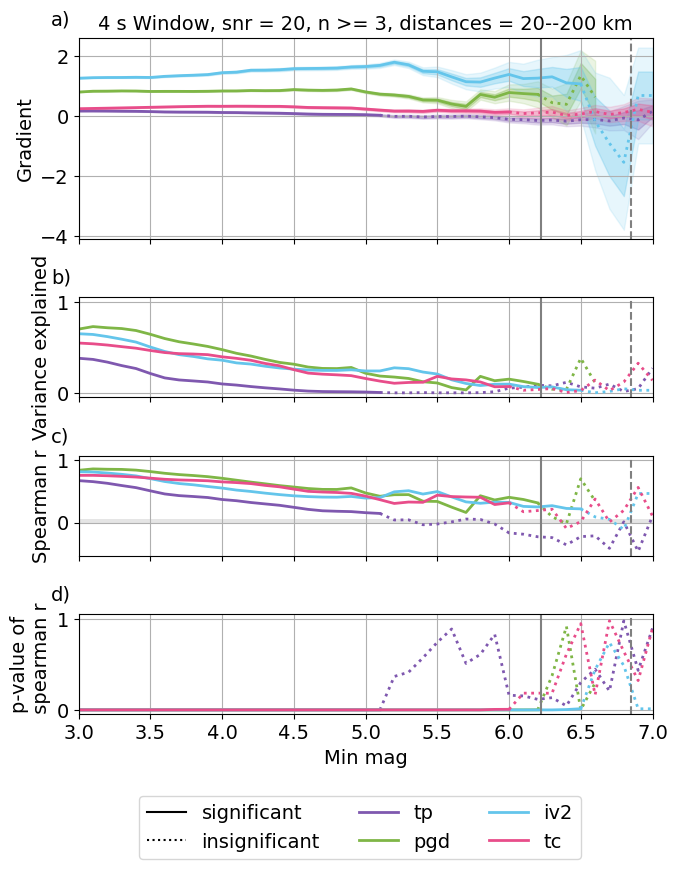

tp 0.6704931770068204
pgd 0.8358576584487968
tc 0.7550352051901132
iv2 0.8092812367291082
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


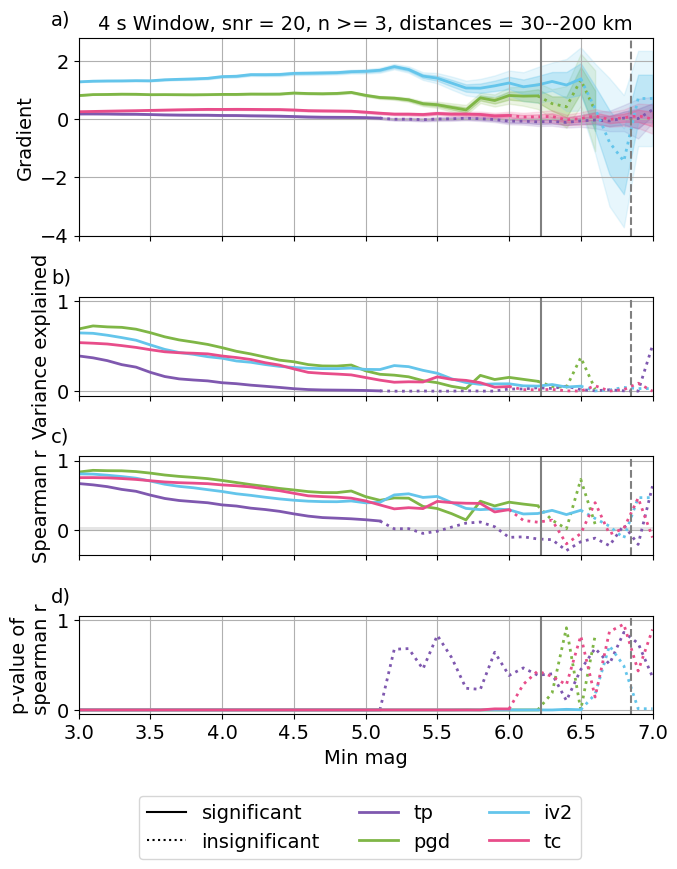

tp 0.6590414270702811
pgd 0.8279733863645122
tc 0.7476572257813145
iv2 0.7951982407957457
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


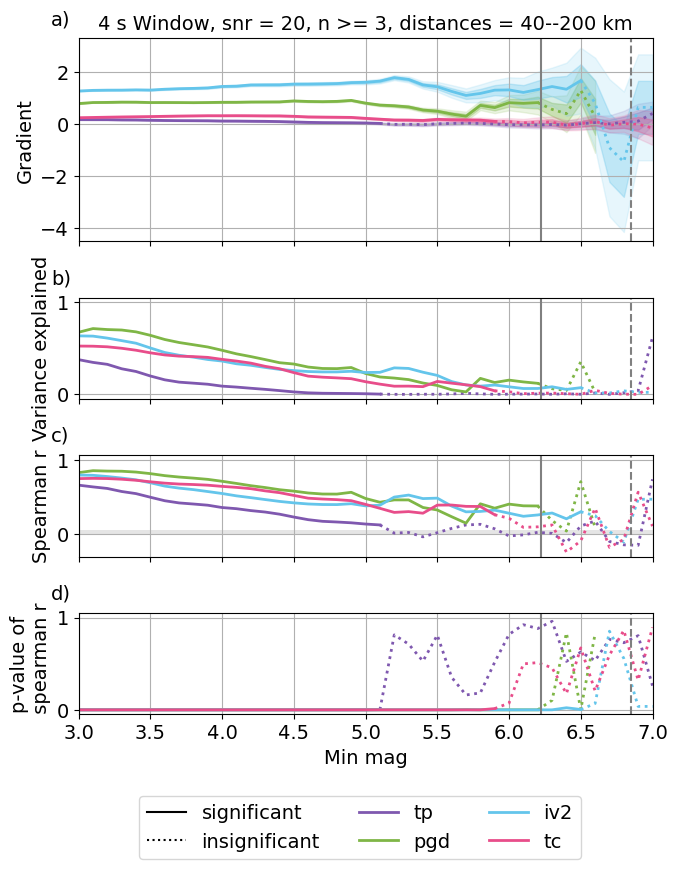

tp 0.6520440338004547
pgd 0.8233707623050817
tc 0.7375558369610917
iv2 0.7949133032402252
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


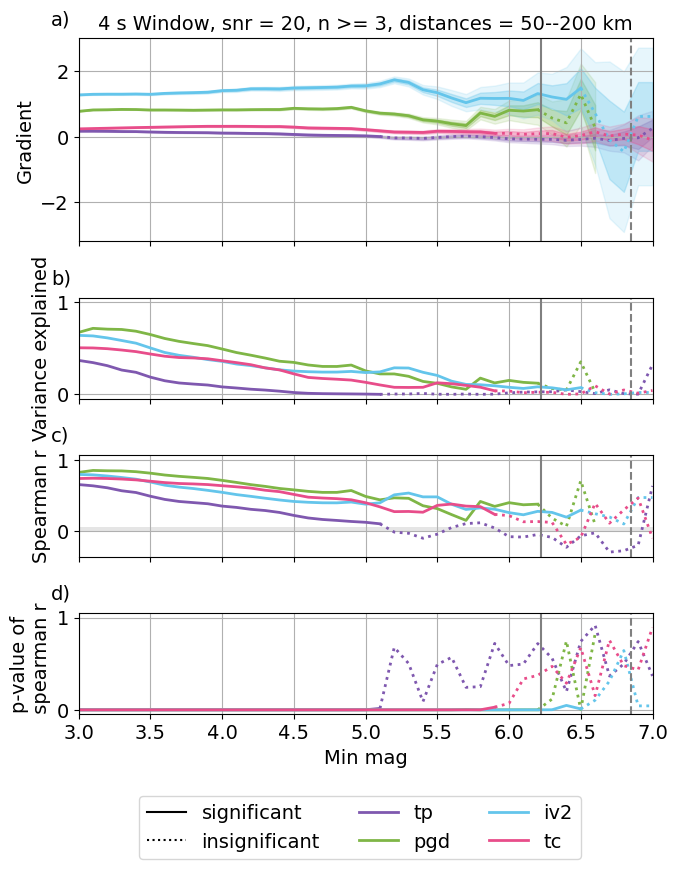

tp 0.6399767258708801
pgd 0.8166653652012732
tc 0.7255118429233173
iv2 0.7980258511210051
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


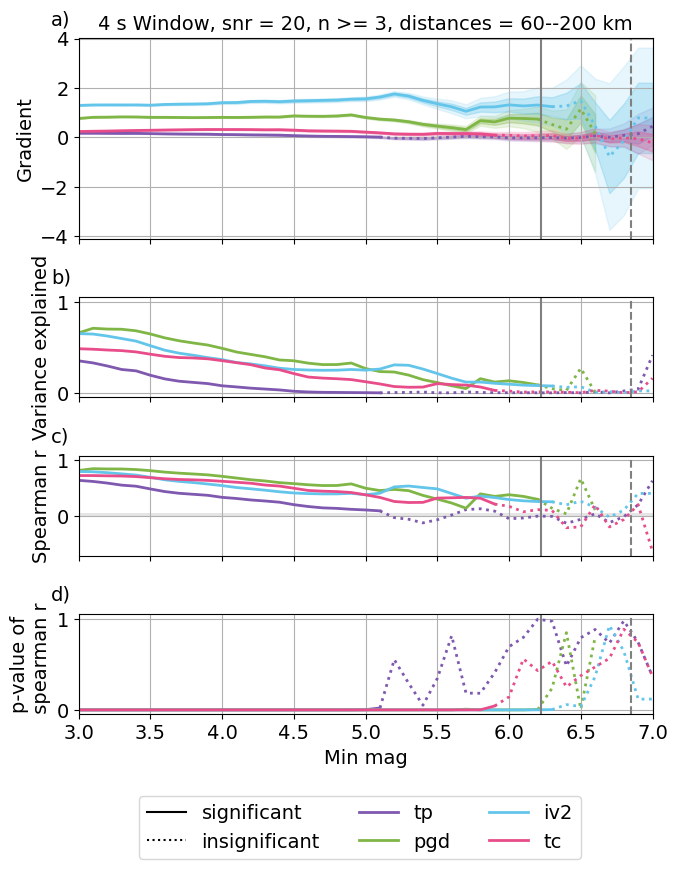

tp 0.6300980058245622
pgd 0.8038910474171663
tc 0.7020803989145606
iv2 0.7977947235496607
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


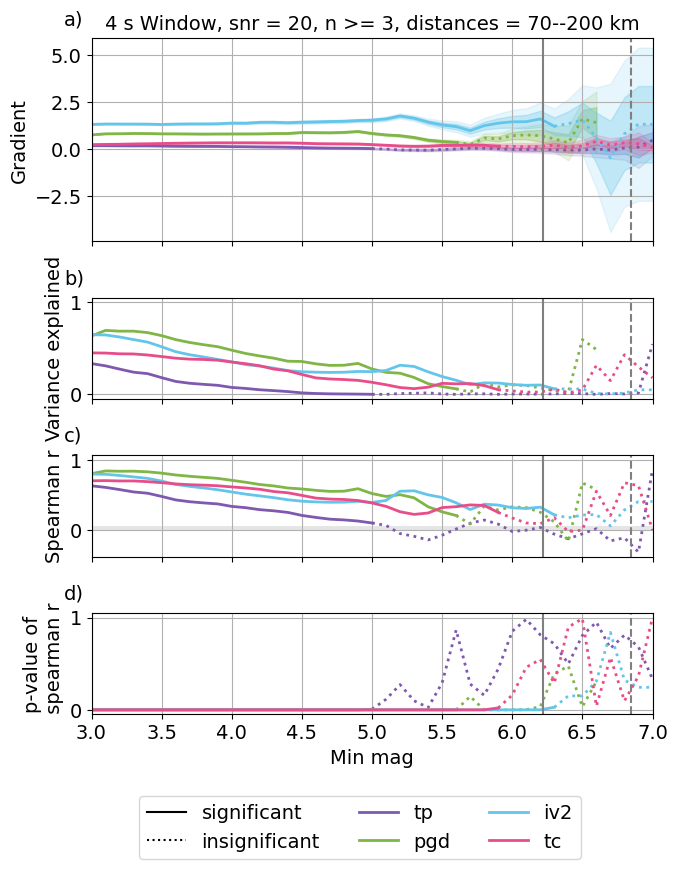

tp 0.5853749157937064
pgd 0.7820744050389621
tc 0.6680360147914455
iv2 0.7921216064288216
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


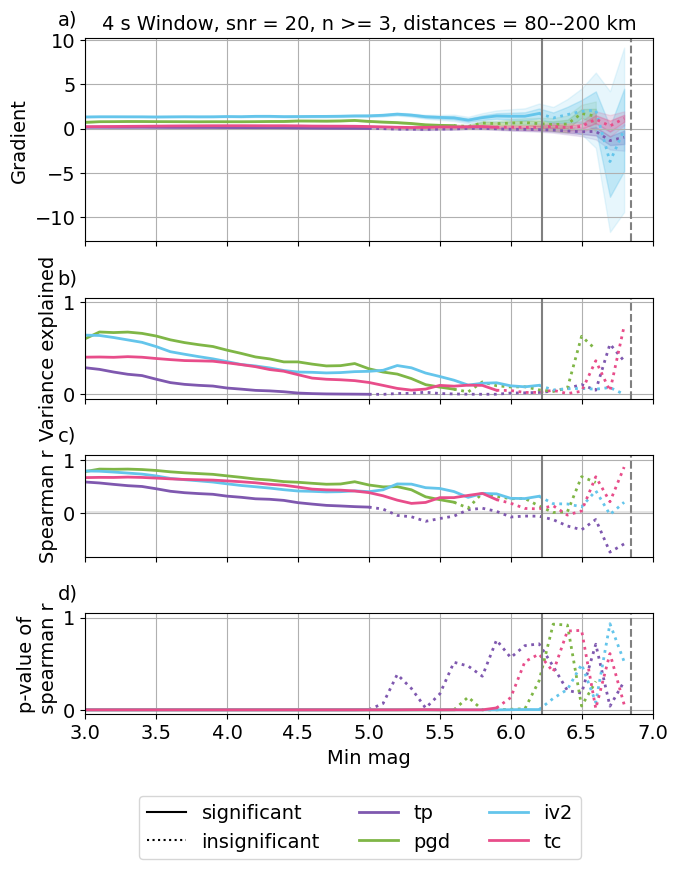

tp 0.5547522636917167
pgd 0.7493831269974847
tc 0.6440977675920517
iv2 0.7852137572129446
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


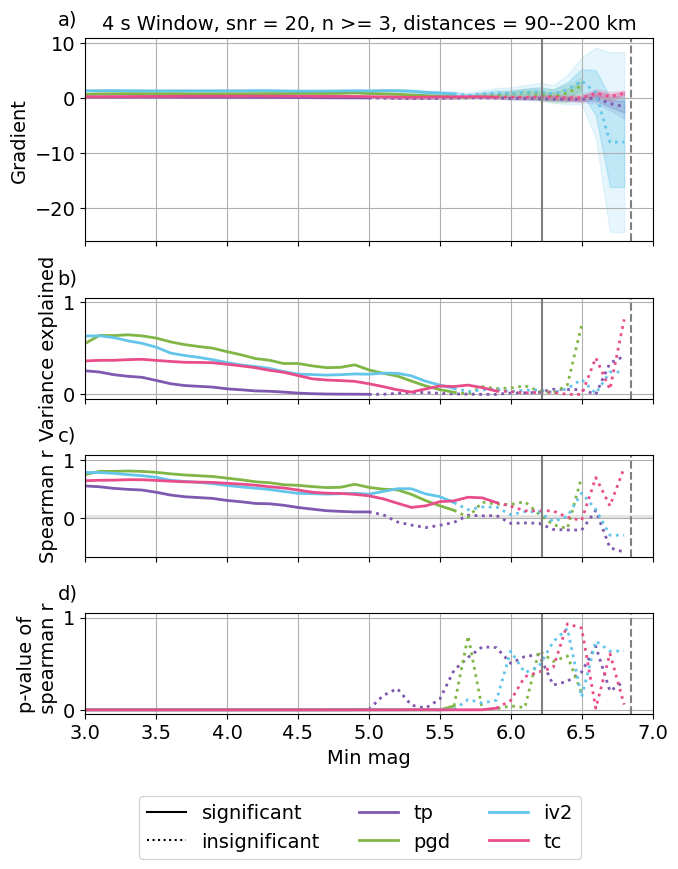

tp 0.7332117941982866
pgd 0.8350774239721517
tc 0.7862924970577121
iv2 0.8018913190937438
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


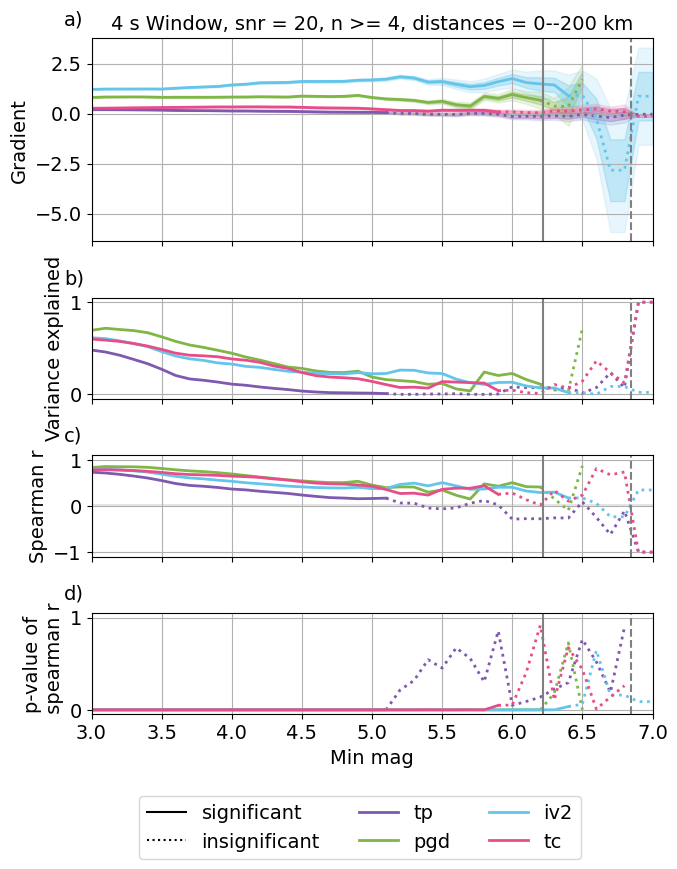

tp 0.7241205230155319
pgd 0.8361806796779568
tc 0.7757641846746153
iv2 0.8083346019364243
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


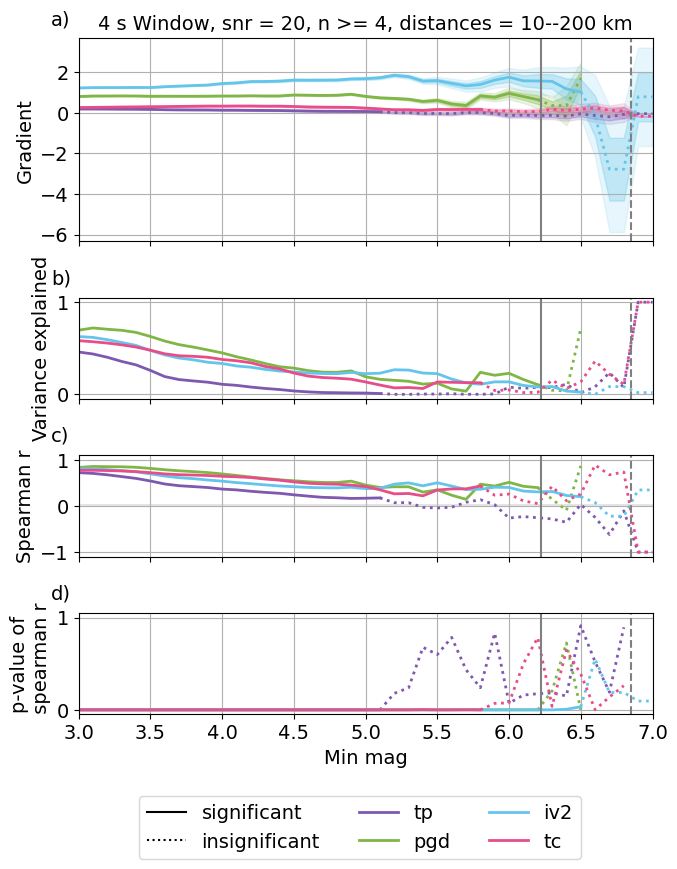

tp 0.7135993472108246
pgd 0.8363819528113944
tc 0.765660768952546
iv2 0.818712303174199
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


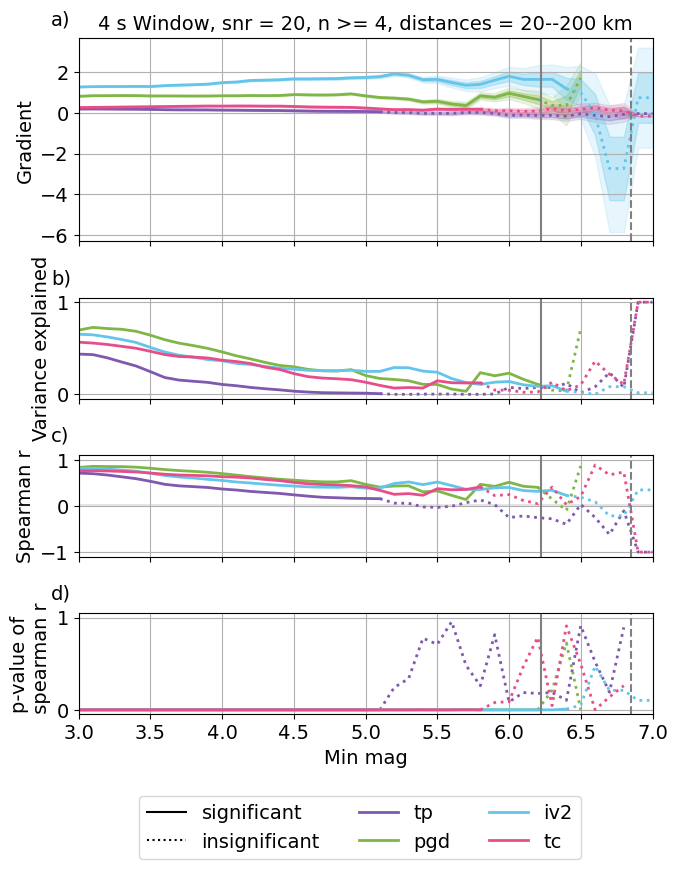

tp 0.7048416350801046
pgd 0.8331831577186075
tc 0.7631262677557885
iv2 0.8142475692397064
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


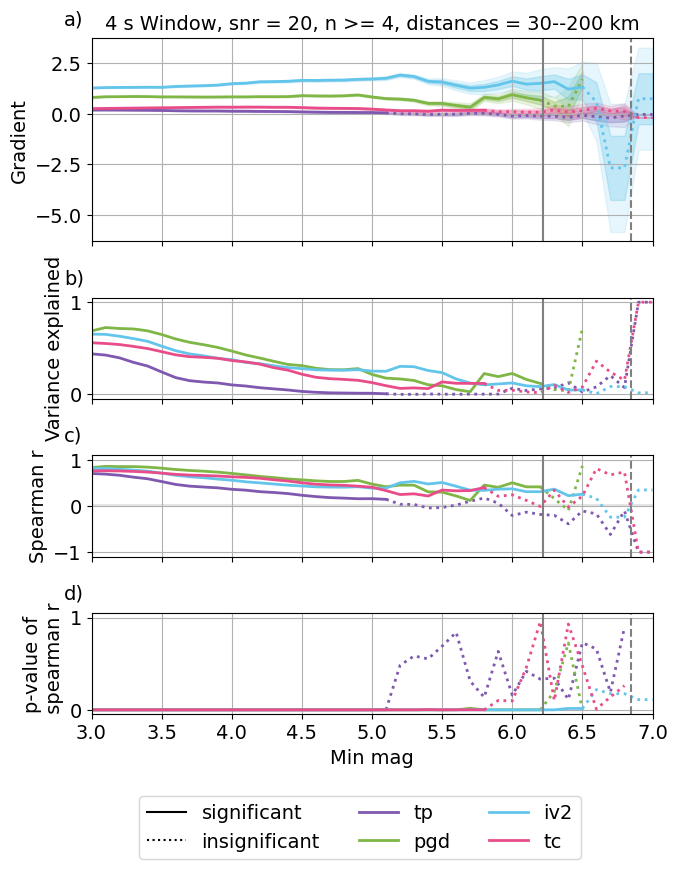

tp 0.6926031651768637
pgd 0.8251927525452767
tc 0.7536273694880989
iv2 0.8017222401226434
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


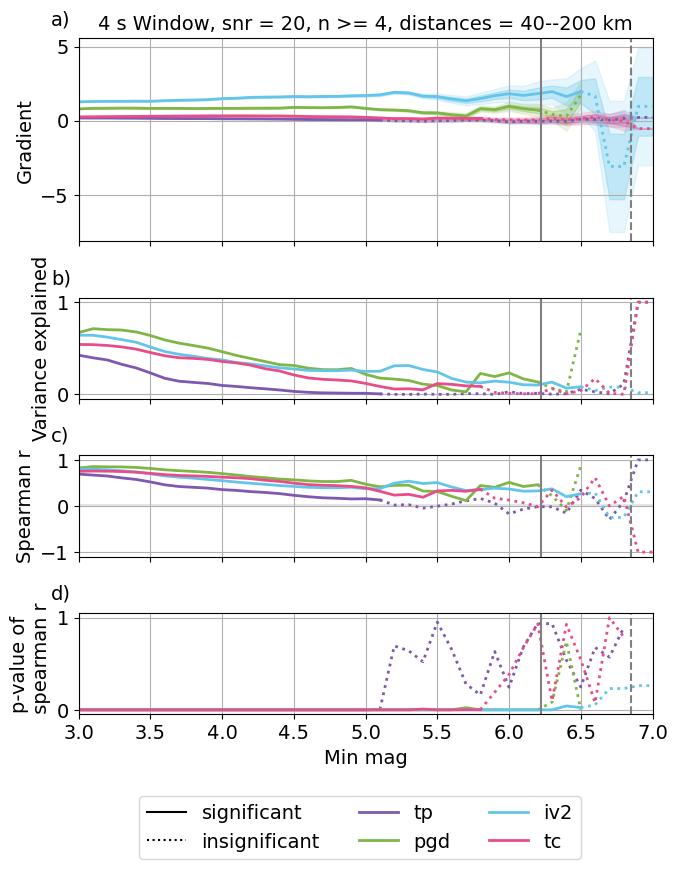

tp 0.6825085062460845
pgd 0.820538822711722
tc 0.7432756183820879
iv2 0.8034144958286963
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


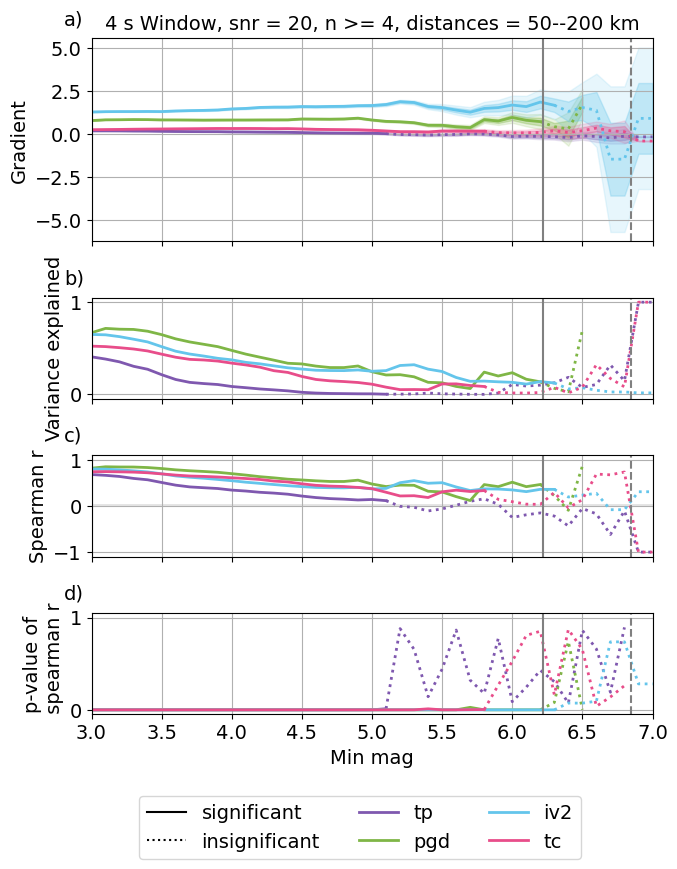

tp 0.6691485281219449
pgd 0.8129661274304677
tc 0.7268932735071687
iv2 0.8079679981280296
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


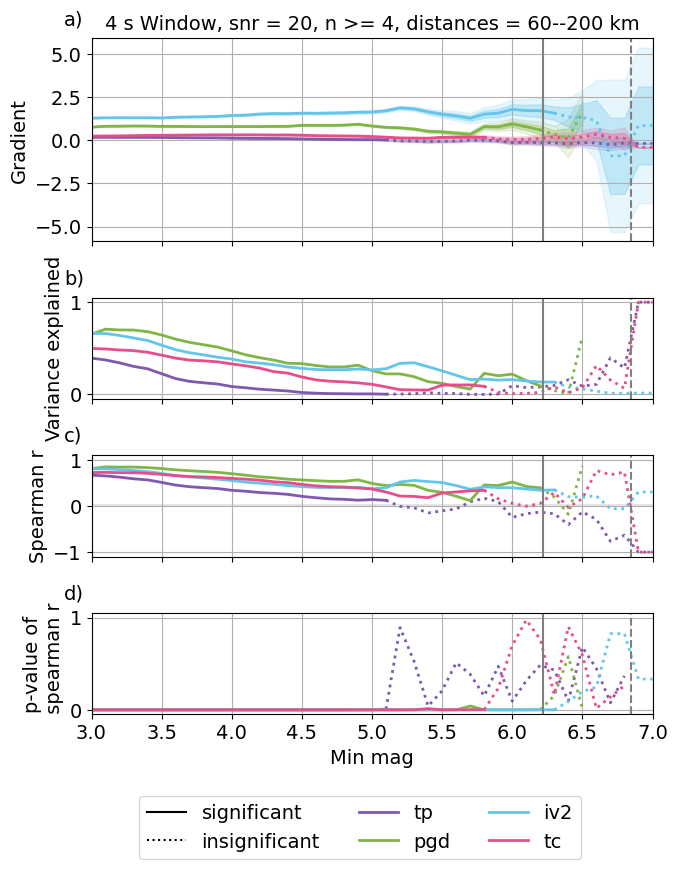

tp 0.65983139597529
pgd 0.7994353075612548
tc 0.7029256011762482
iv2 0.8099983492868491
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


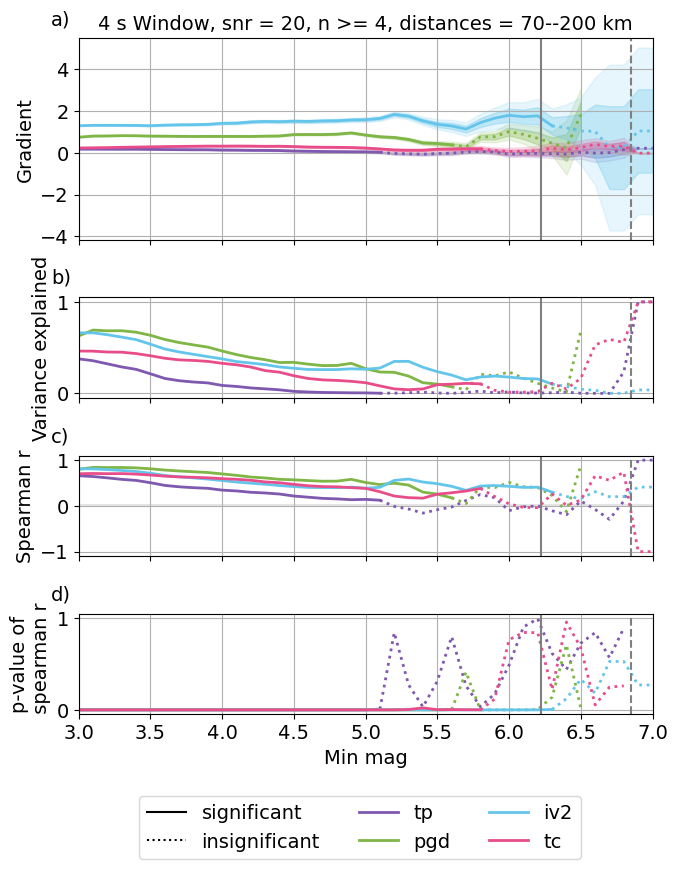

tp 0.6117565231881253
pgd 0.7769797956225284
tc 0.6693548860633413
iv2 0.8089490722764898
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


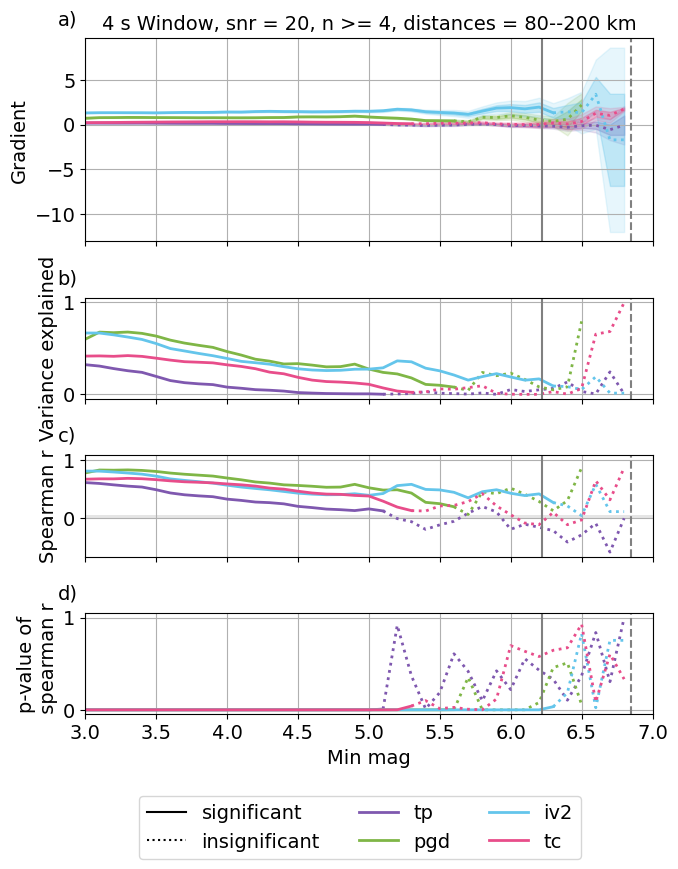

tp 0.5819335401611673
pgd 0.7420742007601674
tc 0.6496576199755137
iv2 0.8023315627486158
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


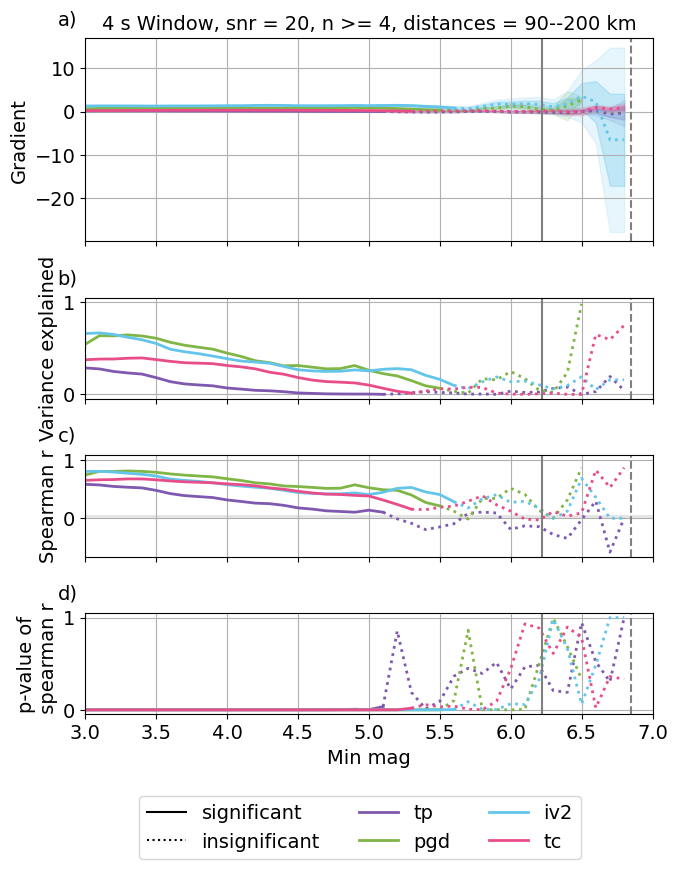

tp 0.7570753025517183
pgd 0.831683563115312
tc 0.8016073090102521
iv2 0.8034864698034565
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


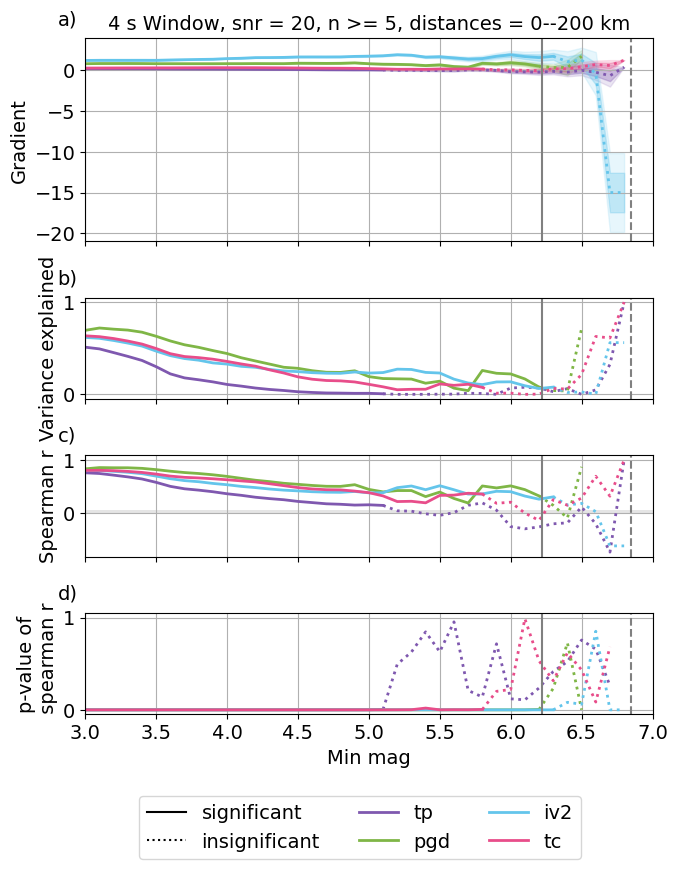

tp 0.7464904681118306
pgd 0.8333215465513754
tc 0.7921599258403521
iv2 0.8106509463844143
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


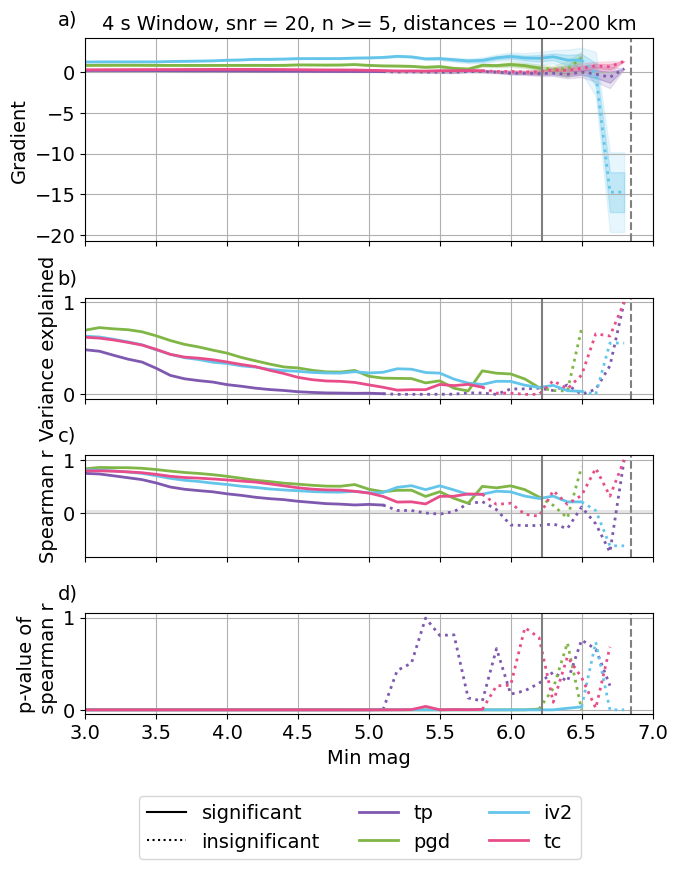

tp 0.7368564762405314
pgd 0.8340373642666841
tc 0.7834285614218769
iv2 0.8227462604923302
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


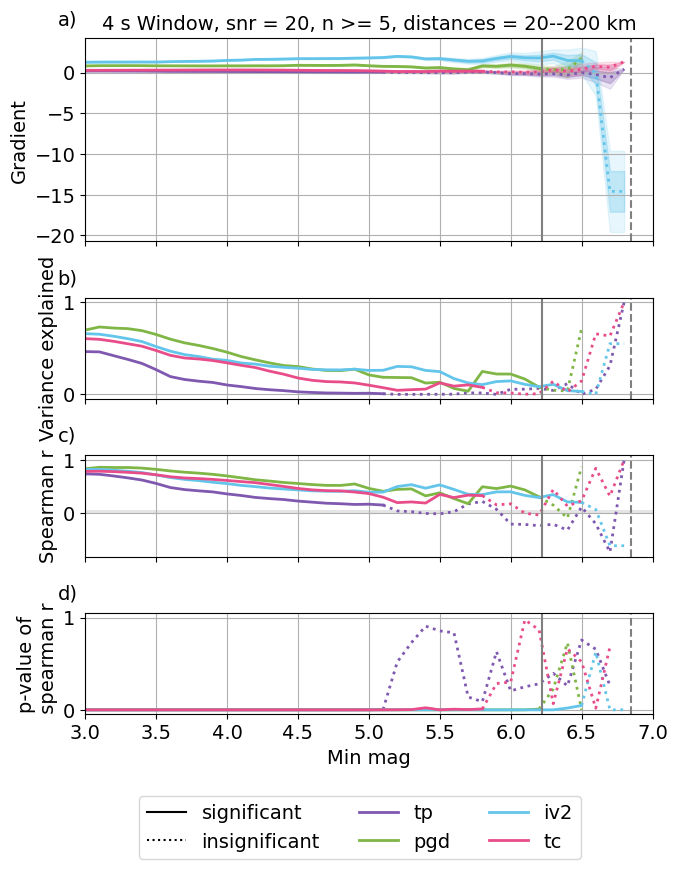

tp 0.7322125190968086
pgd 0.8314495114884077
tc 0.7811752867033089
iv2 0.8197045072016058
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


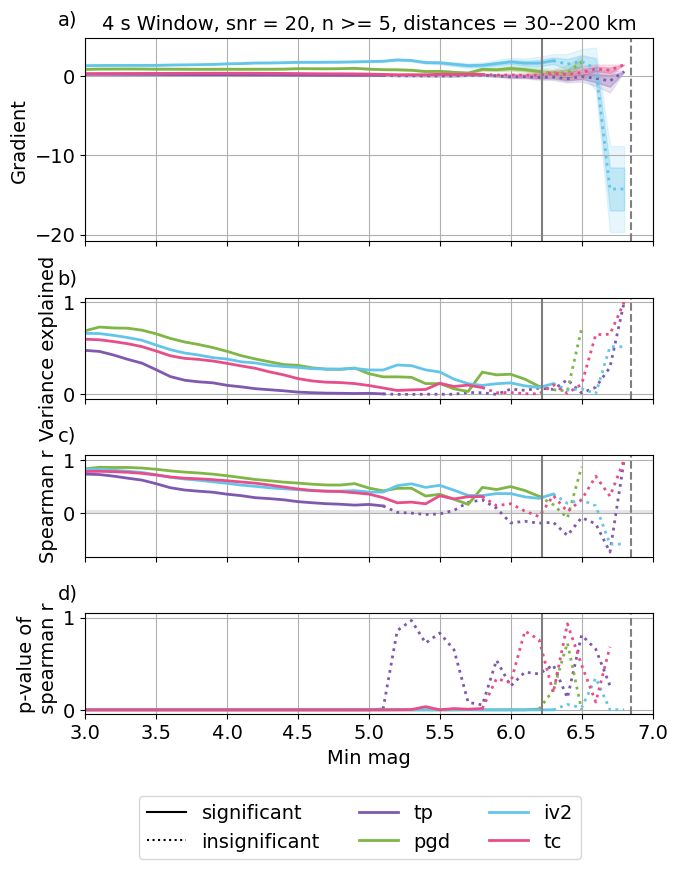

tp 0.7219865886997681
pgd 0.8239799768431756
tc 0.7678910471483537
iv2 0.807996048344494
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


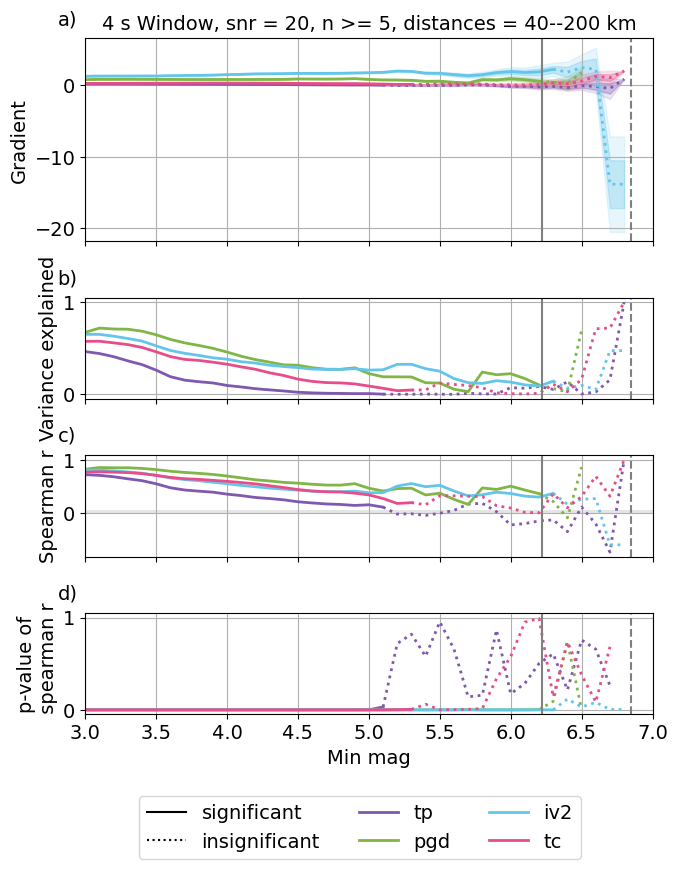

tp 0.7082152183192815
pgd 0.8190258471583812
tc 0.7590051669721645
iv2 0.8103307155878524
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


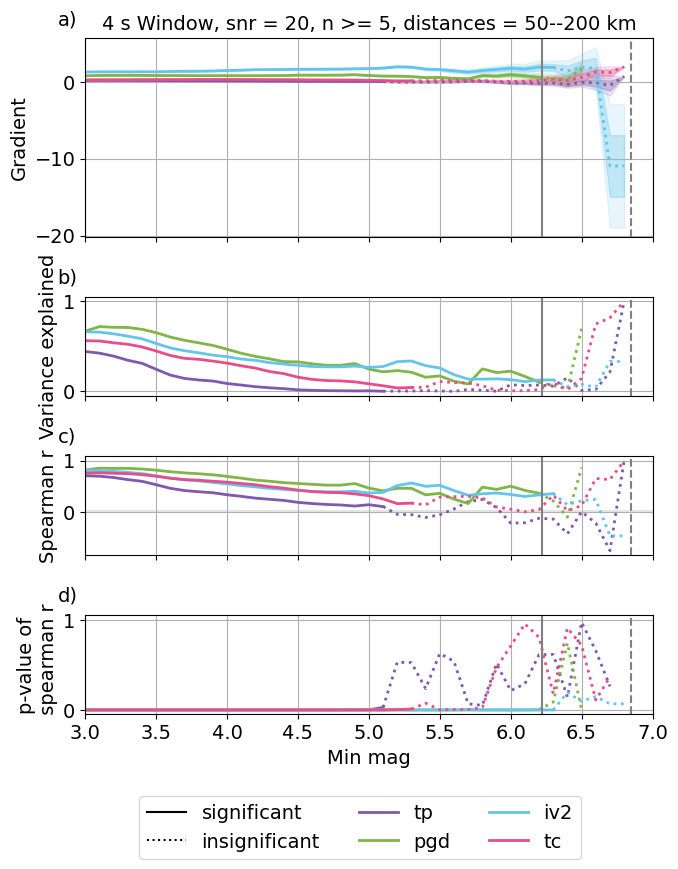

tp 0.6917862047047737
pgd 0.8110863765263105
tc 0.7444776774805266
iv2 0.8151055184577349
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


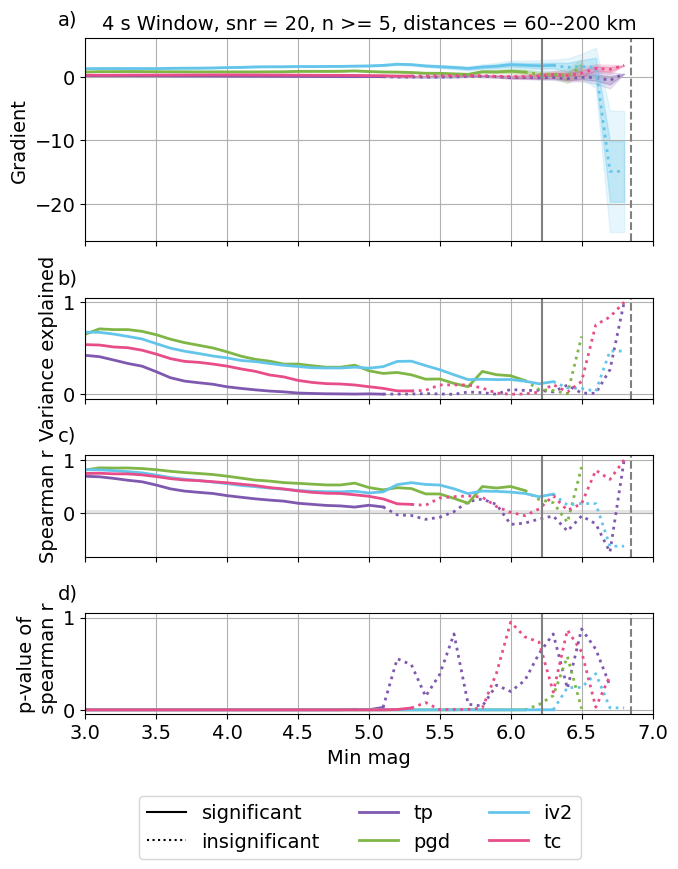

tp 0.6800084975395957
pgd 0.7959942842669933
tc 0.7198231388297004
iv2 0.8158220742604112
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


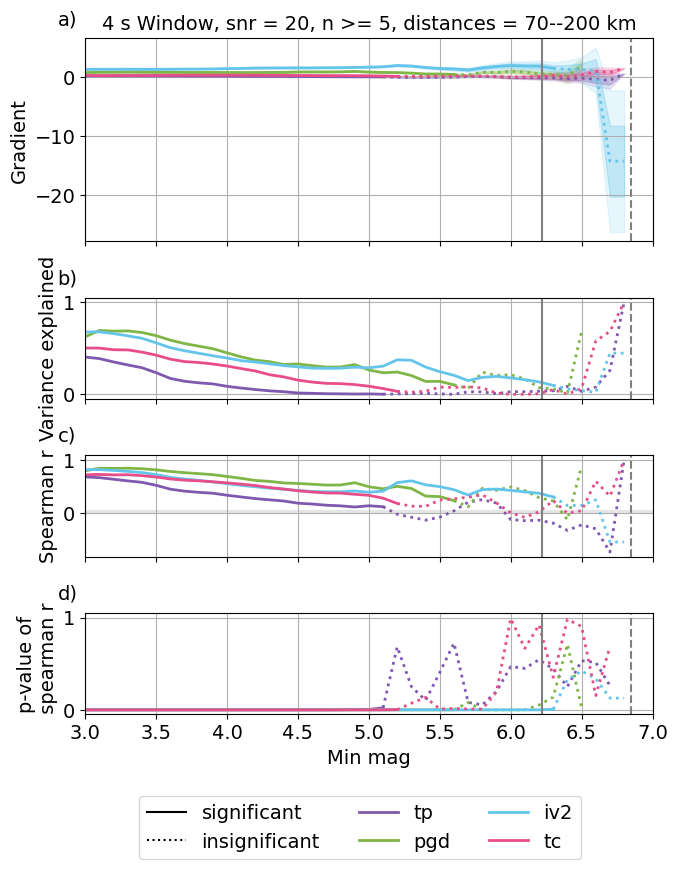

tp 0.6269061358300911
pgd 0.773445710238316
tc 0.682991289684946
iv2 0.8177323652504641
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


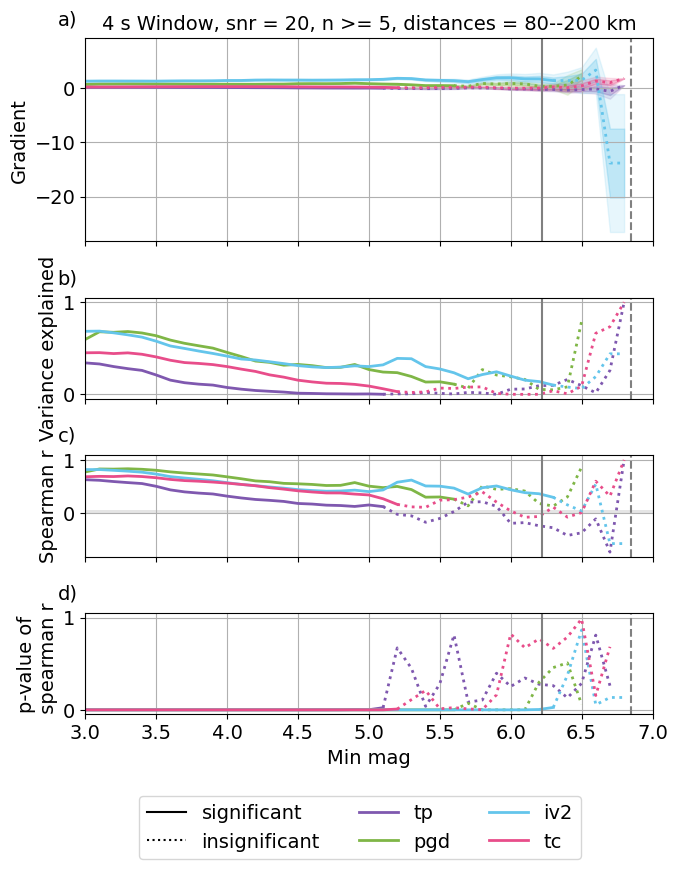

tp 0.6042027978076401
pgd 0.7384926028416844
tc 0.6613212788495979
iv2 0.8116561923528651
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0
in else, len(res)>0


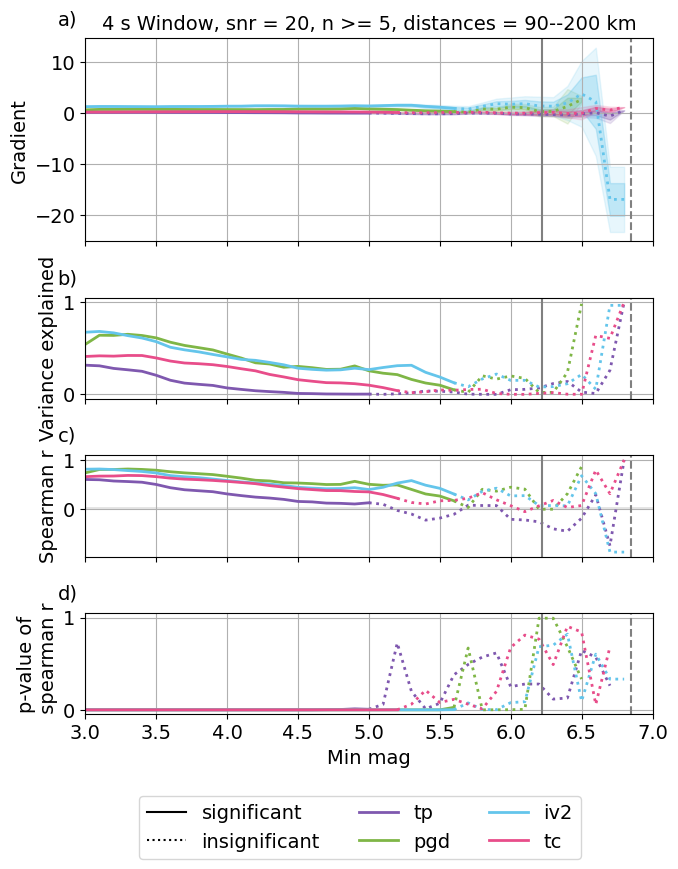

tp 0.7744195012050734
pgd 0.8282172565115193
tc 0.8121252531282069
iv2 0.8016924900261608
in else, len(res)>0
in if, len(res)==0


TypeError: unhashable type: 'list'

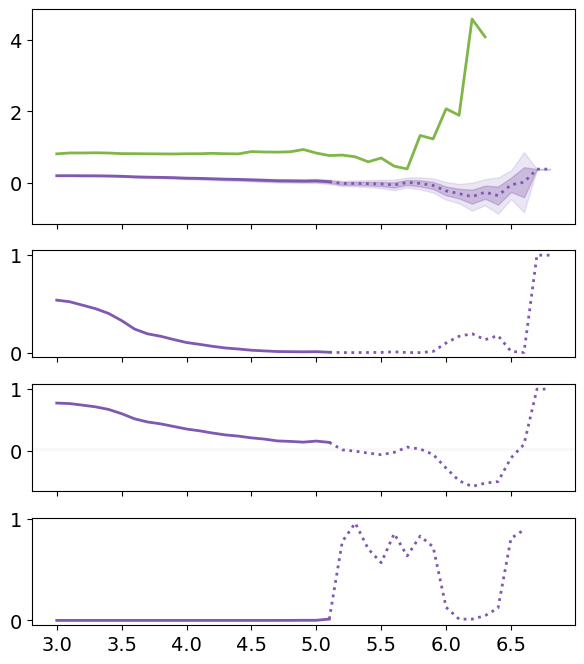

In [6]:
%matplotlib inline
n_stations = 0
min_dist = 30
max_dist = 200
for f in filenames:
    print(f)
    df = pd.read_pickle(f'/home/earthquakes1/homes/Rebecca/phd/data/results_database/{f}')
    #print(df.head(10))
    for n_stations in range(0,7):
        for min_dist in range(0, 100, 10):
            options = {'n': n_stations, 'min_dist': min_dist, 'max_dist': max_dist}
            x_tp, y_tp = calc_tp_mag_lim(df, 3.,**options)
            x_pgd, y_pgd = calc_pgd_mag_lim(df, 3.,**options)
            x_tc, y_tc = calc_tc_mag_lim(df, 3.,**options)
            x_iv2, y_iv2 = calc_iv2_mag_lim(df, 3.,**options)

            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_tp_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            tp_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n, 'tp']
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'tp', False)  
            if len(spearman)>0:
                print('tp', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_pgd_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'pgd', False)  
            pgd_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n,  'pgd']
            if len(spearman)>0:
                print('pgd', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_tc_mag_lim(df, mag_lim,**options)
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'pgd', False)  
            tc_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n, 'tc']
            if len(spearman)>0:
                print('tc', spearman[0])
            
            gradt, intercept, gradt_std, intercept_std = [],[],[],[]
            pearson = []
            spearman = []
            spearman_p = []
            n_l = []
            
            for mag_lim in magnitudes:
                x, y = calc_iv2_mag_lim(df, mag_lim,**options)
                #print(len(x[y==0]))
                gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n = calc_opt(x,y, gradt, intercept, gradt_std, intercept_std, pearson, spearman, spearman_p, n_l)
            #plot_spearman_subplots(f, gradt, gradt_std, spearman, spearman_p, n, 'iv2', False)  
            iv2_params = [gradt, gradt_std, np.array(pearson)**2, spearman, spearman_p, n,'iv2']
            if len(spearman)>0:
                print('iv2', spearman[0])
            
            #plot_data_subplots_line([x_tp, x_pgd, x_tc, x_iv2], [y_tp, y_pgd, y_tc, y_iv2], ['tp','pgd','tc','iv2'],f, tp_params, pgd_params, tc_params, iv2_params)
            plot_spearman_subplots_all_on_one_no_n_shaded_percent_var(f, tp_params, pgd_params, iv2_params, tc_params, log = False, save = True, **options)
            #print(tp_params[4][0], tc_params[4][0])
            #plot_spearman_subplots_all_on_one(f, gradt, gradt_std, spearman, spearman_p, n, 'iv2', True) 
            


In [ ]:
calc_iv2_mag_lim(df, mag_lim,**options)

([], [])